In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[5599, 7613, 2227, 3332, 9410, 919, 8257, 6177, 8017, 8634, 8076, 4982, 4416, 4689, 3637, 6042, 1724, 6009, 2613, 5018]
log initialized
Average similarity between family members is 0.9687504828388847 at temperature -1
Average similarity between family and home is 0.9998519936023261 at temperature -1
Average similarity between students and their classroom is 0.9633804505564746 at temperature -1
Average classroom occupancy is 1.7705882352941176 and number classrooms is 170
Average similarity between workers is 0.9700476014603041 at temperature -1
Average office occupancy is 3.4696132596685083 and number offices is 181
Average friend similarity for adults: 0.8449411000863075 for kids: 0.7508716024627957
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.3173056259162481
avg restaurant similarity 0.2628774441661966
avg restaurant similarity 0.8891866363551851
avg restaurant similarity 0.7056759783446294
avg restaurant similarity 0.6578578373723722
avg restaurant similarity 0.5350855094379756
avg restaurant similarity 0.9998178879433808
avg restaurant similarity 0.923868435056814
avg restaurant similarity 0.9257339854049723
avg restaurant similarity 0.8108675708880357
avg restaurant similarity 0.9998178879433808
avg restaurant similarity 0.8332957257291868
avg restaurant similarity 0.7528237222736106
avg restaurant similarity 0.9997411960963061
avg restaurant similarity 0.8673680029724249
avg restaurant similarity 0.9997598637881933
avg restaurant similarity 0.9217664641633416
avg restaurant similarity 0.9627469245965827
avg restaurant similarity 0.9998082205825063
avg restaurant similarity 0.7622295913984912
avg restaurant similarity 0.5325621397562836
avg restaurant similarity 0.9238425105811319
avg restaur

avg restaurant similarity 0.5554148802085144
avg restaurant similarity 0.9994534909392809
avg restaurant similarity 0.7339394164986284
avg restaurant similarity 0.7266437085345716
avg restaurant similarity 0.2561609337247933
avg restaurant similarity 0.7295932386944708
avg restaurant similarity 0.7339394164986284
avg restaurant similarity 0.7281364252831793
avg restaurant similarity 0.9996273307765645
avg restaurant similarity 0.6471235133111584
avg restaurant similarity 0.9292808676520039
avg restaurant similarity 0.7241718356837881
avg restaurant similarity 0.8590881588904551
avg restaurant similarity 0.5680881880576523
avg restaurant similarity 0.6700437589707979
avg restaurant similarity 0.8608767900358687
avg restaurant similarity 0.8587559503768152
avg restaurant similarity 0.7352894110128285
avg restaurant similarity 0.8079124166307383
avg restaurant similarity 0.6284461913448575
avg restaurant similarity 0.9997108139555523
avg restaurant similarity 0.3481148699124955
avg restau

avg restaurant similarity 0.6329948529647497
avg restaurant similarity 0.8083898528019013
avg restaurant similarity 0.6760765223273586
avg restaurant similarity 0.5909437615211943
avg restaurant similarity 0.5081643092528902
avg restaurant similarity 0.6612362996321063
avg restaurant similarity 0.3536173613685313
avg restaurant similarity 0.38269991025271527
avg restaurant similarity 0.8036100414633914
avg restaurant similarity 0.801366788001782
avg restaurant similarity 0.5611435458628522
avg restaurant similarity 0.32618129623981357
avg restaurant similarity 0.9998429500180743
avg restaurant similarity 0.3372491192220307
avg restaurant similarity 0.5898491394857341
avg restaurant similarity 0.6497332396957785
avg restaurant similarity 0.5921088434342716
avg restaurant similarity 0.5827606482257751
avg restaurant similarity 0.4687167152635319
avg restaurant similarity 0.3942421481892371
avg restaurant similarity 0.5445272311362707
avg restaurant similarity 0.4005409086197563
avg resta

avg restaurant similarity 0.45888892570868206
avg restaurant similarity 0.4634626085141504
avg restaurant similarity 0.3811743096750191
avg restaurant similarity 0.5567886574009078
avg restaurant similarity 0.6336253646064371
avg restaurant similarity 0.8638032752867244
avg restaurant similarity 0.5129162320484639
avg restaurant similarity 0.9995659826993805
avg restaurant similarity 0.6166771788492051
avg restaurant similarity 0.5899052126688265
avg restaurant similarity 0.5582297918761872
avg restaurant similarity 0.5931512387363378
avg restaurant similarity 0.5545069333153688
avg restaurant similarity 0.800206465757574
avg restaurant similarity 0.48639479599951413
avg restaurant similarity 0.9998302969150688
avg restaurant similarity 0.5502950780966694
avg restaurant similarity 0.4640900628497183
avg restaurant similarity 0.46726613739513445
avg restaurant similarity 0.6161293582311593
avg restaurant similarity 0.5980123927276058
avg restaurant similarity 0.5067997014592889
avg rest

avg restaurant similarity 0.6852559492800023
avg restaurant similarity 0.9992953804049317
avg restaurant similarity 0.8369766841602286
avg restaurant similarity 0.999686309291635
avg restaurant similarity 0.6261703105222978
avg restaurant similarity 0.6283887227430784
avg restaurant similarity 0.6787113731518852
avg restaurant similarity 0.9505516752857361
avg restaurant similarity 0.49314575754184276
avg restaurant similarity 0.8234349197599917
avg restaurant similarity 0.7300418737423022
avg restaurant similarity 0.4298257534544218
avg restaurant similarity 0.49766261972776105
avg restaurant similarity 0.8865255410921896
avg restaurant similarity 0.9999195805103833
avg restaurant similarity 0.573736468643887
avg restaurant similarity 0.41614289779200786
avg restaurant similarity 0.6808291743000147
avg restaurant similarity 0.8654842307550443
avg restaurant similarity 0.8357157345496733
avg restaurant similarity 0.43331462618521077
avg restaurant similarity 0.9996652555962526
avg rest

avg restaurant similarity 0.5777546587897728
avg restaurant similarity 0.4741964502830325
avg restaurant similarity 0.8179440206432327
avg restaurant similarity 0.8725379269729896
avg restaurant similarity 0.8182429904092589
avg restaurant similarity 0.6404069722015439
avg restaurant similarity 0.35147192174566566
avg restaurant similarity 0.7986455480051291
avg restaurant similarity 0.5967328021285239
avg restaurant similarity 0.6963942387476065
avg restaurant similarity 0.8958864198970176
avg restaurant similarity 0.9998545264712076
avg restaurant similarity 0.9996437089783728
avg restaurant similarity 0.9996921644080969
avg restaurant similarity 0.8513977870100613
avg restaurant similarity 0.8692715034537466
avg restaurant similarity 0.58550218420094
avg restaurant similarity 0.5043830028900351
avg restaurant similarity 0.9996437089783728
avg restaurant similarity 0.9290860113693349
avg restaurant similarity 0.44246139277545116
avg restaurant similarity 0.5449943733988766
avg restau

avg restaurant similarity 0.4643320044447964
avg restaurant similarity 0.5274502391587783
avg restaurant similarity 0.6358441178546463
avg restaurant similarity 0.5043474178121585
avg restaurant similarity 0.6816496881501338
avg restaurant similarity 0.4930221112389968
avg restaurant similarity 0.378857726480028
avg restaurant similarity 0.5826024480222811
avg restaurant similarity 0.5361198387741428
avg restaurant similarity 0.7458373084027681
avg restaurant similarity 0.6230210050453752
avg restaurant similarity 0.8070843047427454
avg restaurant similarity 0.7418135226467525
avg restaurant similarity 0.38233457871924914
avg restaurant similarity 0.6851340524395839
avg restaurant similarity 0.487559040349717
avg restaurant similarity 0.4991562194485027
avg restaurant similarity 0.47558450115283646
avg restaurant similarity 0.4874097402026686
avg restaurant similarity 0.5350848140411242
avg restaurant similarity 0.3816377571014137
avg restaurant similarity 0.8034975069634207
avg restau

avg restaurant similarity 0.6133007577709535
avg restaurant similarity 0.5920863447938338
avg restaurant similarity 0.6445156049329406
avg restaurant similarity 0.4467926664208792
avg restaurant similarity 0.5311973058967365
avg restaurant similarity 0.4054399591179079
avg restaurant similarity 0.8056082830365981
avg restaurant similarity 0.643069671561264
avg restaurant similarity 0.7430196897749294
avg restaurant similarity 0.5365926255919831
avg restaurant similarity 0.4252520914943776
avg restaurant similarity 0.4254175192871239
avg restaurant similarity 0.9998952644817926
avg restaurant similarity 0.5720513453979292
avg restaurant similarity 0.5411442674408408
avg restaurant similarity 0.41142799664131446
avg restaurant similarity 0.634080399823473
avg restaurant similarity 0.45220148367006296
avg restaurant similarity 0.6133007577709535
avg restaurant similarity 0.6358441178546463
avg restaurant similarity 0.4127866624479431
avg restaurant similarity 0.5706980394787373
avg restau

avg restaurant similarity 0.6758476649649705
avg restaurant similarity 0.5722575609617254
avg restaurant similarity 0.564624926062224
avg restaurant similarity 0.5052528887205319
avg restaurant similarity 0.9481476671112905
avg restaurant similarity 0.6366955191512186
avg restaurant similarity 0.7466342186118733
avg restaurant similarity 0.6034258042107437
avg restaurant similarity 0.9997997974118502
avg restaurant similarity 0.5708364777604216
avg restaurant similarity 0.2884010603469135
avg restaurant similarity 0.5007640303997815
avg restaurant similarity 0.8137012708050665
avg restaurant similarity 0.3892788629608102
avg restaurant similarity 0.8538891680080385
avg restaurant similarity 0.585839254588969
avg restaurant similarity 0.5375628328280544
avg restaurant similarity 0.9996016975050431
avg restaurant similarity 0.999763062698933
avg restaurant similarity 0.5825569485175217
avg restaurant similarity 0.5429277657115079
avg restaurant similarity 0.7274637336390959
avg restauran

avg restaurant similarity 0.19189330398655555
avg restaurant similarity 0.9995363312936691
avg restaurant similarity 0.8275340648234287
avg restaurant similarity 0.7260609920712336
avg restaurant similarity 0.6253307611489962
avg restaurant similarity 0.70953278210292
avg restaurant similarity 0.8663941802880983
avg restaurant similarity 0.7872477046878563
avg restaurant similarity 0.9996936165537272
avg restaurant similarity 0.6264578704216783
avg restaurant similarity 0.6506305426411699
avg restaurant similarity 0.5637523151374935
avg restaurant similarity 0.8129396995690623
avg restaurant similarity 0.5106046095749174
avg restaurant similarity 0.7590928064129094
avg restaurant similarity 0.6264578704216783
Average similarity between family members is 0.9737884927347208 at temperature -1
Average similarity between family and home is 0.9998500595888246 at temperature -1
Average similarity between students and their classroom is 0.9693323463823755 at temperature -1
Average classroom oc

avg restaurant similarity 0.806973503183756
avg restaurant similarity 0.9998449147749213
avg restaurant similarity 0.610338781618881
avg restaurant similarity 0.9216595762425962
avg restaurant similarity 0.9998124691617635
avg restaurant similarity 0.6775405158505556
avg restaurant similarity 0.8237639335579261
avg restaurant similarity 0.999854932434038
avg restaurant similarity 0.8912622605912813
avg restaurant similarity 0.5104069332566277
avg restaurant similarity 0.9997149550498121
avg restaurant similarity 0.8910435384808552
avg restaurant similarity 0.49607730369074365
avg restaurant similarity 0.5077156208068969
avg restaurant similarity 0.35947040409425385
avg restaurant similarity 0.9996849820019182
avg restaurant similarity 0.5780612649143162
avg restaurant similarity 0.8069291818493335
avg restaurant similarity 0.8237639335579261
avg restaurant similarity 0.84317039871229
avg restaurant similarity 0.8432727260657933
avg restaurant similarity 0.7051178652504313
avg restauran

avg restaurant similarity 0.34989998874939543
avg restaurant similarity 0.5783093185702037
avg restaurant similarity 0.5799501884451521
avg restaurant similarity 0.5795833425642644
avg restaurant similarity 0.5736979148869891
avg restaurant similarity 0.5959615604470638
avg restaurant similarity 0.5799501884451521
avg restaurant similarity 0.4926469736377335
avg restaurant similarity 0.5605398548466706
avg restaurant similarity 0.9161158557018845
avg restaurant similarity 0.40742359291904084
avg restaurant similarity 0.6916118086261324
avg restaurant similarity 0.6331081736135649
avg restaurant similarity 0.3798358543535255
avg restaurant similarity 0.9996864539780512
avg restaurant similarity 0.5053511864825524
avg restaurant similarity 0.7069771018908584
avg restaurant similarity 0.5564203090200148
avg restaurant similarity 0.6502093213014248
avg restaurant similarity 0.4986991133909774
avg restaurant similarity 0.5113108450087739
avg restaurant similarity 0.4005341741140886
avg rest

avg restaurant similarity 0.642558979138278
avg restaurant similarity 0.7173247574621425
avg restaurant similarity 0.6856144022345209
avg restaurant similarity 0.5370218229700026
avg restaurant similarity 0.869278976514442
avg restaurant similarity 0.9161755308860416
avg restaurant similarity 0.869278976514442
avg restaurant similarity 0.5395206226973183
avg restaurant similarity 0.5806959304384026
avg restaurant similarity 0.4473495902954344
avg restaurant similarity 0.2588656870765291
avg restaurant similarity 0.9997102877095925
avg restaurant similarity 0.6254137711446802
avg restaurant similarity 0.5499567559968166
avg restaurant similarity 0.7442878919466295
avg restaurant similarity 0.9353394979464988
avg restaurant similarity 0.5919374011057337
avg restaurant similarity 0.6313586867376579
avg restaurant similarity 0.625239425297373
avg restaurant similarity 0.5198189381295011
avg restaurant similarity 0.869278976514442
avg restaurant similarity 0.5241366451142935
avg restaurant 

avg restaurant similarity 0.49710962825169114
avg restaurant similarity 0.7327167525655122
avg restaurant similarity 0.6712999883517117
avg restaurant similarity 0.5543152331902939
avg restaurant similarity 0.3714261497917636
avg restaurant similarity 0.5311594130008255
avg restaurant similarity 0.8070312869561747
avg restaurant similarity 0.8780122437392601
avg restaurant similarity 0.7295684061373399
avg restaurant similarity 0.6145785835632229
avg restaurant similarity 0.4666848794183946
avg restaurant similarity 0.8458408177086036
avg restaurant similarity 0.6235307925353724
avg restaurant similarity 0.4661974652353396
avg restaurant similarity 0.4591685080606036
avg restaurant similarity 0.46092872908530147
avg restaurant similarity 0.43061099654963775
avg restaurant similarity 0.7174472263789917
avg restaurant similarity 0.40977445662597256
avg restaurant similarity 0.6601474533710623
avg restaurant similarity 0.9345464822076934
avg restaurant similarity 0.8268381124790941
avg re

avg restaurant similarity 0.5007155013873519
avg restaurant similarity 0.4762238684823078
avg restaurant similarity 0.4793928851840184
avg restaurant similarity 0.4731478644106559
avg restaurant similarity 0.4912767053164299
avg restaurant similarity 0.3846940356294691
avg restaurant similarity 0.5698512617550497
avg restaurant similarity 0.5404637074003149
avg restaurant similarity 0.553346224108043
avg restaurant similarity 0.2721902616554237
avg restaurant similarity 0.564502565927552
avg restaurant similarity 0.334877998274261
avg restaurant similarity 0.5090728397442237
avg restaurant similarity 0.3338986456897245
avg restaurant similarity 0.47638252536803627
avg restaurant similarity 0.4890860560648448
avg restaurant similarity 0.46979031625375767
avg restaurant similarity 0.566385429843719
avg restaurant similarity 0.47638252536803627
avg restaurant similarity 0.5997806328897195
avg restaurant similarity 0.2721902616554237
avg restaurant similarity 0.48978363000868735
avg restau

avg restaurant similarity 0.5885885436391913
avg restaurant similarity 0.7441710771324686
avg restaurant similarity 0.44925347976757196
avg restaurant similarity 0.5831751765500439
avg restaurant similarity 0.5657159771782605
avg restaurant similarity 0.32745669848328096
Average similarity between family members is 0.9745732000688851 at temperature -1
Average similarity between family and home is 0.9998573898965578 at temperature -1
Average similarity between students and their classroom is 0.9479752138652385 at temperature -1
Average classroom occupancy is 1.8616352201257862 and number classrooms is 159
Average similarity between workers is 0.9612494495082462 at temperature -1
Average office occupancy is 3.5891891891891894 and number offices is 185
Average friend similarity for adults: 0.8636566882513866 for kids: 0.7401954525207759
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 1

avg restaurant similarity 0.7101592602723706
avg restaurant similarity 0.49178303473919405
avg restaurant similarity 0.45146923695677854
avg restaurant similarity 0.42803619880776755
avg restaurant similarity 0.8483694151497716
avg restaurant similarity 0.4990010558413983
avg restaurant similarity 0.7465033564604884
avg restaurant similarity 0.6924734708898519
avg restaurant similarity 0.37866867456258757
avg restaurant similarity 0.5096279744861933
avg restaurant similarity 0.9421186904204981
avg restaurant similarity 0.4124882940850696
avg restaurant similarity 0.8805910721967157
avg restaurant similarity 0.6254127196448915
avg restaurant similarity 0.7141624853396213
avg restaurant similarity 0.6232631764598524
avg restaurant similarity 0.5172153069958398
avg restaurant similarity 0.7089761176773872
avg restaurant similarity 0.3146850554799193
avg restaurant similarity 0.467685432263843
avg restaurant similarity 0.9998823389875326
avg restaurant similarity 0.7100608011074039
avg res

avg restaurant similarity 0.7507635810152549
avg restaurant similarity 0.6171522284358164
avg restaurant similarity 0.4922671943157635
avg restaurant similarity 0.7448165629422571
avg restaurant similarity 0.5775656876713434
avg restaurant similarity 0.6338512048548162
avg restaurant similarity 0.5612237988643927
avg restaurant similarity 0.3788233656331624
avg restaurant similarity 0.8421191010844215
avg restaurant similarity 0.8552316711023982
avg restaurant similarity 0.4728512315011347
avg restaurant similarity 0.8330412051341362
avg restaurant similarity 0.7519109427051298
avg restaurant similarity 0.9996576076588779
avg restaurant similarity 0.5923579550300841
avg restaurant similarity 0.7659182735413488
avg restaurant similarity 0.48943458518603344
avg restaurant similarity 0.9158551154800905
avg restaurant similarity 0.9997292756186329
avg restaurant similarity 0.5200151298435731
avg restaurant similarity 0.4754878898876227
avg restaurant similarity 0.4146159723902844
avg resta

avg restaurant similarity 0.614428949180808
avg restaurant similarity 0.650294549040489
avg restaurant similarity 0.6719316923396079
avg restaurant similarity 0.8378833761757581
avg restaurant similarity 0.9990241075625078
avg restaurant similarity 0.7294258468595972
avg restaurant similarity 0.6422633264842665
avg restaurant similarity 0.7222485306491878
avg restaurant similarity 0.8566031591797804
avg restaurant similarity 0.7631967629038928
avg restaurant similarity 0.49165625253561246
avg restaurant similarity 0.39854951290745283
avg restaurant similarity 0.7107758630414155
avg restaurant similarity 0.5359842201703238
avg restaurant similarity 0.5154461265044892
avg restaurant similarity 0.7625782466515193
avg restaurant similarity 0.6074649639468731
avg restaurant similarity 0.49579230528539675
avg restaurant similarity 0.5372158771094782
avg restaurant similarity 0.7748035500091432
avg restaurant similarity 0.6262468829049472
avg restaurant similarity 0.5758674699712758
avg resta

avg restaurant similarity 0.9998206256083408
avg restaurant similarity 0.555575475471146
avg restaurant similarity 0.999737508866815
avg restaurant similarity 0.7765163350789761
avg restaurant similarity 0.5865575974023554
avg restaurant similarity 0.9996235546184393
avg restaurant similarity 0.707208380512836
avg restaurant similarity 0.74720207203263
avg restaurant similarity 0.45754540064688587
avg restaurant similarity 0.6194915270840582
avg restaurant similarity 0.46975475016071844
avg restaurant similarity 0.5901922609492829
avg restaurant similarity 0.41419075446678894
avg restaurant similarity 0.8192092876338961
avg restaurant similarity 0.7173671643402978
avg restaurant similarity 0.6430482027678492
avg restaurant similarity 0.9513381317355615
avg restaurant similarity 0.5784952442274572
avg restaurant similarity 0.4134243811484042
avg restaurant similarity 0.789147234969605
avg restaurant similarity 0.5776830021320871
avg restaurant similarity 0.5464489076471157
avg restauran

avg restaurant similarity 0.9993696490301377
avg restaurant similarity 0.5108199642138807
avg restaurant similarity 0.5326860303957484
avg restaurant similarity 0.5264607812610194
avg restaurant similarity 0.581935078745175
avg restaurant similarity 0.8464757097693596
avg restaurant similarity 0.5763097651815525
avg restaurant similarity 0.5129516985443876
avg restaurant similarity 0.5477848832235888
avg restaurant similarity 0.5518010634107984
avg restaurant similarity 0.8183590078213298
avg restaurant similarity 0.5427748215548971
avg restaurant similarity 0.5074202421390779
avg restaurant similarity 0.5347527145140114
avg restaurant similarity 0.49320853010494015
avg restaurant similarity 0.47722848631442855
avg restaurant similarity 0.523856760191995
avg restaurant similarity 0.5782916985552592
avg restaurant similarity 0.5417927733387875
avg restaurant similarity 0.5477848832235888
avg restaurant similarity 0.421728915477286
avg restaurant similarity 0.5755984741848781
avg restaur

avg restaurant similarity 0.7381296617109376
avg restaurant similarity 0.5263636197685899
avg restaurant similarity 0.3788676760605426
avg restaurant similarity 0.5737401171281692
avg restaurant similarity 0.6011924281413091
avg restaurant similarity 0.49214585113795273
avg restaurant similarity 0.8577815894037389
avg restaurant similarity 0.5899002391392019
avg restaurant similarity 0.3809788312613218
avg restaurant similarity 0.7310043007720329
avg restaurant similarity 0.582813667165403
avg restaurant similarity 0.8143506548002031
avg restaurant similarity 0.6746971986534415
avg restaurant similarity 0.46723810416442285
avg restaurant similarity 0.44214978208510053
avg restaurant similarity 0.7532847208212274
avg restaurant similarity 0.6306860631206989
avg restaurant similarity 0.6336139527001708
avg restaurant similarity 0.8286314275047539
avg restaurant similarity 0.5223459137943921
avg restaurant similarity 0.38609363216185755
avg restaurant similarity 0.5929649304837337
avg res

avg restaurant similarity 0.6630873307289815
avg restaurant similarity 0.5982387643038625
avg restaurant similarity 0.4878192266637015
avg restaurant similarity 0.6237146091473209
avg restaurant similarity 0.6045578791776853
avg restaurant similarity 0.6233821418593086
avg restaurant similarity 0.6774813746811111
avg restaurant similarity 0.8891121696931914
avg restaurant similarity 0.6038370052166062
avg restaurant similarity 0.6306860631206989
avg restaurant similarity 0.4433999906146481
avg restaurant similarity 0.6360061102967407
avg restaurant similarity 0.4693154918525142
avg restaurant similarity 0.36447896246466155
avg restaurant similarity 0.6660283516852747
avg restaurant similarity 0.854078064070499
avg restaurant similarity 0.8004028761329847
avg restaurant similarity 0.534947683790288
avg restaurant similarity 0.6108857505186405
avg restaurant similarity 0.5077996926193159
avg restaurant similarity 0.7206082434242937
avg restaurant similarity 0.4405498928426175
avg restaur

avg restaurant similarity 0.63235223055592
avg restaurant similarity 0.6288099153791198
avg restaurant similarity 0.5595785341910383
avg restaurant similarity 0.822820428173997
avg restaurant similarity 0.7875229284992706
avg restaurant similarity 0.8327047151656143
avg restaurant similarity 0.8406195589144609
avg restaurant similarity 0.7586156767201474
avg restaurant similarity 0.5753302617379821
avg restaurant similarity 0.8923159509038778
avg restaurant similarity 0.5486044587584619
avg restaurant similarity 0.7733183835511044
avg restaurant similarity 0.47983933802229095
avg restaurant similarity 0.8413452521646517
avg restaurant similarity 0.3970997548876749
avg restaurant similarity 0.9996581785126899
avg restaurant similarity 0.6016612154367852
avg restaurant similarity 0.6554161218651272
avg restaurant similarity 0.3106990429424798
avg restaurant similarity 0.8556385341814313
avg restaurant similarity 0.9995328789694333
avg restaurant similarity 0.535915092383595
avg restauran

avg restaurant similarity 0.599370884852538
avg restaurant similarity 0.75085556356395
avg restaurant similarity 0.5359843724871597
avg restaurant similarity 0.7382329676044254
avg restaurant similarity 0.6291816700387671
avg restaurant similarity 0.8913877658657394
avg restaurant similarity 0.8335017385770546
avg restaurant similarity 0.4829471851000561
avg restaurant similarity 0.5486044587584619
avg restaurant similarity 0.6655761020161353
avg restaurant similarity 0.6798261714608623
avg restaurant similarity 0.7221382995528133
avg restaurant similarity 0.5882243805963907
avg restaurant similarity 0.845547261319301
avg restaurant similarity 0.8301543284825489
avg restaurant similarity 0.7353887037269228
avg restaurant similarity 0.739436114403401
avg restaurant similarity 0.8659385534872337
avg restaurant similarity 0.5154511596330574
avg restaurant similarity 0.8615770310709081
avg restaurant similarity 0.6791333931814079
avg restaurant similarity 0.5843299913978649
avg restaurant 

avg restaurant similarity 0.4453464323732381
avg restaurant similarity 0.7955565664449391
avg restaurant similarity 0.46861626863182376
avg restaurant similarity 0.9998610657434759
avg restaurant similarity 0.4671742473642906
avg restaurant similarity 0.529774058213542
avg restaurant similarity 0.4782029443515889
avg restaurant similarity 0.89267046896456
avg restaurant similarity 0.5621112340414541
avg restaurant similarity 0.2771301419864338
avg restaurant similarity 0.766514397802975
avg restaurant similarity 0.4412540733020551
avg restaurant similarity 0.5560623154264392
avg restaurant similarity 0.5560623154264392
avg restaurant similarity 0.6996172288538686
avg restaurant similarity 0.5593769517789533
avg restaurant similarity 0.5621112340414541
avg restaurant similarity 0.5621112340414541
avg restaurant similarity 0.6362447967579854
avg restaurant similarity 0.3966679661079019
avg restaurant similarity 0.6149878352658618
avg restaurant similarity 0.7803342456373573
avg restauran

avg restaurant similarity 0.567293093216703
avg restaurant similarity 0.5196558407769513
avg restaurant similarity 0.5692017858176881
avg restaurant similarity 0.5602697324866044
avg restaurant similarity 0.628996857252377
avg restaurant similarity 0.6710620273205812
avg restaurant similarity 0.5427600828734757
avg restaurant similarity 0.4516123959056598
avg restaurant similarity 0.6110682135810496
avg restaurant similarity 0.9998975315588489
avg restaurant similarity 0.5676993858045529
avg restaurant similarity 0.7392798662991071
avg restaurant similarity 0.3951943403788988
avg restaurant similarity 0.578417907018907
avg restaurant similarity 0.6430625952328387
avg restaurant similarity 0.5435627371627272
avg restaurant similarity 0.5909522293430944
avg restaurant similarity 0.6963350823016742
avg restaurant similarity 0.6482728586239502
avg restaurant similarity 0.5294784185184415
avg restaurant similarity 0.7164391891899261
avg restaurant similarity 0.5881075147648107
avg restauran

avg restaurant similarity 0.5860807844799059
avg restaurant similarity 0.8248728336285542
avg restaurant similarity 0.9303130523343172
avg restaurant similarity 0.5697420290652488
avg restaurant similarity 0.6390221316821867
avg restaurant similarity 0.9033811633612281
avg restaurant similarity 0.621265807554811
avg restaurant similarity 0.5844613704818771
avg restaurant similarity 0.7035855605418468
avg restaurant similarity 0.5860826271215245
avg restaurant similarity 0.4370317648974652
avg restaurant similarity 0.5283548558756066
avg restaurant similarity 0.7137289861326779
avg restaurant similarity 0.6102854968948783
avg restaurant similarity 0.3315222141656652
avg restaurant similarity 0.8719514917069249
avg restaurant similarity 0.6006739606190192
avg restaurant similarity 0.679068815857476
avg restaurant similarity 0.3843775433109993
avg restaurant similarity 0.89247710547669
avg restaurant similarity 0.71379965239959
avg restaurant similarity 0.6703649710904376
avg restaurant s

avg restaurant similarity 0.4447017349919591
avg restaurant similarity 0.5417190119529527
avg restaurant similarity 0.5964262918254218
avg restaurant similarity 0.844427410236749
avg restaurant similarity 0.5172404502230965
avg restaurant similarity 0.5002371933427397
avg restaurant similarity 0.8089240062868754
avg restaurant similarity 0.3714769303774438
avg restaurant similarity 0.8725320296541681
avg restaurant similarity 0.903961523711978
avg restaurant similarity 0.5014870213672584
avg restaurant similarity 0.9996454433604485
avg restaurant similarity 0.8187254086400022
avg restaurant similarity 0.9998090697611546
avg restaurant similarity 0.710432921515894
avg restaurant similarity 0.5002371933427397
avg restaurant similarity 0.8772684713851477
avg restaurant similarity 0.6993064463950114
avg restaurant similarity 0.3722724679829404
avg restaurant similarity 0.9996908598881186
avg restaurant similarity 0.6922737276390427
avg restaurant similarity 0.4761669725106631
avg restauran

avg restaurant similarity 0.4210619492551268
avg restaurant similarity 0.7106196813434695
avg restaurant similarity 0.923829527866074
avg restaurant similarity 0.9997689434433099
avg restaurant similarity 0.9996265622991007
avg restaurant similarity 0.5170676157539134
avg restaurant similarity 0.6101346506855242
avg restaurant similarity 0.9404467322624731
avg restaurant similarity 0.6151001605593689
avg restaurant similarity 0.8772734358512826
avg restaurant similarity 0.9996009550275221
avg restaurant similarity 0.8772734358512826
avg restaurant similarity 0.7094117738631802
avg restaurant similarity 0.516869755754548
avg restaurant similarity 0.9239242585883669
avg restaurant similarity 0.387806433477324
avg restaurant similarity 0.42277807443285753
avg restaurant similarity 0.9996908598881186
avg restaurant similarity 0.3782967937822193
avg restaurant similarity 0.9996908598881186
avg restaurant similarity 0.618112806480333
avg restaurant similarity 0.670311776917838
avg restaurant

avg restaurant similarity 0.7911815184039237
avg restaurant similarity 0.9014876406093719
avg restaurant similarity 0.9997948377390666
avg restaurant similarity 0.4944670639351956
avg restaurant similarity 0.5993492768971215
avg restaurant similarity 0.6048723968989395
avg restaurant similarity 0.7489802392679528
avg restaurant similarity 0.5603682826917569
avg restaurant similarity 0.29348634329631984
avg restaurant similarity 0.7582786691466651
avg restaurant similarity 0.7691065659405143
avg restaurant similarity 0.6022750380871372
avg restaurant similarity 0.6470938806726123
avg restaurant similarity 0.9995836637110405
avg restaurant similarity 0.5855309844526315
avg restaurant similarity 0.7738703430028806
avg restaurant similarity 0.7552394760377686
avg restaurant similarity 0.4668910727275698
avg restaurant similarity 0.5477186005840462
avg restaurant similarity 0.89830433014832
avg restaurant similarity 0.5778035654651408
avg restaurant similarity 0.5046596269136994
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

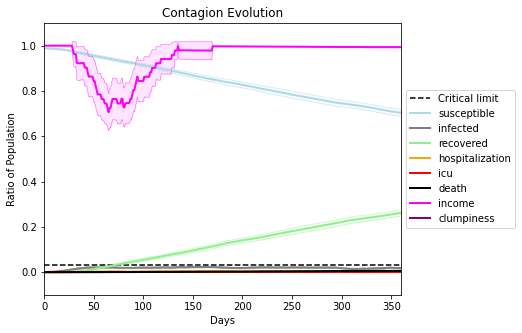

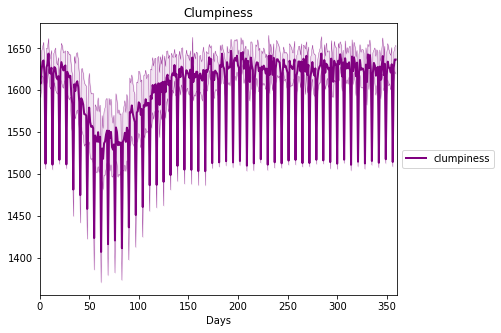

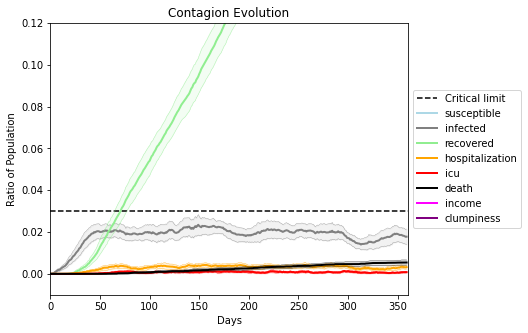

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6157, 2090, 4488, 3267, 8921, 2785, 732, 6329, 3626, 7602, 910, 8833, 5204, 5248, 9630, 6323, 1464, 1055, 5551, 2168]
Average similarity between family members is 0.974451519865938 at temperature -0.999
Average similarity between family and home is 0.99985908527516 at temperature -1
Average similarity between students and their classroom is 0.9704320346255478 at temperature -0.999
Average classroom occupancy is 1.716763005780347 and number classrooms is 173
Average similarity between workers is 0.9727786479632649 at temperature -0.999
Average office occupancy is 3.546961325966851 and number offices is 181
Average friend similarity for adults: 0.8567948433090583 for kids: 0.7468897423130612
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.7296454993081818
avg restaurant similarity 0.725047212738524
avg restaurant similarity 0.6463256011251552
avg restaurant similarity 0.8335094781294538
avg restaurant similarity 0.5780835600909298
avg restaurant similarity 0.5298379568052968
avg restaurant similarity 0.6061762028439337
avg restaurant similarity 0.35823841079023666
avg restaurant similarity 0.7664545351995043
avg restaurant similarity 0.754362071591523
avg restaurant similarity 0.6216186722088205
avg restaurant similarity 0.9283294542670129
avg restaurant similarity 0.3368780102232465
avg restaurant similarity 0.7270910488024186
avg restaurant similarity 0.9417416162656824
avg restaurant similarity 0.5983779665627426
avg restaurant similarity 0.4845981459277482
avg restaurant similarity 0.9995826792713898
avg restaurant similarity 0.5843099228882861
avg restaurant similarity 0.35823841079023666
avg restaurant similarity 0.877852573717808
avg restaurant similarity 0.9995068192239385
avg restaur

avg restaurant similarity 0.28951351613585646
avg restaurant similarity 0.5242731319058689
avg restaurant similarity 0.44876597631260473
avg restaurant similarity 0.7024707305258736
avg restaurant similarity 0.9997394882230393
avg restaurant similarity 0.8315570902106271
avg restaurant similarity 0.915207543120124
avg restaurant similarity 0.9152922026945728
avg restaurant similarity 0.9998020865822539
avg restaurant similarity 0.6401589915502599
avg restaurant similarity 0.5849559262368598
avg restaurant similarity 0.6305707130239113
avg restaurant similarity 0.7445446794009466
avg restaurant similarity 0.35823841079023666
avg restaurant similarity 0.2939411044148279
avg restaurant similarity 0.5298379568052968
avg restaurant similarity 0.6778178363331124
avg restaurant similarity 0.9416049138238702
avg restaurant similarity 0.5975723129293776
avg restaurant similarity 0.6311826111470792
avg restaurant similarity 0.6216130253955772
avg restaurant similarity 0.5685782947891109
avg rest

avg restaurant similarity 0.6474796239556593
avg restaurant similarity 0.40455328424870446
avg restaurant similarity 0.825441653058402
avg restaurant similarity 0.6298534442698153
avg restaurant similarity 0.4577581508150937
avg restaurant similarity 0.999602466039109
avg restaurant similarity 0.9997515709495142
avg restaurant similarity 0.588366957884362
avg restaurant similarity 0.8039838995221817
avg restaurant similarity 0.8880680202250897
avg restaurant similarity 0.6071434621966268
avg restaurant similarity 0.3129559302346143
avg restaurant similarity 0.7786345512638823
avg restaurant similarity 0.7583294255150856
avg restaurant similarity 0.6181419629508913
avg restaurant similarity 0.8554190808500373
avg restaurant similarity 0.8837847518207705
avg restaurant similarity 0.5755327663222924
avg restaurant similarity 0.7591729279254553
avg restaurant similarity 0.6529579191261412
avg restaurant similarity 0.8549018169852711
avg restaurant similarity 0.690680860576548
avg restauran

avg restaurant similarity 0.5655135146144058
avg restaurant similarity 0.6450941653672909
avg restaurant similarity 0.5384788320181795
avg restaurant similarity 0.5470462050258806
avg restaurant similarity 0.7520146097355414
avg restaurant similarity 0.8807218874945218
avg restaurant similarity 0.7118383289545068
avg restaurant similarity 0.8861289604473505
avg restaurant similarity 0.8811194214554128
avg restaurant similarity 0.4978332930809864
avg restaurant similarity 0.5327307500232972
avg restaurant similarity 0.3896554822784134
avg restaurant similarity 0.7468280745726751
avg restaurant similarity 0.4086400374661152
avg restaurant similarity 0.5463437185551552
avg restaurant similarity 0.5168992355566309
avg restaurant similarity 0.5317756931162174
Average similarity between family members is 0.9674610526639639 at temperature -0.999
Average similarity between family and home is 0.999850347521377 at temperature -1
Average similarity between students and their classroom is 0.969971

avg restaurant similarity 0.6131446068759037
avg restaurant similarity 0.5647485650620138
avg restaurant similarity 0.5217276632467994
avg restaurant similarity 0.619455975115844
avg restaurant similarity 0.5444509967553349
avg restaurant similarity 0.618994352314148
avg restaurant similarity 0.8856265402754375
avg restaurant similarity 0.6759688671807547
avg restaurant similarity 0.47122562085108033
avg restaurant similarity 0.8601176049346407
avg restaurant similarity 0.8297745372639483
avg restaurant similarity 0.5781427111046946
avg restaurant similarity 0.8394156428197803
avg restaurant similarity 0.7115219157232043
avg restaurant similarity 0.5447002270395552
avg restaurant similarity 0.8261905948950811
avg restaurant similarity 0.9568459875501226
avg restaurant similarity 0.8760339763614514
avg restaurant similarity 0.3423109477945231
avg restaurant similarity 0.8120777494694728
avg restaurant similarity 0.8839831342942959
avg restaurant similarity 0.6681589001119186
avg restaur

avg restaurant similarity 0.3595501671944583
avg restaurant similarity 0.3588434556776464
avg restaurant similarity 0.8008423528206264
avg restaurant similarity 0.8261158613431817
avg restaurant similarity 0.3549607024891891
avg restaurant similarity 0.9147721735351491
avg restaurant similarity 0.8973966196285825
avg restaurant similarity 0.5056334133070284
avg restaurant similarity 0.5462276535811335
avg restaurant similarity 0.7040175807084205
avg restaurant similarity 0.9996667381410409
avg restaurant similarity 0.5060047411827873
avg restaurant similarity 0.3945347914669361
avg restaurant similarity 0.8298971409246819
avg restaurant similarity 0.7409146372001181
avg restaurant similarity 0.3365976469805607
avg restaurant similarity 0.8261905948950811
avg restaurant similarity 0.7467740145047235
avg restaurant similarity 0.5148276837705114
avg restaurant similarity 0.827424754497751
avg restaurant similarity 0.7769365406345492
avg restaurant similarity 0.7531394226501834
avg restaur

avg restaurant similarity 0.6600774137227804
avg restaurant similarity 0.5640746544245607
avg restaurant similarity 0.4959304827914323
avg restaurant similarity 0.6605969811132387
avg restaurant similarity 0.3857448458843693
avg restaurant similarity 0.6610692677579779
avg restaurant similarity 0.6574493820100284
avg restaurant similarity 0.3182757272462943
avg restaurant similarity 0.5083436323454871
avg restaurant similarity 0.695707016191746
avg restaurant similarity 0.6660494274534419
avg restaurant similarity 0.8146133677961991
avg restaurant similarity 0.8657653615973885
avg restaurant similarity 0.3869454763316295
avg restaurant similarity 0.6927170194054153
avg restaurant similarity 0.8489863142799419
avg restaurant similarity 0.4130389915890602
avg restaurant similarity 0.7603608274740541
avg restaurant similarity 0.561110437526621
avg restaurant similarity 0.399204585895502
avg restaurant similarity 0.5787475785836368
avg restaurant similarity 0.48356770624609013
avg restaura

avg restaurant similarity 0.8012534589524029
avg restaurant similarity 0.28265091698582273
avg restaurant similarity 0.5296844453062942
avg restaurant similarity 0.5618715691267592
avg restaurant similarity 0.6131346743043141
avg restaurant similarity 0.6306331588116164
avg restaurant similarity 0.5682176934470002
avg restaurant similarity 0.899722201543744
avg restaurant similarity 0.9998829469401018
avg restaurant similarity 0.612903749970716
avg restaurant similarity 0.7253482689183576
avg restaurant similarity 0.771726866047315
avg restaurant similarity 0.8690087083200186
avg restaurant similarity 0.6761834371534869
avg restaurant similarity 0.21566924915307215
avg restaurant similarity 0.5504577684716534
avg restaurant similarity 0.7057688446912646
avg restaurant similarity 0.5682176934470002
avg restaurant similarity 0.7316777665583988
avg restaurant similarity 0.3970156835853436
avg restaurant similarity 0.6868124417582073
avg restaurant similarity 0.9997045346919666
avg restaur

avg restaurant similarity 0.7726111265474721
avg restaurant similarity 0.6567252042536993
avg restaurant similarity 0.5541460520347878
avg restaurant similarity 0.5740261142135957
avg restaurant similarity 0.5997308853799758
avg restaurant similarity 0.5800782600166952
avg restaurant similarity 0.5134151308331498
avg restaurant similarity 0.9995394511568123
avg restaurant similarity 0.5237111177539391
avg restaurant similarity 0.5338126082348604
avg restaurant similarity 0.9996919944556172
avg restaurant similarity 0.596735481831059
avg restaurant similarity 0.6238954872083088
avg restaurant similarity 0.8994451190092634
avg restaurant similarity 0.7638468522517622
avg restaurant similarity 0.7718572416990058
avg restaurant similarity 0.6330332412811436
avg restaurant similarity 0.434703528736192
avg restaurant similarity 0.4608904146199636
avg restaurant similarity 0.5186842714067094
avg restaurant similarity 0.5487261300055369
avg restaurant similarity 0.6124861665141192
avg restaura

avg restaurant similarity 0.5415847313418589
avg restaurant similarity 0.6104735609069034
avg restaurant similarity 0.5165069867862926
avg restaurant similarity 0.5887505305500684
avg restaurant similarity 0.5487261300055369
avg restaurant similarity 0.816703173034737
avg restaurant similarity 0.6933411154618265
avg restaurant similarity 0.2625457702631784
avg restaurant similarity 0.3755830999023384
avg restaurant similarity 0.5713890052296613
avg restaurant similarity 0.6863141218893638
avg restaurant similarity 0.5840440846627242
avg restaurant similarity 0.5513962344872724
avg restaurant similarity 0.9066787148984993
Average similarity between family members is 0.9696769822891962 at temperature -0.999
Average similarity between family and home is 0.9998654091529197 at temperature -1
Average similarity between students and their classroom is 0.9678844793732786 at temperature -0.999
Average classroom occupancy is 1.745664739884393 and number classrooms is 173
Average similarity betwe

avg restaurant similarity 0.7756491313462937
avg restaurant similarity 0.9997866551684166
avg restaurant similarity 0.4732027977577707
avg restaurant similarity 0.6509064273590859
avg restaurant similarity 0.49143211952318144
avg restaurant similarity 0.9998632732380118
avg restaurant similarity 0.24690657964998522
avg restaurant similarity 0.6772899031887681
avg restaurant similarity 0.5261174420489266
avg restaurant similarity 0.4652731600262552
avg restaurant similarity 0.4907385350935189
avg restaurant similarity 0.7240292704758238
avg restaurant similarity 0.9998675137614544
avg restaurant similarity 0.7490120931001103
avg restaurant similarity 0.8207012162515032
avg restaurant similarity 0.7281454820461332
avg restaurant similarity 0.6962765949388391
avg restaurant similarity 0.7455350530485175
avg restaurant similarity 0.6844393870603867
avg restaurant similarity 0.32447841491182894
avg restaurant similarity 0.6733238851670981
avg restaurant similarity 0.8941597286633464
avg res

avg restaurant similarity 0.9996379865738536
avg restaurant similarity 0.38384274682787406
avg restaurant similarity 0.9997624845293268
avg restaurant similarity 0.3254972269521827
avg restaurant similarity 0.33010336912692656
avg restaurant similarity 0.745571129780378
avg restaurant similarity 0.5083119234587885
avg restaurant similarity 0.9998675137614544
avg restaurant similarity 0.8630802692859498
avg restaurant similarity 0.3299294633949006
avg restaurant similarity 0.8893194165981775
avg restaurant similarity 0.9997101400375745
avg restaurant similarity 0.43524654230358045
avg restaurant similarity 0.5944082801866363
avg restaurant similarity 0.5445365424084211
avg restaurant similarity 0.6902570074156011
avg restaurant similarity 0.5047916257015373
avg restaurant similarity 0.3275475733044102
avg restaurant similarity 0.6074006344214439
avg restaurant similarity 0.9108912912519129
avg restaurant similarity 0.4959902995127005
avg restaurant similarity 0.3299294633949006
avg rest

avg restaurant similarity 0.6193296605395607
avg restaurant similarity 0.6182275429437284
avg restaurant similarity 0.6896676131641998
avg restaurant similarity 0.5944253761314925
avg restaurant similarity 0.9998589714528279
avg restaurant similarity 0.6453179575170386
avg restaurant similarity 0.6892703269179072
avg restaurant similarity 0.5921685755186902
avg restaurant similarity 0.8659979715543548
avg restaurant similarity 0.4205588337461198
avg restaurant similarity 0.6170144532735177
avg restaurant similarity 0.9998127853805447
avg restaurant similarity 0.5931344370073031
avg restaurant similarity 0.3914842272795753
avg restaurant similarity 0.7731375841884596
avg restaurant similarity 0.814924950584516
avg restaurant similarity 0.9998525163233218
avg restaurant similarity 0.6696046562264902
avg restaurant similarity 0.9997383622744942
avg restaurant similarity 0.5086968220898105
avg restaurant similarity 0.9998376222745519
avg restaurant similarity 0.6122658559662119
avg restaur

avg restaurant similarity 0.6466450321933699
avg restaurant similarity 0.6191472722698805
avg restaurant similarity 0.8507946453867499
avg restaurant similarity 0.6458785753860332
avg restaurant similarity 0.634867500597939
avg restaurant similarity 0.6711131800925478
avg restaurant similarity 0.5638384666948517
avg restaurant similarity 0.6978883480187761
avg restaurant similarity 0.497787175208545
avg restaurant similarity 0.5667239466841059
avg restaurant similarity 0.760233876978647
avg restaurant similarity 0.7943611094498245
avg restaurant similarity 0.913191237212834
avg restaurant similarity 0.9145469485092077
avg restaurant similarity 0.6356342922430751
avg restaurant similarity 0.6186262621836809
avg restaurant similarity 0.6354341494463023
avg restaurant similarity 0.5386396809725568
avg restaurant similarity 0.6335388715660848
avg restaurant similarity 0.6945919476466293
avg restaurant similarity 0.6613484337704996
avg restaurant similarity 0.6988833248817092
avg restaurant

avg restaurant similarity 0.8859927260411233
avg restaurant similarity 0.7082250073263376
avg restaurant similarity 0.8608612091506942
avg restaurant similarity 0.6365958257851654
avg restaurant similarity 0.6312708885969088
avg restaurant similarity 0.6732408104341894
avg restaurant similarity 0.9440115144986989
avg restaurant similarity 0.5765340977754774
avg restaurant similarity 0.9997881925956312
avg restaurant similarity 0.6975729305241444
avg restaurant similarity 0.9306825136744739
avg restaurant similarity 0.4948200739517574
avg restaurant similarity 0.687114762708836
avg restaurant similarity 0.7287174241809081
avg restaurant similarity 0.6915371062375039
avg restaurant similarity 0.6470963685548182
avg restaurant similarity 0.47702576668126606
avg restaurant similarity 0.8789217665801417
avg restaurant similarity 0.7906732090902651
avg restaurant similarity 0.365544640034094
avg restaurant similarity 0.5823141621528577
avg restaurant similarity 0.8160406878407698
avg restaur

avg restaurant similarity 0.9997865232163325
avg restaurant similarity 0.629182097092639
avg restaurant similarity 0.6160582448623269
avg restaurant similarity 0.5112209939582081
avg restaurant similarity 0.7053184354800759
avg restaurant similarity 0.47100718428317195
avg restaurant similarity 0.9183103416279648
avg restaurant similarity 0.6732955032745572
avg restaurant similarity 0.999798333678231
avg restaurant similarity 0.8763433277951551
avg restaurant similarity 0.7219595147893236
avg restaurant similarity 0.1698968066541093
avg restaurant similarity 0.6129873148731526
avg restaurant similarity 0.6190256819041804
avg restaurant similarity 0.6470963685548182
avg restaurant similarity 0.5772461330723263
avg restaurant similarity 0.9998012192617358
avg restaurant similarity 0.6822678854314894
avg restaurant similarity 0.48283924942311407
avg restaurant similarity 0.5714742036905023
avg restaurant similarity 0.6951639716676128
avg restaurant similarity 0.6648548972258518
avg restau

avg restaurant similarity 0.6654063638948136
avg restaurant similarity 0.5674847245844017
avg restaurant similarity 0.8656345083177667
avg restaurant similarity 0.6821547647909308
avg restaurant similarity 0.7348226921355739
avg restaurant similarity 0.7148041740354373
avg restaurant similarity 0.8101797762242076
avg restaurant similarity 0.6825889253489505
avg restaurant similarity 0.6464547473301183
avg restaurant similarity 0.5946169229649445
avg restaurant similarity 0.5016527024478926
avg restaurant similarity 0.4659233406623401
avg restaurant similarity 0.8396058269167556
avg restaurant similarity 0.7988129421082266
avg restaurant similarity 0.5955375216529641
avg restaurant similarity 0.6665348439064839
avg restaurant similarity 0.7669472339431872
avg restaurant similarity 0.5633700671879585
avg restaurant similarity 0.9996384082456091
avg restaurant similarity 0.7567543538502531
avg restaurant similarity 0.8136864121909111
avg restaurant similarity 0.8986593357850245
avg restau

avg restaurant similarity 0.803938599705185
avg restaurant similarity 0.54164805166771
avg restaurant similarity 0.8979133515754543
avg restaurant similarity 0.7182076794673218
avg restaurant similarity 0.5394839594172656
avg restaurant similarity 0.8119573261260018
avg restaurant similarity 0.7580302391450691
avg restaurant similarity 0.5903228165500296
avg restaurant similarity 0.6966959231222464
avg restaurant similarity 0.7359736424570127
avg restaurant similarity 0.8981080379816171
avg restaurant similarity 0.5601634351112487
avg restaurant similarity 0.7016700184147044
avg restaurant similarity 0.8077026259115891
avg restaurant similarity 0.7810629105317357
avg restaurant similarity 0.5370272515490642
avg restaurant similarity 0.7988947635686909
avg restaurant similarity 0.679735964479331
avg restaurant similarity 0.537604175900268
avg restaurant similarity 0.548387664433377
avg restaurant similarity 0.7584594100068149
avg restaurant similarity 0.8351769904749621
avg restaurant s

avg restaurant similarity 0.7413178901247697
avg restaurant similarity 0.999678250069655
avg restaurant similarity 0.9998322365895014
avg restaurant similarity 0.5553278133210415
avg restaurant similarity 0.9997848590681466
avg restaurant similarity 0.7896601905369132
avg restaurant similarity 0.9998322365895014
avg restaurant similarity 0.9998322365895014
avg restaurant similarity 0.6907220760984325
avg restaurant similarity 0.5933593198997076
avg restaurant similarity 0.9997560467399944
avg restaurant similarity 0.9998220722199688
avg restaurant similarity 0.5980438791902372
avg restaurant similarity 0.6151734565276621
avg restaurant similarity 0.7670243826349776
avg restaurant similarity 0.7321408907296125
avg restaurant similarity 0.6999396684690604
avg restaurant similarity 0.9439765169020228
avg restaurant similarity 0.7229764666985252
avg restaurant similarity 0.6737688836728668
avg restaurant similarity 0.8632006356675037
avg restaurant similarity 0.7207561716773472
avg restaur

avg restaurant similarity 0.44275546388893056
avg restaurant similarity 0.609853328074522
avg restaurant similarity 0.5087111339107336
avg restaurant similarity 0.7076927189191932
avg restaurant similarity 0.8704993089883722
avg restaurant similarity 0.564748009896329
avg restaurant similarity 0.48491435085926254
avg restaurant similarity 0.5517277293116235
avg restaurant similarity 0.863659763172673
avg restaurant similarity 0.8385876674770905
avg restaurant similarity 0.7612442511523507
avg restaurant similarity 0.47340242488853435
avg restaurant similarity 0.5661615728925933
avg restaurant similarity 0.419525498263583
avg restaurant similarity 0.5198410104540502
avg restaurant similarity 0.32725851584606686
avg restaurant similarity 0.3759573941598191
avg restaurant similarity 0.48491435085926254
avg restaurant similarity 0.7403619389778914
avg restaurant similarity 0.7091976291851743
avg restaurant similarity 0.6155158734155567
avg restaurant similarity 0.3426831732557644
avg resta

avg restaurant similarity 0.5531596722995171
avg restaurant similarity 0.5456748471023926
avg restaurant similarity 0.905750010359331
avg restaurant similarity 0.6110160356584005
avg restaurant similarity 0.5099007180919548
avg restaurant similarity 0.6889811631197216
avg restaurant similarity 0.7914935998118956
avg restaurant similarity 0.4733104107441874
avg restaurant similarity 0.5858036315731032
avg restaurant similarity 0.8176259996188842
avg restaurant similarity 0.6608859241482878
avg restaurant similarity 0.6210654222484988
avg restaurant similarity 0.6453022416775999
avg restaurant similarity 0.8116155649299199
avg restaurant similarity 0.6251791406047911
avg restaurant similarity 0.5837433539982025
avg restaurant similarity 0.9996670133831385
avg restaurant similarity 0.9997945197368592
avg restaurant similarity 0.3160253138011567
avg restaurant similarity 0.5809142464221196
avg restaurant similarity 0.7093544115638458
avg restaurant similarity 0.49888821522723414
avg restau

avg restaurant similarity 0.44460994784802704
avg restaurant similarity 0.9997748244139346
avg restaurant similarity 0.5160084572941251
avg restaurant similarity 0.37467933555794014
avg restaurant similarity 0.5687560751470682
avg restaurant similarity 0.7495673412684508
avg restaurant similarity 0.5393181955541547
avg restaurant similarity 0.5699270722128629
avg restaurant similarity 0.8352478668156612
avg restaurant similarity 0.7220199719849056
avg restaurant similarity 0.7449064743105163
avg restaurant similarity 0.4088830099847671
avg restaurant similarity 0.5675469357490384
avg restaurant similarity 0.3985387546406455
avg restaurant similarity 0.6784650857917293
avg restaurant similarity 0.8303797293967997
avg restaurant similarity 0.632865230050149
avg restaurant similarity 0.664764491759888
avg restaurant similarity 0.32204005413584263
avg restaurant similarity 0.7746584557019077
avg restaurant similarity 0.8128884044779503
avg restaurant similarity 0.6235731805271048
avg resta

avg restaurant similarity 0.5978641134961147
avg restaurant similarity 0.7056421747480566
avg restaurant similarity 0.38127721576128365
avg restaurant similarity 0.7162097520580475
avg restaurant similarity 0.5687560751470682
avg restaurant similarity 0.5349789058322376
avg restaurant similarity 0.9998463274577603
avg restaurant similarity 0.9189898532023145
avg restaurant similarity 0.7242853333323069
avg restaurant similarity 0.6045746349364822
avg restaurant similarity 0.5487464147965688
avg restaurant similarity 0.5687560751470682
avg restaurant similarity 0.5780213745622629
avg restaurant similarity 0.9067377536608902
avg restaurant similarity 0.7651922511490132
avg restaurant similarity 0.7646398709782494
avg restaurant similarity 0.7898100092065438
avg restaurant similarity 0.6807220574317343
avg restaurant similarity 0.5255303333602965
avg restaurant similarity 0.5525575774730072
avg restaurant similarity 0.766548892006081
avg restaurant similarity 0.6300769038953495
avg restau

avg restaurant similarity 0.585541014930833
avg restaurant similarity 0.43958078285344343
avg restaurant similarity 0.4051517646717769
avg restaurant similarity 0.5626248416129024
avg restaurant similarity 0.803202720653785
avg restaurant similarity 0.872772368056933
avg restaurant similarity 0.7315842669909447
avg restaurant similarity 0.9402619889377585
avg restaurant similarity 0.8783274143852067
avg restaurant similarity 0.7180887632102149
avg restaurant similarity 0.7205455193073879
avg restaurant similarity 0.8356048102961289
avg restaurant similarity 0.9997720361522099
avg restaurant similarity 0.2944785375240153
avg restaurant similarity 0.3429138759237008
avg restaurant similarity 0.8633891626673025
avg restaurant similarity 0.7397390457948319
avg restaurant similarity 0.8389403940500959
avg restaurant similarity 0.8389098602050551
avg restaurant similarity 0.6429864813096922
avg restaurant similarity 0.9045416102345933
avg restaurant similarity 0.7687519077354605
avg restaura

avg restaurant similarity 0.5234646492129027
avg restaurant similarity 0.8797879141293187
avg restaurant similarity 0.971115136732346
avg restaurant similarity 0.7302500328367911
avg restaurant similarity 0.7049515324786402
avg restaurant similarity 0.7177437268969118
avg restaurant similarity 0.23987193317611835
avg restaurant similarity 0.8654134681283714
avg restaurant similarity 0.8207309913793717
avg restaurant similarity 0.7199685771270761
avg restaurant similarity 0.5325062871857144
avg restaurant similarity 0.3294729886190309
avg restaurant similarity 0.43319021678982805
avg restaurant similarity 0.4607187300723241
avg restaurant similarity 0.892146510724299
avg restaurant similarity 0.6818443329740473
avg restaurant similarity 0.6778105432820969
avg restaurant similarity 0.6186114971318005
avg restaurant similarity 0.6953316712927129
avg restaurant similarity 0.8837875888720448
avg restaurant similarity 0.8821555734465634
avg restaurant similarity 0.6060520904960273
avg restau

avg restaurant similarity 0.3243248050743576
avg restaurant similarity 0.9057515981832222
avg restaurant similarity 0.6751211877189095
avg restaurant similarity 0.7912553675237406
avg restaurant similarity 0.7618987096692
avg restaurant similarity 0.5130312862177666
avg restaurant similarity 0.9997264465078591
avg restaurant similarity 0.48399505482574734
avg restaurant similarity 0.5556671379111323
avg restaurant similarity 0.8053497754215742
avg restaurant similarity 0.5713470416021145
avg restaurant similarity 0.8736611586088326
avg restaurant similarity 0.44548699155624816
avg restaurant similarity 0.6227526584198315
avg restaurant similarity 0.9996223449766319
avg restaurant similarity 0.8128858653764914
avg restaurant similarity 0.2974243290304397
avg restaurant similarity 0.5326189109164495
avg restaurant similarity 0.9995319985175499
avg restaurant similarity 0.687869903479163
avg restaurant similarity 0.7861050439919732
avg restaurant similarity 0.4666056598263057
avg restaura

avg restaurant similarity 0.7042978695682856
avg restaurant similarity 0.4124975928391479
avg restaurant similarity 0.9998602065825875
avg restaurant similarity 0.564429925440358
avg restaurant similarity 0.3877781510742504
avg restaurant similarity 0.8587797465223597
avg restaurant similarity 0.6143188757374309
avg restaurant similarity 0.40670237959625233
avg restaurant similarity 0.5598391025543301
avg restaurant similarity 0.6413450633097892
avg restaurant similarity 0.8975474773253787
avg restaurant similarity 0.9393928718671802
avg restaurant similarity 0.6426697736880382
avg restaurant similarity 0.9998766074539811
avg restaurant similarity 0.7450900106471565
avg restaurant similarity 0.8155300844297333
avg restaurant similarity 0.5561066881848199
avg restaurant similarity 0.8201466652049588
avg restaurant similarity 0.9993781160468089
avg restaurant similarity 0.6134288873544943
avg restaurant similarity 0.8670617177135762
avg restaurant similarity 0.9056678178729781
avg restau

avg restaurant similarity 0.805070037769656
avg restaurant similarity 0.40030851790701893
avg restaurant similarity 0.47247662486615616
avg restaurant similarity 0.30666658949305553
avg restaurant similarity 0.9997845414606762
avg restaurant similarity 0.589034435896423
avg restaurant similarity 0.3111905594105035
avg restaurant similarity 0.9998239165394698
avg restaurant similarity 0.7681358327009821
avg restaurant similarity 0.5865553418123397
avg restaurant similarity 0.30588321283754516
avg restaurant similarity 0.75387411003389
avg restaurant similarity 0.31074618985802566
avg restaurant similarity 0.30588321283754516
avg restaurant similarity 0.6796660444896869
avg restaurant similarity 0.5034373465942459
avg restaurant similarity 0.914141837576822
avg restaurant similarity 0.5134779086435006
avg restaurant similarity 0.6099950024161835
avg restaurant similarity 0.5531747305538579
avg restaurant similarity 0.10948199407543059
avg restaurant similarity 0.9090541998006054
avg rest

avg restaurant similarity 0.4623457523864544
avg restaurant similarity 0.48145301295049914
avg restaurant similarity 0.30666658949305553
avg restaurant similarity 0.6392396890936806
Average similarity between family members is 0.9712929291813928 at temperature -0.999
Average similarity between family and home is 0.9998483106458844 at temperature -1
Average similarity between students and their classroom is 0.9678762433808779 at temperature -0.999
Average classroom occupancy is 1.7076023391812865 and number classrooms is 171
Average similarity between workers is 0.9686755980604325 at temperature -0.999
Average office occupancy is 3.510869565217391 and number offices is 184
Average friend similarity for adults: 0.8604626552370063 for kids: 0.7446807998974851
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.6294775763671162
avg restaurant similarity 0.5636776742081152
avg restaurant similarity 0.6192833747278161
avg restaurant similarity 0.8968992074870328
avg restaurant similarity 0.5616045932431255
avg restaurant similarity 0.6588130267458201
avg restaurant similarity 0.7004456072586323
avg restaurant similarity 0.5898361638330499
avg restaurant similarity 0.9996659478584611
avg restaurant similarity 0.5636776742081152
avg restaurant similarity 0.8787151539561502
avg restaurant similarity 0.5607538908161083
avg restaurant similarity 0.6758545975443615
avg restaurant similarity 0.6020376832941815
avg restaurant similarity 0.34561729906380295
avg restaurant similarity 0.7809831052001692
avg restaurant similarity 0.7518144232346629
avg restaurant similarity 0.5188777531792725
avg restaurant similarity 0.508607805726094
avg restaurant similarity 0.593990297155996
avg restaurant similarity 0.5599745069822534
avg restaurant similarity 0.8487869889656063
avg restaur

avg restaurant similarity 0.6545476063608222
avg restaurant similarity 0.5901491833499419
avg restaurant similarity 0.6645118903958498
avg restaurant similarity 0.5651255316822639
avg restaurant similarity 0.6136587799356775
avg restaurant similarity 0.6448316439136803
avg restaurant similarity 0.6980390142158948
avg restaurant similarity 0.758114753763825
avg restaurant similarity 0.5626435386698048
avg restaurant similarity 0.6699713110862702
avg restaurant similarity 0.6184901282407884
avg restaurant similarity 0.6126754397888532
avg restaurant similarity 0.5054577192723607
avg restaurant similarity 0.9995494790490433
avg restaurant similarity 0.5161540904384236
avg restaurant similarity 0.6792559062253036
avg restaurant similarity 0.5636776742081152
avg restaurant similarity 0.9995349637153179
avg restaurant similarity 0.5636776742081152
avg restaurant similarity 0.6153134312161492
avg restaurant similarity 0.555432295912697
avg restaurant similarity 0.7948939144117884
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

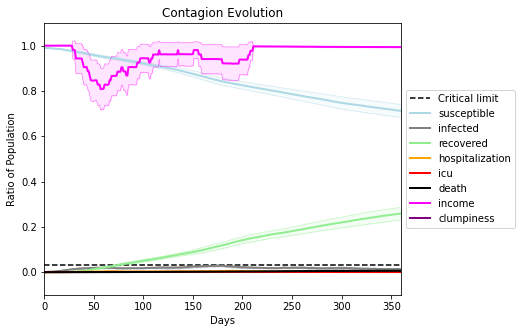

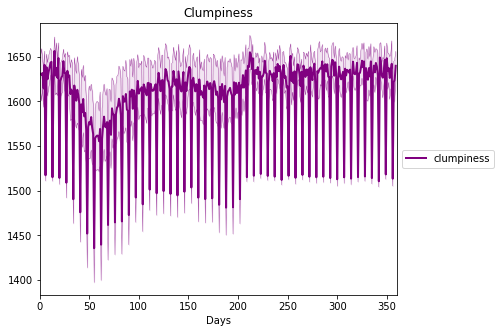

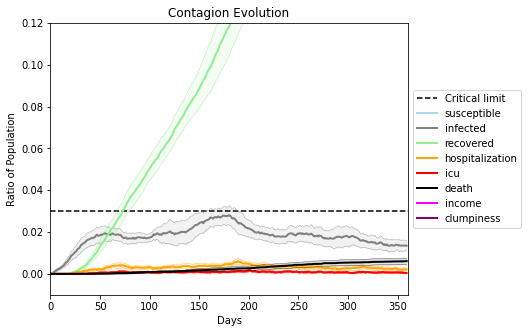

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3485, 6193, 1268, 826, 6317, 1745, 1312, 3077, 6043, 9142, 9810, 33, 7756, 8443, 7201, 6620, 2562, 4834, 1406, 2965]
Average similarity between family members is 0.9707745898227818 at temperature -0.998
Average similarity between family and home is 0.9998453416898488 at temperature -1
Average similarity between students and their classroom is 0.9599099555149443 at temperature -0.998
Average classroom occupancy is 1.6358381502890174 and number classrooms is 173
Average similarity between workers is 0.9581037281806635 at temperature -0.998
Average office occupancy is 3.612021857923497 and number offices is 183
Average friend similarity for adults: 0.8658206209845792 for kids: 0.7371616598435298
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.520991718370512
avg restaurant similarity 0.9024647192164238
avg restaurant similarity 0.9996902490950368
avg restaurant similarity 0.5222214662370086
avg restaurant similarity 0.891906524595022
avg restaurant similarity 0.7502266374955959
avg restaurant similarity 0.5201091622185997
avg restaurant similarity 0.563933070528693
avg restaurant similarity 0.7465351861024992
avg restaurant similarity 0.7210336075694594
avg restaurant similarity 0.752727567199646
avg restaurant similarity 0.5275695332584428
avg restaurant similarity 0.6287143326438684
avg restaurant similarity 0.999851295809123
avg restaurant similarity 0.8617119344192785
avg restaurant similarity 0.49623235158879164
avg restaurant similarity 0.9997802211285727
avg restaurant similarity 0.699067374839219
avg restaurant similarity 0.612039911326824
avg restaurant similarity 0.5732594439549741
avg restaurant similarity 0.701308000144264
avg restaurant similarity 0.5394186287914725
avg restaurant si

avg restaurant similarity 0.686490162052736
avg restaurant similarity 0.718892782369126
avg restaurant similarity 0.9997854053908364
avg restaurant similarity 0.6151588808820606
avg restaurant similarity 0.5826831540089581
avg restaurant similarity 0.9084162942062569
avg restaurant similarity 0.7357674387302475
avg restaurant similarity 0.605449327358875
avg restaurant similarity 0.7069522405663377
avg restaurant similarity 0.718892782369126
avg restaurant similarity 0.7150841008826049
avg restaurant similarity 0.6835392580753197
avg restaurant similarity 0.4268022233952046
avg restaurant similarity 0.625161648675618
avg restaurant similarity 0.8648849888029938
avg restaurant similarity 0.6093370214194581
avg restaurant similarity 0.9997929279585454
avg restaurant similarity 0.9998182665155424
avg restaurant similarity 0.718892782369126
avg restaurant similarity 0.38350898440420517
avg restaurant similarity 0.6095371662204997
avg restaurant similarity 0.9997394790332601
avg restaurant 

avg restaurant similarity 0.8959954182186394
avg restaurant similarity 0.6394795907441928
avg restaurant similarity 0.6185191284070526
avg restaurant similarity 0.6322050241566969
avg restaurant similarity 0.601960092552117
avg restaurant similarity 0.8125557087069577
avg restaurant similarity 0.8960291672489994
avg restaurant similarity 0.5244573438802818
avg restaurant similarity 0.5518441844694253
avg restaurant similarity 0.607451466299096
avg restaurant similarity 0.9068675991501532
avg restaurant similarity 0.8084086725561663
avg restaurant similarity 0.9998079532888162
avg restaurant similarity 0.7382787996222112
avg restaurant similarity 0.9998217948395975
avg restaurant similarity 0.7396779043393411
avg restaurant similarity 0.28083610383448787
avg restaurant similarity 0.9998217948395975
avg restaurant similarity 0.9996749183069595
avg restaurant similarity 0.4903947371191067
avg restaurant similarity 0.5642070627913325
avg restaurant similarity 0.8628119207086682
avg restaur

avg restaurant similarity 0.7012398048121911
avg restaurant similarity 0.6247434004848497
avg restaurant similarity 0.7301875959838227
avg restaurant similarity 0.7310777107298714
avg restaurant similarity 0.9059982218428537
avg restaurant similarity 0.49440312295078137
avg restaurant similarity 0.7776128520761624
avg restaurant similarity 0.6665658840937586
avg restaurant similarity 0.49440312295078137
avg restaurant similarity 0.9997066935464057
avg restaurant similarity 0.5662852835951538
avg restaurant similarity 0.6043752784939096
avg restaurant similarity 0.5220658067476206
avg restaurant similarity 0.9997185382409092
avg restaurant similarity 0.8127430752846121
avg restaurant similarity 0.8797880355926343
avg restaurant similarity 0.6323351858018786
avg restaurant similarity 0.4764690926816308
avg restaurant similarity 0.6827151517751346
avg restaurant similarity 0.5627229796683646
avg restaurant similarity 0.6261624443981719
avg restaurant similarity 0.5217052048138487
avg rest

avg restaurant similarity 0.6829934696576243
avg restaurant similarity 0.6107964002842904
avg restaurant similarity 0.5602936595412811
avg restaurant similarity 0.4738848671147084
avg restaurant similarity 0.48826773575266674
avg restaurant similarity 0.6458215125247146
avg restaurant similarity 0.9997714283778112
avg restaurant similarity 0.7244056709818157
avg restaurant similarity 0.8859931939045971
avg restaurant similarity 0.6645993190306856
Average similarity between family members is 0.9731515608226088 at temperature -0.998
Average similarity between family and home is 0.9998595333928627 at temperature -1
Average similarity between students and their classroom is 0.9750633094075911 at temperature -0.998
Average classroom occupancy is 1.7100591715976332 and number classrooms is 169
Average similarity between workers is 0.9571596883217041 at temperature -0.998
Average office occupancy is 3.5531914893617023 and number offices is 188
Average friend similarity for adults: 0.858059883

avg restaurant similarity 0.44230406262467603
avg restaurant similarity 0.7203975672412462
avg restaurant similarity 0.5262488039854031
avg restaurant similarity 0.44665037211733627
avg restaurant similarity 0.6842370715141012
avg restaurant similarity 0.6025472601868195
avg restaurant similarity 0.8098577175218309
avg restaurant similarity 0.4989704795897883
avg restaurant similarity 0.4459559927790865
avg restaurant similarity 0.795063208515294
avg restaurant similarity 0.44665037211733627
avg restaurant similarity 0.4598614075538935
avg restaurant similarity 0.17027491352878765
avg restaurant similarity 0.9995928676103161
avg restaurant similarity 0.7981937746965777
avg restaurant similarity 0.7980514484156743
avg restaurant similarity 0.6394806959711214
avg restaurant similarity 0.30048002872840923
avg restaurant similarity 0.8266490711930634
avg restaurant similarity 0.999862246010099
avg restaurant similarity 0.6318037285531604
avg restaurant similarity 0.4928679090617549
avg res

avg restaurant similarity 0.6968783120431816
avg restaurant similarity 0.8529802485760547
avg restaurant similarity 0.7114760034318692
avg restaurant similarity 0.5063861702448369
avg restaurant similarity 0.652359601579448
avg restaurant similarity 0.4469135836673953
avg restaurant similarity 0.5003630250647283
avg restaurant similarity 0.5545481971266984
avg restaurant similarity 0.4744804857799041
avg restaurant similarity 0.5166993691276704
avg restaurant similarity 0.642711396499881
avg restaurant similarity 0.5625310570109174
avg restaurant similarity 0.704664750695082
avg restaurant similarity 0.8509461427455709
avg restaurant similarity 0.737278556187823
avg restaurant similarity 0.7903267704156383
avg restaurant similarity 0.5792945071295263
avg restaurant similarity 0.8509593249981824
avg restaurant similarity 0.6672635102817762
avg restaurant similarity 0.7042639429643319
avg restaurant similarity 0.6347847707871512
avg restaurant similarity 0.5774425063952329
avg restaurant

Average friend similarity for adults: 0.8673567647204016 for kids: 0.7432967983739421
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.6483842339757884
avg restaurant similarity 0.5038903979069247
avg restaurant similarity 0.375180717834267
avg restaurant similarity 0.5440221211386287
avg restaurant similarity 0.5631447898685853
avg restaurant similarity 0.596642194921198
avg restaurant similarity 0.7708198108460711
avg restaurant similarity 0.5205670774386104
avg restaurant similarity 0.4996909508600029
avg restaurant similarity 0.39371963913813146
avg restaurant similarity 0.408304866850728
avg restaurant similarity 0.4819982353171373
avg restaurant similarity 0.45810078985162933
avg restaurant similarity 0.5599327349958251
avg restaurant similarity 0.7665502605836987
avg restaurant similarity 0.6759478951428038
avg restaurant similarity 0.999916666755689
avg restaurant similarity 0.7980833613549375
avg restaurant similarity 0.7287970499243126
avg restaurant similarity 0.9998310414496718
avg restaurant similarity 0.5027782768332932
avg restaurant similarity 0.5588697353819967
avg restaura

avg restaurant similarity 0.3959692121612207
avg restaurant similarity 0.7839609459581354
avg restaurant similarity 0.5021745638926716
avg restaurant similarity 0.5974099498579999
avg restaurant similarity 0.7182336510549688
avg restaurant similarity 0.6218134679657628
avg restaurant similarity 0.999841413765493
avg restaurant similarity 0.7568534078177254
avg restaurant similarity 0.5794959901126832
avg restaurant similarity 0.5647339834467633
avg restaurant similarity 0.4887835740032044
avg restaurant similarity 0.48557282062241325
avg restaurant similarity 0.5276785057499145
avg restaurant similarity 0.5670485891175696
avg restaurant similarity 0.6211332660793817
avg restaurant similarity 0.4991775014818769
avg restaurant similarity 0.7504377528380266
avg restaurant similarity 0.5120548732047412
avg restaurant similarity 0.9998457308864639
avg restaurant similarity 0.9155179399502313
avg restaurant similarity 0.5011590103111601
avg restaurant similarity 0.6202686414995493
avg restau

avg restaurant similarity 0.6980086299656761
avg restaurant similarity 0.6375053142693378
avg restaurant similarity 0.31334580347994667
avg restaurant similarity 0.4791427209775392
avg restaurant similarity 0.8619176766552531
avg restaurant similarity 0.26985535607445754
avg restaurant similarity 0.8181390423589197
avg restaurant similarity 0.5496408275095598
avg restaurant similarity 0.3506202478294683
avg restaurant similarity 0.7991118630360909
avg restaurant similarity 0.6712227685578869
avg restaurant similarity 0.6279757969721069
avg restaurant similarity 0.34562815725462515
avg restaurant similarity 0.8049177988031255
avg restaurant similarity 0.9997936674087735
avg restaurant similarity 0.5866933109080499
avg restaurant similarity 0.5850118768160857
avg restaurant similarity 0.5439303406570526
avg restaurant similarity 0.684283851928686
avg restaurant similarity 0.3506202478294683
avg restaurant similarity 0.7248525647558257
avg restaurant similarity 0.551342644740521
avg resta

avg restaurant similarity 0.8334809590248922
avg restaurant similarity 0.3518921588771291
avg restaurant similarity 0.5724445536427
avg restaurant similarity 0.8583468899495899
avg restaurant similarity 0.32799130922391023
avg restaurant similarity 0.861971988693859
avg restaurant similarity 0.23360253924850888
avg restaurant similarity 0.22949653618858057
avg restaurant similarity 0.6772936881122322
avg restaurant similarity 0.34562815725462515
avg restaurant similarity 0.3506202478294683
avg restaurant similarity 0.9997807479283045
avg restaurant similarity 0.35906611984978987
avg restaurant similarity 0.44653712850452193
avg restaurant similarity 0.2916403364785652
avg restaurant similarity 0.41839051392242704
Average similarity between family members is 0.9733097087451028 at temperature -0.998
Average similarity between family and home is 0.9998524144863883 at temperature -1
Average similarity between students and their classroom is 0.969614967599399 at temperature -0.998
Average c

avg restaurant similarity 0.5954608264609678
avg restaurant similarity 0.34341781495541074
avg restaurant similarity 0.7363787559700554
avg restaurant similarity 0.5891690517740666
avg restaurant similarity 0.8100221879938969
avg restaurant similarity 0.7050661605741849
avg restaurant similarity 0.4610146938209343
avg restaurant similarity 0.697754150504952
avg restaurant similarity 0.6189400868699795
avg restaurant similarity 0.39986322295595306
avg restaurant similarity 0.694245705261956
avg restaurant similarity 0.749671855478406
avg restaurant similarity 0.4660418287972011
avg restaurant similarity 0.2893076845696894
avg restaurant similarity 0.31816347526145927
avg restaurant similarity 0.655905290275749
avg restaurant similarity 0.6390765811071953
avg restaurant similarity 0.4171830397014315
avg restaurant similarity 0.37885037127896964
avg restaurant similarity 0.8389212512664381
avg restaurant similarity 0.5003963963774153
avg restaurant similarity 0.5701743677669797
avg restau

avg restaurant similarity 0.5997699576058905
avg restaurant similarity 0.7791979673988697
avg restaurant similarity 0.6125122626045539
avg restaurant similarity 0.5220743761804447
avg restaurant similarity 0.8471270297486269
avg restaurant similarity 0.9998557798950696
avg restaurant similarity 0.5658584289664879
avg restaurant similarity 0.5954126410770194
avg restaurant similarity 0.6318008171445976
avg restaurant similarity 0.45785338909181017
avg restaurant similarity 0.6134168160475928
avg restaurant similarity 0.7645447680657921
avg restaurant similarity 0.7535891957719324
avg restaurant similarity 0.6066349018118746
Average similarity between family members is 0.9730860456227639 at temperature -0.998
Average similarity between family and home is 0.9998624302351572 at temperature -1
Average similarity between students and their classroom is 0.9571809869633867 at temperature -0.998
Average classroom occupancy is 1.7307692307692308 and number classrooms is 156
Average similarity be

avg restaurant similarity 0.561944234285857
avg restaurant similarity 0.5881301355611424
avg restaurant similarity 0.4507817712469314
avg restaurant similarity 0.40526703969922706
avg restaurant similarity 0.9997607335128115
avg restaurant similarity 0.8874274636160955
avg restaurant similarity 0.8873968072469781
avg restaurant similarity 0.48034143315227007
avg restaurant similarity 0.3825991821758607
avg restaurant similarity 0.5480660579800853
avg restaurant similarity 0.48153054938066653
avg restaurant similarity 0.4641171171771826
avg restaurant similarity 0.4905278688840779
avg restaurant similarity 0.5634428853817693
avg restaurant similarity 0.4870203564915172
avg restaurant similarity 0.4889893920000126
avg restaurant similarity 0.9996634395585753
avg restaurant similarity 0.6876492318414087
avg restaurant similarity 0.8614978106005823
avg restaurant similarity 0.9998856273921327
avg restaurant similarity 0.5464336370314284
avg restaurant similarity 0.6454366872452537
avg rest

avg restaurant similarity 0.6514317114158157
avg restaurant similarity 0.9996396841610119
avg restaurant similarity 0.49496062290775256
avg restaurant similarity 0.546553397492983
avg restaurant similarity 0.8445783687852375
avg restaurant similarity 0.8156606235637918
avg restaurant similarity 0.6715366818080022
avg restaurant similarity 0.49093647079527697
avg restaurant similarity 0.9994803599733988
avg restaurant similarity 0.8445710574530845
avg restaurant similarity 0.5589250974498589
avg restaurant similarity 0.8947809105920074
avg restaurant similarity 0.7719370798259366
avg restaurant similarity 0.6668281123640148
avg restaurant similarity 0.4971833087752235
avg restaurant similarity 0.8355492623034978
avg restaurant similarity 0.5477928604181033
avg restaurant similarity 0.6728748107943987
avg restaurant similarity 0.6880205791467003
avg restaurant similarity 0.8345402788503099
avg restaurant similarity 0.9996396841610119
avg restaurant similarity 0.7499969230554472
avg resta

avg restaurant similarity 0.41704771266992635
avg restaurant similarity 0.4511302993094851
avg restaurant similarity 0.4417753897663607
avg restaurant similarity 0.6094895727462658
avg restaurant similarity 0.7322200739682785
avg restaurant similarity 0.7993730657126956
avg restaurant similarity 0.28842027662639336
avg restaurant similarity 0.4417753897663607
avg restaurant similarity 0.5062412870993646
avg restaurant similarity 0.7616636157135446
avg restaurant similarity 0.4417753897663607
avg restaurant similarity 0.4580059244286719
avg restaurant similarity 0.3403870209437968
avg restaurant similarity 0.8846098529395514
avg restaurant similarity 0.4417753897663607
avg restaurant similarity 0.9996677725362983
avg restaurant similarity 0.530977703248285
avg restaurant similarity 0.7153300209327507
avg restaurant similarity 0.9994706935963158
avg restaurant similarity 0.6136606811517373
avg restaurant similarity 0.3914466401012875
avg restaurant similarity 0.3578981454500186
avg resta

avg restaurant similarity 0.7524224520016136
avg restaurant similarity 0.8964930812704465
avg restaurant similarity 0.7144264644979796
avg restaurant similarity 0.9085137455754683
avg restaurant similarity 0.7508365095947728
avg restaurant similarity 0.48991447996453696
avg restaurant similarity 0.33168803330454383
avg restaurant similarity 0.9222509578190659
avg restaurant similarity 0.9998283908857637
avg restaurant similarity 0.48991447996453696
avg restaurant similarity 0.6035057755618762
avg restaurant similarity 0.6870755277561951
avg restaurant similarity 0.5682872008738997
avg restaurant similarity 0.6874102922756969
avg restaurant similarity 0.7839008762795656
avg restaurant similarity 0.274053139304412
avg restaurant similarity 0.6205929865823658
avg restaurant similarity 0.6870755277561951
avg restaurant similarity 0.5447958303470797
avg restaurant similarity 0.8240168177998529
avg restaurant similarity 0.6459177556568538
avg restaurant similarity 0.4275683370954192
avg rest

avg restaurant similarity 0.4492010418429184
avg restaurant similarity 0.6382762451502577
avg restaurant similarity 0.48117343125009004
avg restaurant similarity 0.8127980625481634
avg restaurant similarity 0.809853191099966
avg restaurant similarity 0.14622226438887626
avg restaurant similarity 0.6209941902007574
avg restaurant similarity 0.8378852320565571
avg restaurant similarity 0.5031278272885481
avg restaurant similarity 0.937450377613112
avg restaurant similarity 0.4772257626028955
avg restaurant similarity 0.7838938282307576
avg restaurant similarity 0.999897669539938
avg restaurant similarity 0.7075018371539873
avg restaurant similarity 0.5155485402409563
avg restaurant similarity 0.4711720382440343
avg restaurant similarity 0.8750960660403191
avg restaurant similarity 0.5214042442203743
avg restaurant similarity 0.54162096970577
avg restaurant similarity 0.6821860173868787
avg restaurant similarity 0.3903614712056154
avg restaurant similarity 0.38062727293609255
avg restaura

avg restaurant similarity 0.5627780325159023
avg restaurant similarity 0.6446542935384474
avg restaurant similarity 0.4781942550583219
avg restaurant similarity 0.5367576835498008
avg restaurant similarity 0.6239757664975836
avg restaurant similarity 0.855919360503512
avg restaurant similarity 0.26097116277384286
avg restaurant similarity 0.6535506911407888
avg restaurant similarity 0.4945477637169198
avg restaurant similarity 0.5461870865017133
avg restaurant similarity 0.6108129862762841
avg restaurant similarity 0.5972075259693933
avg restaurant similarity 0.9988272250724368
avg restaurant similarity 0.8254113584681457
avg restaurant similarity 0.9998000413027741
avg restaurant similarity 0.6414885991585826
avg restaurant similarity 0.54377687006871
avg restaurant similarity 0.5887743812348247
avg restaurant similarity 0.9999258296456595
avg restaurant similarity 0.46742900499174833
avg restaurant similarity 0.773831534541205
avg restaurant similarity 0.6691560141112239
avg restaura

Average friend similarity for adults: 0.8520529653931833 for kids: 0.7358062096442474
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.5392890660173807
avg restaurant similarity 0.7601068115516226
avg restaurant similarity 0.4480220187055546
avg restaurant similarity 0.6218415721278541
avg restaurant similarity 0.5368015604425643
avg restaurant similarity 0.6500369271413153
avg restaurant similarity 0.5868022037688991
avg restaurant similarity 0.5412968123438996
avg restaurant similarity 0.667346270322148
avg restaurant similarity 0.7407305356231837
avg restaurant similarity 0.5626712496555735
avg restaurant similarity 0.46367246858582767
avg restaurant similarity 0.7033208108654012
avg restaurant similarity 0.5715732802626767
avg restaurant similarity 0.5811866284542355
avg restaurant similarity 0.37860299110614765
avg restaurant similarity 0.7696084715253539
avg restaurant similarity 0.6612283846204138
avg restaurant similarity 0.6375783368660279
avg restaurant similarity 0.5811866284542355
avg restaurant similarity 0.4820088045099955
avg restaurant similarity 0.9209906211330573
avg resta

avg restaurant similarity 0.40000880694050717
avg restaurant similarity 0.5790097662305099
avg restaurant similarity 0.5604400543856609
avg restaurant similarity 0.5591019524295648
avg restaurant similarity 0.5724440011288957
avg restaurant similarity 0.8517730096898115
avg restaurant similarity 0.5148716833307054
avg restaurant similarity 0.6791297689071545
avg restaurant similarity 0.5525955780463278
avg restaurant similarity 0.6952128253560791
avg restaurant similarity 0.5532077231808221
avg restaurant similarity 0.6784897206421859
avg restaurant similarity 0.6080597110781086
avg restaurant similarity 0.7900700297449887
avg restaurant similarity 0.9997734448409725
avg restaurant similarity 0.6890112207161011
avg restaurant similarity 0.5776256192668183
avg restaurant similarity 0.5686979550027298
avg restaurant similarity 0.7388094183906113
avg restaurant similarity 0.7942432770770287
avg restaurant similarity 0.5696742161086361
avg restaurant similarity 0.7988804861029628
avg resta

avg restaurant similarity 0.6976494628543335
avg restaurant similarity 0.5572419132003478
avg restaurant similarity 0.8455642012882323
avg restaurant similarity 0.5591019524295648
avg restaurant similarity 0.5749720552780822
avg restaurant similarity 0.24062559686557883
avg restaurant similarity 0.5368582071338772
avg restaurant similarity 0.9071227552324181
Average similarity between family members is 0.9711490071659052 at temperature -0.998
Average similarity between family and home is 0.9998477949705429 at temperature -1
Average similarity between students and their classroom is 0.956558060593137 at temperature -0.998
Average classroom occupancy is 1.6589595375722543 and number classrooms is 173
Average similarity between workers is 0.9719173360649455 at temperature -0.998
Average office occupancy is 3.4081632653061225 and number offices is 196
Average friend similarity for adults: 0.8641069211751001 for kids: 0.7385972196051965
home_districts
[
Home (0,0) district with 1 Buildings


avg restaurant similarity 0.40849176216751293
avg restaurant similarity 0.3541325247485485
avg restaurant similarity 0.5055402600392588
avg restaurant similarity 0.8576854469450474
avg restaurant similarity 0.665667428918852
avg restaurant similarity 0.3367134180090918
avg restaurant similarity 0.5821724548085929
avg restaurant similarity 0.5270604299578967
avg restaurant similarity 0.9998698277711844
avg restaurant similarity 0.6520503856761545
avg restaurant similarity 0.7578003894424862
avg restaurant similarity 0.9995817015012927
avg restaurant similarity 0.6528371904279922
avg restaurant similarity 0.600142792943936
avg restaurant similarity 0.6497224370783798
avg restaurant similarity 0.9998072018051386
avg restaurant similarity 0.7845173343427514
avg restaurant similarity 0.6655268007485877
avg restaurant similarity 0.5078958382506146
avg restaurant similarity 0.4537137843198886
avg restaurant similarity 0.40027912901444973
avg restaurant similarity 0.7274762939439823
avg restau

avg restaurant similarity 0.49355708598759374
avg restaurant similarity 0.5851421186474965
avg restaurant similarity 0.45343435427832146
avg restaurant similarity 0.9997290703289474
avg restaurant similarity 0.7831346562090689
avg restaurant similarity 0.5233700164507551
avg restaurant similarity 0.675175571716085
avg restaurant similarity 0.4857384442162889
avg restaurant similarity 0.6561163486814837
avg restaurant similarity 0.5084509656940457
avg restaurant similarity 0.7411464151613695
avg restaurant similarity 0.5212472212794699
avg restaurant similarity 0.5688881279521453
avg restaurant similarity 0.25044262013219576
avg restaurant similarity 0.4951173551851614
avg restaurant similarity 0.7466906587866724
avg restaurant similarity 0.606255861182798
avg restaurant similarity 0.7873418389567183
avg restaurant similarity 0.6429384979037346
avg restaurant similarity 0.6561163486814837
avg restaurant similarity 0.6717329175012008
avg restaurant similarity 0.8039669972585602
avg resta

avg restaurant similarity 0.8861858598471737
avg restaurant similarity 0.6087115642280763
avg restaurant similarity 0.8329863252356364
avg restaurant similarity 0.751558061361381
avg restaurant similarity 0.5586240143976363
avg restaurant similarity 0.5601468302894019
avg restaurant similarity 0.2418206163882701
avg restaurant similarity 0.7482363006307198
avg restaurant similarity 0.644302752839194
avg restaurant similarity 0.394191079360116
avg restaurant similarity 0.4857105814880651
avg restaurant similarity 0.8088961198881521
avg restaurant similarity 0.5074451307695957
avg restaurant similarity 0.2404810299047804
avg restaurant similarity 0.8791916807056591
avg restaurant similarity 0.2418206163882701
avg restaurant similarity 0.5486937822750034
avg restaurant similarity 0.43744562115319907
avg restaurant similarity 0.8129374452431425
avg restaurant similarity 0.2417147554783631
avg restaurant similarity 0.9996514211560208
avg restaurant similarity 0.5721816685364421
avg restaura

avg restaurant similarity 0.677503522851658
avg restaurant similarity 0.4827479969853455
avg restaurant similarity 0.9998104507960723
avg restaurant similarity 0.5297047623739946
avg restaurant similarity 0.49057901022052997
avg restaurant similarity 0.515583494501635
avg restaurant similarity 0.7601911947637736
avg restaurant similarity 0.3835808596173993
avg restaurant similarity 0.6249438314959088
avg restaurant similarity 0.5154802685326577
avg restaurant similarity 0.7630044442608981
avg restaurant similarity 0.9998104507960723
avg restaurant similarity 0.6844901971982221
avg restaurant similarity 0.5138602797424795
avg restaurant similarity 0.7073276235682886
avg restaurant similarity 0.7646912720844762
avg restaurant similarity 0.9996264836873643
avg restaurant similarity 0.9999240882804401
avg restaurant similarity 0.609670670044722
avg restaurant similarity 0.9994452341201236
avg restaurant similarity 0.9998104507960723
avg restaurant similarity 0.6265718235159123
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

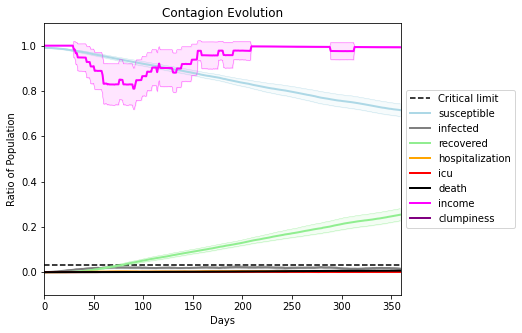

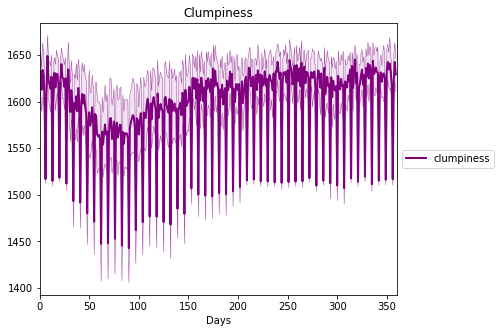

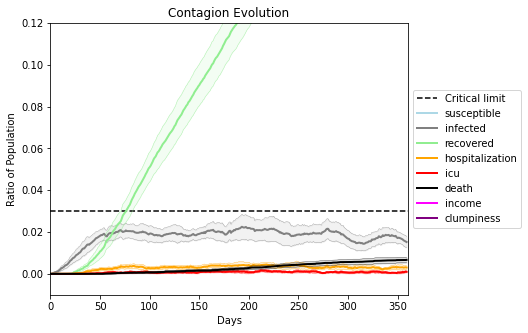

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4975, 7182, 7233, 3629, 9062, 435, 3327, 3583, 8837, 6270, 7886, 4969, 1271, 6838, 6975, 2011, 4436, 9999, 930, 2337]
Average similarity between family members is 0.9605593796854525 at temperature -0.9975
Average similarity between family and home is 0.9998500590432896 at temperature -1
Average similarity between students and their classroom is 0.9095230346732931 at temperature -0.9975
Average classroom occupancy is 1.6294117647058823 and number classrooms is 170
Average similarity between workers is 0.917655778547091 at temperature -0.9975
Average office occupancy is 3.430051813471503 and number offices is 193
Average friend similarity for adults: 0.8467774903905742 for kids: 0.7233360256716952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.7080833409112397
avg restaurant similarity 0.8407786122734011
avg restaurant similarity 0.46152892881031315
avg restaurant similarity 0.752727690690352
avg restaurant similarity 0.46553493969758386
avg restaurant similarity 0.7449313730560996
avg restaurant similarity 0.6597373058334325
avg restaurant similarity 0.6106551965706905
avg restaurant similarity 0.677225172254452
avg restaurant similarity 0.8540019732044429
avg restaurant similarity 0.6906436365677888
avg restaurant similarity 0.4665296919781825
avg restaurant similarity 0.6820123467446393
avg restaurant similarity 0.5742604455854743
avg restaurant similarity 0.44830195932876543
avg restaurant similarity 0.45021624676239225
avg restaurant similarity 0.647269042508198
avg restaurant similarity 0.8154026682358042
avg restaurant similarity 0.25284863473968555
avg restaurant similarity 0.47995617241225896
avg restaurant similarity 0.4800192568800663
avg restaurant similarity 0.6804077835007216
avg res

avg restaurant similarity 0.5343078295803076
avg restaurant similarity 0.9303648495031157
avg restaurant similarity 0.6077934718562297
avg restaurant similarity 0.4489469992161427
avg restaurant similarity 0.47672720418741776
avg restaurant similarity 0.4319979523378279
avg restaurant similarity 0.5551228124912349
avg restaurant similarity 0.9997303402043491
avg restaurant similarity 0.9998515721685219
avg restaurant similarity 0.5958846300531198
avg restaurant similarity 0.4353129898222202
avg restaurant similarity 0.4277771835752351
avg restaurant similarity 0.5165855485955165
avg restaurant similarity 0.2735788942936735
avg restaurant similarity 0.41251035601059377
avg restaurant similarity 0.4659728043241186
avg restaurant similarity 0.37504872936421557
avg restaurant similarity 0.5444051403177521
avg restaurant similarity 0.7862487365165403
avg restaurant similarity 0.3649509876482675
avg restaurant similarity 0.4294863709569421
avg restaurant similarity 0.62569354457344
avg resta

avg restaurant similarity 0.9998356019165783
avg restaurant similarity 0.7657913834402155
avg restaurant similarity 0.3060715842521745
avg restaurant similarity 0.5076124087431841
avg restaurant similarity 0.6054975561066771
avg restaurant similarity 0.4369204243500022
Average similarity between family members is 0.9540106881750796 at temperature -0.9975
Average similarity between family and home is 0.9998549943231329 at temperature -1
Average similarity between students and their classroom is 0.9377249266342885 at temperature -0.9975
Average classroom occupancy is 1.5888888888888888 and number classrooms is 180
Average similarity between workers is 0.9396946174961766 at temperature -0.9975
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.8549387765621879 for kids: 0.7189538689552403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with

avg restaurant similarity 0.4196095239562847
avg restaurant similarity 0.5896561849019142
avg restaurant similarity 0.5950013537463894
avg restaurant similarity 0.6103424975872831
avg restaurant similarity 0.4997687423626399
avg restaurant similarity 0.8596128055182922
avg restaurant similarity 0.5762603366002554
avg restaurant similarity 0.7156558071917567
avg restaurant similarity 0.5044777772023225
avg restaurant similarity 0.4826526502389777
avg restaurant similarity 0.4872952640357112
avg restaurant similarity 0.6857035779887082
avg restaurant similarity 0.5070574806195443
avg restaurant similarity 0.5578493346417004
avg restaurant similarity 0.6290365877616861
avg restaurant similarity 0.6996368948060898
avg restaurant similarity 0.5201828885636
avg restaurant similarity 0.6011538217676571
avg restaurant similarity 0.5126327354230954
avg restaurant similarity 0.7536952841748658
avg restaurant similarity 0.47377787867141885
avg restaurant similarity 0.59683831254238
avg restaurant

avg restaurant similarity 0.3570946911193545
avg restaurant similarity 0.8572532188990232
avg restaurant similarity 0.5070574806195443
avg restaurant similarity 0.3441969792058788
avg restaurant similarity 0.5297782592677979
avg restaurant similarity 0.5186308118193557
avg restaurant similarity 0.6032545071763065
avg restaurant similarity 0.36165191275067354
avg restaurant similarity 0.32626243662990795
avg restaurant similarity 0.6088178905227853
avg restaurant similarity 0.5157813823711385
avg restaurant similarity 0.4247541674193536
avg restaurant similarity 0.5030117997635872
avg restaurant similarity 0.607407481456465
avg restaurant similarity 0.3786411290147971
avg restaurant similarity 0.5120934302567718
avg restaurant similarity 0.6960975824158997
avg restaurant similarity 0.7138459843522339
Average similarity between family members is 0.9521419655913966 at temperature -0.9975
Average similarity between family and home is 0.9998449440517765 at temperature -1
Average similarity 

avg restaurant similarity 0.5292253870478527
avg restaurant similarity 0.3506058201866978
avg restaurant similarity 0.652367776041582
avg restaurant similarity 0.8118675869727119
avg restaurant similarity 0.6910388373899226
avg restaurant similarity 0.736644775856694
avg restaurant similarity 0.51191804444104
avg restaurant similarity 0.7190339078340048
avg restaurant similarity 0.7445573554282411
avg restaurant similarity 0.5982058310004602
avg restaurant similarity 0.9997863983037105
avg restaurant similarity 0.6055047843975054
avg restaurant similarity 0.1967508051868468
avg restaurant similarity 0.1967508051868468
avg restaurant similarity 0.2713348086294487
avg restaurant similarity 0.4950106447188231
avg restaurant similarity 0.473892832619245
avg restaurant similarity 0.4560963329062711
avg restaurant similarity 0.5336370919142602
avg restaurant similarity 0.9057847701829158
avg restaurant similarity 0.3012851105828054
avg restaurant similarity 0.475354922457049
avg restaurant s

Average friend similarity for adults: 0.8586847044185618 for kids: 0.7409137672252744
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.5400986089469622
avg restaurant similarity 0.6864913565255282
avg restaurant similarity 0.4646376262428078
avg restaurant similarity 0.6461347488203781
avg restaurant similarity 0.6100320912657627
avg restaurant similarity 0.5257238698169575
avg restaurant similarity 0.8062981185336718
avg restaurant similarity 0.47044510956794156
avg restaurant similarity 0.7801225856872374
avg restaurant similarity 0.5190048749294648
avg restaurant similarity 0.41084820722840126
avg restaurant similarity 0.1963370543212688
avg restaurant similarity 0.610290904806835
avg restaurant similarity 0.6695659118622252
avg restaurant similarity 0.5708225939980953
avg restaurant similarity 0.5084318915044264
avg restaurant similarity 0.5746178155419551
avg restaurant similarity 0.6918766446154722
avg restaurant similarity 0.5629844743322984
avg restaurant similarity 0.5060111579260803
avg restaurant similarity 0.4492845628583919
avg restaurant similarity 0.6389872732937201
avg resta

avg restaurant similarity 0.4218962973284621
avg restaurant similarity 0.8815592002919578
avg restaurant similarity 0.4756318531532938
avg restaurant similarity 0.473610531083168
avg restaurant similarity 0.4701522955424894
avg restaurant similarity 0.47794543811590817
avg restaurant similarity 0.4854831760676366
avg restaurant similarity 0.4701522955424894
avg restaurant similarity 0.8443943634121538
avg restaurant similarity 0.5910021757591173
avg restaurant similarity 0.999825182843946
avg restaurant similarity 0.576421567888826
avg restaurant similarity 0.9997461866024497
avg restaurant similarity 0.7336702665213193
avg restaurant similarity 0.35686462365334576
avg restaurant similarity 0.9992509108623961
avg restaurant similarity 0.9011586475491684
avg restaurant similarity 0.4760985700730709
avg restaurant similarity 0.4892223109056442
avg restaurant similarity 0.5215076075862666
avg restaurant similarity 0.46715271087895727
avg restaurant similarity 0.8689144937102586
avg restau

avg restaurant similarity 0.7485458097289324
avg restaurant similarity 0.7473322924311783
avg restaurant similarity 0.7954289856134933
avg restaurant similarity 0.6405423273580235
avg restaurant similarity 0.5537067972053898
avg restaurant similarity 0.8395082354459668
avg restaurant similarity 0.8796745645848303
avg restaurant similarity 0.6354244080878839
avg restaurant similarity 0.9142619923809301
avg restaurant similarity 0.9996171235610323
avg restaurant similarity 0.7271303057589564
avg restaurant similarity 0.9997974084123835
avg restaurant similarity 0.5575750162870443
avg restaurant similarity 0.5233473490255149
avg restaurant similarity 0.8827248518159931
avg restaurant similarity 0.7473165764900772
avg restaurant similarity 0.7473165764900772
avg restaurant similarity 0.9997890731549136
avg restaurant similarity 0.7218553639735167
avg restaurant similarity 0.794255648573443
avg restaurant similarity 0.8643593195877438
avg restaurant similarity 0.5090871498990526
avg restaur

avg restaurant similarity 0.6737180428997788
avg restaurant similarity 0.7415533022588869
avg restaurant similarity 0.6749235562665281
avg restaurant similarity 0.562106863593476
avg restaurant similarity 0.47098408170993067
avg restaurant similarity 0.7047374493325976
avg restaurant similarity 0.5956820090732393
avg restaurant similarity 0.49479201471890316
avg restaurant similarity 0.48570285975911
avg restaurant similarity 0.4813521092383299
avg restaurant similarity 0.4917219163548038
avg restaurant similarity 0.9998967982109233
avg restaurant similarity 0.30918213593867083
avg restaurant similarity 0.7262996797514585
avg restaurant similarity 0.7152786360846718
avg restaurant similarity 0.5153692143327661
avg restaurant similarity 0.8634851547734606
avg restaurant similarity 0.6201597260935219
avg restaurant similarity 0.40948452664917223
avg restaurant similarity 0.718201686897108
avg restaurant similarity 0.9047810040517621
avg restaurant similarity 0.6477324743598734
avg restau

Average similarity between workers is 0.9229744203950389 at temperature -0.9975
Average office occupancy is 3.473684210526316 and number offices is 190
Average friend similarity for adults: 0.8554632249945933 for kids: 0.7364398868549549
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.7956919541648799
avg restaurant similarity 0.6656699937220565
avg restaurant similarity 0.5661624778728475
avg restaurant similarity 0.904644864738629
avg restaurant similarity 0.8204188731496864
avg restaurant similarity 0.4823734892190401
avg restaurant similarity 0.5454762060297678
avg restaurant similarity 0.8204188731496864
avg restaurant similarity 0.9999289285726878
avg restaurant similarity 0.597318346736789
avg restaurant similarity 0.5000989301203134
avg restaurant similarity 0.3671318691916162
avg restaurant similarity 0.8288756917660806
avg restaurant similarity 0.6125118338596963
avg restaurant similarity 0.7020029329686679
avg restaurant similarity 0.6344226311681411
avg restaurant similarity 0.7453340459650697
avg restaurant similarity 0.7000170693274788
avg restaurant similarity 0.9998396591258433
avg restaurant similarity 0.6186936043924939
avg restaurant similarity 0.5637157117462523
avg restaurant similarity 0.43180244649001964
avg restaur

avg restaurant similarity 0.7572591001249196
avg restaurant similarity 0.9997850472815462
avg restaurant similarity 0.7155132300584488
avg restaurant similarity 0.6186671681406097
avg restaurant similarity 0.483954064789607
avg restaurant similarity 0.6281244459264448
avg restaurant similarity 0.8295560316028935
avg restaurant similarity 0.3770406126558763
avg restaurant similarity 0.47726315566410193
avg restaurant similarity 0.544368028434399
avg restaurant similarity 0.483954064789607
avg restaurant similarity 0.48270558567765565
avg restaurant similarity 0.5631017421288527
avg restaurant similarity 0.4306632618676387
avg restaurant similarity 0.4747705008058103
avg restaurant similarity 0.9997850472815462
avg restaurant similarity 0.17978645067379295
avg restaurant similarity 0.7655897123341678
avg restaurant similarity 0.8246313433699809
avg restaurant similarity 0.28744212212450837
avg restaurant similarity 0.4823734892190401
avg restaurant similarity 0.8182150643551666
avg resta

avg restaurant similarity 0.9993703574002711
avg restaurant similarity 0.5499469953560974
avg restaurant similarity 0.48682496822625065
avg restaurant similarity 0.49159170827345644
avg restaurant similarity 0.2550766959737391
avg restaurant similarity 0.34189311181688214
avg restaurant similarity 0.44910126029599623
avg restaurant similarity 0.6436717616583958
avg restaurant similarity 0.5857622791998636
avg restaurant similarity 0.47853616500356855
avg restaurant similarity 0.6539028802339854
avg restaurant similarity 0.5421390062885822
avg restaurant similarity 0.2498996561849886
avg restaurant similarity 0.9995050596744811
avg restaurant similarity 0.8519770287635218
avg restaurant similarity 0.581622864029041
avg restaurant similarity 0.7266465298489662
avg restaurant similarity 0.8766502837816281
avg restaurant similarity 0.5465922266795237
avg restaurant similarity 0.5343432832623856
avg restaurant similarity 0.6335896818545914
avg restaurant similarity 0.5673228810778163
avg re

avg restaurant similarity 0.5612308766888849
avg restaurant similarity 0.6340693999641825
avg restaurant similarity 0.5455730307751127
avg restaurant similarity 0.6917317743542919
avg restaurant similarity 0.5033783059873008
avg restaurant similarity 0.592039449168553
avg restaurant similarity 0.6109659980185285
avg restaurant similarity 0.5795783168065489
avg restaurant similarity 0.6805043419974055
avg restaurant similarity 0.501342572738619
avg restaurant similarity 0.5875419531893118
avg restaurant similarity 0.6484058121084342
avg restaurant similarity 0.6731231638439988
avg restaurant similarity 0.6014104381378917
avg restaurant similarity 0.9997167675614747
avg restaurant similarity 0.413328625192596
avg restaurant similarity 0.5555153509123993
avg restaurant similarity 0.5104578811822538
avg restaurant similarity 0.5891107007076242
avg restaurant similarity 0.8670987170564469
avg restaurant similarity 0.5111643009183235
avg restaurant similarity 0.5555962300427741
avg restauran

avg restaurant similarity 0.44119666416727304
avg restaurant similarity 0.8005823898745412
avg restaurant similarity 0.6881990249084247
avg restaurant similarity 0.6129140464034595
avg restaurant similarity 0.6038122363532598
avg restaurant similarity 0.8302787160298482
avg restaurant similarity 0.6593731370247484
avg restaurant similarity 0.6149060982772948
avg restaurant similarity 0.5672031481273556
avg restaurant similarity 0.759625456707925
avg restaurant similarity 0.6399662853017968
avg restaurant similarity 0.6802085439708077
avg restaurant similarity 0.8671936170933514
avg restaurant similarity 0.7280823787098836
avg restaurant similarity 0.9997167675614747
avg restaurant similarity 0.5200304384325349
avg restaurant similarity 0.7088827599178077
avg restaurant similarity 0.6299188181230242
avg restaurant similarity 0.5460324495595965
avg restaurant similarity 0.5559530454297958
avg restaurant similarity 0.5938127359552969
Average similarity between family members is 0.94845321

avg restaurant similarity 0.5833298667719486
avg restaurant similarity 0.35700523526143063
avg restaurant similarity 0.4725936464576198
avg restaurant similarity 0.6105258373937863
avg restaurant similarity 0.4675024567349518
avg restaurant similarity 0.42418005713333745
avg restaurant similarity 0.6833646878819186
avg restaurant similarity 0.614180420187783
avg restaurant similarity 0.5577303171674963
avg restaurant similarity 0.6048031594974077
avg restaurant similarity 0.6170287989270976
avg restaurant similarity 0.824810399599563
avg restaurant similarity 0.5808997882321703
avg restaurant similarity 0.4587202354679469
avg restaurant similarity 0.9998813735893723
avg restaurant similarity 0.4911200453182961
avg restaurant similarity 0.8349846346754303
avg restaurant similarity 0.5627896561745389
avg restaurant similarity 0.538566338545308
avg restaurant similarity 0.591494046756257
avg restaurant similarity 0.5350332043699488
avg restaurant similarity 0.4404366467366319
avg restaura

Average similarity between workers is 0.9408673233026086 at temperature -0.9975
Average office occupancy is 3.276923076923077 and number offices is 195
Average friend similarity for adults: 0.8631398476361415 for kids: 0.7546909396092698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.6360902238105157
avg restaurant similarity 0.7375171429301642
avg restaurant similarity 0.5301230538811474
avg restaurant similarity 0.9087100228064598
avg restaurant similarity 0.5027185857762347
avg restaurant similarity 0.47672052195470804
avg restaurant similarity 0.7686487985242061
avg restaurant similarity 0.6907789353176281
avg restaurant similarity 0.6754942189338824
avg restaurant similarity 0.6360541878687835
avg restaurant similarity 0.580966414660456
avg restaurant similarity 0.8702375377665785
avg restaurant similarity 0.6596847320107513
avg restaurant similarity 0.5878251841982194
avg restaurant similarity 0.4752613415324056
avg restaurant similarity 0.5038611882335875
avg restaurant similarity 0.2561231046413859
avg restaurant similarity 0.4769983846304081
avg restaurant similarity 0.5392980700499985
avg restaurant similarity 0.7251908210603168
avg restaurant similarity 0.7400037174138367
avg restaurant similarity 0.8602300409731236
avg restau

avg restaurant similarity 0.6788049207835021
avg restaurant similarity 0.999576894339701
avg restaurant similarity 0.7435633336015627
avg restaurant similarity 0.7110391476456577
avg restaurant similarity 0.5124524092969472
avg restaurant similarity 0.7485259532532638
avg restaurant similarity 0.6313521288202811
avg restaurant similarity 0.5356743613806516
avg restaurant similarity 0.5361459565915163
avg restaurant similarity 0.9996520484755926
avg restaurant similarity 0.6507175546092636
avg restaurant similarity 0.6014261463888056
avg restaurant similarity 0.9995578517294154
avg restaurant similarity 0.23163448064402603
avg restaurant similarity 0.8804165664135329
avg restaurant similarity 0.5043265738450873
avg restaurant similarity 0.7292527995298663
avg restaurant similarity 0.6950627574057687
avg restaurant similarity 0.679258669490975
avg restaurant similarity 0.6158120107099287
avg restaurant similarity 0.7292527995298663
avg restaurant similarity 0.48887927488570654
avg restau

avg restaurant similarity 0.7262015447171273
avg restaurant similarity 0.7292527995298663
avg restaurant similarity 0.6115334487020386
avg restaurant similarity 0.679258669490975
avg restaurant similarity 0.5747155190212424
avg restaurant similarity 0.9996520484755926
avg restaurant similarity 0.6503206251897872
avg restaurant similarity 0.7843112328353758
avg restaurant similarity 0.909793125918364
avg restaurant similarity 0.5243560955250185
avg restaurant similarity 0.43237429302211194
avg restaurant similarity 0.595227649062528
avg restaurant similarity 0.576826699192854
avg restaurant similarity 0.8362898888698149
avg restaurant similarity 0.4306167541170842
Average similarity between family members is 0.9545682299552094 at temperature -0.9975
Average similarity between family and home is 0.9998626630854317 at temperature -1
Average similarity between students and their classroom is 0.9066038030966197 at temperature -0.9975
Average classroom occupancy is 1.7041420118343196 and num

avg restaurant similarity 0.395938466077561
avg restaurant similarity 0.37100911731034053
avg restaurant similarity 0.6933711032520091
avg restaurant similarity 0.4324129404861612
avg restaurant similarity 0.6465869422023746
avg restaurant similarity 0.5291139369168455
avg restaurant similarity 0.447397161936866
avg restaurant similarity 0.7387287384689822
avg restaurant similarity 0.9997430014159496
avg restaurant similarity 0.636324132764343
avg restaurant similarity 0.4324129404861612
avg restaurant similarity 0.7058257549194376
avg restaurant similarity 0.48690779264938333
avg restaurant similarity 0.48291969330237067
avg restaurant similarity 0.9999306496549457
avg restaurant similarity 0.702574753371536
avg restaurant similarity 0.4716442551419748
avg restaurant similarity 0.49476228939825073
avg restaurant similarity 0.5325354225607974
avg restaurant similarity 0.5044492368920248
avg restaurant similarity 0.42251303411274765
avg restaurant similarity 0.9997013480900936
avg resta

avg restaurant similarity 0.7677366962863457
avg restaurant similarity 0.531624944680331
avg restaurant similarity 0.5567249937001055
avg restaurant similarity 0.5780500374062143
avg restaurant similarity 0.42193397254410214
avg restaurant similarity 0.8284128608604684
avg restaurant similarity 0.5075325206311463
avg restaurant similarity 0.7000345673847091
avg restaurant similarity 0.5745636047068461
avg restaurant similarity 0.6183537804150803
avg restaurant similarity 0.5444168689232636
avg restaurant similarity 0.7507888047904538
avg restaurant similarity 0.6640059945550354
avg restaurant similarity 0.40632370785372207
avg restaurant similarity 0.4890153895710592
avg restaurant similarity 0.43522816652251894
avg restaurant similarity 0.5686608661874507
avg restaurant similarity 0.6477004543989926
avg restaurant similarity 0.8064168590638588
avg restaurant similarity 0.5444168689232636
avg restaurant similarity 0.5922505338779509
avg restaurant similarity 0.8006579484345284
avg rest

avg restaurant similarity 0.4903410182534652
avg restaurant similarity 0.5313106916338155
avg restaurant similarity 0.5571357595508765
avg restaurant similarity 0.38708342139595936
avg restaurant similarity 0.7061005304372889
avg restaurant similarity 0.4972514386539684
avg restaurant similarity 0.5305364215136912
avg restaurant similarity 0.49785571673160045
avg restaurant similarity 0.8196797750401855
avg restaurant similarity 0.49785571673160045
avg restaurant similarity 0.7316412146953959
avg restaurant similarity 0.9120663778670894
avg restaurant similarity 0.9125027424088195
avg restaurant similarity 0.4017485657160307
avg restaurant similarity 0.40491133681946645
avg restaurant similarity 0.7587201995965582
avg restaurant similarity 0.6873906469201105
avg restaurant similarity 0.3820389277292975
avg restaurant similarity 0.5537738372286123
avg restaurant similarity 0.6438289720704088
avg restaurant similarity 0.6624006988052933
avg restaurant similarity 0.4272441499901113
avg re

avg restaurant similarity 0.6097374434876512
avg restaurant similarity 0.6904846445566564
avg restaurant similarity 0.5481965026028254
avg restaurant similarity 0.72780442471332
avg restaurant similarity 0.8668927353718604
avg restaurant similarity 0.5164765090641177
avg restaurant similarity 0.4469928460625162
avg restaurant similarity 0.528288669096511
avg restaurant similarity 0.680515966939994
avg restaurant similarity 0.7990405686783905
avg restaurant similarity 0.8596020410582865
avg restaurant similarity 0.6320264191486609
avg restaurant similarity 0.9998548251649574
avg restaurant similarity 0.7205608865419026
avg restaurant similarity 0.7661560654649775
avg restaurant similarity 0.6849479167967729
avg restaurant similarity 0.6247426240199467
avg restaurant similarity 0.5262169313479848
avg restaurant similarity 0.6197487030597001
avg restaurant similarity 0.9997910252530894
avg restaurant similarity 0.666289181713529
avg restaurant similarity 0.5403951427607707
avg restaurant 

avg restaurant similarity 0.8077590425991502
avg restaurant similarity 0.43024209758314635
avg restaurant similarity 0.6501090443465087
avg restaurant similarity 0.40055812850299227
avg restaurant similarity 0.7189670431159879
avg restaurant similarity 0.7012163011993078
avg restaurant similarity 0.5945122285590878
avg restaurant similarity 0.4469928460625162
avg restaurant similarity 0.9998851484030934
avg restaurant similarity 0.759921546756078
avg restaurant similarity 0.6922369681096117
Average similarity between family members is 0.9550411066399409 at temperature -0.9975
Average similarity between family and home is 0.9998635126872744 at temperature -1
Average similarity between students and their classroom is 0.9242359603274356 at temperature -0.9975
Average classroom occupancy is 1.722543352601156 and number classrooms is 173
Average similarity between workers is 0.9313005016418078 at temperature -0.9975
Average office occupancy is 3.4427083333333335 and number offices is 192
Av

avg restaurant similarity 0.9998075962799138
avg restaurant similarity 0.4709275716812068
avg restaurant similarity 0.16458691535859737
avg restaurant similarity 0.6902593516291629
avg restaurant similarity 0.8785082960761611
avg restaurant similarity 0.8342417408844223
avg restaurant similarity 0.9997840738806031
avg restaurant similarity 0.5386186595538498
avg restaurant similarity 0.6399781765386492
avg restaurant similarity 0.400198776081121
avg restaurant similarity 0.48590247711707957
avg restaurant similarity 0.8819552115117109
avg restaurant similarity 0.7587234534228136
avg restaurant similarity 0.6177913176383466
avg restaurant similarity 0.6110632588161223
avg restaurant similarity 0.805683445196316
avg restaurant similarity 0.5305472946484413
avg restaurant similarity 0.674804302348999
avg restaurant similarity 0.5415458815427464
avg restaurant similarity 0.9999058455494858
avg restaurant similarity 0.5764853768895316
avg restaurant similarity 0.8819593665655512
avg restaur

avg restaurant similarity 0.4484707868332045
avg restaurant similarity 0.6992223658172384
avg restaurant similarity 0.5076710910320612
avg restaurant similarity 0.5690081644180808
avg restaurant similarity 0.45520818762298143
avg restaurant similarity 0.543889906682395
avg restaurant similarity 0.308232148728435
avg restaurant similarity 0.8466661919511036
avg restaurant similarity 0.8494314406676085
avg restaurant similarity 0.5771028765304863
avg restaurant similarity 0.3817910333082376
avg restaurant similarity 0.558738138417217
avg restaurant similarity 0.47007450423265373
avg restaurant similarity 0.8522737704677993
avg restaurant similarity 0.999857841640688
avg restaurant similarity 0.5944699649477773
avg restaurant similarity 0.5727101437094734
avg restaurant similarity 0.5727101437094734
avg restaurant similarity 0.7149977456694854
avg restaurant similarity 0.6056056355598871
avg restaurant similarity 0.9998778184540035
avg restaurant similarity 0.7756040114348981
avg restaura

avg restaurant similarity 0.6784923196405244
avg restaurant similarity 0.573749702057435
avg restaurant similarity 0.6777284902021415
avg restaurant similarity 0.6048864240285756
avg restaurant similarity 0.45631546176345683
avg restaurant similarity 0.565262965714519
avg restaurant similarity 0.9998904140366303
Average similarity between family members is 0.9598907690050009 at temperature -0.9975
Average similarity between family and home is 0.9998529315283576 at temperature -1
Average similarity between students and their classroom is 0.9328233555663694 at temperature -0.9975
Average classroom occupancy is 1.5112359550561798 and number classrooms is 178
Average similarity between workers is 0.9408548029306104 at temperature -0.9975
Average office occupancy is 3.3756345177664975 and number offices is 197
Average friend similarity for adults: 0.8551734837314574 for kids: 0.7239185103021728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with ca

avg restaurant similarity 0.9998611657415901
avg restaurant similarity 0.43296921663442733
avg restaurant similarity 0.8698602326295761
avg restaurant similarity 0.999619655477402
avg restaurant similarity 0.6885276575971648
avg restaurant similarity 0.4575878741316255
avg restaurant similarity 0.999619655477402
avg restaurant similarity 0.8149288077687101
avg restaurant similarity 0.5926812509047927
avg restaurant similarity 0.999619655477402
avg restaurant similarity 0.7284151794331598
avg restaurant similarity 0.34020726290175446
avg restaurant similarity 0.6773893620853246
avg restaurant similarity 0.43296921663442733
avg restaurant similarity 0.45213928361179617
avg restaurant similarity 0.7746808908176201
avg restaurant similarity 0.5464194020373124
avg restaurant similarity 0.5858392113413308
avg restaurant similarity 0.8147210106090713
avg restaurant similarity 0.6336540932919945
avg restaurant similarity 0.999765103362914
avg restaurant similarity 0.771697347691103
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

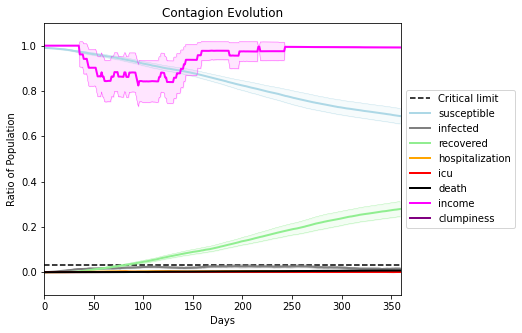

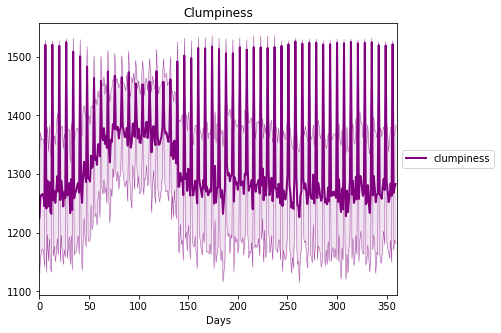

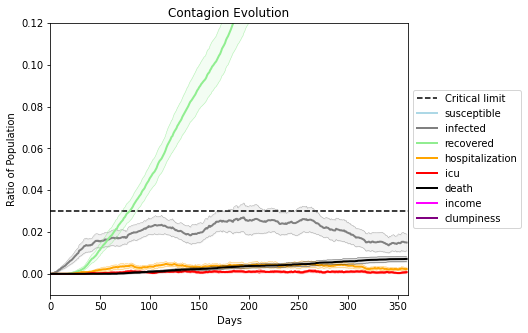

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4358, 5670, 1106, 9533, 976, 3381, 5410, 5445, 435, 4265, 3315, 5188, 466, 2972, 7010, 2716, 440, 952, 3281, 6979]
Average similarity between family members is 0.9523386083755508 at temperature -0.997
Average similarity between family and home is 0.9998507705720973 at temperature -1
Average similarity between students and their classroom is 0.9215022353238241 at temperature -0.997
Average classroom occupancy is 1.7413793103448276 and number classrooms is 174
Average similarity between workers is 0.9238559552317144 at temperature -0.997
Average office occupancy is 3.3548387096774195 and number offices is 186
Average friend similarity for adults: 0.8474262762171157 for kids: 0.743866400175511
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.7196933741323335
avg restaurant similarity 0.4913179657537336
avg restaurant similarity 0.625886123507456
avg restaurant similarity 0.5894822630502872
avg restaurant similarity 0.8910147549996831
avg restaurant similarity 0.7821379931848931
avg restaurant similarity 0.6212222072898719
avg restaurant similarity 0.5259944405284023
avg restaurant similarity 0.5866972320572104
avg restaurant similarity 0.4606152003645598
avg restaurant similarity 0.7821379931848931
avg restaurant similarity 0.88895685601604
avg restaurant similarity 0.3018617745308499
avg restaurant similarity 0.6814350993261769
avg restaurant similarity 0.39070475493497103
avg restaurant similarity 0.764645606477679
avg restaurant similarity 0.44296694084178334
avg restaurant similarity 0.7499331815015534
avg restaurant similarity 0.45316873335933816
avg restaurant similarity 0.7009153069694217
avg restaurant similarity 0.7993731410601373
avg restaurant similarity 0.6733939640873772
avg restaur

Average similarity between workers is 0.932970544380968 at temperature -0.997
Average office occupancy is 3.4381443298969074 and number offices is 194
Average friend similarity for adults: 0.8657861488033125 for kids: 0.7457379300128326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.5649789903569645
avg restaurant similarity 0.5094521200892598
avg restaurant similarity 0.46167015054476623
avg restaurant similarity 0.7495222315047781
avg restaurant similarity 0.2834488947830658
avg restaurant similarity 0.512393150016493
avg restaurant similarity 0.8202478449121967
avg restaurant similarity 0.7313793981826829
avg restaurant similarity 0.44573319605457656
avg restaurant similarity 0.22088287824967068
avg restaurant similarity 0.4603348844303367
avg restaurant similarity 0.5230496059178178
avg restaurant similarity 0.4768549171741497
avg restaurant similarity 0.4276628035193433
avg restaurant similarity 0.49537812584928986
avg restaurant similarity 0.44386163800502176
avg restaurant similarity 0.5085830274866503
avg restaurant similarity 0.713824583583334
avg restaurant similarity 0.6798393016934443
avg restaurant similarity 0.9997176919962842
avg restaurant similarity 0.37853377953800194
avg restaurant similarity 0.397490282607606
avg res

avg restaurant similarity 0.46357013712313283
avg restaurant similarity 0.346662167890056
avg restaurant similarity 0.5504875445624797
avg restaurant similarity 0.33841203141430465
avg restaurant similarity 0.5767590292379796
avg restaurant similarity 0.4157082625374904
avg restaurant similarity 0.3419983552079643
avg restaurant similarity 0.8518349135797598
avg restaurant similarity 0.5218468504053482
avg restaurant similarity 0.4245934545693414
avg restaurant similarity 0.5792281386840927
avg restaurant similarity 0.6328498290521364
avg restaurant similarity 0.4534967932642514
avg restaurant similarity 0.46464575483697457
avg restaurant similarity 0.46078824496103954
avg restaurant similarity 0.5153472538482823
avg restaurant similarity 0.5030404249205161
avg restaurant similarity 0.7501223806713258
avg restaurant similarity 0.39362327931909147
avg restaurant similarity 0.34137462114555195
avg restaurant similarity 0.5222919566492106
avg restaurant similarity 0.531126768263974
avg re

avg restaurant similarity 0.8502647213188566
avg restaurant similarity 0.5843570713448102
avg restaurant similarity 0.6190566675312892
avg restaurant similarity 0.7258226433760255
avg restaurant similarity 0.7919492780580761
avg restaurant similarity 0.7505996744627814
avg restaurant similarity 0.5690191128917492
avg restaurant similarity 0.9998048168797229
avg restaurant similarity 0.8088378898690325
avg restaurant similarity 0.5690191128917492
avg restaurant similarity 0.8427059631124405
avg restaurant similarity 0.6973556012285584
avg restaurant similarity 0.8293634241753267
avg restaurant similarity 0.8407187359287989
avg restaurant similarity 0.27404981773429904
avg restaurant similarity 0.837316395706825
avg restaurant similarity 0.685286718430818
avg restaurant similarity 0.6491362414779496
avg restaurant similarity 0.40540292152876267
avg restaurant similarity 0.8682031206465479
avg restaurant similarity 0.7992799987799748
avg restaurant similarity 0.30342892519783915
avg resta

avg restaurant similarity 0.4416563898175476
avg restaurant similarity 0.5355329808164394
avg restaurant similarity 0.4284775691370809
avg restaurant similarity 0.5061664730497603
avg restaurant similarity 0.591660316418374
avg restaurant similarity 0.5322923690039635
avg restaurant similarity 0.41148186392717356
avg restaurant similarity 0.597144361806189
avg restaurant similarity 0.22920675886164577
avg restaurant similarity 0.9997798979328045
avg restaurant similarity 0.6083970419519871
avg restaurant similarity 0.4434138847037209
avg restaurant similarity 0.21113321250558476
avg restaurant similarity 0.6202912529550964
avg restaurant similarity 0.8493297623674297
avg restaurant similarity 0.46266775329848014
avg restaurant similarity 0.6876571354638052
avg restaurant similarity 0.603397526641807
avg restaurant similarity 0.5982088725821612
avg restaurant similarity 0.5455489230631129
avg restaurant similarity 0.5719548674186885
avg restaurant similarity 0.5983441615174889
avg resta

Average similarity between family and home is 0.9998516057095629 at temperature -1
Average similarity between students and their classroom is 0.9248458797449158 at temperature -0.997
Average classroom occupancy is 1.6467065868263473 and number classrooms is 167
Average similarity between workers is 0.9303395131406778 at temperature -0.997
Average office occupancy is 3.4111675126903553 and number offices is 197
Average friend similarity for adults: 0.8579657130276983 for kids: 0.7405281155892499
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity 0.6914694607868929
avg restaurant similarity 0.5316969886301944
avg restaurant similarity 0.7449143827283857
avg restaurant similarity 0.44161434847280756
avg restaurant similarity 0.4864558377541056
avg restaurant similarity 0.5478601939303542
avg restaurant similarity 0.5275433243771518
avg restaurant similarity 0.8533491119813922
avg restaurant similarity 0.5055018338906653
avg restaurant similarity 0.509562496906453
avg restaurant similarity 0.5761023126052206
avg restaurant similarity 0.41512938911700137
avg restaurant similarity 0.7424545843684502
avg restaurant similarity 0.5623926855764865
avg restaurant similarity 0.7591506557935183
avg restaurant similarity 0.6303409409045491
avg restaurant similarity 0.7877053662771601
avg restaurant similarity 0.9995944079415255
avg restaurant similarity 0.8896239561791406
avg restaurant similarity 0.5478601939303542
avg restaurant similarity 0.19306604046485662
avg restaurant similarity 0.8075717654891162
avg rest

avg restaurant similarity 0.5252901023607937
avg restaurant similarity 0.5641502488601269
avg restaurant similarity 0.5091550681265642
avg restaurant similarity 0.6637513167675695
avg restaurant similarity 0.5446014641316694
avg restaurant similarity 0.6491694792886468
avg restaurant similarity 0.4098614051114611
avg restaurant similarity 0.6841048666898828
avg restaurant similarity 0.7750491233696873
avg restaurant similarity 0.5940939766973623
avg restaurant similarity 0.7416481477682239
avg restaurant similarity 0.6480645186071086
avg restaurant similarity 0.6126973696198337
avg restaurant similarity 0.8191668543007172
avg restaurant similarity 0.5765459496027374
avg restaurant similarity 0.7389829163219154
avg restaurant similarity 0.9996945212443054
avg restaurant similarity 0.7162309878712835
avg restaurant similarity 0.4396067610697054
avg restaurant similarity 0.48841219274392395
avg restaurant similarity 0.6322292076846022
avg restaurant similarity 0.36251726346786506
avg rest

avg restaurant similarity 0.6348244878896114
avg restaurant similarity 0.8385395998139002
avg restaurant similarity 0.6406738105449375
avg restaurant similarity 0.7426339351122535
avg restaurant similarity 0.9246386583577259
avg restaurant similarity 0.7050599553522904
avg restaurant similarity 0.47550653832670475
avg restaurant similarity 0.7557820043242173
avg restaurant similarity 0.5435206941557846
avg restaurant similarity 0.6831839490613462
avg restaurant similarity 0.32163569654887186
avg restaurant similarity 0.8488579510867255
avg restaurant similarity 0.2589510384359705
avg restaurant similarity 0.5548257854848828
avg restaurant similarity 0.5818411418464039
avg restaurant similarity 0.33232667334048394
avg restaurant similarity 0.6648648796091909
avg restaurant similarity 0.4685055747397996
avg restaurant similarity 0.5789701186659064
avg restaurant similarity 0.6100121409288491
avg restaurant similarity 0.7475116770352387
avg restaurant similarity 0.5521003044794226
avg res

avg restaurant similarity 0.7829032926072269
avg restaurant similarity 0.6648648796091909
avg restaurant similarity 0.7650878969348898
avg restaurant similarity 0.897798002668216
avg restaurant similarity 0.6533565026193714
avg restaurant similarity 0.18791298098272263
avg restaurant similarity 0.7184454119133337
avg restaurant similarity 0.6267453859724061
avg restaurant similarity 0.472163420065134
avg restaurant similarity 0.5420981810464155
avg restaurant similarity 0.5474490798697896
avg restaurant similarity 0.8614005493485153
avg restaurant similarity 0.6267453859724061
avg restaurant similarity 0.574177210727032
avg restaurant similarity 0.5732607772975367
avg restaurant similarity 0.5441329971303035
avg restaurant similarity 0.9999739412418724
avg restaurant similarity 0.5236570442297965
avg restaurant similarity 0.5474490798697896
avg restaurant similarity 0.7655850453169055
avg restaurant similarity 0.9300883322897323
avg restaurant similarity 0.5842663643845372
avg restaura

avg restaurant similarity 0.4236040599485609
avg restaurant similarity 0.4990536934820278
avg restaurant similarity 0.4673729615058072
avg restaurant similarity 0.4498347988221949
avg restaurant similarity 0.4866028516965093
avg restaurant similarity 0.855189764202491
avg restaurant similarity 0.501457867623533
avg restaurant similarity 0.5643511950138123
avg restaurant similarity 0.7043435446063606
avg restaurant similarity 0.6220984359853516
avg restaurant similarity 0.7233600349334395
avg restaurant similarity 0.9998359884173211
avg restaurant similarity 0.8690114342281856
avg restaurant similarity 0.44764800542062894
avg restaurant similarity 0.4328210191062831
avg restaurant similarity 0.5422516661704897
avg restaurant similarity 0.49464874478037335
avg restaurant similarity 0.40092769180781984
avg restaurant similarity 0.22791808551525014
avg restaurant similarity 0.4709230329604611
avg restaurant similarity 0.5415271458847847
avg restaurant similarity 0.8163331092812778
avg rest

avg restaurant similarity 0.7233600349334395
avg restaurant similarity 0.8312372231448814
avg restaurant similarity 0.7146879000158097
avg restaurant similarity 0.8476675536889335
avg restaurant similarity 0.5801265771882691
avg restaurant similarity 0.3207419825872424
avg restaurant similarity 0.5028137869389628
avg restaurant similarity 0.46985654143840605
avg restaurant similarity 0.6600665066700941
avg restaurant similarity 0.5355236945458842
avg restaurant similarity 0.9998533020618572
avg restaurant similarity 0.48785265365566
avg restaurant similarity 0.6608228513079808
avg restaurant similarity 0.9996900062800727
avg restaurant similarity 0.5010760915040122
avg restaurant similarity 0.7837773843764235
avg restaurant similarity 0.47287737030714105
avg restaurant similarity 0.6638882176056795
avg restaurant similarity 0.5686448912660167
avg restaurant similarity 0.438899800795908
avg restaurant similarity 0.614497841279812
avg restaurant similarity 0.520771538254127
avg restauran

avg restaurant similarity 0.9561407209312732
avg restaurant similarity 0.6433314852795549
avg restaurant similarity 0.607758214297192
avg restaurant similarity 0.7542973623173206
avg restaurant similarity 0.5820138197076857
avg restaurant similarity 0.350679766595813
avg restaurant similarity 0.7540395329707812
avg restaurant similarity 0.5811835219596055
avg restaurant similarity 0.7540395329707812
avg restaurant similarity 0.7074813887052852
avg restaurant similarity 0.4163338381750116
avg restaurant similarity 0.5121959494561409
avg restaurant similarity 0.648084850347924
avg restaurant similarity 0.6113473576653455
avg restaurant similarity 0.4497476248752314
avg restaurant similarity 0.6580005687814765
avg restaurant similarity 0.4497476248752314
avg restaurant similarity 0.7231524755763917
avg restaurant similarity 0.8235005845731656
avg restaurant similarity 0.6762293263278445
avg restaurant similarity 0.6173113085251399
avg restaurant similarity 0.7608261690773536
avg restauran

avg restaurant similarity 0.4657228843329357
avg restaurant similarity 0.3801777218305461
avg restaurant similarity 0.5409514931768591
avg restaurant similarity 0.7247874514000716
avg restaurant similarity 0.4870940229734066
avg restaurant similarity 0.5047670538944088
avg restaurant similarity 0.6113473576653455
avg restaurant similarity 0.8219251506175228
avg restaurant similarity 0.5093293491121589
avg restaurant similarity 0.40374738065985993
Average similarity between family members is 0.9536466795310133 at temperature -0.997
Average similarity between family and home is 0.9998576355393418 at temperature -1
Average similarity between students and their classroom is 0.9347213568962912 at temperature -0.997
Average classroom occupancy is 1.569060773480663 and number classrooms is 181
Average similarity between workers is 0.9213644717495291 at temperature -0.997
Average office occupancy is 3.4705882352941178 and number offices is 187
Average friend similarity for adults: 0.8576346337

avg restaurant similarity 0.3747832432839335
avg restaurant similarity 0.49930633128117274
avg restaurant similarity 0.5261918299757563
avg restaurant similarity 0.36621049495847335
avg restaurant similarity 0.5246967678005837
avg restaurant similarity 0.30192877670779367
avg restaurant similarity 0.5108975356290315
avg restaurant similarity 0.30192877670779367
avg restaurant similarity 0.49422260632340154
avg restaurant similarity 0.5496784409541533
avg restaurant similarity 0.5665133864567081
avg restaurant similarity 0.36827160943485826
avg restaurant similarity 0.45043575278315107
avg restaurant similarity 0.3057992582098705
avg restaurant similarity 0.48819831834772187
avg restaurant similarity 0.4773818339084715
avg restaurant similarity 0.4975652716361394
avg restaurant similarity 0.4941647961167682
avg restaurant similarity 0.3832562357643984
avg restaurant similarity 0.5261918299757563
avg restaurant similarity 0.4845080445353941
avg restaurant similarity 0.38773195890059065
a

avg restaurant similarity 0.9998146915406789
avg restaurant similarity 0.38835633307657924
avg restaurant similarity 0.5708989208657482
avg restaurant similarity 0.8048280090517365
avg restaurant similarity 0.4312270553180756
avg restaurant similarity 0.6817367944883237
avg restaurant similarity 0.5325858909131371
avg restaurant similarity 0.8796999827316436
avg restaurant similarity 0.7480610722867427
avg restaurant similarity 0.9993173314761872
avg restaurant similarity 0.3115274581972087
avg restaurant similarity 0.2521429039394312
avg restaurant similarity 0.8516376781194592
avg restaurant similarity 0.6051450345862526
avg restaurant similarity 0.4181664537938386
avg restaurant similarity 0.9995154919705558
avg restaurant similarity 0.7530672090541928
avg restaurant similarity 0.9135702013090184
avg restaurant similarity 0.832896068456394
avg restaurant similarity 0.4204713123907534
avg restaurant similarity 0.47490092627291774
avg restaurant similarity 0.9529033724678418
avg resta

avg restaurant similarity 0.8429887255917083
avg restaurant similarity 0.7473990554554198
avg restaurant similarity 0.6980394053544465
avg restaurant similarity 0.8465011406429855
avg restaurant similarity 0.4727712566289545
avg restaurant similarity 0.6224028942002575
avg restaurant similarity 0.9996466747564908
avg restaurant similarity 0.5923905198104349
avg restaurant similarity 0.4189939556600444
avg restaurant similarity 0.6750463274055537
avg restaurant similarity 0.8495627519514772
avg restaurant similarity 0.5869295976873646
avg restaurant similarity 0.5028306484751672
avg restaurant similarity 0.49884103996261536
avg restaurant similarity 0.4093516107577054
avg restaurant similarity 0.6176478036718746
avg restaurant similarity 0.50869349573677
avg restaurant similarity 0.42409630250199787
avg restaurant similarity 0.6893945545518474
avg restaurant similarity 0.6051427998663184
avg restaurant similarity 0.39498409727328243
avg restaurant similarity 0.3687813832991105
avg resta

avg restaurant similarity 0.999870385692911
avg restaurant similarity 0.4828000894169139
avg restaurant similarity 0.858923062252439
avg restaurant similarity 0.8123922620325057
avg restaurant similarity 0.19108358581641524
avg restaurant similarity 0.5219374284858528
avg restaurant similarity 0.4421302918557237
avg restaurant similarity 0.6659846011129773
avg restaurant similarity 0.4569849582801837
avg restaurant similarity 0.5810930533403105
avg restaurant similarity 0.7629266921104767
avg restaurant similarity 0.6695386476422622
avg restaurant similarity 0.7510782856785854
avg restaurant similarity 0.7333545444497142
avg restaurant similarity 0.4881769168943917
avg restaurant similarity 0.5978345583698861
avg restaurant similarity 0.3166849491981623
avg restaurant similarity 0.5785991515148035
avg restaurant similarity 0.850365419203664
avg restaurant similarity 0.8216373214557183
avg restaurant similarity 0.5876510907493617
avg restaurant similarity 0.4881769168943917
avg restaura

avg restaurant similarity 0.6068888707384558
avg restaurant similarity 0.6071772370587076
avg restaurant similarity 0.5467134682311453
avg restaurant similarity 0.6045940890883079
avg restaurant similarity 0.5346220241896181
avg restaurant similarity 0.9997667043805281
avg restaurant similarity 0.8550545668264542
avg restaurant similarity 0.7366499406136248
avg restaurant similarity 0.5359111050405314
avg restaurant similarity 0.882255035225946
avg restaurant similarity 0.9996590323038764
avg restaurant similarity 0.8499890757483887
avg restaurant similarity 0.570591431516517
avg restaurant similarity 0.5106114107672332
avg restaurant similarity 0.6053584664045184
avg restaurant similarity 0.4414445084410116
avg restaurant similarity 0.8793590966181777
avg restaurant similarity 0.6389858937142275
avg restaurant similarity 0.42449070000441214
avg restaurant similarity 0.6994768366832421
avg restaurant similarity 0.31386541499767673
avg restaurant similarity 0.6335164930867877
avg restau

avg restaurant similarity 0.44756960755394604
avg restaurant similarity 0.7750788604267271
avg restaurant similarity 0.30175405605938416
avg restaurant similarity 0.6315183924226236
avg restaurant similarity 0.8157521273191879
avg restaurant similarity 0.5057173178321785
Average similarity between family members is 0.9523232641306527 at temperature -0.997
Average similarity between family and home is 0.9998582739184408 at temperature -1
Average similarity between students and their classroom is 0.9325917409206552 at temperature -0.997
Average classroom occupancy is 1.6988636363636365 and number classrooms is 176
Average similarity between workers is 0.9477896529321725 at temperature -0.997
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.8546875064447809 for kids: 0.745781230179795
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a

avg restaurant similarity 0.558418754002027
avg restaurant similarity 0.4980638311032314
avg restaurant similarity 0.8306045627389406
avg restaurant similarity 0.5795255491694165
avg restaurant similarity 0.8554618189186285
avg restaurant similarity 0.6164249087077283
avg restaurant similarity 0.8561666094408427
avg restaurant similarity 0.7525007568381743
avg restaurant similarity 0.7157634522967842
avg restaurant similarity 0.697497007279158
avg restaurant similarity 0.4813832287021654
avg restaurant similarity 0.5255634493703862
avg restaurant similarity 0.8506205552894002
avg restaurant similarity 0.3372018752419579
avg restaurant similarity 0.6661613186402463
avg restaurant similarity 0.712614403850999
avg restaurant similarity 0.9998612659442105
avg restaurant similarity 0.5404187587065219
avg restaurant similarity 0.9997388772826592
avg restaurant similarity 0.41729087799821013
avg restaurant similarity 0.4160931466127359
avg restaurant similarity 0.712614403850999
avg restauran

avg restaurant similarity 0.5690477030739858
avg restaurant similarity 0.5629377845717721
avg restaurant similarity 0.673907691138842
avg restaurant similarity 0.27462835070845115
avg restaurant similarity 0.852644253793237
avg restaurant similarity 0.6675842771283239
avg restaurant similarity 0.5917942622775535
avg restaurant similarity 0.9997849098874523
avg restaurant similarity 0.8797153478307089
avg restaurant similarity 0.3846221249217291
avg restaurant similarity 0.5232689717991872
avg restaurant similarity 0.3826937978773828
avg restaurant similarity 0.6023504418994161
avg restaurant similarity 0.32321503241628846
avg restaurant similarity 0.6174527922378548
avg restaurant similarity 0.42422616497558935
avg restaurant similarity 0.8983806623332882
avg restaurant similarity 0.6262110162291566
avg restaurant similarity 0.8983806623332882
avg restaurant similarity 0.40416405635781033
avg restaurant similarity 0.57477374411925
avg restaurant similarity 0.7142993869655321
avg restau

avg restaurant similarity 0.27763780092113804
avg restaurant similarity 0.6161897833180283
avg restaurant similarity 0.690115787255501
avg restaurant similarity 0.8571578545854714
avg restaurant similarity 0.5182242779003462
avg restaurant similarity 0.3471002896482198
avg restaurant similarity 0.6740223094875951
avg restaurant similarity 0.8628632736852311
avg restaurant similarity 0.5363328102929525
avg restaurant similarity 0.21900757353531458
avg restaurant similarity 0.5305176632908878
avg restaurant similarity 0.611126554384237
avg restaurant similarity 0.5321120215475137
avg restaurant similarity 0.7486538147435671
avg restaurant similarity 0.48965938368072853
avg restaurant similarity 0.8994508839962154
avg restaurant similarity 0.6174527922378548
avg restaurant similarity 0.5920323307239647
avg restaurant similarity 0.9997301124293161
avg restaurant similarity 0.39064048231563314
avg restaurant similarity 0.6006295444548686
avg restaurant similarity 0.5249473245523181
avg rest

avg restaurant similarity 0.5156719054761167
avg restaurant similarity 0.7351261415585184
avg restaurant similarity 0.7629666485865205
avg restaurant similarity 0.47785634305036645
avg restaurant similarity 0.5313840224659172
avg restaurant similarity 0.5518464146214268
avg restaurant similarity 0.6920587903572547
avg restaurant similarity 0.4792814678419171
avg restaurant similarity 0.46882903927645936
avg restaurant similarity 0.5267058435771362
avg restaurant similarity 0.732032443890462
avg restaurant similarity 0.4628874729067731
avg restaurant similarity 0.6428314046988771
avg restaurant similarity 0.629868120701561
avg restaurant similarity 0.7720298746387765
avg restaurant similarity 0.7003874629423879
avg restaurant similarity 0.47745382644476964
avg restaurant similarity 0.842645700764032
avg restaurant similarity 0.3644858147766974
avg restaurant similarity 0.8387825084197238
avg restaurant similarity 0.5620191189359682
avg restaurant similarity 0.9995306270241312
avg restau

avg restaurant similarity 0.61029607518438
avg restaurant similarity 0.40772292293523865
avg restaurant similarity 0.5834751479425926
avg restaurant similarity 0.5995737265718422
avg restaurant similarity 0.8840040802088716
avg restaurant similarity 0.9217700920905455
avg restaurant similarity 0.6587764006606668
Average similarity between family members is 0.9505929037362695 at temperature -0.997
Average similarity between family and home is 0.9998633468262673 at temperature -1
Average similarity between students and their classroom is 0.9246794232869838 at temperature -0.997
Average classroom occupancy is 1.7245508982035929 and number classrooms is 167
Average similarity between workers is 0.9315189696792827 at temperature -0.997
Average office occupancy is 3.507936507936508 and number offices is 189
Average friend similarity for adults: 0.8626679037653621 for kids: 0.7412233875922387
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capaci

avg restaurant similarity 0.8419078028982191
avg restaurant similarity 0.5209782804171612
avg restaurant similarity 0.5624676009855145
avg restaurant similarity 0.45167366044662016
avg restaurant similarity 0.3972400092119769
avg restaurant similarity 0.45167366044662016
avg restaurant similarity 0.5430525298428441
avg restaurant similarity 0.5633526005725648
avg restaurant similarity 0.6772981874416257
avg restaurant similarity 0.3827425333183427
avg restaurant similarity 0.5475303363321901
avg restaurant similarity 0.6240255454687222
avg restaurant similarity 0.43554346050994447
avg restaurant similarity 0.5967476799926986
avg restaurant similarity 0.5473999095003503
avg restaurant similarity 0.8420980346956914
avg restaurant similarity 0.5328775062511263
avg restaurant similarity 0.6727889026860516
avg restaurant similarity 0.5335974768260066
avg restaurant similarity 0.5876205247436376
avg restaurant similarity 0.6284967795061189
avg restaurant similarity 0.920481986149317
avg rest

avg restaurant similarity 0.6226637810125841
avg restaurant similarity 0.3448705489449947
avg restaurant similarity 0.5382306173536602
avg restaurant similarity 0.3868136206132653
avg restaurant similarity 0.5614798826819523
avg restaurant similarity 0.1897373406744628
avg restaurant similarity 0.9997667310283433
avg restaurant similarity 0.4321046822871137
avg restaurant similarity 0.44893932429312694
avg restaurant similarity 0.8429908179337087
avg restaurant similarity 0.6175551247468254
avg restaurant similarity 0.28389389969327283
avg restaurant similarity 0.508562391256925
avg restaurant similarity 0.9222918406091801
avg restaurant similarity 0.5633526005725648
avg restaurant similarity 0.6474365270395892
avg restaurant similarity 0.46894744116981274
avg restaurant similarity 0.489750908241351
avg restaurant similarity 0.5254957591527258
avg restaurant similarity 0.5082838460958097
avg restaurant similarity 0.47800532556310027
avg restaurant similarity 0.49938366914752264
avg res

avg restaurant similarity 0.6976934278211623
avg restaurant similarity 0.5420718704310481
avg restaurant similarity 0.5705076200288324
avg restaurant similarity 0.6707417807275293
avg restaurant similarity 0.9997877714764232
avg restaurant similarity 0.6009466332275445
avg restaurant similarity 0.5156178528714478
avg restaurant similarity 0.6707417807275293
avg restaurant similarity 0.5237399975382819
avg restaurant similarity 0.9998169005648199
avg restaurant similarity 0.9122238473370979
avg restaurant similarity 0.5479925059830653
avg restaurant similarity 0.4557925970315506
avg restaurant similarity 0.8188462279072031
avg restaurant similarity 0.8359140612453803
avg restaurant similarity 0.5260969089260181
avg restaurant similarity 0.5292906705382496
avg restaurant similarity 0.255961239495702
avg restaurant similarity 0.48724100962481526
avg restaurant similarity 0.7293611178088555
avg restaurant similarity 0.9995724720182886
avg restaurant similarity 0.4547477518051955
avg restau

avg restaurant similarity 0.5008238702893779
avg restaurant similarity 0.6374637447601412
avg restaurant similarity 0.6272459261413714
avg restaurant similarity 0.479881145671467
avg restaurant similarity 0.5268911903654051
avg restaurant similarity 0.7914954716821155
avg restaurant similarity 0.5223963876054505
avg restaurant similarity 0.7243598554693835
avg restaurant similarity 0.9997422219577381
avg restaurant similarity 0.6374637447601412
avg restaurant similarity 0.43901274905801574
avg restaurant similarity 0.48724100962481526
avg restaurant similarity 0.6374637447601412
avg restaurant similarity 0.5089223217791587
avg restaurant similarity 0.8367227741938479
avg restaurant similarity 0.7279388315580766
Average similarity between family members is 0.9539514974150174 at temperature -0.997
Average similarity between family and home is 0.9998385518872327 at temperature -1
Average similarity between students and their classroom is 0.931766301008187 at temperature -0.997
Average cla

avg restaurant similarity 0.5177573100310945
avg restaurant similarity 0.23533552278385955
avg restaurant similarity 0.5897121873628072
avg restaurant similarity 0.5210465427712945
avg restaurant similarity 0.3279889724591491
avg restaurant similarity 0.9999184157688814
avg restaurant similarity 0.4657237328476941
avg restaurant similarity 0.4068874376333884
avg restaurant similarity 0.5968482181664075
avg restaurant similarity 0.612396133496116
avg restaurant similarity 0.3928561568386586
avg restaurant similarity 0.49201348512542564
avg restaurant similarity 0.8557346358237905
avg restaurant similarity 0.6164552040070809
avg restaurant similarity 0.7358632363517872
avg restaurant similarity 0.9997073814365254
avg restaurant similarity 0.5000007060507482
avg restaurant similarity 0.999802290397901
avg restaurant similarity 0.205136545104321
avg restaurant similarity 0.5808562429856399
avg restaurant similarity 0.9997553599507568
avg restaurant similarity 0.50614505220616
avg restauran

Average similarity between family and home is 0.9998554651841782 at temperature -1
Average similarity between students and their classroom is 0.9418454049613175 at temperature -0.997
Average classroom occupancy is 1.7209302325581395 and number classrooms is 172
Average similarity between workers is 0.9260048162917036 at temperature -0.997
Average office occupancy is 3.3608247422680413 and number offices is 194
Average friend similarity for adults: 0.8519025521596489 for kids: 0.7435600752476056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity fo

avg restaurant similarity 0.5016090142917379
avg restaurant similarity 0.4364473145753437
avg restaurant similarity 0.37277701045071243
avg restaurant similarity 0.3740239818021358
avg restaurant similarity 0.5034028290164952
avg restaurant similarity 0.491865579973934
avg restaurant similarity 0.9368176541363178
avg restaurant similarity 0.6764680717934413
avg restaurant similarity 0.48373428637326743
avg restaurant similarity 0.8765407388195936
avg restaurant similarity 0.8775919912130876
avg restaurant similarity 0.4244475394110589
avg restaurant similarity 0.4311283244018121
avg restaurant similarity 0.27494385135475335
avg restaurant similarity 0.999684834698668
avg restaurant similarity 0.5301376335848927
avg restaurant similarity 0.5967051725403331
avg restaurant similarity 0.5190683750592268
avg restaurant similarity 0.46206787586920367
avg restaurant similarity 0.5319917490891997
avg restaurant similarity 0.5041863746513879
avg restaurant similarity 0.4789394239866033
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

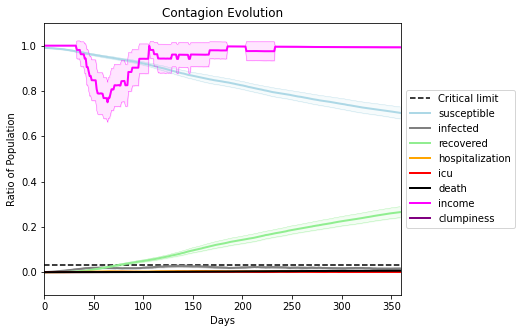

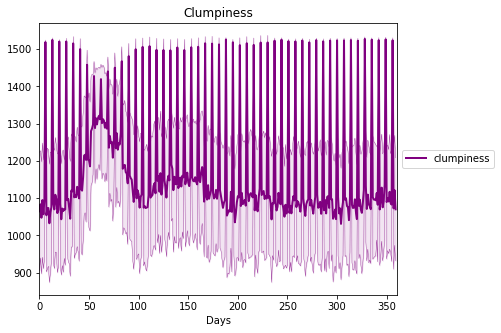

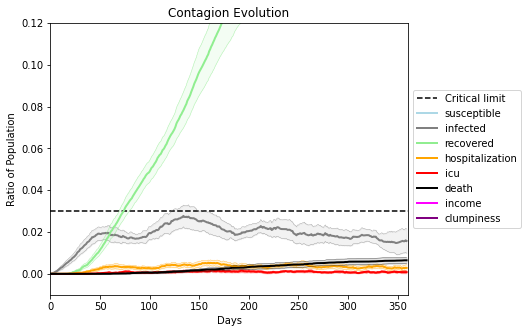

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1615, 7834, 934, 2569, 8308, 1049, 2960, 4898, 7349, 8110, 1446, 4126, 9412, 6141, 2884, 6862, 7799, 8627, 1220, 6454]
Average similarity between family members is 0.9467983066720878 at temperature -0.996
Average similarity between family and home is 0.9998522706275303 at temperature -1
Average similarity between students and their classroom is 0.9034234151891531 at temperature -0.996
Average classroom occupancy is 1.6964285714285714 and number classrooms is 168
Average similarity between workers is 0.9240262739113861 at temperature -0.996
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.8512194485242635 for kids: 0.7457505879150648
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.36689977042784283
avg restaurant similarity 0.5988242735429911
avg restaurant similarity 0.5441903814364359
avg restaurant similarity 0.29710291547851464
avg restaurant similarity 0.910881022390043
avg restaurant similarity 0.4413364954838748
avg restaurant similarity 0.4378303762526399
avg restaurant similarity 0.6240563653447191
avg restaurant similarity 0.6926005703313001
avg restaurant similarity 0.554275237911077
avg restaurant similarity 0.9994971294691286
avg restaurant similarity 0.9998949012010091
avg restaurant similarity 0.8237760999210881
avg restaurant similarity 0.5020942162410247
avg restaurant similarity 0.424573748715392
avg restaurant similarity 0.5818541571498799
avg restaurant similarity 0.8961745429914652
avg restaurant similarity 0.8787317179020586
avg restaurant similarity 0.2513365993272872
avg restaurant similarity 0.5977077698222295
avg restaurant similarity 0.47254212974010673
avg restaurant similarity 0.5319384388596501
avg restau

Average similarity between workers is 0.9274809146129028 at temperature -0.996
Average office occupancy is 3.422680412371134 and number offices is 194
Average friend similarity for adults: 0.8626044411607112 for kids: 0.7246750755006421
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.5810498929524461
avg restaurant similarity 0.44825044962963867
avg restaurant similarity 0.5359642566178917
avg restaurant similarity 0.4636072247117455
avg restaurant similarity 0.999863288497703
avg restaurant similarity 0.7319094450373197
avg restaurant similarity 0.6133629954221984
avg restaurant similarity 0.8554240101813317
avg restaurant similarity 0.538229359026662
avg restaurant similarity 0.5354899814634042
avg restaurant similarity 0.8532005616554039
avg restaurant similarity 0.4780565149220826
avg restaurant similarity 0.8302132273747211
avg restaurant similarity 0.9997005616377523
avg restaurant similarity 0.4883587353258666
avg restaurant similarity 0.40131412941870814
avg restaurant similarity 0.5741297994074216
avg restaurant similarity 0.8557552687695638
avg restaurant similarity 0.39330580905938334
avg restaurant similarity 0.42320468519487975
avg restaurant similarity 0.8095547982924479
avg restaurant similarity 0.594368292691459
avg resta

avg restaurant similarity 0.6550256784327995
avg restaurant similarity 0.3451966259909963
avg restaurant similarity 0.791866554598773
avg restaurant similarity 0.46041556112770254
avg restaurant similarity 0.6578158570459665
avg restaurant similarity 0.6596340408822643
avg restaurant similarity 0.662714960361663
avg restaurant similarity 0.5351730325152162
avg restaurant similarity 0.46048888402336363
avg restaurant similarity 0.3950420053192363
avg restaurant similarity 0.6601619856149639
avg restaurant similarity 0.4949715441427183
avg restaurant similarity 0.5887367224570805
avg restaurant similarity 0.351455014470519
avg restaurant similarity 0.5351730325152162
avg restaurant similarity 0.5506132522548066
avg restaurant similarity 0.498969297450889
avg restaurant similarity 0.9995383878573183
avg restaurant similarity 0.612675605774876
avg restaurant similarity 0.34953943473902405
avg restaurant similarity 0.5112356751258765
avg restaurant similarity 0.4097778253611897
avg restaura

avg restaurant similarity 0.4668069520100205
avg restaurant similarity 0.8416630278289581
avg restaurant similarity 0.9200471805479211
avg restaurant similarity 0.3861041268038738
avg restaurant similarity 0.4228507260827356
avg restaurant similarity 0.4942823857924274
avg restaurant similarity 0.7451475321721307
avg restaurant similarity 0.3427391705141686
avg restaurant similarity 0.7262615620940303
avg restaurant similarity 0.7686441584472021
avg restaurant similarity 0.6482239402573037
avg restaurant similarity 0.6866561727135584
avg restaurant similarity 0.5415433791766399
avg restaurant similarity 0.5090825563254371
avg restaurant similarity 0.40884673098320784
avg restaurant similarity 0.5717103206672006
avg restaurant similarity 0.49616201742644717
avg restaurant similarity 0.7517415019533817
avg restaurant similarity 0.5142685968940319
Average similarity between family members is 0.9563448473922467 at temperature -0.996
Average similarity between family and home is 0.999856769

avg restaurant similarity 0.7187452983853837
avg restaurant similarity 0.2395517447295607
avg restaurant similarity 0.8049041903303897
avg restaurant similarity 0.5940179579338061
avg restaurant similarity 0.6352886691836424
avg restaurant similarity 0.3827265164564052
avg restaurant similarity 0.6519542046917778
avg restaurant similarity 0.11586565561285285
avg restaurant similarity 0.4844777445203976
avg restaurant similarity 0.5411238638254745
avg restaurant similarity 0.5513828930608802
avg restaurant similarity 0.6566656841102105
avg restaurant similarity 0.46677584418255574
avg restaurant similarity 0.5920358688657041
avg restaurant similarity 0.6701116676762771
avg restaurant similarity 0.4715112951854893
avg restaurant similarity 0.6745737390702299
avg restaurant similarity 0.6519542046917778
avg restaurant similarity 0.3827265164564052
avg restaurant similarity 0.3157500254973483
avg restaurant similarity 0.5184620472035216
avg restaurant similarity 0.7182206025826626
avg rest

avg restaurant similarity 0.5185772891089535
avg restaurant similarity 0.5073218337899819
avg restaurant similarity 0.6149000333978952
avg restaurant similarity 0.5183618600894468
avg restaurant similarity 0.6918848882291554
avg restaurant similarity 0.5457525157042598
avg restaurant similarity 0.4689519312513321
avg restaurant similarity 0.5826291285440541
avg restaurant similarity 0.7041884866470904
avg restaurant similarity 0.6451475703061658
avg restaurant similarity 0.5787087124288037
avg restaurant similarity 0.4348274453241167
avg restaurant similarity 0.33159700957209653
avg restaurant similarity 0.4700560684728234
avg restaurant similarity 0.6273917206808524
avg restaurant similarity 0.5314106318141898
avg restaurant similarity 0.4920854188175835
avg restaurant similarity 0.5058992849887898
avg restaurant similarity 0.5478441584502289
avg restaurant similarity 0.5523292285330705
avg restaurant similarity 0.596395391624998
avg restaurant similarity 0.6097345918265544
avg restau

avg restaurant similarity 0.6580013930849297
avg restaurant similarity 0.412393867525749
avg restaurant similarity 0.41027219176265267
avg restaurant similarity 0.5186406539242092
Average similarity between family members is 0.9527555504735119 at temperature -0.996
Average similarity between family and home is 0.9998651149772636 at temperature -1
Average similarity between students and their classroom is 0.9309597828478869 at temperature -0.996
Average classroom occupancy is 1.6857142857142857 and number classrooms is 175
Average similarity between workers is 0.9273960164202918 at temperature -0.996
Average office occupancy is 3.4105263157894736 and number offices is 190
Average friend similarity for adults: 0.8514373424457764 for kids: 0.7398641416577589
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.5566339765608785
avg restaurant similarity 0.44744461007694564
avg restaurant similarity 0.3617768049391906
avg restaurant similarity 0.4372138712635129
avg restaurant similarity 0.5649216803699542
avg restaurant similarity 0.2839717896385874
avg restaurant similarity 0.5056848533016522
avg restaurant similarity 0.5363906541204435
avg restaurant similarity 0.6928287589203946
avg restaurant similarity 0.6560969114299238
avg restaurant similarity 0.7078310399381841
avg restaurant similarity 0.9208512353380798
avg restaurant similarity 0.3783947463343027
avg restaurant similarity 0.8425002542485331
avg restaurant similarity 0.4372138712635129
avg restaurant similarity 0.8418275812541486
avg restaurant similarity 0.6385078898801613
avg restaurant similarity 0.5862587959529673
avg restaurant similarity 0.8662800754973083
avg restaurant similarity 0.4729198607377787
avg restaurant similarity 0.7930130164988387
avg restaurant similarity 0.3202893308913309
avg resta

Average similarity between workers is 0.9307130257712445 at temperature -0.996
Average office occupancy is 3.296875 and number offices is 192
Average friend similarity for adults: 0.8536157646742463 for kids: 0.7413012880944403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people 

avg restaurant similarity 0.6504168890867784
avg restaurant similarity 0.4439926843846995
avg restaurant similarity 0.6959841266692042
avg restaurant similarity 0.5432756785432113
avg restaurant similarity 0.5698478009294299
avg restaurant similarity 0.5140947485172812
avg restaurant similarity 0.5002147501019042
avg restaurant similarity 0.5428081141814308
avg restaurant similarity 0.7538405434745641
avg restaurant similarity 0.9997566441934487
avg restaurant similarity 0.9996607800352711
avg restaurant similarity 0.6143517475810831
avg restaurant similarity 0.7466399424423069
avg restaurant similarity 0.8926800438535198
avg restaurant similarity 0.5942230357011623
avg restaurant similarity 0.7688825489181799
avg restaurant similarity 0.7462317910580665
avg restaurant similarity 0.5671266301446272
avg restaurant similarity 0.5099434598110067
avg restaurant similarity 0.5303652020213763
avg restaurant similarity 0.6129786604382909
avg restaurant similarity 0.38464466093788674
avg resta

avg restaurant similarity 0.47412796544926583
avg restaurant similarity 0.5095719204210907
avg restaurant similarity 0.40431886023970337
avg restaurant similarity 0.37630189098999667
avg restaurant similarity 0.5103008532475877
avg restaurant similarity 0.2961860208253131
avg restaurant similarity 0.945569423929457
avg restaurant similarity 0.4152093971054649
avg restaurant similarity 0.5189452581113088
avg restaurant similarity 0.4152093971054649
avg restaurant similarity 0.37206516841491444
avg restaurant similarity 0.3744456167079482
avg restaurant similarity 0.8646758524096643
avg restaurant similarity 0.5076181237049103
avg restaurant similarity 0.5010949970606642
avg restaurant similarity 0.8907800473180676
avg restaurant similarity 0.8661491075003127
avg restaurant similarity 0.999696820255276
avg restaurant similarity 0.5256026722152642
avg restaurant similarity 0.4981300857682717
avg restaurant similarity 0.765130752103051
avg restaurant similarity 0.6680375364475089
avg resta

Average friend similarity for adults: 0.8584380395373579 for kids: 0.7130774711416563
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.7764334555481709
avg restaurant similarity 0.5965681624031821
avg restaurant similarity 0.4111955184656432
avg restaurant similarity 0.5202264700223695
avg restaurant similarity 0.5427527717758518
avg restaurant similarity 0.7200780731939067
avg restaurant similarity 0.557305642258841
avg restaurant similarity 0.3299986655109768
avg restaurant similarity 0.6322019344431788
avg restaurant similarity 0.6554339935345215
avg restaurant similarity 0.6301594403687925
avg restaurant similarity 0.6601006106600233
avg restaurant similarity 0.3812774756269034
avg restaurant similarity 0.5135742396558336
avg restaurant similarity 0.5693001449923992
avg restaurant similarity 0.7008030692658488
avg restaurant similarity 0.4251683906119351
avg restaurant similarity 0.6305568169270094
avg restaurant similarity 0.5560721356850897
avg restaurant similarity 0.5518183042397424
avg restaurant similarity 0.5907427573068931
avg restaurant similarity 0.5861347376118521
avg restaur

avg restaurant similarity 0.8848503177136864
avg restaurant similarity 0.8184468620706599
avg restaurant similarity 0.41829248020273463
avg restaurant similarity 0.7953702742096744
avg restaurant similarity 0.49714417957062706
avg restaurant similarity 0.9998334975501859
avg restaurant similarity 0.8288936158166027
avg restaurant similarity 0.5551865001181058
avg restaurant similarity 0.8705816160976613
avg restaurant similarity 0.6301594403687925
avg restaurant similarity 0.5250041652586733
avg restaurant similarity 0.5726536196275799
avg restaurant similarity 0.4902675183580567
avg restaurant similarity 0.6341712343480865
avg restaurant similarity 0.6341712343480865
avg restaurant similarity 0.9996555650096339
avg restaurant similarity 0.25972709142036754
avg restaurant similarity 0.5970608984016629
avg restaurant similarity 0.9999164468132595
avg restaurant similarity 0.33018039439781754
avg restaurant similarity 0.4194591830793058
avg restaurant similarity 0.8146067799582726
Averag

avg restaurant similarity 0.6168496611581128
avg restaurant similarity 0.6691947579740883
avg restaurant similarity 0.9997293149835176
avg restaurant similarity 0.5213198627020652
avg restaurant similarity 0.7713209362293847
avg restaurant similarity 0.8935899621278925
avg restaurant similarity 0.6666078129542499
avg restaurant similarity 0.5618024611338217
avg restaurant similarity 0.4435833281923157
avg restaurant similarity 0.2769919163435437
avg restaurant similarity 0.5990408023642596
avg restaurant similarity 0.47214604910163427
avg restaurant similarity 0.5611625189646584
avg restaurant similarity 0.543706937334464
avg restaurant similarity 0.5083698805111753
avg restaurant similarity 0.5031061583485329
avg restaurant similarity 0.5229712342033661
avg restaurant similarity 0.7779440163436563
avg restaurant similarity 0.6356429793215169
avg restaurant similarity 0.3288929572251148
avg restaurant similarity 0.600431932759395
avg restaurant similarity 0.42456737264826716
avg restau

avg restaurant similarity 0.5714023262864567
avg restaurant similarity 0.6809635108678876
avg restaurant similarity 0.5604074090257483
avg restaurant similarity 0.5357722697587588
avg restaurant similarity 0.8858301468610039
avg restaurant similarity 0.5562477275782003
avg restaurant similarity 0.8386164649882935
avg restaurant similarity 0.7859713706732556
avg restaurant similarity 0.45346503614383527
avg restaurant similarity 0.6975429895850769
avg restaurant similarity 0.7082467158639958
avg restaurant similarity 0.3650660265967245
avg restaurant similarity 0.8867889866796905
avg restaurant similarity 0.5195347297418744
avg restaurant similarity 0.5494045776309768
Average similarity between family members is 0.9553613682925136 at temperature -0.996
Average similarity between family and home is 0.9998628549803884 at temperature -1
Average similarity between students and their classroom is 0.9182494998219753 at temperature -0.996
Average classroom occupancy is 1.737142857142857 and nu

avg restaurant similarity 0.5579713066430779
avg restaurant similarity 0.46809038836415373
avg restaurant similarity 0.7423930395787687
avg restaurant similarity 0.6852247631890489
avg restaurant similarity 0.867545359194748
avg restaurant similarity 0.5453979043453233
avg restaurant similarity 0.8070818441655325
avg restaurant similarity 0.8673743029285326
avg restaurant similarity 0.8170328809107933
avg restaurant similarity 0.8262648329979683
avg restaurant similarity 0.6832962104334215
avg restaurant similarity 0.7945246134640005
avg restaurant similarity 0.8686391564862705
avg restaurant similarity 0.6318040959758359
avg restaurant similarity 0.4626865830259685
avg restaurant similarity 0.8673743029285326
avg restaurant similarity 0.5124936321347106
avg restaurant similarity 0.6110946747521978
avg restaurant similarity 0.4215656572157617
avg restaurant similarity 0.5351211760247843
avg restaurant similarity 0.2717633510901384
avg restaurant similarity 0.7184377675571203
avg restau

avg restaurant similarity 0.5386879305113663
avg restaurant similarity 0.6807829577718505
avg restaurant similarity 0.74965258729937
avg restaurant similarity 0.49092664632773114
avg restaurant similarity 0.6293360679026214
avg restaurant similarity 0.7287416849419158
avg restaurant similarity 0.5806428348798924
avg restaurant similarity 0.7126766432244727
avg restaurant similarity 0.850778183355494
avg restaurant similarity 0.389398800454259
avg restaurant similarity 0.5273459627710514
avg restaurant similarity 0.939041276046491
avg restaurant similarity 0.6976250208354735
avg restaurant similarity 0.5702898267273367
avg restaurant similarity 0.45460831924223877
avg restaurant similarity 0.9998880305988866
avg restaurant similarity 0.8076994108079771
avg restaurant similarity 0.4548123850365272
avg restaurant similarity 0.3252805669816461
avg restaurant similarity 0.5964795090525086
avg restaurant similarity 0.7210570852075674
avg restaurant similarity 0.5218484461460691
avg restauran

avg restaurant similarity 0.999841125371639
avg restaurant similarity 0.42241514058741686
avg restaurant similarity 0.5213630737711639
avg restaurant similarity 0.43044099866668917
avg restaurant similarity 0.5523905491175765
avg restaurant similarity 0.4508787281602933
avg restaurant similarity 0.4464903556134793
avg restaurant similarity 0.46767030371284996
avg restaurant similarity 0.5295501090165725
avg restaurant similarity 0.21678055181265346
avg restaurant similarity 0.4304784400487932
avg restaurant similarity 0.5790731275442329
avg restaurant similarity 0.5606081497334741
avg restaurant similarity 0.44344760885570284
avg restaurant similarity 0.6132135220798293
avg restaurant similarity 0.43165318968429073
avg restaurant similarity 0.5364456369152134
avg restaurant similarity 0.35194782436780625
avg restaurant similarity 0.4685551651843963
avg restaurant similarity 0.5853060724892813
avg restaurant similarity 0.43609785642337034
avg restaurant similarity 0.5500422343469044
avg

avg restaurant similarity 0.6820021779694008
avg restaurant similarity 0.4493257242733304
avg restaurant similarity 0.7662148664262175
avg restaurant similarity 0.8300353357269215
avg restaurant similarity 0.47620330540896333
avg restaurant similarity 0.7635712509060588
avg restaurant similarity 0.7322565330192958
avg restaurant similarity 0.9998499897117441
avg restaurant similarity 0.44625702919638804
avg restaurant similarity 0.9233462508597499
avg restaurant similarity 0.907985374696299
avg restaurant similarity 0.9229414588827024
avg restaurant similarity 0.44507048458079423
avg restaurant similarity 0.6214293771324328
avg restaurant similarity 0.8219177704481926
avg restaurant similarity 0.820359973141661
avg restaurant similarity 0.8691565559721086
avg restaurant similarity 0.547590346317153
avg restaurant similarity 0.9997234061468956
avg restaurant similarity 0.5350484857922164
avg restaurant similarity 0.660016764753854
avg restaurant similarity 0.4479723506858889
avg restaur

avg restaurant similarity 0.3664749294350705
avg restaurant similarity 0.43135537353774206
avg restaurant similarity 0.6249751354613649
avg restaurant similarity 0.5755059248280258
avg restaurant similarity 0.6616296741811017
avg restaurant similarity 0.5122882528681679
avg restaurant similarity 0.19569857193411735
avg restaurant similarity 0.6459558215290087
avg restaurant similarity 0.5293503405305778
avg restaurant similarity 0.5175329701083734
avg restaurant similarity 0.46619407860216083
avg restaurant similarity 0.37272915050931854
avg restaurant similarity 0.46102965313416117
avg restaurant similarity 0.2782913256246553
avg restaurant similarity 0.6727838659311287
avg restaurant similarity 0.8400465877993868
avg restaurant similarity 0.39664816969990235
avg restaurant similarity 0.9998826881637706
avg restaurant similarity 0.35446984436668494
avg restaurant similarity 0.4681809109551981
avg restaurant similarity 0.5707223507046228
avg restaurant similarity 0.9996816178521799
avg

avg restaurant similarity 0.672896522272787
avg restaurant similarity 0.7942027287222319
avg restaurant similarity 0.6108218934350501
avg restaurant similarity 0.6840361405919577
avg restaurant similarity 0.7255600147446418
avg restaurant similarity 0.99974174249825
avg restaurant similarity 0.6961010451539971
avg restaurant similarity 0.5137399158427903
avg restaurant similarity 0.6875396082874458
avg restaurant similarity 0.5709040016742106
avg restaurant similarity 0.9405340460094194
avg restaurant similarity 0.6569695284791996
avg restaurant similarity 0.4165976220532279
avg restaurant similarity 0.5529755502117911
avg restaurant similarity 0.574972240771233
avg restaurant similarity 0.28847251663308493
avg restaurant similarity 0.728022468943764
avg restaurant similarity 0.5687025975057101
avg restaurant similarity 0.39977435303323405
avg restaurant similarity 0.49159800903067663
avg restaurant similarity 0.36233628742035573
avg restaurant similarity 0.7087779426263764
avg restaur

avg restaurant similarity 0.7632764003918888
avg restaurant similarity 0.9998196172766558
avg restaurant similarity 0.8273460524823004
avg restaurant similarity 0.8409725473957914
avg restaurant similarity 0.6711814771290566
avg restaurant similarity 0.5346374596732584
avg restaurant similarity 0.6927457158083616
avg restaurant similarity 0.5683814841607353
avg restaurant similarity 0.6071305102744249
avg restaurant similarity 0.6892330175191465
avg restaurant similarity 0.7831121782989723
avg restaurant similarity 0.9996781910355464
avg restaurant similarity 0.7240949135454238
avg restaurant similarity 0.22973451932877664
avg restaurant similarity 0.8362404871261125
avg restaurant similarity 0.9171380315204454
avg restaurant similarity 0.8380059903701029
avg restaurant similarity 0.9093450386015178
avg restaurant similarity 0.4976691649974514
avg restaurant similarity 0.48078885311553465
avg restaurant similarity 0.7370574643571512
avg restaurant similarity 0.672896522272787
avg resta

avg restaurant similarity 0.7512303875013049
avg restaurant similarity 0.7974888363366507
avg restaurant similarity 0.6062284586956636
avg restaurant similarity 0.5321076380504047
avg restaurant similarity 0.753671394889729
avg restaurant similarity 0.5923948425418187
avg restaurant similarity 0.7976978048397099
avg restaurant similarity 0.4178387419574322
avg restaurant similarity 0.6191848600646881
avg restaurant similarity 0.8529266465636859
avg restaurant similarity 0.3090830006222131
avg restaurant similarity 0.9068279779314494
avg restaurant similarity 0.4926265222880366
avg restaurant similarity 0.5791009429229168
avg restaurant similarity 0.5313383931125755
avg restaurant similarity 0.4075579762983155
avg restaurant similarity 0.757745999250145
avg restaurant similarity 0.7564274476939892
avg restaurant similarity 0.6753249996463444
avg restaurant similarity 0.8509209734303906
avg restaurant similarity 0.84506708096375
avg restaurant similarity 0.3713608380469874
avg restaurant

avg restaurant similarity 0.6214733630589636
avg restaurant similarity 0.6933252978019384
avg restaurant similarity 0.6587408913026713
avg restaurant similarity 0.5965325103743185
avg restaurant similarity 0.6475546644395573
avg restaurant similarity 0.7573811825200699
avg restaurant similarity 0.7008018013959845
avg restaurant similarity 0.6974327470895556
avg restaurant similarity 0.7778603934066559
avg restaurant similarity 0.7222591344234714
avg restaurant similarity 0.7688736888367772
avg restaurant similarity 0.7180478252227612
avg restaurant similarity 0.6651508577942732
avg restaurant similarity 0.45232478483794114
avg restaurant similarity 0.4678098621717203
avg restaurant similarity 0.5054121008611636
avg restaurant similarity 0.7766583102597036
avg restaurant similarity 0.7646366335684793
avg restaurant similarity 0.8297076515609965
avg restaurant similarity 0.7778603934066559
avg restaurant similarity 0.8266714656627574
avg restaurant similarity 0.5595540898585836
avg resta

avg restaurant similarity 0.7202402968698899
avg restaurant similarity 0.5948742534242601
avg restaurant similarity 0.42022921171339755
avg restaurant similarity 0.7017700079985456
avg restaurant similarity 0.5667379861998457
avg restaurant similarity 0.21956774833159107
avg restaurant similarity 0.7486019557369719
avg restaurant similarity 0.37531666960741783
avg restaurant similarity 0.5040862877530246
avg restaurant similarity 0.5462331477895925
avg restaurant similarity 0.480091836860312
avg restaurant similarity 0.5681153497481071
avg restaurant similarity 0.444175620354197
avg restaurant similarity 0.5462331477895925
avg restaurant similarity 0.4509289566679485
avg restaurant similarity 0.2180958745713949
avg restaurant similarity 0.8185095161857395
avg restaurant similarity 0.7807457672834708
avg restaurant similarity 0.6537249029408727
avg restaurant similarity 0.6130192646512536
avg restaurant similarity 0.3834221022353813
avg restaurant similarity 0.9997428089440685
avg resta

avg restaurant similarity 0.8577401690349754
avg restaurant similarity 0.9998012082171389
avg restaurant similarity 0.8484628425590556
avg restaurant similarity 0.8342212555541452
avg restaurant similarity 0.9996668645594342
avg restaurant similarity 0.8689281107655541
avg restaurant similarity 0.49066831190663696
avg restaurant similarity 0.6995597749202908
avg restaurant similarity 0.7084169045257179
avg restaurant similarity 0.6680599848776907
avg restaurant similarity 0.5653831482322578
avg restaurant similarity 0.620097812512848
avg restaurant similarity 0.8223126215225057
avg restaurant similarity 0.8517182213099853
avg restaurant similarity 0.7329184575291945
avg restaurant similarity 0.5858176613896334
avg restaurant similarity 0.5021305052597704
avg restaurant similarity 0.6962027773125927
avg restaurant similarity 0.6719688128398948
avg restaurant similarity 0.7682065138577393
avg restaurant similarity 0.7780461289382954
avg restaurant similarity 0.5139956412915949
avg restau

avg restaurant similarity 0.5262089827149483
avg restaurant similarity 0.7356447172995761
avg restaurant similarity 0.5723936600201815
avg restaurant similarity 0.7431708659061285
avg restaurant similarity 0.6762831349619112
avg restaurant similarity 0.7177601132106508
avg restaurant similarity 0.608766766333374
avg restaurant similarity 0.6018659928545391
avg restaurant similarity 0.6317166636004885
avg restaurant similarity 0.6044761813168578
avg restaurant similarity 0.7049057789424226
avg restaurant similarity 0.6571808901354986
avg restaurant similarity 0.7951575462472286
avg restaurant similarity 0.6033369271725624
avg restaurant similarity 0.45455102668241393
avg restaurant similarity 0.589672728398412
avg restaurant similarity 0.7317585986044519
avg restaurant similarity 0.9064592013951209
avg restaurant similarity 0.5421457930399274
avg restaurant similarity 0.6213547585408496
avg restaurant similarity 0.5332303468730558
avg restaurant similarity 0.40694527092024907
avg restau

avg restaurant similarity 0.6840188451784304
avg restaurant similarity 0.8523950422567885
avg restaurant similarity 0.529427131666028
avg restaurant similarity 0.534628976491911
avg restaurant similarity 0.6711299544156751
avg restaurant similarity 0.4863253911776736
avg restaurant similarity 0.5820673856781393
avg restaurant similarity 0.44120238856727717
avg restaurant similarity 0.28436204270943444
avg restaurant similarity 0.42986533046960435
avg restaurant similarity 0.7567614757171338
avg restaurant similarity 0.8160067020040348
avg restaurant similarity 0.852593967613042
avg restaurant similarity 0.7716367101516797
avg restaurant similarity 0.533585911851784
avg restaurant similarity 0.8203142941725088
avg restaurant similarity 0.7049057789424226
avg restaurant similarity 0.7271702068253669
avg restaurant similarity 0.5674855485237842
using average of time series:
stats on susceptible:
data: [0.857711111111111, 0.86835, 0.8436230436230436, 0.8902388888888889, 0.8177444444444445,

(<function dict.items>, <function dict.items>, <function dict.items>)

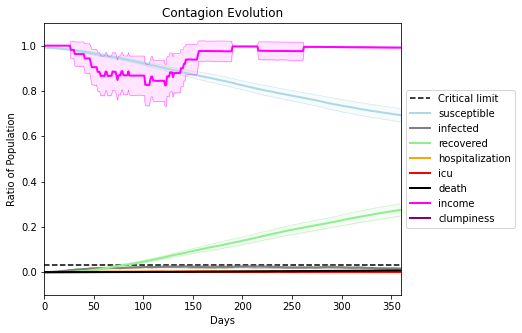

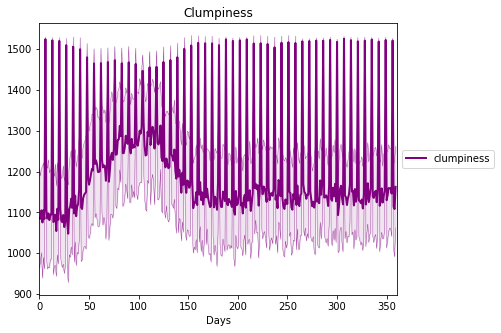

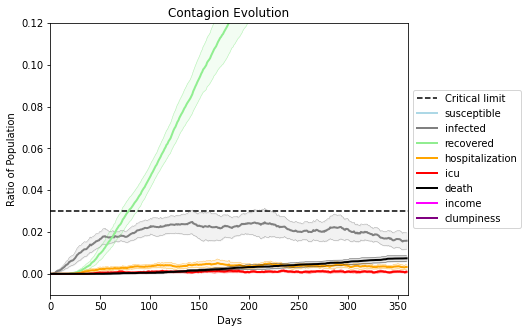

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1927, 3007, 3685, 5144, 9217, 3836, 2612, 4977, 4471, 6047, 2325, 6772, 6464, 8624, 1561, 1996, 9098, 7769, 5277, 7889]
Average similarity between family members is 0.9428881381169736 at temperature -0.995
Average similarity between family and home is 0.9998551512696633 at temperature -1
Average similarity between students and their classroom is 0.8978094676531598 at temperature -0.995
Average classroom occupancy is 1.5416666666666667 and number classrooms is 168
Average similarity between workers is 0.9067913578256176 at temperature -0.995
Average office occupancy is 3.4619289340101522 and number offices is 197
Average friend similarity for adults: 0.8602836093340654 for kids: 0.7239743012679926
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.6298413950928342
avg restaurant similarity 0.41698463083673853
avg restaurant similarity 0.5515444768901883
avg restaurant similarity 0.5464398083287341
avg restaurant similarity 0.5599795944533321
avg restaurant similarity 0.3783608274102961
avg restaurant similarity 0.898390219513308
avg restaurant similarity 0.6254460960204588
avg restaurant similarity 0.44863843233363887
avg restaurant similarity 0.9996843493505361
avg restaurant similarity 0.8307925399233298
avg restaurant similarity 0.6251190751798081
avg restaurant similarity 0.8433276467779921
avg restaurant similarity 0.8252651349969695
avg restaurant similarity 0.33137420069721835
avg restaurant similarity 0.897713958367041
avg restaurant similarity 0.5511698693399134
avg restaurant similarity 0.47422631382469815
avg restaurant similarity 0.5503429899455105
avg restaurant similarity 0.8234156287895147
avg restaurant similarity 0.5238320323890946
avg restaurant similarity 0.5142921741665458
avg rest

avg restaurant similarity 0.5314636771128269
avg restaurant similarity 0.3396192547994056
avg restaurant similarity 0.35882537298979433
avg restaurant similarity 0.7133176339146493
avg restaurant similarity 0.6069256905017324
avg restaurant similarity 0.30007557729502304
avg restaurant similarity 0.6163069123021632
avg restaurant similarity 0.2598815206534397
avg restaurant similarity 0.5442954833451297
avg restaurant similarity 0.4974202971100414
avg restaurant similarity 0.5134329139704896
avg restaurant similarity 0.5002787589176293
avg restaurant similarity 0.6189117336212502
avg restaurant similarity 0.7841900043650625
avg restaurant similarity 0.5192853410616541
avg restaurant similarity 0.5265917623354992
avg restaurant similarity 0.5190593379139304
avg restaurant similarity 0.5517663234344864
avg restaurant similarity 0.7814321713925501
avg restaurant similarity 0.42169148468635875
avg restaurant similarity 0.4266850805523026
avg restaurant similarity 0.3817310605081051
avg res

avg restaurant similarity 0.8100967312212544
avg restaurant similarity 0.44573447289322554
avg restaurant similarity 0.8831367354723944
avg restaurant similarity 0.5964547940805563
avg restaurant similarity 0.47411396773356207
avg restaurant similarity 0.8901405075708275
avg restaurant similarity 0.44561249364951283
avg restaurant similarity 0.5008584339823164
avg restaurant similarity 0.5063378803241946
avg restaurant similarity 0.6104725388271385
avg restaurant similarity 0.6885214216487305
avg restaurant similarity 0.530954221038368
avg restaurant similarity 0.3785279943538198
avg restaurant similarity 0.5897949097561528
avg restaurant similarity 0.43264554095127417
avg restaurant similarity 0.4714392501100806
avg restaurant similarity 0.5168018344291405
avg restaurant similarity 0.4527182288060965
avg restaurant similarity 0.8607824301764243
avg restaurant similarity 0.8179365370053711
avg restaurant similarity 0.3785279943538198
avg restaurant similarity 0.9998642837423567
avg res

avg restaurant similarity 0.6349912601655437
avg restaurant similarity 0.6413591411378187
avg restaurant similarity 0.9145869961074069
avg restaurant similarity 0.5780880593991625
avg restaurant similarity 0.6272047002300509
avg restaurant similarity 0.6285885372293079
avg restaurant similarity 0.7243655598838578
avg restaurant similarity 0.3490838025398194
avg restaurant similarity 0.3564128726957412
avg restaurant similarity 0.5534548935737631
avg restaurant similarity 0.5723366888075742
avg restaurant similarity 0.43125623867633434
avg restaurant similarity 0.6368287722034401
avg restaurant similarity 0.5620528049149031
avg restaurant similarity 0.8146048097655487
avg restaurant similarity 0.4532835437892697
avg restaurant similarity 0.7565390825034353
avg restaurant similarity 0.8365765711564879
avg restaurant similarity 0.9997268013554167
avg restaurant similarity 0.6368170705366496
avg restaurant similarity 0.4700927166108766
avg restaurant similarity 0.38738804745024696
avg rest

avg restaurant similarity 0.5936672635824076
avg restaurant similarity 0.5206380981085955
avg restaurant similarity 0.32371621214578383
avg restaurant similarity 0.6368170705366496
avg restaurant similarity 0.49819549774717203
avg restaurant similarity 0.5220066857252483
avg restaurant similarity 0.7917869265812248
avg restaurant similarity 0.6553926345549115
avg restaurant similarity 0.8631087447525116
avg restaurant similarity 0.479435456204319
avg restaurant similarity 0.6408771246461982
avg restaurant similarity 0.4323968622000508
avg restaurant similarity 0.6683881888703823
avg restaurant similarity 0.8658265232824001
avg restaurant similarity 0.8635086601109597
avg restaurant similarity 0.718252319063992
avg restaurant similarity 0.7109014540284462
avg restaurant similarity 0.6483560400794153
avg restaurant similarity 0.6359236648265605
avg restaurant similarity 0.46772487691018316
avg restaurant similarity 0.6041004830284316
avg restaurant similarity 0.46772487691018316
avg rest

avg restaurant similarity 0.6752482685087368
avg restaurant similarity 0.5453304369615235
avg restaurant similarity 0.6247341882428752
avg restaurant similarity 0.37329838898478485
avg restaurant similarity 0.4281518745476089
avg restaurant similarity 0.503554248288884
avg restaurant similarity 0.6972740272195328
avg restaurant similarity 0.5768278285171381
avg restaurant similarity 0.7095933269979214
avg restaurant similarity 0.7577776669211386
avg restaurant similarity 0.5365743794940283
avg restaurant similarity 0.7262747816905788
avg restaurant similarity 0.7855845139899249
avg restaurant similarity 0.5747092572959895
avg restaurant similarity 0.40712617813064644
avg restaurant similarity 0.8712596144430826
avg restaurant similarity 0.528560303818315
avg restaurant similarity 0.5286023277170663
avg restaurant similarity 0.9999272883226884
avg restaurant similarity 0.40915474035813937
avg restaurant similarity 0.8199360327110969
avg restaurant similarity 0.6165484533910051
avg resta

avg restaurant similarity 0.5810927655980245
avg restaurant similarity 0.4342529542501383
avg restaurant similarity 0.8998857401309173
avg restaurant similarity 0.7347939833526547
avg restaurant similarity 0.6334674696652891
avg restaurant similarity 0.3903185974508445
avg restaurant similarity 0.38433850020409305
avg restaurant similarity 0.35346017654431405
avg restaurant similarity 0.3150844334134119
avg restaurant similarity 0.4027587152479305
avg restaurant similarity 0.8628762323222867
avg restaurant similarity 0.4095629039816592
avg restaurant similarity 0.7719420585777668
avg restaurant similarity 0.7126886323762216
avg restaurant similarity 0.8611711123549208
avg restaurant similarity 0.38913029864948234
avg restaurant similarity 0.9996762870002052
avg restaurant similarity 0.809624996750407
avg restaurant similarity 0.7444065292303153
avg restaurant similarity 0.4959381943664054
avg restaurant similarity 0.3733073899188205
avg restaurant similarity 0.7646267054972137
avg rest

avg restaurant similarity 0.4854207996861132
avg restaurant similarity 0.4325475083813607
avg restaurant similarity 0.5986973919008136
avg restaurant similarity 0.46372809722793307
avg restaurant similarity 0.5527807885070547
avg restaurant similarity 0.4260957759696798
avg restaurant similarity 0.4072833941978993
avg restaurant similarity 0.4270829250925221
avg restaurant similarity 0.7334312724531438
avg restaurant similarity 0.48515493679449523
avg restaurant similarity 0.7991769505105335
avg restaurant similarity 0.7113047348753126
avg restaurant similarity 0.5609689169750255
avg restaurant similarity 0.8383812299317802
avg restaurant similarity 0.5986973919008136
avg restaurant similarity 0.38476948168016006
avg restaurant similarity 0.5619578340810236
avg restaurant similarity 0.624182187868275
avg restaurant similarity 0.9994773551663826
avg restaurant similarity 0.428940423497274
avg restaurant similarity 0.46756032501435607
avg restaurant similarity 0.6770015910941813
avg rest

Average similarity between family members is 0.9311642561648297 at temperature -0.995
Average similarity between family and home is 0.999857314585702 at temperature -1
Average similarity between students and their classroom is 0.8805023813050038 at temperature -0.995
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.8839589777039601 at temperature -0.995
Average office occupancy is 3.473684210526316 and number offices is 190
Average friend similarity for adults: 0.8485825159594389 for kids: 0.7261140913731928
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.41581206683748867
avg restaurant similarity 0.8477089390229962
avg restaurant similarity 0.6905661382984056
avg restaurant similarity 0.3402948606920905
avg restaurant similarity 0.3832490981496519
avg restaurant similarity 0.7504160109442046
avg restaurant similarity 0.9996220745446067
avg restaurant similarity 0.5168117720722779
avg restaurant similarity 0.6900480908909894
avg restaurant similarity 0.3104253790318847
avg restaurant similarity 0.6558387819048749
avg restaurant similarity 0.38758991301138834
avg restaurant similarity 0.4998269391214404
avg restaurant similarity 0.8454170530562098
avg restaurant similarity 0.47817592469411335
avg restaurant similarity 0.6788523200375478
avg restaurant similarity 0.5580302672862298
avg restaurant similarity 0.6007445108650715
avg restaurant similarity 0.6168921374927396
avg restaurant similarity 0.5454730711126599
avg restaurant similarity 0.6672082298503521
avg restaurant similarity 0.520099882100035
avg rest

Average similarity between family and home is 0.9998550020453162 at temperature -1
Average similarity between students and their classroom is 0.8944879751167433 at temperature -0.995
Average classroom occupancy is 1.6948051948051948 and number classrooms is 154
Average similarity between workers is 0.8922324254069909 at temperature -0.995
Average office occupancy is 3.5051546391752577 and number offices is 194
Average friend similarity for adults: 0.8506940963213556 for kids: 0.7081002709547113
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity fo

avg restaurant similarity 0.5304427149557013
avg restaurant similarity 0.6196028330901158
avg restaurant similarity 0.4304611611133009
avg restaurant similarity 0.6982216417254725
avg restaurant similarity 0.3514858730106532
avg restaurant similarity 0.7067315145366438
avg restaurant similarity 0.3588739676325633
avg restaurant similarity 0.9994776262589833
avg restaurant similarity 0.8236581756123105
avg restaurant similarity 0.4132658042387902
avg restaurant similarity 0.5563805235252852
avg restaurant similarity 0.4345502589619249
avg restaurant similarity 0.4086035073510299
avg restaurant similarity 0.34408258868704744
avg restaurant similarity 0.4178533793954724
avg restaurant similarity 0.4641934935954136
avg restaurant similarity 0.46188568491132587
avg restaurant similarity 0.4788901841939269
avg restaurant similarity 0.629465457712343
avg restaurant similarity 0.2328541772694237
avg restaurant similarity 0.7881298416694154
avg restaurant similarity 0.21202730430036168
avg rest

avg restaurant similarity 0.4765417086622823
avg restaurant similarity 0.6421340896898835
avg restaurant similarity 0.45752536944370303
avg restaurant similarity 0.45606367251199387
avg restaurant similarity 0.5222631715546318
avg restaurant similarity 0.6376400644500254
avg restaurant similarity 0.4857483511900227
avg restaurant similarity 0.6208851238657465
avg restaurant similarity 0.9998156907216115
avg restaurant similarity 0.8161890065612508
avg restaurant similarity 0.618235994104224
avg restaurant similarity 0.641161437706598
avg restaurant similarity 0.49327408954194785
avg restaurant similarity 0.5529314143180553
avg restaurant similarity 0.48195748775012603
avg restaurant similarity 0.5529314143180553
avg restaurant similarity 0.7509967152805903
avg restaurant similarity 0.4968531908005436
avg restaurant similarity 0.5905267430176184
avg restaurant similarity 0.6489490765099362
avg restaurant similarity 0.48698562435685944
avg restaurant similarity 0.6474841274942931
avg res

Average similarity between family members is 0.9391103325407796 at temperature -0.995
Average similarity between family and home is 0.9998591652012543 at temperature -1
Average similarity between students and their classroom is 0.8849314644826447 at temperature -0.995
Average classroom occupancy is 1.6145251396648044 and number classrooms is 179
Average similarity between workers is 0.8971477713992574 at temperature -0.995
Average office occupancy is 3.4361702127659575 and number offices is 188
Average friend similarity for adults: 0.8577688939441179 for kids: 0.7398691656063197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home 

avg restaurant similarity 0.6799205992461697
avg restaurant similarity 0.6409613909603569
avg restaurant similarity 0.5703129389001743
avg restaurant similarity 0.37219366686346717
avg restaurant similarity 0.6357057049436827
avg restaurant similarity 0.4219960669108228
avg restaurant similarity 0.7091894187205215
avg restaurant similarity 0.5002110028071195
avg restaurant similarity 0.6036394355792314
avg restaurant similarity 0.7373972138924985
avg restaurant similarity 0.715477518512109
avg restaurant similarity 0.7866902410980181
avg restaurant similarity 0.7753685920182157
avg restaurant similarity 0.4921178259340586
avg restaurant similarity 0.4338624324076923
avg restaurant similarity 0.2938964680517605
avg restaurant similarity 0.6791524137248414
avg restaurant similarity 0.7359183494723418
avg restaurant similarity 0.822732238875162
avg restaurant similarity 0.6808129603719537
avg restaurant similarity 0.767448907986274
avg restaurant similarity 0.72675318029715
avg restaurant

avg restaurant similarity 0.4918494649496207
avg restaurant similarity 0.4647743614717036
avg restaurant similarity 0.5697764129356504
avg restaurant similarity 0.8257015441647829
avg restaurant similarity 0.596915582535527
avg restaurant similarity 0.7840150571979554
avg restaurant similarity 0.6622420406306369
avg restaurant similarity 0.40835274504566865
avg restaurant similarity 0.677574225119173
avg restaurant similarity 0.541772867729212
avg restaurant similarity 0.3259812217467589
avg restaurant similarity 0.5917823153039137
avg restaurant similarity 0.49265594062558415
avg restaurant similarity 0.8272296316397786
avg restaurant similarity 0.3524606415071321
avg restaurant similarity 0.6406563266673084
avg restaurant similarity 0.5948493306871075
avg restaurant similarity 0.8766461890302222
avg restaurant similarity 0.40029018659339166
avg restaurant similarity 0.41567162685811504
avg restaurant similarity 0.7814024449549616
avg restaurant similarity 0.4613559866378119
avg resta

avg restaurant similarity 0.49131180419556825
avg restaurant similarity 0.48685904715662554
avg restaurant similarity 0.2814819912343804
avg restaurant similarity 0.567243317208029
avg restaurant similarity 0.3961257275052937
Average similarity between family members is 0.9436497418348176 at temperature -0.995
Average similarity between family and home is 0.9998547513495213 at temperature -1
Average similarity between students and their classroom is 0.8881525282669854 at temperature -0.995
Average classroom occupancy is 1.6857142857142857 and number classrooms is 175
Average similarity between workers is 0.894012274763544 at temperature -0.995
Average office occupancy is 3.3794871794871795 and number offices is 195
Average friend similarity for adults: 0.8581227717810772 for kids: 0.7401686908594076
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocate

avg restaurant similarity 0.6431335084967881
avg restaurant similarity 0.5160114223180726
avg restaurant similarity 0.4185839197591711
avg restaurant similarity 0.8722359149482233
avg restaurant similarity 0.40500873702313245
avg restaurant similarity 0.5379295138526894
avg restaurant similarity 0.6330621986760678
avg restaurant similarity 0.5087662430330815
avg restaurant similarity 0.546146841670905
avg restaurant similarity 0.5577316552123583
avg restaurant similarity 0.4694063902272635
avg restaurant similarity 0.4702113427099349
avg restaurant similarity 0.5255055587208347
avg restaurant similarity 0.5325019695558422
avg restaurant similarity 0.27114694325437083
avg restaurant similarity 0.5222721184718033
avg restaurant similarity 0.5089483729917025
avg restaurant similarity 0.5019558656776122
avg restaurant similarity 0.5149110445597311
avg restaurant similarity 0.4544959236391134
avg restaurant similarity 0.5120968667652603
avg restaurant similarity 0.566498801234463
avg restau

avg restaurant similarity 0.5050727044171712
avg restaurant similarity 0.5161270140363744
avg restaurant similarity 0.4239620859030966
avg restaurant similarity 0.8851370669692952
avg restaurant similarity 0.6160086731524388
avg restaurant similarity 0.4642386217069733
avg restaurant similarity 0.5576886505078495
avg restaurant similarity 0.3601966109702766
avg restaurant similarity 0.4937203353878741
avg restaurant similarity 0.5416274767954666
avg restaurant similarity 0.7170339041947004
avg restaurant similarity 0.6071442957457391
avg restaurant similarity 0.8628953955152344
avg restaurant similarity 0.43120656600582197
avg restaurant similarity 0.23789457478049175
avg restaurant similarity 0.6423395503025386
avg restaurant similarity 0.5708498453470302
avg restaurant similarity 0.48825925958686267
avg restaurant similarity 0.506445758979339
avg restaurant similarity 0.5749813870177364
avg restaurant similarity 0.5274786975976136
avg restaurant similarity 0.823773466582573
avg resta

avg restaurant similarity 0.5654301181780184
avg restaurant similarity 0.5655269016548509
avg restaurant similarity 0.46832106774383253
Average similarity between family members is 0.9386343488867527 at temperature -0.995
Average similarity between family and home is 0.9998556074720816 at temperature -1
Average similarity between students and their classroom is 0.8688154600715527 at temperature -0.995
Average classroom occupancy is 1.727810650887574 and number classrooms is 169
Average similarity between workers is 0.8877198616769424 at temperature -0.995
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8367973860590779 for kids: 0.7279622164696837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.5532340281433561
avg restaurant similarity 0.49241276246688825
avg restaurant similarity 0.6994493328508617
avg restaurant similarity 0.8823975718119857
avg restaurant similarity 0.70234908127124
avg restaurant similarity 0.48595823125109294
avg restaurant similarity 0.46975747199206486
avg restaurant similarity 0.5942165234569423
avg restaurant similarity 0.29525230258476076
avg restaurant similarity 0.5491959074961792
avg restaurant similarity 0.37230848194966776
avg restaurant similarity 0.3698794761323737
avg restaurant similarity 0.4469600274940895
avg restaurant similarity 0.505209106928121
avg restaurant similarity 0.4493145964133594
avg restaurant similarity 0.6034197380175343
avg restaurant similarity 0.6369708197071108
avg restaurant similarity 0.47032135659034896
avg restaurant similarity 0.7267289821065448
avg restaurant similarity 0.7583071973561516
avg restaurant similarity 0.5003695132783
avg restaurant similarity 0.4867779863286703
avg restau

avg restaurant similarity 0.46644247130564764
avg restaurant similarity 0.5823780864029622
avg restaurant similarity 0.5331095108769655
avg restaurant similarity 0.46389798004318494
avg restaurant similarity 0.4386161143425713
avg restaurant similarity 0.3015972459149448
avg restaurant similarity 0.9997712278692412
avg restaurant similarity 0.6863269931273563
avg restaurant similarity 0.4703012008060128
avg restaurant similarity 0.46766218473417553
avg restaurant similarity 0.546127007332672
avg restaurant similarity 0.8494554029549609
avg restaurant similarity 0.9998050946959456
avg restaurant similarity 0.8209677086640499
avg restaurant similarity 0.5004084185750431
avg restaurant similarity 0.4141580872087541
avg restaurant similarity 0.7278030155645969
avg restaurant similarity 0.4545680834539685
avg restaurant similarity 0.8643323596386551
avg restaurant similarity 0.6474822586634115
avg restaurant similarity 0.5985240213819933
avg restaurant similarity 0.9998411159669336
avg rest

avg restaurant similarity 0.5268725447254808
avg restaurant similarity 0.7968375326163569
avg restaurant similarity 0.5952428671094311
avg restaurant similarity 0.6454659406260361
avg restaurant similarity 0.720898992980968
avg restaurant similarity 0.4027813386372049
avg restaurant similarity 0.3807163011300042
avg restaurant similarity 0.5524425250435012
avg restaurant similarity 0.3458984045106951
avg restaurant similarity 0.9534483134344337
avg restaurant similarity 0.3473630655301349
avg restaurant similarity 0.45422968781566986
avg restaurant similarity 0.8941400726426232
avg restaurant similarity 0.6241421033354861
avg restaurant similarity 0.6751167865980745
avg restaurant similarity 0.12834327417903724
avg restaurant similarity 0.6632478888004835
avg restaurant similarity 0.2894017043644774
avg restaurant similarity 0.5696027171304973
avg restaurant similarity 0.21804993962750535
avg restaurant similarity 0.4225240544169773
avg restaurant similarity 0.290197986386873
avg resta

avg restaurant similarity 0.2548917473435206
avg restaurant similarity 0.6491295701692121
avg restaurant similarity 0.6583483795837647
avg restaurant similarity 0.7825365160667244
avg restaurant similarity 0.7798307355731059
avg restaurant similarity 0.4609290143809647
avg restaurant similarity 0.6476240890991598
avg restaurant similarity 0.3883305575435084
avg restaurant similarity 0.6395883426626142
avg restaurant similarity 0.300195460803133
avg restaurant similarity 0.5072976499304426
avg restaurant similarity 0.8288154576015407
avg restaurant similarity 0.41698718335749885
avg restaurant similarity 0.41911743751523023
avg restaurant similarity 0.5609027671065595
avg restaurant similarity 0.5983373990385875
avg restaurant similarity 0.499165804050682
avg restaurant similarity 0.5051706685806534
avg restaurant similarity 0.8609747113489509
avg restaurant similarity 0.6066066360258136
avg restaurant similarity 0.8215207724554423
avg restaurant similarity 0.9627772674402235
avg restau

avg restaurant similarity 0.29508880919355857
avg restaurant similarity 0.2314517205325288
avg restaurant similarity 0.607163133120115
avg restaurant similarity 0.8714301000940905
avg restaurant similarity 0.3847998309796675
avg restaurant similarity 0.4246284216759692
avg restaurant similarity 0.4428964163128042
avg restaurant similarity 0.4323607753658235
avg restaurant similarity 0.587485114727127
avg restaurant similarity 0.6524701688646932
avg restaurant similarity 0.38165913073899604
avg restaurant similarity 0.6067812084592861
avg restaurant similarity 0.4403001379661318
avg restaurant similarity 0.23458912471120905
avg restaurant similarity 0.27391259272187324
avg restaurant similarity 0.5257312366709777
avg restaurant similarity 0.5572497951990243
avg restaurant similarity 0.38672912054857167
avg restaurant similarity 0.4410754681095411
avg restaurant similarity 0.25590609929548286
avg restaurant similarity 0.7407623187626191
avg restaurant similarity 0.6067812084592861
avg re

avg restaurant similarity 0.532300807345263
avg restaurant similarity 0.7900220085645124
avg restaurant similarity 0.5163287370975991
avg restaurant similarity 0.4174466833482653
avg restaurant similarity 0.6649096042565045
avg restaurant similarity 0.9997874122347183
avg restaurant similarity 0.698142168670199
avg restaurant similarity 0.3939958155690465
avg restaurant similarity 0.8974568469635599
avg restaurant similarity 0.3877293160199614
avg restaurant similarity 0.7848538005964036
avg restaurant similarity 0.9996427246070851
avg restaurant similarity 0.5111213996618967
avg restaurant similarity 0.312060045279151
avg restaurant similarity 0.7039772533067872
avg restaurant similarity 0.3529813910754009
avg restaurant similarity 0.7681272601344813
avg restaurant similarity 0.3250592923084439
avg restaurant similarity 0.8901700819504206
avg restaurant similarity 0.5820555760288597
avg restaurant similarity 0.6031319034796674
avg restaurant similarity 0.586392855061874
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

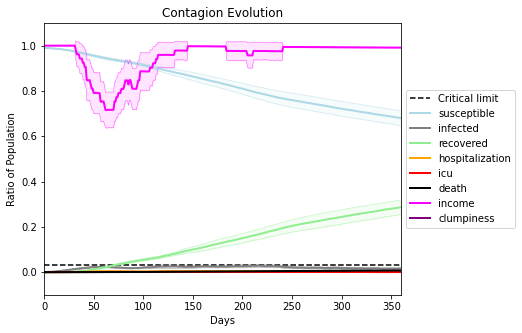

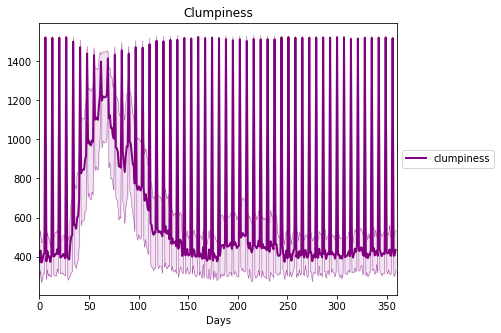

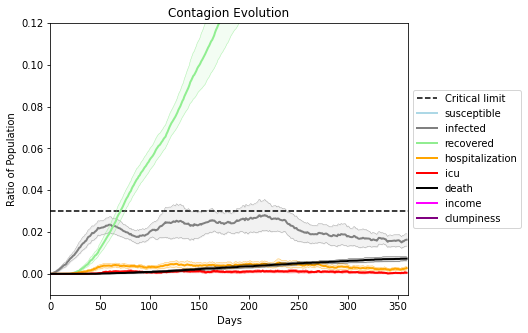

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4988, 2900, 2929, 5766, 4798, 4332, 4080, 8633, 4760, 73, 9654, 5658, 6230, 1523, 7815, 7381, 8394, 8802, 455, 3876]
Average similarity between family members is 0.9427695339428626 at temperature -0.994
Average similarity between family and home is 0.9998579049724768 at temperature -1
Average similarity between students and their classroom is 0.8671049593361727 at temperature -0.994
Average classroom occupancy is 1.7610062893081762 and number classrooms is 159
Average similarity between workers is 0.8919311868682774 at temperature -0.994
Average office occupancy is 3.328358208955224 and number offices is 201
Average friend similarity for adults: 0.8612641898049895 for kids: 0.7371792234159081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.9997232921306215
avg restaurant similarity 0.7155389827145214
avg restaurant similarity 0.7632310243247132
avg restaurant similarity 0.5991065331914276
avg restaurant similarity 0.9129003642006577
avg restaurant similarity 0.13453558700135454
avg restaurant similarity 0.4059046542339942
avg restaurant similarity 0.9997973388264338
avg restaurant similarity 0.9997232921306215
avg restaurant similarity 0.8241878205414275
avg restaurant similarity 0.29383979984636144
avg restaurant similarity 0.778392198097526
avg restaurant similarity 0.6147617872829592
avg restaurant similarity 0.7654141312384533
avg restaurant similarity 0.6380672220700608
avg restaurant similarity 0.5776984614105072
avg restaurant similarity 0.7876937920304821
avg restaurant similarity 0.7058297049476417
avg restaurant similarity 0.9107610151855805
avg restaurant similarity 0.3533756895915682
avg restaurant similarity 0.999841990476906
avg restaurant similarity 0.8232969006930886
avg restau

Average friend similarity for adults: 0.849831686071599 for kids: 0.7185030597427535
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.749490268742993
avg restaurant similarity 0.631576227832511
avg restaurant similarity 0.9996994074276814
avg restaurant similarity 0.41462698838213047
avg restaurant similarity 0.48977026838441295
avg restaurant similarity 0.6642245572334093
avg restaurant similarity 0.5583059449676356
avg restaurant similarity 0.5865492016310383
avg restaurant similarity 0.8258644522864127
avg restaurant similarity 0.532982981069865
avg restaurant similarity 0.41462698838213047
avg restaurant similarity 0.9997749556074458
avg restaurant similarity 0.4832180916917411
avg restaurant similarity 0.47470481533300113
avg restaurant similarity 0.6647527442373535
avg restaurant similarity 0.4245360393289388
avg restaurant similarity 0.3876227538215047
avg restaurant similarity 0.484842011282794
avg restaurant similarity 0.3936836275785188
avg restaurant similarity 0.40071270037937096
avg restaurant similarity 0.9999176660543657
avg restaurant similarity 0.4811639232735446
avg resta

avg restaurant similarity 0.8350490792589234
avg restaurant similarity 0.4747498553390933
avg restaurant similarity 0.4689370135819431
avg restaurant similarity 0.5094118382409434
avg restaurant similarity 0.9996788326800765
avg restaurant similarity 0.7950433168451081
avg restaurant similarity 0.4041281539485166
avg restaurant similarity 0.45736553690889625
avg restaurant similarity 0.2815601434733208
avg restaurant similarity 0.5475860291550116
avg restaurant similarity 0.4671250002040622
avg restaurant similarity 0.331602972313645
avg restaurant similarity 0.30084194554973964
avg restaurant similarity 0.495635106886574
avg restaurant similarity 0.9996742896330997
avg restaurant similarity 0.5854249020031415
avg restaurant similarity 0.37694262463537975
avg restaurant similarity 0.47113240508273757
avg restaurant similarity 0.9997749556074458
avg restaurant similarity 0.9995963507308707
avg restaurant similarity 0.4726418373061072
avg restaurant similarity 0.6244999359999607
avg rest

avg restaurant similarity 0.4750340972203971
avg restaurant similarity 0.4653771132341582
avg restaurant similarity 0.27938566354585675
avg restaurant similarity 0.37420112378561854
avg restaurant similarity 0.49954982934010833
avg restaurant similarity 0.6980504858340715
avg restaurant similarity 0.9364249947964439
avg restaurant similarity 0.43804311756214237
avg restaurant similarity 0.706319309113179
avg restaurant similarity 0.48648490412916245
avg restaurant similarity 0.41971668702161974
avg restaurant similarity 0.4531838802774623
avg restaurant similarity 0.6700226405725621
avg restaurant similarity 0.37746609950825494
avg restaurant similarity 0.6299432044602129
avg restaurant similarity 0.37769493630406786
avg restaurant similarity 0.4672706380693537
avg restaurant similarity 0.5663114988684784
avg restaurant similarity 0.4397762934843269
avg restaurant similarity 0.7021322673360496
avg restaurant similarity 0.20928129567141404
avg restaurant similarity 0.462935191551172
avg

avg restaurant similarity 0.9996166728936906
avg restaurant similarity 0.40058299931119706
avg restaurant similarity 0.46829368021836326
avg restaurant similarity 0.4518612444584645
avg restaurant similarity 0.48867752686444366
avg restaurant similarity 0.7252704939795981
avg restaurant similarity 0.47520270953393007
avg restaurant similarity 0.41161230227936074
avg restaurant similarity 0.45735058495215697
avg restaurant similarity 0.3841301751112899
avg restaurant similarity 0.5033162069778127
avg restaurant similarity 0.5253213531580768
avg restaurant similarity 0.4894708374838532
avg restaurant similarity 0.3648919890786311
avg restaurant similarity 0.5800464595442587
avg restaurant similarity 0.4967699008386384
avg restaurant similarity 0.5075342801271208
avg restaurant similarity 0.5032752457884816
Average similarity between family members is 0.9377832391071181 at temperature -0.994
Average similarity between family and home is 0.9998596851288541 at temperature -1
Average similar

avg restaurant similarity 0.2721912667269698
avg restaurant similarity 0.6051059679087697
avg restaurant similarity 0.5313100388080968
avg restaurant similarity 0.3147802529997807
avg restaurant similarity 0.49851408154899696
avg restaurant similarity 0.6085890081687073
avg restaurant similarity 0.4020345561001261
avg restaurant similarity 0.45403165027157666
avg restaurant similarity 0.5741345684986066
avg restaurant similarity 0.28253733755558375
avg restaurant similarity 0.5155676664525367
avg restaurant similarity 0.22771875803684363
avg restaurant similarity 0.682764891993546
avg restaurant similarity 0.584216682987275
avg restaurant similarity 0.7191726415297717
avg restaurant similarity 0.5394613351624061
avg restaurant similarity 0.22124664728669446
avg restaurant similarity 0.2695427051243133
avg restaurant similarity 0.5856812114714425
avg restaurant similarity 0.6339379965613821
avg restaurant similarity 0.2713082549461883
avg restaurant similarity 0.3494512608310967
avg res

avg restaurant similarity 0.536746129720453
avg restaurant similarity 0.8529653814104079
avg restaurant similarity 0.38655484765744064
avg restaurant similarity 0.5326034013627121
avg restaurant similarity 0.24348983424228782
avg restaurant similarity 0.17390048982649753
avg restaurant similarity 0.6492639631122009
avg restaurant similarity 0.2706453839634562
avg restaurant similarity 0.456577371813254
avg restaurant similarity 0.5398388581382048
avg restaurant similarity 0.5269983542553381
avg restaurant similarity 0.3588295818521978
avg restaurant similarity 0.43712288098142754
avg restaurant similarity 0.6090662533630542
avg restaurant similarity 0.32094311570058187
avg restaurant similarity 0.3036705948567799
avg restaurant similarity 0.3082974369026562
avg restaurant similarity 0.5147459538589212
Average similarity between family members is 0.9360448673575684 at temperature -0.994
Average similarity between family and home is 0.9998595669389343 at temperature -1
Average similarity

avg restaurant similarity 0.6197047908720865
avg restaurant similarity 0.3917902314348913
avg restaurant similarity 0.2537999675845614
avg restaurant similarity 0.7259761870309089
avg restaurant similarity 0.3371501778677124
avg restaurant similarity 0.41264597060162644
avg restaurant similarity 0.8572809826105088
avg restaurant similarity 0.534005795454248
avg restaurant similarity 0.999827256958729
avg restaurant similarity 0.40365425271706296
avg restaurant similarity 0.32930642609184413
avg restaurant similarity 0.5169498942716826
avg restaurant similarity 0.5348014902166947
avg restaurant similarity 0.7127658835181708
avg restaurant similarity 0.8088087438151168
avg restaurant similarity 0.3371501778677124
avg restaurant similarity 0.2537999675845614
avg restaurant similarity 0.5746751507379892
avg restaurant similarity 0.07987866753789154
avg restaurant similarity 0.31616995874410914
avg restaurant similarity 0.8624237541754574
avg restaurant similarity 0.5425078579732414
avg res

avg restaurant similarity 0.4035245371917366
avg restaurant similarity 0.25681712251282657
avg restaurant similarity 0.7259761870309089
avg restaurant similarity 0.44627841570199095
avg restaurant similarity 0.9997696258961082
avg restaurant similarity 0.5072355349047071
Average similarity between family members is 0.9394722191959947 at temperature -0.994
Average similarity between family and home is 0.9998523386785853 at temperature -1
Average similarity between students and their classroom is 0.8655513764017088 at temperature -0.994
Average classroom occupancy is 1.7017543859649122 and number classrooms is 171
Average similarity between workers is 0.8848855755482601 at temperature -0.994
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8500960814603292 for kids: 0.7306285619581181
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a 

avg restaurant similarity 0.5027744530485544
avg restaurant similarity 0.4620072951368198
avg restaurant similarity 0.5468583817847557
avg restaurant similarity 0.5471444677833508
avg restaurant similarity 0.6294839444697766
avg restaurant similarity 0.5581937565562224
avg restaurant similarity 0.9113503099728142
avg restaurant similarity 0.5680308158413654
avg restaurant similarity 0.46879434921929475
avg restaurant similarity 0.65762393201834
avg restaurant similarity 0.5787813273274971
avg restaurant similarity 0.2777500305266529
avg restaurant similarity 0.6861866587542358
avg restaurant similarity 0.44665603914790863
avg restaurant similarity 0.48683185211646773
avg restaurant similarity 0.5319226256687926
avg restaurant similarity 0.5409317685617951
avg restaurant similarity 0.6605640137924078
avg restaurant similarity 0.825310954320809
avg restaurant similarity 0.5477714336528077
avg restaurant similarity 0.6391199994262113
avg restaurant similarity 0.3292277425039807
avg restau

avg restaurant similarity 0.5686846780448774
avg restaurant similarity 0.22635481899942175
avg restaurant similarity 0.47370824395386635
avg restaurant similarity 0.4232221723271187
avg restaurant similarity 0.28843957490217587
avg restaurant similarity 0.251352690469274
avg restaurant similarity 0.25615231504316227
avg restaurant similarity 0.5485120297099972
avg restaurant similarity 0.5253324779607682
avg restaurant similarity 0.49245777384364087
avg restaurant similarity 0.5956470559025699
avg restaurant similarity 0.47370824395386635
avg restaurant similarity 0.5306343857774601
avg restaurant similarity 0.5526879130942974
avg restaurant similarity 0.5189247892075681
avg restaurant similarity 0.453602828749288
avg restaurant similarity 0.5189247892075681
avg restaurant similarity 0.39790970074578286
avg restaurant similarity 0.5117082109753848
avg restaurant similarity 0.6439516826463068
avg restaurant similarity 0.18370008677366417
avg restaurant similarity 0.5464086629411647
avg 

avg restaurant similarity 0.6816351524948876
avg restaurant similarity 0.5077209145280516
avg restaurant similarity 0.36404456825604853
avg restaurant similarity 0.49741665211527564
avg restaurant similarity 0.6777826799128427
avg restaurant similarity 0.980993239263112
avg restaurant similarity 0.760631880037067
avg restaurant similarity 0.40159512969622846
avg restaurant similarity 0.3742350332685658
avg restaurant similarity 0.5780027872134129
avg restaurant similarity 0.5062402674054054
avg restaurant similarity 0.8020954588786506
avg restaurant similarity 0.559618332069372
avg restaurant similarity 0.3740843827487039
avg restaurant similarity 0.6911699628006451
avg restaurant similarity 0.382804824849597
avg restaurant similarity 0.5062402674054054
avg restaurant similarity 0.5216246925449525
avg restaurant similarity 0.7562077669424737
avg restaurant similarity 0.5338651660183407
avg restaurant similarity 0.7517502136908578
avg restaurant similarity 0.754401119996253
avg restaura

avg restaurant similarity 0.9621872146202238
avg restaurant similarity 0.6156889762600862
avg restaurant similarity 0.4837514084459086
avg restaurant similarity 0.6719123747550063
avg restaurant similarity 0.5496482752300792
Average similarity between family members is 0.9370576223683111 at temperature -0.994
Average similarity between family and home is 0.999866227717022 at temperature -1
Average similarity between students and their classroom is 0.850736962926878 at temperature -0.994
Average classroom occupancy is 1.6815286624203822 and number classrooms is 157
Average similarity between workers is 0.8879789939897128 at temperature -0.994
Average office occupancy is 3.427860696517413 and number offices is 201
Average friend similarity for adults: 0.856496767715389 for kids: 0.7320456149498425
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in

avg restaurant similarity 0.486987448386045
avg restaurant similarity 0.6251680992481548
avg restaurant similarity 0.6119941184365335
avg restaurant similarity 0.6531264376446317
avg restaurant similarity 0.6199802725413324
avg restaurant similarity 0.3984318013407039
avg restaurant similarity 0.5676425172466648
avg restaurant similarity 0.5027714298166356
avg restaurant similarity 0.7840980192187372
avg restaurant similarity 0.30926402149668397
avg restaurant similarity 0.5023708980597665
avg restaurant similarity 0.4790660721371638
avg restaurant similarity 0.45821732048969793
avg restaurant similarity 0.6960885630025373
avg restaurant similarity 0.5232273043728709
avg restaurant similarity 0.6992652916745337
avg restaurant similarity 0.5059500646219637
avg restaurant similarity 0.5964108115883732
avg restaurant similarity 0.48532017745012707
avg restaurant similarity 0.36606552560600997
avg restaurant similarity 0.26216655962904145
avg restaurant similarity 0.43471187946569934
avg r

avg restaurant similarity 0.2818696425002247
avg restaurant similarity 0.4341513796063403
avg restaurant similarity 0.6492505178518422
avg restaurant similarity 0.5192966993744661
avg restaurant similarity 0.5200513598870699
avg restaurant similarity 0.3853188174142924
avg restaurant similarity 0.36606552560600997
avg restaurant similarity 0.5840432106554034
avg restaurant similarity 0.606020861157621
avg restaurant similarity 0.4273862939468648
avg restaurant similarity 0.6199802725413324
avg restaurant similarity 0.5507747785906517
avg restaurant similarity 0.43268687752336454
avg restaurant similarity 0.43805750024043055
avg restaurant similarity 0.6285001178706271
avg restaurant similarity 0.4165438922804873
avg restaurant similarity 0.604495850192176
avg restaurant similarity 0.825808678069132
Average similarity between family members is 0.9384844849566288 at temperature -0.994
Average similarity between family and home is 0.9998564332990835 at temperature -1
Average similarity be

avg restaurant similarity 0.6875752020740793
avg restaurant similarity 0.5235465633123986
avg restaurant similarity 0.5164158009602857
avg restaurant similarity 0.11350501628855653
avg restaurant similarity 0.49934871083711796
avg restaurant similarity 0.4192793449295862
avg restaurant similarity 0.39350739485230046
avg restaurant similarity 0.47026587972724004
avg restaurant similarity 0.5020251967159968
avg restaurant similarity 0.7725920815972577
avg restaurant similarity 0.5214753567953107
avg restaurant similarity 0.4672648323414525
avg restaurant similarity 0.3916968007259688
avg restaurant similarity 0.6694502197733414
avg restaurant similarity 0.30612506129031797
avg restaurant similarity 0.39404524419012765
avg restaurant similarity 0.6993417939193401
avg restaurant similarity 0.4313554074308458
avg restaurant similarity 0.6812061054609058
avg restaurant similarity 0.49047479337836053
avg restaurant similarity 0.35711547186091
avg restaurant similarity 0.6010911730443311
avg r

avg restaurant similarity 0.6854720596534
avg restaurant similarity 0.46255082960917604
avg restaurant similarity 0.4748919527895536
avg restaurant similarity 0.5473812737307522
avg restaurant similarity 0.36226241123501074
avg restaurant similarity 0.4538410062399562
avg restaurant similarity 0.24778151138133936
avg restaurant similarity 0.3557802940261228
avg restaurant similarity 0.714163075686771
avg restaurant similarity 0.5235709736433777
avg restaurant similarity 0.42721675200129816
avg restaurant similarity 0.9998007794158281
avg restaurant similarity 0.4191575047631292
avg restaurant similarity 0.4686518946982926
avg restaurant similarity 0.45564833728432663
avg restaurant similarity 0.5407329525408613
avg restaurant similarity 0.6562070609100017
avg restaurant similarity 0.5294286087427168
avg restaurant similarity 0.4595260432920104
avg restaurant similarity 0.33141977199453443
avg restaurant similarity 0.7274963196602142
avg restaurant similarity 0.5578418133879653
avg rest

avg restaurant similarity 0.404345026096007
avg restaurant similarity 0.5653515547512047
avg restaurant similarity 0.9996588280430015
avg restaurant similarity 0.5872749081826828
avg restaurant similarity 0.7636876920622845
avg restaurant similarity 0.5673804849305305
avg restaurant similarity 0.43341386881282506
avg restaurant similarity 0.49867878645886426
avg restaurant similarity 0.4442749712181668
avg restaurant similarity 0.42918883979723815
avg restaurant similarity 0.637651746594552
avg restaurant similarity 0.6963779777305374
avg restaurant similarity 0.47504556109732365
avg restaurant similarity 0.6198905599639262
avg restaurant similarity 0.6125120282632448
avg restaurant similarity 0.81966799634753
avg restaurant similarity 0.3778810547280506
avg restaurant similarity 0.4202855685920326
avg restaurant similarity 0.4397238526747359
avg restaurant similarity 0.4667918461120757
avg restaurant similarity 0.6243446664468112
avg restaurant similarity 0.703720811661757
avg restaur

avg restaurant similarity 0.2515891475009794
avg restaurant similarity 0.5947778890486597
avg restaurant similarity 0.2559358594014814
avg restaurant similarity 0.6267856895573097
avg restaurant similarity 0.5158811856883573
avg restaurant similarity 0.6760081021316174
avg restaurant similarity 0.6699405708299334
avg restaurant similarity 0.5972969984564209
avg restaurant similarity 0.5230348140916782
avg restaurant similarity 0.404682649247843
avg restaurant similarity 0.43483649279719955
avg restaurant similarity 0.4392640278228183
avg restaurant similarity 0.5721819261266428
avg restaurant similarity 0.2553286013023758
avg restaurant similarity 0.6267856895573097
avg restaurant similarity 0.6308522056303546
avg restaurant similarity 0.46375237683192616
avg restaurant similarity 0.5025940339270895
avg restaurant similarity 0.43169510396455
avg restaurant similarity 0.8571747806884904
avg restaurant similarity 0.38842640702093967
avg restaurant similarity 0.4289874993785733
avg restau

avg restaurant similarity 0.5857530107593361
avg restaurant similarity 0.8827561306889995
avg restaurant similarity 0.8331680050416009
avg restaurant similarity 0.6811788985498196
avg restaurant similarity 0.21027807197008108
avg restaurant similarity 0.9998862737547047
avg restaurant similarity 0.5112384446753699
avg restaurant similarity 0.8578551914506246
avg restaurant similarity 0.44735523146400213
avg restaurant similarity 0.8560133482915417
avg restaurant similarity 0.9998592560090043
avg restaurant similarity 0.5812158107947003
avg restaurant similarity 0.44788458671735737
avg restaurant similarity 0.44507193202378104
avg restaurant similarity 0.9997075855214438
avg restaurant similarity 0.9996664480751413
avg restaurant similarity 0.48059813295876
avg restaurant similarity 0.8110756638962036
avg restaurant similarity 0.5799244208376444
avg restaurant similarity 0.48059813295876
avg restaurant similarity 0.9998862737547047
avg restaurant similarity 0.8260204119374595
avg restau

avg restaurant similarity 0.620722435056239
avg restaurant similarity 0.3043936479501657
avg restaurant similarity 0.30504525922317377
avg restaurant similarity 0.7371653775584519
avg restaurant similarity 0.7197300052765345
avg restaurant similarity 0.3756821917969518
avg restaurant similarity 0.9996823631249192
avg restaurant similarity 0.4297370627144579
avg restaurant similarity 0.331191885906714
avg restaurant similarity 0.8628819411338385
avg restaurant similarity 0.5704323432588906
avg restaurant similarity 0.8630846259805296
avg restaurant similarity 0.43038923876181767
avg restaurant similarity 0.7360853518052528
avg restaurant similarity 0.6489161536029214
avg restaurant similarity 0.6181393515545228
avg restaurant similarity 0.758817185667112
avg restaurant similarity 0.7171125815635074
avg restaurant similarity 0.7344447769833836
avg restaurant similarity 0.7345959950323996
avg restaurant similarity 0.7229900009793991
avg restaurant similarity 0.5456907857763952
avg restaur

avg restaurant similarity 0.999830216184265
avg restaurant similarity 0.7676512863683335
avg restaurant similarity 0.6250643169219505
avg restaurant similarity 0.6798037766395738
avg restaurant similarity 0.5494254602354649
avg restaurant similarity 0.4480246297055437
avg restaurant similarity 0.635034544728021
avg restaurant similarity 0.7172914104634612
avg restaurant similarity 0.8337423077626898
avg restaurant similarity 0.3088079758310033
avg restaurant similarity 0.9998245947478488
avg restaurant similarity 0.4675425082347188
avg restaurant similarity 0.5932286160260795
avg restaurant similarity 0.5975012322385282
avg restaurant similarity 0.9996538540583104
avg restaurant similarity 0.5874926645046052
avg restaurant similarity 0.9999364452265679
avg restaurant similarity 0.9996356239604769
avg restaurant similarity 0.8316332113129937
avg restaurant similarity 0.6125481732170572
avg restaurant similarity 0.9997628530977909
avg restaurant similarity 0.41647058860609265
avg restaur

avg restaurant similarity 0.5359476701912484
avg restaurant similarity 0.20709024898978945
avg restaurant similarity 0.6848385249234286
avg restaurant similarity 0.4764566150142605
avg restaurant similarity 0.6925771170615296
avg restaurant similarity 0.6981096966144863
avg restaurant similarity 0.3521847004173683
avg restaurant similarity 0.6032401175535249
avg restaurant similarity 0.47683821654274194
avg restaurant similarity 0.6381849566603599
avg restaurant similarity 0.6950811002555801
avg restaurant similarity 0.828506543060026
avg restaurant similarity 0.9161088001124903
avg restaurant similarity 0.3838665753006682
avg restaurant similarity 0.2689234964721559
avg restaurant similarity 0.5107989402448849
avg restaurant similarity 0.9997502203886023
avg restaurant similarity 0.9364038631887903
avg restaurant similarity 0.8910005207199871
avg restaurant similarity 0.6292022863393085
avg restaurant similarity 0.3421548506781479
avg restaurant similarity 0.5473463924359383
avg resta

avg restaurant similarity 0.8361586932895954
avg restaurant similarity 0.31799754052515405
avg restaurant similarity 0.5123182456411222
avg restaurant similarity 0.46871613962963377
avg restaurant similarity 0.2554017013184969
avg restaurant similarity 0.45874043745043647
avg restaurant similarity 0.47973785452825257
avg restaurant similarity 0.47155283989070185
avg restaurant similarity 0.2070369420411317
avg restaurant similarity 0.3574457244938659
avg restaurant similarity 0.7356575926187277
avg restaurant similarity 0.5521352220390763
avg restaurant similarity 0.47155283989070185
avg restaurant similarity 0.3921358501468569
avg restaurant similarity 0.16294386317253948
avg restaurant similarity 0.2574022289059096
avg restaurant similarity 0.5579080279223635
avg restaurant similarity 0.5567571002098091
avg restaurant similarity 0.5577129583936732
avg restaurant similarity 0.8429729244966109
avg restaurant similarity 0.4722319652111598
avg restaurant similarity 0.6206159454791902
avg

avg restaurant similarity 0.598097808868185
Average similarity between family members is 0.9364044162990549 at temperature -0.994
Average similarity between family and home is 0.9998593409248434 at temperature -1
Average similarity between students and their classroom is 0.8693832363886603 at temperature -0.994
Average classroom occupancy is 1.6573033707865168 and number classrooms is 178
Average similarity between workers is 0.8884646906871158 at temperature -0.994
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.8460907937763431 for kids: 0.7327245974552816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.7410464656223348
avg restaurant similarity 0.4621449229011042
avg restaurant similarity 0.9020901163024244
avg restaurant similarity 0.32839890072792255
avg restaurant similarity 0.47832053430074534
avg restaurant similarity 0.9999137600600705
avg restaurant similarity 0.37415585815605407
avg restaurant similarity 0.6930782217226836
avg restaurant similarity 0.6594831898851898
avg restaurant similarity 0.42331581983890504
avg restaurant similarity 0.4924239026047065
avg restaurant similarity 0.30876069248636023
avg restaurant similarity 0.7665241428083336
avg restaurant similarity 0.44001943710280655
avg restaurant similarity 0.4279104271533919
avg restaurant similarity 0.504705565473463
avg restaurant similarity 0.555977736669619
avg restaurant similarity 0.5481880214784037
avg restaurant similarity 0.6673162266892761
avg restaurant similarity 0.4807423950867228
avg restaurant similarity 0.28727046742249734
avg restaurant similarity 0.24097930600513606
avg 

avg restaurant similarity 0.3940709113785209
avg restaurant similarity 0.4609392710224315
avg restaurant similarity 0.40435095626433265
avg restaurant similarity 0.6331441174341665
avg restaurant similarity 0.45189000052864603
avg restaurant similarity 0.2055513787684193
avg restaurant similarity 0.35345483026887736
avg restaurant similarity 0.6410824208219366
avg restaurant similarity 0.3924011564318157
avg restaurant similarity 0.5607168226117034
avg restaurant similarity 0.8367101833577384
avg restaurant similarity 0.4252276246428356
avg restaurant similarity 0.6527948970903036
avg restaurant similarity 0.47961887473166065
avg restaurant similarity 0.5247525077991846
avg restaurant similarity 0.6634749457134436
avg restaurant similarity 0.9998502912492333
avg restaurant similarity 0.9998893097947158
avg restaurant similarity 0.48705343818538355
avg restaurant similarity 0.5252042105953942
avg restaurant similarity 0.5732816097649006
avg restaurant similarity 0.2563495761373874
avg r

Average similarity between workers is 0.8974518373982883 at temperature -0.994
Average office occupancy is 3.350515463917526 and number offices is 194
Average friend similarity for adults: 0.8505802931318185 for kids: 0.7390744603444056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.548248810439221
avg restaurant similarity 0.554856749436168
avg restaurant similarity 0.3915639690194735
avg restaurant similarity 0.687296898457094
avg restaurant similarity 0.08371011484704775
avg restaurant similarity 0.6853886700120458
avg restaurant similarity 0.3546936244177515
avg restaurant similarity 0.8762315291615395
avg restaurant similarity 0.4364591162987094
avg restaurant similarity 0.6210954992302495
avg restaurant similarity 0.649379856745981
avg restaurant similarity 0.5827164063334367
avg restaurant similarity 0.48925982402109447
avg restaurant similarity 0.5875095678941908
avg restaurant similarity 0.8816627128841574
avg restaurant similarity 0.4642954471802644
avg restaurant similarity 0.49620608490802753
avg restaurant similarity 0.4345108227972989
avg restaurant similarity 0.619752359553281
avg restaurant similarity 0.3819266538644892
avg restaurant similarity 0.4553511241205408
avg restaurant similarity 0.6329727149103872
avg restaura

avg restaurant similarity 0.5653282551928833
avg restaurant similarity 0.49172618693314873
avg restaurant similarity 0.4290596657217555
avg restaurant similarity 0.8369575140682548
avg restaurant similarity 0.729672889108413
avg restaurant similarity 0.5319208848769574
avg restaurant similarity 0.6283284684549175
avg restaurant similarity 0.7822984430544888
avg restaurant similarity 0.9996337941774449
avg restaurant similarity 0.4951260596501675
avg restaurant similarity 0.40647426745218274
avg restaurant similarity 0.4727776938414895
avg restaurant similarity 0.45650184003789707
avg restaurant similarity 0.9996337941774449
avg restaurant similarity 0.5511078646781593
avg restaurant similarity 0.6878748090716629
avg restaurant similarity 0.6905981894189593
avg restaurant similarity 0.4848177135335601
avg restaurant similarity 0.3638080731334337
Average similarity between family members is 0.9337010451825392 at temperature -0.994
Average similarity between family and home is 0.999868107

avg restaurant similarity 0.7739449505787941
avg restaurant similarity 0.8601179658620358
avg restaurant similarity 0.6627567792068622
avg restaurant similarity 0.7053909879863892
avg restaurant similarity 0.9998322881217987
avg restaurant similarity 0.5356605479064487
avg restaurant similarity 0.7170600928862922
avg restaurant similarity 0.9999120090775633
avg restaurant similarity 0.7487669475891577
avg restaurant similarity 0.7200912635347505
avg restaurant similarity 0.999595492917565
avg restaurant similarity 0.8324544340295108
avg restaurant similarity 0.6269496755336322
avg restaurant similarity 0.5474451084556884
avg restaurant similarity 0.8848743097092197
avg restaurant similarity 0.3624272558587345
avg restaurant similarity 0.8005825271201268
avg restaurant similarity 0.9165940303244249
avg restaurant similarity 0.8791896280062715
avg restaurant similarity 0.7547062942401019
avg restaurant similarity 0.6536069421862382
avg restaurant similarity 0.7155262821245032
avg restaur

avg restaurant similarity 0.5284661678497399
avg restaurant similarity 0.4781815123051888
avg restaurant similarity 0.6044399617074647
avg restaurant similarity 0.5872763490576729
avg restaurant similarity 0.9997982116700053
avg restaurant similarity 0.5388481139748353
avg restaurant similarity 0.4553811296718925
avg restaurant similarity 0.7142787432068146
avg restaurant similarity 0.7615875411149098
avg restaurant similarity 0.8316974671536533
avg restaurant similarity 0.6322676799439262
avg restaurant similarity 0.41370287900722663
avg restaurant similarity 0.5803754379801492
avg restaurant similarity 0.8805989155559513
avg restaurant similarity 0.5132098825854812
avg restaurant similarity 0.5640720579991984
avg restaurant similarity 0.5109071048972222
avg restaurant similarity 0.6700149781198252
avg restaurant similarity 0.6700417370962346
avg restaurant similarity 0.4054196157872333
avg restaurant similarity 0.5874509917760231
avg restaurant similarity 0.999734036835521
avg restau

avg restaurant similarity 0.5396212266042422
avg restaurant similarity 0.6027705138130095
avg restaurant similarity 0.5679305759134087
avg restaurant similarity 0.5535143288708086
avg restaurant similarity 0.8805989155559513
avg restaurant similarity 0.379060746722134
avg restaurant similarity 0.5884667695141692
avg restaurant similarity 0.5061944247954858
avg restaurant similarity 0.6547642390162252
avg restaurant similarity 0.6273342625320322
avg restaurant similarity 0.5026216455993988
avg restaurant similarity 0.6709350260137759
avg restaurant similarity 0.41495615764024657
avg restaurant similarity 0.5221112887039215
avg restaurant similarity 0.6342182339249425
avg restaurant similarity 0.42837911305368814
avg restaurant similarity 0.6191400284071636
avg restaurant similarity 0.7606372869799388
avg restaurant similarity 0.8404660210471937
avg restaurant similarity 0.6345766991811415
avg restaurant similarity 0.5178001240254407
avg restaurant similarity 0.5640720579991984
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

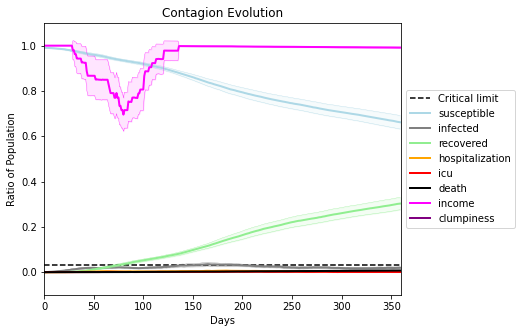

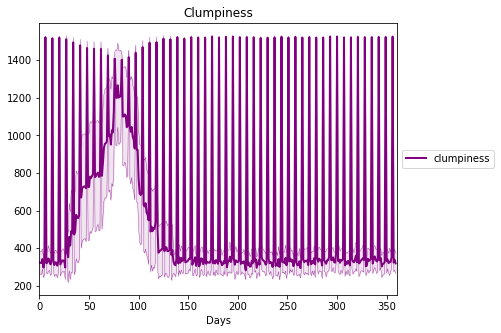

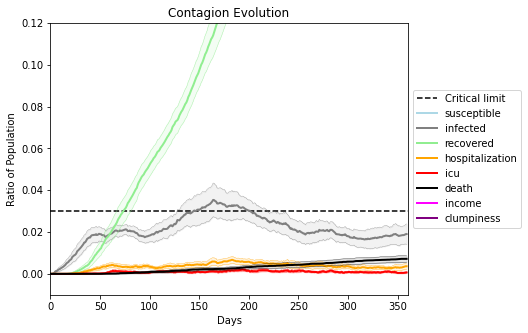

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8277, 61, 3168, 1144, 7689, 8038, 2140, 3471, 8695, 1980, 699, 2452, 545, 5558, 6565, 7364, 2264, 38, 954, 2667]
Average similarity between family members is 0.9340438508149956 at temperature -0.993
Average similarity between family and home is 0.9998561202728063 at temperature -1
Average similarity between students and their classroom is 0.8470271884552754 at temperature -0.993
Average classroom occupancy is 1.6793478260869565 and number classrooms is 184
Average similarity between workers is 0.8655506334688532 at temperature -0.993
Average office occupancy is 3.248730964467005 and number offices is 197
Average friend similarity for adults: 0.8447388352391767 for kids: 0.7328434112984982
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.4171156847454078
avg restaurant similarity 0.5441872277817768
avg restaurant similarity 0.6791388092339246
avg restaurant similarity 0.6349537647442162
avg restaurant similarity 0.30981125137662696
avg restaurant similarity 0.5318018459775582
avg restaurant similarity 0.5026424824603126
avg restaurant similarity 0.6515254603652045
avg restaurant similarity 0.4138474067847573
avg restaurant similarity 0.48233301231980313
avg restaurant similarity 0.5690113963535004
avg restaurant similarity 0.43261587712428856
avg restaurant similarity 0.8367849452044094
avg restaurant similarity 0.4428467933498682
avg restaurant similarity 0.486606884169389
avg restaurant similarity 0.8264607448164731
avg restaurant similarity 0.45814152848300393
avg restaurant similarity 0.5231939357426556
avg restaurant similarity 0.5508403491118887
avg restaurant similarity 0.4785992870514053
avg restaurant similarity 0.8692749400544126
avg restaurant similarity 0.5617386919385631
avg res

Average similarity between family members is 0.9252053663962797 at temperature -0.993
Average similarity between family and home is 0.9998645360681001 at temperature -1
Average similarity between students and their classroom is 0.852640422670308 at temperature -0.993
Average classroom occupancy is 1.722543352601156 and number classrooms is 173
Average similarity between workers is 0.8736107468845298 at temperature -0.993
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8437134132220289 for kids: 0.7356950537237431
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.6359330319648951
avg restaurant similarity 0.4393546543216902
avg restaurant similarity 0.4131929803531269
avg restaurant similarity 0.47430925246783073
avg restaurant similarity 0.5908094416101881
avg restaurant similarity 0.3780512633197249
avg restaurant similarity 0.5528359887654368
avg restaurant similarity 0.3751759050635983
avg restaurant similarity 0.4807403372553507
avg restaurant similarity 0.5084848769057443
avg restaurant similarity 0.5186980857879102
avg restaurant similarity 0.8861150747195115
avg restaurant similarity 0.3758830455336412
avg restaurant similarity 0.5067798115609681
avg restaurant similarity 0.6648272547094312
avg restaurant similarity 0.05262810983729585
avg restaurant similarity 0.4507435600240228
avg restaurant similarity 0.5784913990698326
avg restaurant similarity 0.14911344146743272
avg restaurant similarity 0.3649121418437821
avg restaurant similarity 0.4968498173251682
avg restaurant similarity 0.5159884427972413
avg res

Average similarity between workers is 0.8708692956893362 at temperature -0.993
Average office occupancy is 3.4030612244897958 and number offices is 196
Average friend similarity for adults: 0.8523215730732783 for kids: 0.7314343258736923
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.6412128243770466
avg restaurant similarity 0.6006867421981114
avg restaurant similarity 0.4666190817882952
avg restaurant similarity 0.5025629976439225
avg restaurant similarity 0.5575178779068503
avg restaurant similarity 0.9999676830593183
avg restaurant similarity 0.6350103674027824
avg restaurant similarity 0.3670285332513369
avg restaurant similarity 0.45480395671453083
avg restaurant similarity 0.8083111460252563
avg restaurant similarity 0.45631933371666855
avg restaurant similarity 0.521948485515584
avg restaurant similarity 0.4926889077528686
avg restaurant similarity 0.4389953159302793
avg restaurant similarity 0.3541844657479875
avg restaurant similarity 0.6018889975986909
avg restaurant similarity 0.6005746448084435
avg restaurant similarity 0.6246498678676584
avg restaurant similarity 0.9997854740425995
avg restaurant similarity 0.5325200944043622
avg restaurant similarity 0.2738972227106322
avg restaurant similarity 0.49037390054637425
avg rest

avg restaurant similarity 0.5214396215184443
avg restaurant similarity 0.6883092231901164
avg restaurant similarity 0.34761377656789794
avg restaurant similarity 0.46812718686303556
avg restaurant similarity 0.36973342584099045
avg restaurant similarity 0.4504384947231309
avg restaurant similarity 0.9186472634512488
avg restaurant similarity 0.6159289256445938
avg restaurant similarity 0.24218681768456818
avg restaurant similarity 0.4467595517071043
avg restaurant similarity 0.6602262746055754
avg restaurant similarity 0.549551902728842
avg restaurant similarity 0.3853871793352627
avg restaurant similarity 0.5012515140579141
avg restaurant similarity 0.4279826002908359
avg restaurant similarity 0.6221786394290377
avg restaurant similarity 0.45808207178958965
avg restaurant similarity 0.8002133814575482
avg restaurant similarity 0.6425554897554093
avg restaurant similarity 0.26248754527908885
avg restaurant similarity 0.3777900767484297
avg restaurant similarity 0.6206572517453983
avg r

avg restaurant similarity 0.6467023714397996
avg restaurant similarity 0.7868759289972911
avg restaurant similarity 0.4535098425829584
avg restaurant similarity 0.7636053211110072
avg restaurant similarity 0.4499820787246642
avg restaurant similarity 0.48373547311418397
avg restaurant similarity 0.4807414697652479
avg restaurant similarity 0.4484697629483949
avg restaurant similarity 0.6388346232906275
avg restaurant similarity 0.6664348163466046
avg restaurant similarity 0.3953946502491004
avg restaurant similarity 0.4125604674588051
avg restaurant similarity 0.7868759289972911
avg restaurant similarity 0.14648386741902325
avg restaurant similarity 0.3858516711851888
avg restaurant similarity 0.43549339532247133
avg restaurant similarity 0.5160470733423556
avg restaurant similarity 0.9995478765507518
avg restaurant similarity 0.6913237226061544
avg restaurant similarity 0.4535098425829584
avg restaurant similarity 0.47973150747255466
avg restaurant similarity 0.6812731051236298
avg re

Average friend similarity for adults: 0.8461009642461396 for kids: 0.7397244116116616
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.5820680315184877
avg restaurant similarity 0.42857075397676775
avg restaurant similarity 0.8767784335498583
avg restaurant similarity 0.5794136460404689
avg restaurant similarity 0.37640546823157733
avg restaurant similarity 0.5690610346947573
avg restaurant similarity 0.4086518035725472
avg restaurant similarity 0.4407644285694722
avg restaurant similarity 0.6447853843633475
avg restaurant similarity 0.4508165944957211
avg restaurant similarity 0.40879348537978555
avg restaurant similarity 0.6003053108690231
avg restaurant similarity 0.3709018932550083
avg restaurant similarity 0.7289350602160614
avg restaurant similarity 0.40679421168635155
avg restaurant similarity 0.5997877321965052
avg restaurant similarity 0.5944753624420218
avg restaurant similarity 0.617568261605673
avg restaurant similarity 0.5659416955265808
avg restaurant similarity 0.43108529689177255
avg restaurant similarity 0.5951284160915138
avg restaurant similarity 0.5412018744238427
avg re

avg restaurant similarity 0.35261683555139567
avg restaurant similarity 0.838804711697406
avg restaurant similarity 0.7547230490526298
avg restaurant similarity 0.3771690809492822
avg restaurant similarity 0.38909542250744855
avg restaurant similarity 0.4742067186776834
avg restaurant similarity 0.36186047162707236
avg restaurant similarity 0.36762254695553503
avg restaurant similarity 0.5135507146143836
avg restaurant similarity 0.6635578399464344
avg restaurant similarity 0.5529475838557292
avg restaurant similarity 0.4924391375768438
avg restaurant similarity 0.3703649618233461
avg restaurant similarity 0.33090052735371006
avg restaurant similarity 0.47650346846829406
avg restaurant similarity 0.7837400482717398
avg restaurant similarity 0.6699509428265924
avg restaurant similarity 0.44197599939776955
avg restaurant similarity 0.4666968418989873
avg restaurant similarity 0.4622026743056643
avg restaurant similarity 0.6366566955747788
avg restaurant similarity 0.4278800449215514
avg 

avg restaurant similarity 0.9365101813319183
avg restaurant similarity 0.5240186793410039
avg restaurant similarity 0.45329628150354473
avg restaurant similarity 0.4042183881840371
avg restaurant similarity 0.6695032256613842
avg restaurant similarity 0.42107550379000414
avg restaurant similarity 0.7754143627348815
avg restaurant similarity 0.5093057804378782
avg restaurant similarity 0.4367705007309934
avg restaurant similarity 0.6069032840725948
avg restaurant similarity 0.47994056668055934
avg restaurant similarity 0.5308614360926902
avg restaurant similarity 0.24609370959349403
avg restaurant similarity 0.25032035617391274
avg restaurant similarity 0.45901480465264444
avg restaurant similarity 0.6399036540697237
avg restaurant similarity 0.4517528872773254
avg restaurant similarity 0.5934465684166526
avg restaurant similarity 0.46120157817677826
avg restaurant similarity 0.2991699766440493
avg restaurant similarity 0.18151729419921267
avg restaurant similarity 0.41174431818434554
a

avg restaurant similarity 0.6123819541371334
avg restaurant similarity 0.58503280013289
avg restaurant similarity 0.41882092045362107
avg restaurant similarity 0.429753261455906
avg restaurant similarity 0.49925428362178303
avg restaurant similarity 0.5653686593325522
avg restaurant similarity 0.3742711520564469
avg restaurant similarity 0.40811024439739035
avg restaurant similarity 0.5476529679268443
avg restaurant similarity 0.41159442233500193
avg restaurant similarity 0.35218830454687006
avg restaurant similarity 0.7056145791257128
avg restaurant similarity 0.5278526700898187
avg restaurant similarity 0.3675637792930058
avg restaurant similarity 0.41568244065509585
avg restaurant similarity 0.6321709117797298
avg restaurant similarity 0.4653145267688759
avg restaurant similarity 0.4144369382611598
avg restaurant similarity 0.7486002096762121
avg restaurant similarity 0.5100894127183352
avg restaurant similarity 0.6550953266142142
avg restaurant similarity 0.47485851697076203
avg re

avg restaurant similarity 0.512707438749013
avg restaurant similarity 0.8763793854542983
avg restaurant similarity 0.4606643626685549
avg restaurant similarity 0.4708413125670512
avg restaurant similarity 0.29348463765863897
avg restaurant similarity 0.6721067142123622
avg restaurant similarity 0.5100894127183352
avg restaurant similarity 0.34718824224998246
avg restaurant similarity 0.674776979547189
avg restaurant similarity 0.4758588997606489
avg restaurant similarity 0.8542908459607419
avg restaurant similarity 0.36840261936936014
avg restaurant similarity 0.3897369975678397
avg restaurant similarity 0.6007215145954311
avg restaurant similarity 0.43156691886768206
avg restaurant similarity 0.4014743129223664
avg restaurant similarity 0.3912299234970844
avg restaurant similarity 0.5407310764082325
avg restaurant similarity 0.5653686593325522
avg restaurant similarity 0.13586361859248225
avg restaurant similarity 0.32294903229758876
avg restaurant similarity 0.5186088669889161
Averag

avg restaurant similarity 0.6287864360308177
avg restaurant similarity 0.5335028229148127
avg restaurant similarity 0.4145718837896668
avg restaurant similarity 0.3700085913572157
avg restaurant similarity 0.29773270071408886
avg restaurant similarity 0.5985312719212179
avg restaurant similarity 0.865524480426607
avg restaurant similarity 0.4927202305638792
avg restaurant similarity 0.865524480426607
avg restaurant similarity 0.5973399185221235
avg restaurant similarity 0.5421231114557834
avg restaurant similarity 0.5121163543483116
avg restaurant similarity 0.42007037068193925
avg restaurant similarity 0.5995070623631429
avg restaurant similarity 0.5985312719212179
avg restaurant similarity 0.4063343836908493
avg restaurant similarity 0.4708518406714153
avg restaurant similarity 0.7157204842398848
avg restaurant similarity 0.35767566126144706
avg restaurant similarity 0.5985312719212179
avg restaurant similarity 0.599866966869398
avg restaurant similarity 0.3700085913572157
avg restau

avg restaurant similarity 0.3041396889792932
Average similarity between family members is 0.924811090716838 at temperature -0.993
Average similarity between family and home is 0.9998639229631796 at temperature -1
Average similarity between students and their classroom is 0.857544228263935 at temperature -0.993
Average classroom occupancy is 1.7222222222222223 and number classrooms is 180
Average similarity between workers is 0.8718327105263524 at temperature -0.993
Average office occupancy is 3.321243523316062 and number offices is 193
Average friend similarity for adults: 0.8388950423182806 for kids: 0.7360627927072789
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.4841095367240921
avg restaurant similarity 0.6335897904889886
avg restaurant similarity 0.9999237916826162
avg restaurant similarity 0.5708303166150874
avg restaurant similarity 0.5024090828883602
avg restaurant similarity 0.5829883570151664
avg restaurant similarity 0.7194562206602547
avg restaurant similarity 0.18263392240297333
avg restaurant similarity 0.47875540487818147
avg restaurant similarity 0.6159728851051514
avg restaurant similarity 0.4142640909367068
avg restaurant similarity 0.6962397862057355
avg restaurant similarity 0.6790094001861494
avg restaurant similarity 0.3070203716409269
avg restaurant similarity 0.5186687894649673
avg restaurant similarity 0.4468634437419357
avg restaurant similarity 0.40414521985049756
avg restaurant similarity 0.42133660004203166
avg restaurant similarity 0.5881424954939092
avg restaurant similarity 0.5937041447563688
avg restaurant similarity 0.4867212149398872
avg restaurant similarity 0.46726937074694297
avg r

avg restaurant similarity 0.33018731525845213
avg restaurant similarity 0.9997363706033897
avg restaurant similarity 0.4441601344282921
avg restaurant similarity 0.478388482825302
avg restaurant similarity 0.3874653853406058
avg restaurant similarity 0.5695208874453642
avg restaurant similarity 0.4979543237850741
avg restaurant similarity 0.47118581962091627
avg restaurant similarity 0.4287923805082464
avg restaurant similarity 0.3876173384771611
avg restaurant similarity 0.33170824146613676
avg restaurant similarity 0.6092505183599416
avg restaurant similarity 0.3874653853406058
avg restaurant similarity 0.5833295086298227
avg restaurant similarity 0.46746851285887403
avg restaurant similarity 0.472712990146374
avg restaurant similarity 0.43312795261385284
avg restaurant similarity 0.592790160525605
avg restaurant similarity 0.5301587979190122
avg restaurant similarity 0.3653148968583988
avg restaurant similarity 0.5184291756685797
avg restaurant similarity 0.24385006388398836
avg res

avg restaurant similarity 0.6029860070092081
avg restaurant similarity 0.758059347883456
avg restaurant similarity 0.7282407706605372
avg restaurant similarity 0.4500390759552517
avg restaurant similarity 0.3839173138415046
avg restaurant similarity 0.7214856966462534
avg restaurant similarity 0.5047078838628032
avg restaurant similarity 0.5142476370611107
avg restaurant similarity 0.5046627325873894
avg restaurant similarity 0.5054590020574493
avg restaurant similarity 0.5019424532114863
avg restaurant similarity 0.9998191804948184
avg restaurant similarity 0.8870646319690578
avg restaurant similarity 0.4904040218343637
avg restaurant similarity 0.7613052360705573
avg restaurant similarity 0.4523788428583446
avg restaurant similarity 0.566685993907742
avg restaurant similarity 0.5847437619361845
avg restaurant similarity 0.5049962032024833
avg restaurant similarity 0.5057624953658955
avg restaurant similarity 0.47950244981848655
avg restaurant similarity 0.5840194397498017
avg restaur

avg restaurant similarity 0.4690633328583582
avg restaurant similarity 0.46904184703203633
avg restaurant similarity 0.37511310348371185
avg restaurant similarity 0.8533073800763771
avg restaurant similarity 0.5828148336618589
avg restaurant similarity 0.4168432983271049
avg restaurant similarity 0.4273159542357519
avg restaurant similarity 0.6463735149316163
avg restaurant similarity 0.27647835320500097
avg restaurant similarity 0.3206845697770627
avg restaurant similarity 0.8172607975164397
avg restaurant similarity 0.49104021445322493
avg restaurant similarity 0.33880634823643807
avg restaurant similarity 0.48028028472506346
avg restaurant similarity 0.5566709981339496
avg restaurant similarity 0.3977227963075223
avg restaurant similarity 0.5284826729838475
avg restaurant similarity 0.49741672977209794
avg restaurant similarity 0.6248557047577216
avg restaurant similarity 0.6122258093636955
avg restaurant similarity 0.5793170679034481
avg restaurant similarity 0.2793381417003703
avg

avg restaurant similarity 0.6270891622532484
avg restaurant similarity 0.2927516519768754
avg restaurant similarity 0.7763502611350332
avg restaurant similarity 0.38133407470849345
avg restaurant similarity 0.37113499939483185
avg restaurant similarity 0.488694302012438
avg restaurant similarity 0.4054427792019722
avg restaurant similarity 0.5296130921383415
avg restaurant similarity 0.4515219346183096
avg restaurant similarity 0.37547016239893527
avg restaurant similarity 0.19519149696862365
avg restaurant similarity 0.6765444632922629
avg restaurant similarity 0.5031647576068551
avg restaurant similarity 0.5450254134265625
avg restaurant similarity 0.777092228690051
avg restaurant similarity 0.4887184449704459
avg restaurant similarity 0.5562530977122084
avg restaurant similarity 0.6642632586094447
Average similarity between family members is 0.9244077484851202 at temperature -0.993
Average similarity between family and home is 0.999854202947659 at temperature -1
Average similarity b

avg restaurant similarity 0.414719502887105
avg restaurant similarity 0.677902902282332
avg restaurant similarity 0.5725129446359373
avg restaurant similarity 0.5489621682936952
avg restaurant similarity 0.5546197140104988
avg restaurant similarity 0.5591088641069468
avg restaurant similarity 0.33301976225451996
avg restaurant similarity 0.6717665582197143
avg restaurant similarity 0.13385517817652615
avg restaurant similarity 0.28388412545975483
avg restaurant similarity 0.20919505854954631
avg restaurant similarity 0.5683725673381613
avg restaurant similarity 0.311499346289592
avg restaurant similarity 0.4815004366497445
avg restaurant similarity 0.6471928684719964
avg restaurant similarity 0.5241132624630219
avg restaurant similarity 0.46094675699203497
avg restaurant similarity 0.4178798959960218
avg restaurant similarity 0.414719502887105
avg restaurant similarity 0.44396598495137796
avg restaurant similarity 0.7832503527421824
avg restaurant similarity 0.35199162796609984
avg res

avg restaurant similarity 0.7581505852094189
avg restaurant similarity 0.5969019847774477
avg restaurant similarity 0.31884930680399615
avg restaurant similarity 0.6334304691620145
avg restaurant similarity 0.4075473969430441
avg restaurant similarity 0.36904520098991994
avg restaurant similarity 0.4703967806128557
avg restaurant similarity 0.6381521545388316
avg restaurant similarity 0.46151507397694935
avg restaurant similarity 0.5323708112019016
avg restaurant similarity 0.4035665285911959
avg restaurant similarity 0.4479449646002084
avg restaurant similarity 0.6251486858075719
avg restaurant similarity 0.21238592591992356
avg restaurant similarity 0.3623284989038947
avg restaurant similarity 0.41154262802171604
avg restaurant similarity 0.6241425817723423
avg restaurant similarity 0.5955280590978258
avg restaurant similarity 0.5486099348197422
avg restaurant similarity 0.8243122077950463
avg restaurant similarity 0.4393146647350752
avg restaurant similarity 0.6634317098836463
avg r

avg restaurant similarity 0.24689151279081592
avg restaurant similarity 0.4999289983541899
avg restaurant similarity 0.633343977511841
avg restaurant similarity 0.44759177322281574
avg restaurant similarity 0.5401668865138174
avg restaurant similarity 0.48401621876766565
avg restaurant similarity 0.4189304428477588
avg restaurant similarity 0.3176042847237359
avg restaurant similarity 0.5568929076575553
avg restaurant similarity 0.12153241117432398
avg restaurant similarity 0.3941774769309794
avg restaurant similarity 0.44156266322376525
avg restaurant similarity 0.3594422992845059
avg restaurant similarity 0.5185817221376492
avg restaurant similarity 0.6577787214029602
avg restaurant similarity 0.8472927364028593
avg restaurant similarity 0.5633950031371289
avg restaurant similarity 0.6112185422264035
avg restaurant similarity 0.6189978029694365
avg restaurant similarity 0.6394667463971622
avg restaurant similarity 0.48401621876766565
avg restaurant similarity 0.6608794241999223
avg r

Average friend similarity for adults: 0.8531171685923553 for kids: 0.7367474845671887
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.5965457478959412
avg restaurant similarity 0.6603520106064981
avg restaurant similarity 0.49662568835252385
avg restaurant similarity 0.5788508360898365
avg restaurant similarity 0.3728084643291001
avg restaurant similarity 0.4758013970636672
avg restaurant similarity 0.8755633002344787
avg restaurant similarity 0.4422600530783089
avg restaurant similarity 0.5791519950714452
avg restaurant similarity 0.5401700597108398
avg restaurant similarity 0.670545949378141
avg restaurant similarity 0.5815417358874976
avg restaurant similarity 0.6089652503601757
avg restaurant similarity 0.6199652636249452
avg restaurant similarity 0.4066383563420978
avg restaurant similarity 0.7185773819524737
avg restaurant similarity 0.8868203207915648
avg restaurant similarity 0.5773382543085481
avg restaurant similarity 0.579424530877771
avg restaurant similarity 0.6425656920480162
avg restaurant similarity 0.6445786075436923
avg restaurant similarity 0.46611121428914415
avg restau

avg restaurant similarity 0.5449559963599326
avg restaurant similarity 0.6034218807453648
avg restaurant similarity 0.7942230985035608
avg restaurant similarity 0.8246008277797492
avg restaurant similarity 0.838026721539529
avg restaurant similarity 0.584704350949055
avg restaurant similarity 0.37235424975425807
avg restaurant similarity 0.8735051767466556
avg restaurant similarity 0.46169923207822333
avg restaurant similarity 0.5259572994863125
avg restaurant similarity 0.3686300737521422
avg restaurant similarity 0.8322045498889392
avg restaurant similarity 0.40294774362663827
avg restaurant similarity 0.5124018832287967
avg restaurant similarity 0.4558805758610919
avg restaurant similarity 0.9299877034663431
avg restaurant similarity 0.551072079498101
avg restaurant similarity 0.4709471729263295
avg restaurant similarity 0.6805717951404882
avg restaurant similarity 0.7194643287758726
avg restaurant similarity 0.5187865902968534
avg restaurant similarity 0.6492540194410262
avg restau

avg restaurant similarity 0.7913043825493047
avg restaurant similarity 0.821572356323963
avg restaurant similarity 0.8652752415209567
avg restaurant similarity 0.48248411946397485
avg restaurant similarity 0.3703280567964467
avg restaurant similarity 0.7912895313117148
avg restaurant similarity 0.626038154348622
avg restaurant similarity 0.526523465978538
avg restaurant similarity 0.43514716696418976
avg restaurant similarity 0.7574634832877312
avg restaurant similarity 0.8404820321190289
avg restaurant similarity 0.3715633386429982
avg restaurant similarity 0.4737824133403681
Average similarity between family members is 0.9276281189185436 at temperature -0.993
Average similarity between family and home is 0.9998556624656761 at temperature -1
Average similarity between students and their classroom is 0.853459678030336 at temperature -0.993
Average classroom occupancy is 1.6379310344827587 and number classrooms is 174
Average similarity between workers is 0.865813783021104 at temperatur

avg restaurant similarity 0.5968899298369654
avg restaurant similarity 0.8299809911968474
avg restaurant similarity 0.47099656130157386
avg restaurant similarity 0.46879919788499724
avg restaurant similarity 0.9997105287043083
avg restaurant similarity 0.6610159805453251
avg restaurant similarity 0.8205302997681605
avg restaurant similarity 0.5473524293157808
avg restaurant similarity 0.5559327117259771
avg restaurant similarity 0.5185829264603197
avg restaurant similarity 0.4385230826684342
avg restaurant similarity 0.46103036514652
avg restaurant similarity 0.6742666298499088
avg restaurant similarity 0.5266296405786627
avg restaurant similarity 0.40990116742992366
avg restaurant similarity 0.5438154746175683
avg restaurant similarity 0.7188908459617976
avg restaurant similarity 0.5874168158143738
avg restaurant similarity 0.6181535574740132
avg restaurant similarity 0.28410384251477994
avg restaurant similarity 0.5831190218491508
avg restaurant similarity 0.7263338889831729
avg rest

avg restaurant similarity 0.4619179683347162
avg restaurant similarity 0.49325264076298336
avg restaurant similarity 0.41830313161206584
avg restaurant similarity 0.30899854476833866
avg restaurant similarity 0.8232270691058373
avg restaurant similarity 0.5050209774313715
avg restaurant similarity 0.8230287901060254
avg restaurant similarity 0.589328892474565
avg restaurant similarity 0.45874804196526026
avg restaurant similarity 0.7911838052672759
avg restaurant similarity 0.34811965262299527
Average similarity between family members is 0.9322769029240018 at temperature -0.993
Average similarity between family and home is 0.9998602165683769 at temperature -1
Average similarity between students and their classroom is 0.8476647954364335 at temperature -0.993
Average classroom occupancy is 1.6574585635359116 and number classrooms is 181
Average similarity between workers is 0.8774855606887029 at temperature -0.993
Average office occupancy is 3.4166666666666665 and number offices is 192
A

avg restaurant similarity 0.6230675876512424
avg restaurant similarity 0.34932136441170536
avg restaurant similarity 0.9262201415043572
avg restaurant similarity 0.42204183665153444
avg restaurant similarity 0.4205787647373999
avg restaurant similarity 0.43096601968105586
avg restaurant similarity 0.39743623995322563
avg restaurant similarity 0.5886501160680956
avg restaurant similarity 0.9997397374749664
avg restaurant similarity 0.5512278396910169
avg restaurant similarity 0.7245173151724239
avg restaurant similarity 0.8348966613613136
avg restaurant similarity 0.625870624615138
avg restaurant similarity 0.2906724052935087
avg restaurant similarity 0.7141962203333859
avg restaurant similarity 0.7430388336645551
avg restaurant similarity 0.5799286690119758
avg restaurant similarity 0.8080557501545529
avg restaurant similarity 0.30951693184676005
avg restaurant similarity 0.5495590677292794
avg restaurant similarity 0.40649450602082904
avg restaurant similarity 0.5987546395351574
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

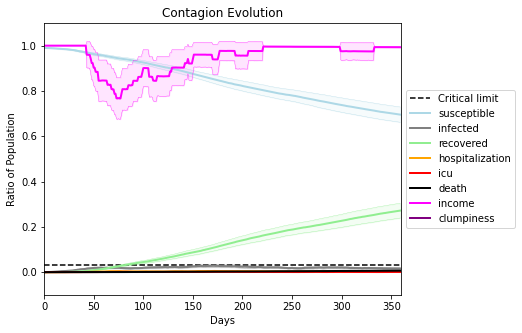

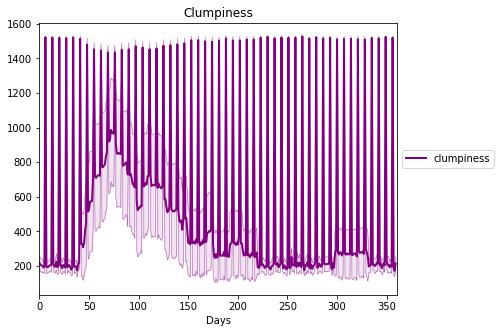

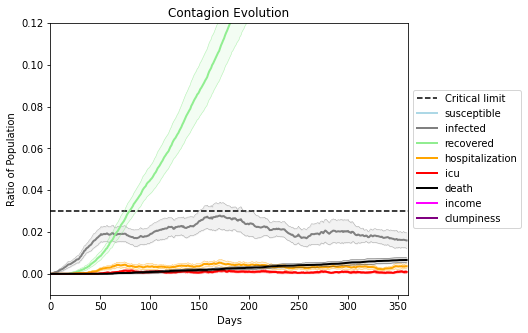

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8826, 6700, 9004, 2617, 71, 4426, 8731, 8530, 5002, 638, 5902, 8169, 3769, 5572, 7506, 5077, 4647, 9108, 9350, 907]
Average similarity between family members is 0.922218461727491 at temperature -0.992
Average similarity between family and home is 0.9998597323791844 at temperature -1
Average similarity between students and their classroom is 0.8318892646868518 at temperature -0.992
Average classroom occupancy is 1.6822916666666667 and number classrooms is 192
Average similarity between workers is 0.8517003483346273 at temperature -0.992
Average office occupancy is 3.1538461538461537 and number offices is 195
Average friend similarity for adults: 0.8335346556200948 for kids: 0.7393111475879156
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.4081105923827947
avg restaurant similarity 0.569049310620947
avg restaurant similarity 0.18564737551684232
avg restaurant similarity 0.5997125440174114
avg restaurant similarity 0.6383959487133568
avg restaurant similarity 0.6986808889438284
avg restaurant similarity 0.8205714826817827
avg restaurant similarity 0.5128235001972996
avg restaurant similarity 0.24991209510753087
avg restaurant similarity 0.30454317761852145
avg restaurant similarity 0.5466784232174066
avg restaurant similarity 0.6217619857664641
avg restaurant similarity 0.999853112876177
avg restaurant similarity 0.47345991231632756
avg restaurant similarity 0.46231138769103136
avg restaurant similarity 0.6296753881462966
avg restaurant similarity 0.4527237748579466
avg restaurant similarity 0.4909534904357542
avg restaurant similarity 0.5054653799786424
avg restaurant similarity -0.05867123078948133
avg restaurant similarity 0.21103772313033187
avg restaurant similarity 0.49002424615462203
avg

avg restaurant similarity 0.47376993330198264
avg restaurant similarity 0.7458913269802141
avg restaurant similarity 0.8295995974497219
avg restaurant similarity 0.45358236683734515
avg restaurant similarity 0.8055560899136651
avg restaurant similarity 0.45613376691507435
avg restaurant similarity 0.4372391817297747
avg restaurant similarity 0.5125237581063466
avg restaurant similarity 0.5138364490240126
avg restaurant similarity 0.7144374417360624
avg restaurant similarity 0.49552122679225774
avg restaurant similarity 0.6297535495521844
avg restaurant similarity 0.5364374223409766
avg restaurant similarity 0.5137595735778554
avg restaurant similarity 0.6082676498792184
avg restaurant similarity 0.20841160208082282
avg restaurant similarity 0.540175229923489
avg restaurant similarity 0.5421104568729379
avg restaurant similarity 0.45588686879935175
avg restaurant similarity 0.8933272926107831
avg restaurant similarity 0.6838130467520125
avg restaurant similarity 0.8328455782478712
avg r

avg restaurant similarity 0.999584488685623
avg restaurant similarity 0.44607106122469137
avg restaurant similarity 0.33224047075253316
avg restaurant similarity 0.46413103076752993
avg restaurant similarity 0.49292987469322025
avg restaurant similarity 0.6238540276131255
avg restaurant similarity 0.4680439129321711
avg restaurant similarity 0.5643694030594056
avg restaurant similarity 0.8475680867463163
avg restaurant similarity 0.5486323287696443
avg restaurant similarity 0.36023243195609156
avg restaurant similarity 0.43408386407088684
avg restaurant similarity 0.49257426983152724
avg restaurant similarity 0.44012487616615636
avg restaurant similarity 0.6422208325204193
avg restaurant similarity 0.36488812267909987
avg restaurant similarity 0.4068695963917652
avg restaurant similarity 0.33257458416705726
avg restaurant similarity 0.9998443225729046
avg restaurant similarity 0.44626640718619803
avg restaurant similarity 0.6508228800848392
avg restaurant similarity 0.5780776799834182


avg restaurant similarity 0.6064509546430853
avg restaurant similarity 0.4184335014090724
avg restaurant similarity 0.43366768705500625
avg restaurant similarity 0.47880134165724997
avg restaurant similarity 0.4061808024875305
avg restaurant similarity 0.47602457368386597
avg restaurant similarity 0.8507444086557827
avg restaurant similarity 0.49958524910121616
avg restaurant similarity 0.5795513136242213
avg restaurant similarity 0.7876964325943834
avg restaurant similarity 0.5590661282463538
avg restaurant similarity 0.6169047294581593
avg restaurant similarity 0.612132084344206
avg restaurant similarity 0.6994212565208746
avg restaurant similarity 0.4501579088486092
avg restaurant similarity 0.33257458416705726
avg restaurant similarity 0.5299991614150977
avg restaurant similarity 0.4021537226501817
avg restaurant similarity 0.5409901546120394
avg restaurant similarity 0.5621980447224697
avg restaurant similarity 0.5064240216323326
avg restaurant similarity 0.4302551184153437
avg re

avg restaurant similarity 0.5642222118810225
avg restaurant similarity 0.5223922777745996
avg restaurant similarity 0.6057422126079566
avg restaurant similarity 0.5173788312980554
avg restaurant similarity 0.350623792597125
avg restaurant similarity 0.4003534377630444
avg restaurant similarity 0.1424920707972088
avg restaurant similarity 0.5694120028736375
avg restaurant similarity 0.47854259116685544
avg restaurant similarity 0.35450404737064756
avg restaurant similarity 0.43692621934562037
avg restaurant similarity 0.44016154102675586
avg restaurant similarity 0.6070766801297435
avg restaurant similarity 0.1504254039662503
avg restaurant similarity 0.5831113731031744
avg restaurant similarity 0.213133463379785
avg restaurant similarity 0.9998186845631188
avg restaurant similarity 0.46681999437262717
avg restaurant similarity 0.14750241256607008
avg restaurant similarity 0.5633579017633179
avg restaurant similarity 0.9223964921599557
avg restaurant similarity 0.49396852785747425
avg r

avg restaurant similarity 0.5502164864505514
avg restaurant similarity 0.8413773684558223
avg restaurant similarity 0.2291254480488204
avg restaurant similarity 0.7427217214562889
avg restaurant similarity 0.4684190551835016
avg restaurant similarity 0.6153160627430323
avg restaurant similarity 0.5440491062531111
avg restaurant similarity 0.513490282568327
avg restaurant similarity 0.6584651537835791
avg restaurant similarity 0.5399699554358888
avg restaurant similarity 0.7797387470813517
avg restaurant similarity 0.4260883513357905
avg restaurant similarity 0.8443524392905928
avg restaurant similarity 0.491203918712144
avg restaurant similarity 0.5967507826802219
avg restaurant similarity 0.5341303490481288
avg restaurant similarity 0.6850797027906417
avg restaurant similarity 0.43542680174882015
avg restaurant similarity 0.5399699554358888
avg restaurant similarity 0.42926302237483105
avg restaurant similarity 0.578782940721794
avg restaurant similarity 0.48337814576667737
avg restau

avg restaurant similarity 0.5223323368770143
avg restaurant similarity 0.8722524844495372
avg restaurant similarity 0.4335008948223218
avg restaurant similarity 0.4854225140643714
avg restaurant similarity 0.6051185181073991
avg restaurant similarity 0.8719811487991368
avg restaurant similarity 0.3681370176537187
avg restaurant similarity 0.6826581198990426
avg restaurant similarity 0.4860602787842702
avg restaurant similarity 0.5714537430023957
avg restaurant similarity 0.6876230136042981
avg restaurant similarity 0.8389013301535004
avg restaurant similarity 0.5153569194370319
avg restaurant similarity 0.4230141261689065
avg restaurant similarity 0.22364631941139398
avg restaurant similarity 0.47556151296654353
avg restaurant similarity 0.4068763501148341
avg restaurant similarity 0.22253281801810643
avg restaurant similarity 0.6597014875529876
avg restaurant similarity 0.5513865679443368
avg restaurant similarity 0.6457147584225577
avg restaurant similarity 0.5290757020120651
avg res

avg restaurant similarity 0.6165695986849411
avg restaurant similarity 0.5562458336848664
avg restaurant similarity 0.5001959907506031
avg restaurant similarity 0.4214729447455166
avg restaurant similarity 0.47908704779653294
avg restaurant similarity 0.6174887458031056
avg restaurant similarity 0.45200103367731725
avg restaurant similarity 0.42753680495015506
avg restaurant similarity 0.6288373644235296
avg restaurant similarity 0.5263802303392109
avg restaurant similarity 0.484529794834789
avg restaurant similarity 0.5385921103815332
avg restaurant similarity 0.5333898370718548
avg restaurant similarity 0.5689266737832603
avg restaurant similarity 0.3803965894884421
avg restaurant similarity 0.36861025705149286
avg restaurant similarity 0.5757041042529141
avg restaurant similarity 0.49703051545380056
avg restaurant similarity 0.5393993907109373
avg restaurant similarity 0.412874831032578
avg restaurant similarity 0.6027180880545496
avg restaurant similarity 0.6174887458031056
avg res

avg restaurant similarity 0.6628504627770553
avg restaurant similarity 0.8656563246015001
avg restaurant similarity 0.6635392976407789
avg restaurant similarity 0.6378409703287646
avg restaurant similarity 0.35963214306478475
avg restaurant similarity 0.4077821225495699
avg restaurant similarity 0.32762408408377336
avg restaurant similarity 0.4278661556309331
avg restaurant similarity 0.4943546055155664
avg restaurant similarity 0.4948504561850002
avg restaurant similarity 0.6139502368794278
avg restaurant similarity 0.6717121186763693
avg restaurant similarity 0.30730593014020424
avg restaurant similarity 0.2865650968643629
avg restaurant similarity 0.5535998088098149
avg restaurant similarity 0.21887148239669366
avg restaurant similarity 0.5055899227897116
avg restaurant similarity 0.6056674921812165
avg restaurant similarity 0.3036174648484661
avg restaurant similarity 0.5072328671955029
avg restaurant similarity 0.17455098153375037
avg restaurant similarity 0.43073389737328444
avg 

avg restaurant similarity 0.7347176890132279
avg restaurant similarity 0.5350106258949577
avg restaurant similarity 0.5351687330292533
avg restaurant similarity 0.43480186898321393
avg restaurant similarity 0.6136922444550232
avg restaurant similarity 0.4224576351194928
avg restaurant similarity 0.36169136676814106
avg restaurant similarity 0.520268996077003
avg restaurant similarity 0.7336400309680317
avg restaurant similarity 0.48251422226245605
avg restaurant similarity 0.5845973904379242
avg restaurant similarity 0.574001309339651
avg restaurant similarity 0.4317718614115577
avg restaurant similarity 0.5197886536563816
avg restaurant similarity 0.549785180860173
avg restaurant similarity 0.3247195203821158
avg restaurant similarity 0.586467336795282
avg restaurant similarity 0.4552207999460791
avg restaurant similarity 0.3829080042789731
avg restaurant similarity 0.4233996759581256
avg restaurant similarity 0.6712481313446819
avg restaurant similarity 0.40292012426982954
avg restau

avg restaurant similarity 0.42142027471915827
avg restaurant similarity 0.563717125191474
avg restaurant similarity 0.42219683837151795
avg restaurant similarity 0.657736588657286
avg restaurant similarity 0.6274755321223318
avg restaurant similarity 0.40356125044587565
avg restaurant similarity 0.5929860585586442
avg restaurant similarity 0.5721294587173728
avg restaurant similarity 0.5550284367738175
avg restaurant similarity 0.39845791883843606
avg restaurant similarity 0.6121246803616893
avg restaurant similarity 0.777794746414762
avg restaurant similarity 0.3840376223227078
avg restaurant similarity 0.586467336795282
avg restaurant similarity 0.3858754272805589
avg restaurant similarity 0.5380552224270424
avg restaurant similarity 0.6390384980620116
avg restaurant similarity 0.3265472896133809
avg restaurant similarity 0.5180474048073987
avg restaurant similarity 0.268468949506782
avg restaurant similarity 0.5050994444924142
avg restaurant similarity 0.6867329303627133
avg restaur

avg restaurant similarity 0.4904852598469332
avg restaurant similarity 0.3951152638079849
avg restaurant similarity 0.5439048379094138
avg restaurant similarity 0.44732595648427087
avg restaurant similarity 0.40094487439453647
avg restaurant similarity 0.1460748412442356
avg restaurant similarity 0.5306451331290885
avg restaurant similarity 0.2795956173039075
avg restaurant similarity 0.5436756641917108
avg restaurant similarity 0.4690312187981847
avg restaurant similarity 0.5837768443100451
avg restaurant similarity 0.4734185948871237
avg restaurant similarity 0.4899494407737445
avg restaurant similarity 0.6981388676589396
avg restaurant similarity 0.5570324005877968
avg restaurant similarity 0.6218126683721181
avg restaurant similarity 0.376843645441226
avg restaurant similarity 0.6218126683721181
avg restaurant similarity 0.15600741887681377
avg restaurant similarity 0.6016111858507062
avg restaurant similarity 0.1460748412442356
avg restaurant similarity 0.614494738854783
avg resta

avg restaurant similarity 0.9996591881817024
avg restaurant similarity 0.557779168491041
avg restaurant similarity 0.38147687253527635
avg restaurant similarity 0.5444841604305054
avg restaurant similarity 0.557779168491041
avg restaurant similarity 0.4699186200758356
avg restaurant similarity 0.47937410232534633
avg restaurant similarity 0.3621598862032837
avg restaurant similarity 0.2793319790958429
Average similarity between family members is 0.9157153021625151 at temperature -0.992
Average similarity between family and home is 0.9998606040671144 at temperature -1
Average similarity between students and their classroom is 0.8243230773131183 at temperature -0.992
Average classroom occupancy is 1.6091954022988506 and number classrooms is 174
Average similarity between workers is 0.839145245643166 at temperature -0.992
Average office occupancy is 3.301507537688442 and number offices is 199
Average friend similarity for adults: 0.8326676456924399 for kids: 0.7256544607075966
home_distri

avg restaurant similarity 0.5425687711556719
avg restaurant similarity 0.49253078758832247
avg restaurant similarity 0.5809604399142405
avg restaurant similarity 0.7330555918804673
avg restaurant similarity 0.5366398138619369
avg restaurant similarity 0.4697330583438872
avg restaurant similarity 0.23129958351376068
avg restaurant similarity 0.5049975879889645
avg restaurant similarity 0.41343422264249585
avg restaurant similarity 0.6256526835427596
avg restaurant similarity 0.5827981669745552
avg restaurant similarity 0.5145067383825327
avg restaurant similarity 0.7179761955796684
avg restaurant similarity 0.21060660390224464
avg restaurant similarity 0.19715850533628276
avg restaurant similarity 0.6945134570181176
avg restaurant similarity 0.5928536048004007
avg restaurant similarity 0.6011078335932085
avg restaurant similarity 0.618960566882902
avg restaurant similarity 0.3221102608975229
avg restaurant similarity 0.5821184284008898
avg restaurant similarity 0.5818653202119591
avg re

avg restaurant similarity 0.7957947210893288
Average similarity between family members is 0.9230917623049264 at temperature -0.992
Average similarity between family and home is 0.9998546027519641 at temperature -1
Average similarity between students and their classroom is 0.8175387695949301 at temperature -0.992
Average classroom occupancy is 1.6702127659574468 and number classrooms is 188
Average similarity between workers is 0.8361466214865741 at temperature -0.992
Average office occupancy is 3.163265306122449 and number offices is 196
Average friend similarity for adults: 0.8358559204776483 for kids: 0.7296194004020604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.47577292258041837
avg restaurant similarity 0.4815579392902816
avg restaurant similarity 0.45196920594691953
avg restaurant similarity 0.5255224997396408
avg restaurant similarity 0.4410428904465118
avg restaurant similarity 0.2806756868342389
avg restaurant similarity 0.5768447693513389
avg restaurant similarity 0.6371891240083303
avg restaurant similarity 0.5912437190960766
avg restaurant similarity 0.47898783639939035
avg restaurant similarity 0.4709430915888261
avg restaurant similarity 0.5054001454463533
avg restaurant similarity 0.6015383961716827
avg restaurant similarity 0.3581214856037643
avg restaurant similarity 0.3076894033178941
avg restaurant similarity 0.6869887266412695
avg restaurant similarity 0.8965234114886147
avg restaurant similarity 0.32726838879023035
avg restaurant similarity 0.4862953915033087
avg restaurant similarity 0.5821591835557404
avg restaurant similarity 0.6373693198941198
avg restaurant similarity 0.47470335083135184
avg r

avg restaurant similarity 0.4366643670043381
avg restaurant similarity 0.6547264954761478
avg restaurant similarity 0.6053551546515941
avg restaurant similarity 0.5084524077522126
avg restaurant similarity 0.42998032436669165
avg restaurant similarity 0.578669775649862
avg restaurant similarity 0.5258323347413909
avg restaurant similarity 0.6885801004010651
avg restaurant similarity 0.2831231293451979
avg restaurant similarity 0.2649807764029844
avg restaurant similarity 0.5388462167273224
avg restaurant similarity 0.6732498666864789
avg restaurant similarity 0.4471437602531104
avg restaurant similarity 0.43123785109256596
avg restaurant similarity 0.4632399053539839
avg restaurant similarity 0.37588776395738144
avg restaurant similarity 0.5789660294472494
avg restaurant similarity 0.34444747215985994
avg restaurant similarity 0.3319152328859082
avg restaurant similarity 0.3694880839401916
avg restaurant similarity 0.5318983035666386
avg restaurant similarity 0.6713057844193943
avg res

avg restaurant similarity 0.5734890537345338
avg restaurant similarity 0.5931175972120193
avg restaurant similarity 0.5871497142235781
avg restaurant similarity 0.39563552647639716
avg restaurant similarity 0.6593360982091417
avg restaurant similarity 0.5879714704358712
avg restaurant similarity 0.631100056544263
avg restaurant similarity 0.5311243161089751
avg restaurant similarity 0.46568565737765044
avg restaurant similarity 0.6511488535909155
avg restaurant similarity 0.6675851916110341
Average similarity between family members is 0.9148882230440911 at temperature -0.992
Average similarity between family and home is 0.9998574653134058 at temperature -1
Average similarity between students and their classroom is 0.8351371839641453 at temperature -0.992
Average classroom occupancy is 1.6149732620320856 and number classrooms is 187
Average similarity between workers is 0.8406618662946901 at temperature -0.992
Average office occupancy is 3.383419689119171 and number offices is 193
Avera

avg restaurant similarity 0.4153802938337221
avg restaurant similarity 0.5111591203461389
avg restaurant similarity 0.5159720996006817
avg restaurant similarity 0.36357436126430087
avg restaurant similarity 0.7329746124370213
avg restaurant similarity 0.618720682256756
avg restaurant similarity 0.24708747527604655
avg restaurant similarity 0.26591955495562825
avg restaurant similarity 0.39705453108860567
avg restaurant similarity 0.22283039732798526
avg restaurant similarity 0.40144111760139795
avg restaurant similarity 0.6936282024746259
avg restaurant similarity 0.4157390005171647
avg restaurant similarity 0.8187781590112089
avg restaurant similarity 0.4421732145677151
avg restaurant similarity 0.9998720503315471
avg restaurant similarity 0.7813661924991265
avg restaurant similarity 0.554356537039228
avg restaurant similarity 0.19791387929738724
avg restaurant similarity 0.2655690953021337
avg restaurant similarity 0.8662576155975465
avg restaurant similarity 0.4157390005171647
avg r

avg restaurant similarity 0.5666437823523284
avg restaurant similarity 0.7852356684013719
avg restaurant similarity 0.7245733804089275
avg restaurant similarity 0.38948875149397494
avg restaurant similarity 0.518708463639743
avg restaurant similarity 0.8814036373538565
avg restaurant similarity 0.3987112197575913
avg restaurant similarity 0.5769534485644541
avg restaurant similarity 0.5750088460026874
avg restaurant similarity 0.41814245947669093
avg restaurant similarity 0.4788685948855034
avg restaurant similarity 0.6517177662061713
avg restaurant similarity 0.766560701780014
avg restaurant similarity 0.8745127352013659
avg restaurant similarity 0.5933071246728048
avg restaurant similarity 0.7000453357440677
avg restaurant similarity 0.3846014028095419
avg restaurant similarity 0.706898192352639
avg restaurant similarity 0.41971348738416403
avg restaurant similarity 0.49225788040400265
avg restaurant similarity 0.5312854761572261
avg restaurant similarity 0.6761547010680258
avg resta

Average similarity between workers is 0.8576379993742435 at temperature -0.992
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.8436537263407303 for kids: 0.7063219008873075
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5383742274799891
avg restaurant similarity 0.5353597101906417
avg restaurant similarity 0.5045342228300433
avg restaurant similarity 0.5176959911609489
avg restaurant similarity 0.4618964688753491
avg restaurant similarity 0.6078322447762398
avg restaurant similarity 0.5426723496018716
avg restaurant similarity 0.44144980375276094
avg restaurant similarity 0.5024787912625448
avg restaurant similarity 0.6495535672904582
avg restaurant similarity 0.49636031358358773
avg restaurant similarity 0.4169242533679145
avg restaurant similarity 0.4481750731960252
avg restaurant similarity 0.40702076435635337
avg restaurant similarity 0.6249179096841981
avg restaurant similarity 0.44534166197771025
avg restaurant similarity 0.4806542063459414
avg restaurant similarity 0.5461070432611745
avg restaurant similarity 0.6984810988341348
avg restaurant similarity 0.5557567606618581
avg restaurant similarity 0.9577998626952922
avg restaurant similarity 0.5193420728627063
avg re

Average friend similarity for adults: 0.8418686203479535 for kids: 0.7172747283095728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.5906703547198116
avg restaurant similarity 0.6371850511867667
avg restaurant similarity 0.49574415623115664
avg restaurant similarity 0.6469037277430615
avg restaurant similarity 0.46003225888798543
avg restaurant similarity 0.6113782248410292
avg restaurant similarity 0.48499249275532996
avg restaurant similarity 0.5716777038612773
avg restaurant similarity 0.4617677029395229
avg restaurant similarity 0.5718816338425083
avg restaurant similarity 0.6472699567146553
avg restaurant similarity 0.2019318758747961
avg restaurant similarity 0.4839587961518922
avg restaurant similarity 0.6568551520826971
avg restaurant similarity 0.40719461288785763
avg restaurant similarity 0.3277553356779832
avg restaurant similarity 0.5303325488183048
avg restaurant similarity 0.6121125388803049
avg restaurant similarity 0.365023987103845
avg restaurant similarity 0.42924024127116484
avg restaurant similarity 0.41557920164910617
avg restaurant similarity 0.4468972721908644
avg r

avg restaurant similarity 0.7346903465238469
avg restaurant similarity 0.5830687144506269
avg restaurant similarity 0.6327777476536605
avg restaurant similarity 0.22928738184142258
avg restaurant similarity 0.6717566124225535
avg restaurant similarity 0.4746083043126342
avg restaurant similarity 0.5886110589791556
avg restaurant similarity 0.4620399207714071
avg restaurant similarity 0.5379739628082048
avg restaurant similarity 0.486187881286081
avg restaurant similarity 0.5190249465013698
avg restaurant similarity 0.6208358609616542
avg restaurant similarity 0.46659565762782684
avg restaurant similarity 0.6522316991798907
avg restaurant similarity 0.23947672574482598
avg restaurant similarity 0.6332429230922081
avg restaurant similarity 0.47280322308349915
avg restaurant similarity 0.5149514938171458
avg restaurant similarity 0.4433903919156843
avg restaurant similarity 0.6555966443448309
avg restaurant similarity 0.42462777048065464
avg restaurant similarity 0.6821723588558136
avg re

avg restaurant similarity 0.4524929637230909
avg restaurant similarity 0.6872359392281455
avg restaurant similarity 0.3478762102098756
avg restaurant similarity 0.8050119733852446
avg restaurant similarity 0.10810707245375455
avg restaurant similarity 0.6151345724275146
avg restaurant similarity 0.3671410033169731
avg restaurant similarity 0.5333350701919641
avg restaurant similarity 0.46951111776026755
avg restaurant similarity 0.44922411848362126
avg restaurant similarity 0.6814069192740626
avg restaurant similarity 0.48113465719550386
avg restaurant similarity 0.9996052163467547
avg restaurant similarity 0.3790145060813711
avg restaurant similarity 0.6034866345358232
avg restaurant similarity 0.4575778208756589
avg restaurant similarity 0.7745957330102661
avg restaurant similarity 0.3671410033169731
avg restaurant similarity 0.33547206438342575
avg restaurant similarity 0.6000914027238071
avg restaurant similarity 0.6066843028239858
avg restaurant similarity 0.46218205503735
avg res

avg restaurant similarity 0.42116307751571763
avg restaurant similarity 0.5534941601385965
avg restaurant similarity 0.4896293921869653
avg restaurant similarity 0.6698791753443426
avg restaurant similarity 0.5090353547462847
avg restaurant similarity 0.5350574179194525
avg restaurant similarity 0.6873115513535357
avg restaurant similarity 0.4685443308060845
avg restaurant similarity 0.3987283418787647
avg restaurant similarity 0.4379846221679238
avg restaurant similarity 0.10921797317225133
avg restaurant similarity 0.4527424212169543
avg restaurant similarity 0.4522834425309155
avg restaurant similarity 0.408479532673518
avg restaurant similarity 0.42242210320222623
avg restaurant similarity 0.5143464189250673
avg restaurant similarity 0.6577157216763332
avg restaurant similarity 0.6571053815276123
avg restaurant similarity 0.3750588842115438
avg restaurant similarity 0.3939248754454231
avg restaurant similarity 0.8316592579611891
avg restaurant similarity 0.6565094010737051
avg rest

avg restaurant similarity 0.4294107687330202
avg restaurant similarity 0.5522599184474566
avg restaurant similarity 0.368441136471503
avg restaurant similarity 0.5419432600763103
avg restaurant similarity 0.5168723949325077
avg restaurant similarity 0.3387490181293919
avg restaurant similarity 0.6186757217280388
avg restaurant similarity 0.3939248754454231
avg restaurant similarity 0.6705483085728308
avg restaurant similarity 0.5006101322782444
avg restaurant similarity 0.578900155361533
avg restaurant similarity 0.2825379774866158
avg restaurant similarity 0.5813104852259616
avg restaurant similarity 0.25640534698964457
avg restaurant similarity 0.6377382409950696
avg restaurant similarity 0.5641583896253652
avg restaurant similarity 0.834930974144205
avg restaurant similarity 0.44043416035000754
avg restaurant similarity 0.7101752340855947
avg restaurant similarity 0.5271973943980752
avg restaurant similarity 0.8621451729659743
avg restaurant similarity 0.4483803557785885
avg restaur

avg restaurant similarity 0.4038956811828388
avg restaurant similarity 0.18088484782367892
avg restaurant similarity 0.8665179210386943
avg restaurant similarity 0.6708870940968625
avg restaurant similarity 0.8102318566950015
avg restaurant similarity 0.7358096992137741
avg restaurant similarity 0.6751680378361473
avg restaurant similarity 0.38000858575618335
avg restaurant similarity 0.9993613695196275
avg restaurant similarity 0.2613321331971893
avg restaurant similarity 0.5861493381925003
avg restaurant similarity 0.7179042350644815
avg restaurant similarity 0.6795855125993895
avg restaurant similarity 0.7124280357373939
avg restaurant similarity 0.6910178464163177
avg restaurant similarity 0.8607993756136202
avg restaurant similarity 0.684331787659144
avg restaurant similarity 0.437552064145257
avg restaurant similarity 0.43190492793093394
avg restaurant similarity 0.3064854419485929
avg restaurant similarity 0.6056375032362291
avg restaurant similarity 0.9997855104566808
avg resta

Average similarity between workers is 0.8547016300297282 at temperature -0.992
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8414492050861783 for kids: 0.7037534158161785
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5686276952520701
avg restaurant similarity 0.5709137845466599
avg restaurant similarity 0.27849744431659634
avg restaurant similarity 0.35547925472506237
avg restaurant similarity 0.5228103888391892
avg restaurant similarity 0.4376400414125633
avg restaurant similarity 0.4311272273072633
avg restaurant similarity 0.47478329855476514
avg restaurant similarity 0.5138347505231047
avg restaurant similarity 0.35423738969809665
avg restaurant similarity 0.5181991839111055
avg restaurant similarity 0.35493696988685464
avg restaurant similarity 0.5749717775211048
avg restaurant similarity 0.3529349200808164
avg restaurant similarity 0.34834789814493033
avg restaurant similarity 0.8805303083532277
avg restaurant similarity 0.5138347505231047
avg restaurant similarity 0.37579991243933125
avg restaurant similarity 0.9431035728887165
avg restaurant similarity 0.3529349200808164
avg restaurant similarity 0.49829315696966725
avg restaurant similarity 0.3523930022584831
av

(<function dict.items>, <function dict.items>, <function dict.items>)

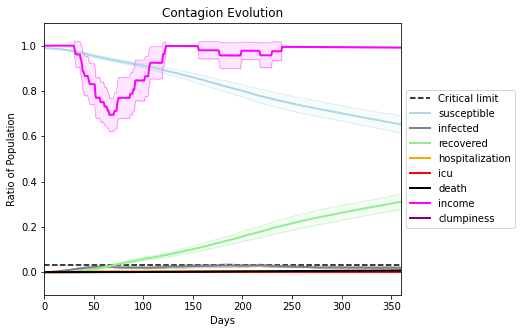

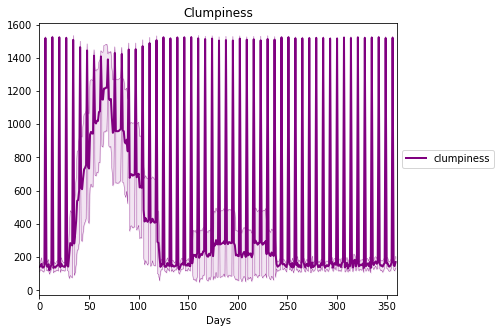

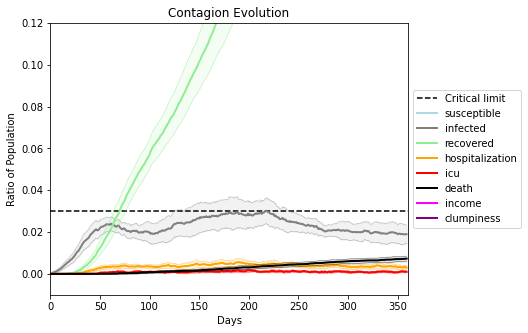

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3741, 2664, 9343, 3987, 7617, 8147, 3272, 616, 2997, 2372, 4098, 1797, 4290, 4185, 8254, 5952, 8983, 9246, 3479, 2335]
Average similarity between family members is 0.9120280661368441 at temperature -0.991
Average similarity between family and home is 0.9998539908026122 at temperature -1
Average similarity between students and their classroom is 0.8183331316369543 at temperature -0.991
Average classroom occupancy is 1.688622754491018 and number classrooms is 167
Average similarity between workers is 0.8543537619523844 at temperature -0.991
Average office occupancy is 3.430051813471503 and number offices is 193
Average friend similarity for adults: 0.8415327748364853 for kids: 0.718240975141354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5086504458915181
avg restaurant similarity 0.3426700254444517
avg restaurant similarity 0.4062286740805839
avg restaurant similarity 0.4255271374217293
avg restaurant similarity 0.9998668032632108
avg restaurant similarity 0.8050012546727455
avg restaurant similarity 0.9064368169484769
avg restaurant similarity 0.7191325568344706
avg restaurant similarity 0.47991029226768644
avg restaurant similarity 0.23842253786251746
avg restaurant similarity 0.5421680013861981
avg restaurant similarity 0.8130705100421902
avg restaurant similarity 0.41120855458983896
avg restaurant similarity 0.4228016570359219
avg restaurant similarity 0.5418044665507287
avg restaurant similarity 0.8315306788984714
avg restaurant similarity 0.8320136508588805
avg restaurant similarity 0.4533561597699499
avg restaurant similarity 0.3059318032469524
avg restaurant similarity 0.3446285302690706
avg restaurant similarity 0.6689330611524421
avg restaurant similarity 0.5929459803575148
avg res

avg restaurant similarity 0.42671884484860473
avg restaurant similarity 0.502620836578505
avg restaurant similarity 0.34408223202425064
avg restaurant similarity 0.41419769247778165
avg restaurant similarity 0.3980443681596546
avg restaurant similarity 0.264512884123113
avg restaurant similarity 0.4933027052228239
avg restaurant similarity 0.3051217930274734
avg restaurant similarity 0.7949578226373943
avg restaurant similarity 0.42671884484860473
avg restaurant similarity 0.5278386483200932
avg restaurant similarity 0.19399158698041183
avg restaurant similarity 0.4376529195854242
avg restaurant similarity 0.39145535634729683
avg restaurant similarity 0.4576024570371637
avg restaurant similarity 0.5142734877994465
avg restaurant similarity 0.502620836578505
avg restaurant similarity 0.8492680731379532
avg restaurant similarity 0.42406597448465666
avg restaurant similarity 0.38230739010151493
avg restaurant similarity 0.37390839203381665
avg restaurant similarity 0.25796531650675364
avg

avg restaurant similarity 0.4364196413007375
avg restaurant similarity 0.3831423373573379
avg restaurant similarity 0.40693500880728994
avg restaurant similarity 0.561393835804446
avg restaurant similarity 0.4089823121921692
avg restaurant similarity 0.42671884484860473
avg restaurant similarity 0.33703543961686666
avg restaurant similarity 0.4115008068051393
Average similarity between family members is 0.9239891636751318 at temperature -0.991
Average similarity between family and home is 0.9998466855617667 at temperature -1
Average similarity between students and their classroom is 0.8180747675896644 at temperature -0.991
Average classroom occupancy is 1.5609756097560976 and number classrooms is 164
Average similarity between workers is 0.8331284121830008 at temperature -0.991
Average office occupancy is 3.42 and number offices is 200
Average friend similarity for adults: 0.8402100102391633 for kids: 0.7001624291367637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.43740663982205286
avg restaurant similarity 0.406377400853008
avg restaurant similarity 0.6908109684392443
avg restaurant similarity 0.7865135216810646
avg restaurant similarity 0.5457659912808326
avg restaurant similarity 0.5238986468205006
avg restaurant similarity 0.6514094577512817
avg restaurant similarity 0.553156590214523
avg restaurant similarity 0.6485910616636796
avg restaurant similarity 0.440370937537398
avg restaurant similarity 0.4373077316459708
avg restaurant similarity 0.2593457710203454
avg restaurant similarity 0.6537794033424889
avg restaurant similarity 0.7272378688908083
avg restaurant similarity 0.4965067459634631
avg restaurant similarity 0.4373077316459708
avg restaurant similarity 0.6360279645216659
avg restaurant similarity 0.824474459133627
avg restaurant similarity 0.48643701136884493
avg restaurant similarity 0.5813999583519092
avg restaurant similarity 0.678738252201384
avg restaurant similarity 0.5285634145304817
avg restauran

Average friend similarity for adults: 0.8437435170291455 for kids: 0.7186539036485766
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.624687624520481
avg restaurant similarity 0.5353759980197893
avg restaurant similarity 0.5171967656873842
avg restaurant similarity 0.5891394583233173
avg restaurant similarity 0.6603419890142512
avg restaurant similarity 0.555136891837136
avg restaurant similarity 0.8079922728313246
avg restaurant similarity 0.6279309134750815
avg restaurant similarity 0.45246867397037066
avg restaurant similarity 0.519075288807018
avg restaurant similarity 0.5908630556670502
avg restaurant similarity 0.36846940065354605
avg restaurant similarity 0.5908630556670502
avg restaurant similarity 0.5181042634218496
avg restaurant similarity 0.7129975042157428
avg restaurant similarity 0.6812268276973839
avg restaurant similarity 0.5169949929060681
avg restaurant similarity 0.3399899198138084
avg restaurant similarity 0.295665298567654
avg restaurant similarity 0.5096694307496554
avg restaurant similarity 0.5169949929060681
avg restaurant similarity 0.7286853679083594
avg restaura

avg restaurant similarity 0.5008085048995233
avg restaurant similarity 0.4727231872307997
avg restaurant similarity 0.5651540968792038
avg restaurant similarity 0.8267453514268416
avg restaurant similarity 0.3619426623938314
avg restaurant similarity 0.5248033057714714
avg restaurant similarity 0.4117337339039892
avg restaurant similarity 0.49006305923763027
avg restaurant similarity 0.465908103639246
avg restaurant similarity 0.4294594874334662
avg restaurant similarity 0.2470329974499261
avg restaurant similarity 0.7588257109435227
avg restaurant similarity 0.3462762616711714
avg restaurant similarity 0.9996975229003606
avg restaurant similarity 0.524850806747566
avg restaurant similarity 0.47071673212881765
avg restaurant similarity 0.545249130889933
avg restaurant similarity 0.2961234700068604
avg restaurant similarity 0.49123172149180405
avg restaurant similarity 0.40857500989628986
avg restaurant similarity 0.5320510027436283
avg restaurant similarity 0.8228770590158969
avg resta

avg restaurant similarity 0.46913687955174344
avg restaurant similarity 0.7141635389844512
avg restaurant similarity 0.7215424120286457
avg restaurant similarity 0.4193018636697535
avg restaurant similarity 0.4521060111470366
avg restaurant similarity 0.8632308422915362
avg restaurant similarity 0.5088996946722344
avg restaurant similarity 0.686015340173628
avg restaurant similarity 0.38048190845898217
avg restaurant similarity 0.42405571572595885
avg restaurant similarity 0.660259429920528
avg restaurant similarity 0.5892472340128649
avg restaurant similarity 0.4042723727487062
avg restaurant similarity 0.5137032487861344
avg restaurant similarity 0.4687682260979756
avg restaurant similarity 0.4104300481848222
avg restaurant similarity 0.3930779700305906
avg restaurant similarity 0.4867180530273859
avg restaurant similarity 0.519816257083765
avg restaurant similarity 0.459704911754023
avg restaurant similarity 0.5463039063151625
avg restaurant similarity 0.6131543880120747
avg restaur

avg restaurant similarity 0.5415388799364429
avg restaurant similarity 0.8301711280433113
avg restaurant similarity 0.20017173144212447
avg restaurant similarity 0.5630805050637177
avg restaurant similarity 0.24341219906380046
avg restaurant similarity 0.47456984711262673
avg restaurant similarity 0.5164770105215534
avg restaurant similarity 0.8271111766217616
avg restaurant similarity 0.9994768558821654
avg restaurant similarity 0.5067301161773967
avg restaurant similarity 0.728010375298453
avg restaurant similarity 0.6264503044311452
avg restaurant similarity 0.44881718111774327
avg restaurant similarity 0.7288544384504293
avg restaurant similarity 0.37166497892198347
avg restaurant similarity 0.45312986783941783
avg restaurant similarity 0.5355684718460445
avg restaurant similarity 0.6683101935387485
Average similarity between family members is 0.9193890301450552 at temperature -0.991
Average similarity between family and home is 0.999855511070138 at temperature -1
Average similarit

avg restaurant similarity 0.6030383983274794
avg restaurant similarity 0.4753951555706125
avg restaurant similarity 0.7038675483018209
avg restaurant similarity 0.4372921398680367
avg restaurant similarity 0.4997084724243326
avg restaurant similarity 0.6116307617306407
avg restaurant similarity 0.7254158404328496
avg restaurant similarity 0.6187993360863171
avg restaurant similarity 0.654446481666717
avg restaurant similarity 0.9996823218173115
avg restaurant similarity 0.8960792589081967
avg restaurant similarity 0.45620359064657506
avg restaurant similarity 0.786621656036848
avg restaurant similarity 0.9998498716399209
avg restaurant similarity 0.44224845362352244
avg restaurant similarity 0.48027764542122287
avg restaurant similarity 0.7508623837851138
avg restaurant similarity 0.5626237126490179
avg restaurant similarity 0.5631148939679169
avg restaurant similarity 0.37238150481727894
avg restaurant similarity 0.4353446180418744
avg restaurant similarity 0.47594520795000955
avg res

avg restaurant similarity 0.6755984255609431
avg restaurant similarity 0.47230347056009836
avg restaurant similarity 0.2070952179757355
avg restaurant similarity 0.4142037217973844
avg restaurant similarity 0.6953060650327607
avg restaurant similarity 0.39582521777673907
avg restaurant similarity 0.4518940267981837
avg restaurant similarity 0.35647325556546283
avg restaurant similarity 0.44774595515641685
avg restaurant similarity 0.8808107976389379
avg restaurant similarity 0.7766199935855906
avg restaurant similarity 0.5072665403319413
avg restaurant similarity 0.5867001683928925
avg restaurant similarity 0.22324722735413363
avg restaurant similarity 0.47866363222622094
avg restaurant similarity 0.7499451177279637
avg restaurant similarity 0.27621829713846846
avg restaurant similarity 0.9998498716399209
avg restaurant similarity 0.5920461392302739
avg restaurant similarity 0.7317576344963036
avg restaurant similarity 0.8016102628000027
avg restaurant similarity 0.8950589865127986
avg

avg restaurant similarity 0.7141683024801617
avg restaurant similarity 0.5658597161924347
avg restaurant similarity 0.3388051070628033
avg restaurant similarity 0.4484816696082438
avg restaurant similarity 0.5161166935346893
avg restaurant similarity 0.5205714176616274
avg restaurant similarity 0.4864776689873834
avg restaurant similarity 0.451934470085466
avg restaurant similarity 0.37190669005758864
avg restaurant similarity 0.7341551701241753
avg restaurant similarity 0.47958960230257874
avg restaurant similarity 0.9996440402824892
avg restaurant similarity 0.5638659720910201
avg restaurant similarity 0.28863217144532693
avg restaurant similarity 0.7373867245036535
avg restaurant similarity 0.3312725142637106
avg restaurant similarity 0.4459128103060463
avg restaurant similarity 0.43066598294308034
avg restaurant similarity 0.4966959712773646
avg restaurant similarity 0.9997629569574292
avg restaurant similarity 0.7314760811822976
avg restaurant similarity 0.44971432358332963
avg re

avg restaurant similarity 0.4281834699358548
avg restaurant similarity 0.4756820837880271
avg restaurant similarity 0.4832141737775997
avg restaurant similarity 0.6891125817438891
avg restaurant similarity 0.4929417853736484
avg restaurant similarity 0.5045264401392716
avg restaurant similarity 0.6682959876825993
avg restaurant similarity 0.2849514009440593
avg restaurant similarity 0.6014317997024694
avg restaurant similarity 0.8636294972336094
avg restaurant similarity 0.7032774371654299
avg restaurant similarity 0.5146080229590176
avg restaurant similarity 0.4838430887909858
avg restaurant similarity 0.32588931614520567
avg restaurant similarity 0.8004157381920965
avg restaurant similarity 0.45683630778494516
avg restaurant similarity 0.3383495245950091
avg restaurant similarity 0.4273746606642792
avg restaurant similarity 0.37324510387176435
Average similarity between family members is 0.9091514755780725 at temperature -0.991
Average similarity between family and home is 0.99985849

avg restaurant similarity 0.8804209597394566
avg restaurant similarity 0.518625287276267
avg restaurant similarity 0.11812167660347683
avg restaurant similarity 0.6793865546008723
avg restaurant similarity 0.6913517479740799
avg restaurant similarity 0.6046378152510787
avg restaurant similarity 0.479218608008364
avg restaurant similarity 0.4209784184732749
avg restaurant similarity 0.7944582113654067
avg restaurant similarity 0.7304305717600184
avg restaurant similarity 0.6248043862547498
avg restaurant similarity 0.4662753008019383
avg restaurant similarity 0.3926525857419968
avg restaurant similarity 0.43422711430144206
avg restaurant similarity 0.6575199701596199
avg restaurant similarity 0.4597418184583041
avg restaurant similarity 0.48158266041993825
avg restaurant similarity 0.5303586305405394
avg restaurant similarity 0.7806432308715666
avg restaurant similarity 0.7206569833618562
avg restaurant similarity 0.5902250623755212
avg restaurant similarity 0.8460387376132383
avg resta

avg restaurant similarity 0.4171408771740627
avg restaurant similarity 0.5058476554824514
avg restaurant similarity 0.4723780188448419
avg restaurant similarity 0.4943237379528399
avg restaurant similarity 0.33930821444711373
avg restaurant similarity 0.5551536803398308
avg restaurant similarity 0.297680147845371
avg restaurant similarity 0.8244257242554198
avg restaurant similarity 0.3896253431866355
avg restaurant similarity 0.4544930474735256
Average similarity between family members is 0.9211686945126448 at temperature -0.991
Average similarity between family and home is 0.9998521285905962 at temperature -1
Average similarity between students and their classroom is 0.8193539151180301 at temperature -0.991
Average classroom occupancy is 1.608187134502924 and number classrooms is 171
Average similarity between workers is 0.8381394104953248 at temperature -0.991
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.847390763727

avg restaurant similarity 0.5820031397932826
avg restaurant similarity 0.7437491775902054
avg restaurant similarity 0.6222113437830421
avg restaurant similarity 0.38802187222584117
avg restaurant similarity 0.4280792752140026
avg restaurant similarity 0.17390579340779297
avg restaurant similarity 0.5549929814672031
avg restaurant similarity 0.8280303294359646
avg restaurant similarity 0.36419206519358965
avg restaurant similarity 0.5875807153104465
avg restaurant similarity 0.3292930658413691
avg restaurant similarity 0.09993800377325472
avg restaurant similarity 0.3868210284449387
avg restaurant similarity 0.2742032049290935
avg restaurant similarity 0.5015192894856839
avg restaurant similarity 0.8793705092910054
avg restaurant similarity 0.5131895252047046
avg restaurant similarity 0.3940640096829622
avg restaurant similarity 0.24902124976105233
avg restaurant similarity 0.46634533728441996
avg restaurant similarity 0.938078508122116
avg restaurant similarity 0.6188002378298216
avg r

Average similarity between workers is 0.834130026402748 at temperature -0.991
Average office occupancy is 3.252577319587629 and number offices is 194
Average friend similarity for adults: 0.8332006718462157 for kids: 0.7216619598456685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6235115508022442
avg restaurant similarity 0.6350534373223211
avg restaurant similarity 0.6356330283453766
avg restaurant similarity 0.05280923918280786
avg restaurant similarity 0.49317014963636624
avg restaurant similarity 0.4836789732480662
avg restaurant similarity 0.458454992785727
avg restaurant similarity 0.053870560993841854
avg restaurant similarity 0.8515349451523058
avg restaurant similarity 0.9998166045317471
avg restaurant similarity 0.8777666344871131
avg restaurant similarity 0.35823752019370425
avg restaurant similarity 0.7633899175911081
avg restaurant similarity 0.3467507273916658
avg restaurant similarity 0.6183451594482532
avg restaurant similarity 0.6751106211117668
avg restaurant similarity 0.35819342589770237
avg restaurant similarity 0.28240540895139077
avg restaurant similarity 0.4453910832046972
avg restaurant similarity 0.27806415205944596
avg restaurant similarity 0.9996418135014039
avg restaurant similarity 0.5331278260976192
avg

avg restaurant similarity 0.9998435606648508
avg restaurant similarity 0.8719277862345116
avg restaurant similarity 0.5705148849465353
avg restaurant similarity 0.27806415205944596
avg restaurant similarity 0.9996683441180354
avg restaurant similarity 0.39724606836815185
avg restaurant similarity 0.48532624675343483
avg restaurant similarity 0.8744896752844213
avg restaurant similarity 0.5109005984124964
avg restaurant similarity 0.053870560993841854
Average similarity between family members is 0.9029520180885771 at temperature -0.991
Average similarity between family and home is 0.9998568314591271 at temperature -1
Average similarity between students and their classroom is 0.8035773237603893 at temperature -0.991
Average classroom occupancy is 1.7426900584795322 and number classrooms is 171
Average similarity between workers is 0.8285889475870589 at temperature -0.991
Average office occupancy is 3.3282051282051284 and number offices is 195
Average friend similarity for adults: 0.82537

avg restaurant similarity 0.2874648464419919
avg restaurant similarity 0.5741631291936428
avg restaurant similarity 0.4663658230214118
avg restaurant similarity 0.8197929867804463
avg restaurant similarity 0.4178058029679317
avg restaurant similarity 0.4763290275668951
avg restaurant similarity 0.5392916015226691
avg restaurant similarity 0.8708459141337523
avg restaurant similarity 0.710005204151301
avg restaurant similarity 0.6382111391535745
avg restaurant similarity 0.7461047378566497
avg restaurant similarity 0.874093667754912
avg restaurant similarity 0.5292279602418606
avg restaurant similarity 0.9995117447596025
avg restaurant similarity 0.45444675623947156
avg restaurant similarity 0.8293862370897862
avg restaurant similarity 0.35540676175157315
avg restaurant similarity 0.5001469918023306
avg restaurant similarity 0.4914927640981114
avg restaurant similarity 0.7992281385614319
avg restaurant similarity 0.8708459141337523
avg restaurant similarity 0.3654854592287843
avg restau

avg restaurant similarity 0.7626399669231423
avg restaurant similarity 0.550642062591837
avg restaurant similarity 0.46537300003722426
avg restaurant similarity 0.8837587532431352
Average similarity between family members is 0.912135303593049 at temperature -0.991
Average similarity between family and home is 0.999849517073537 at temperature -1
Average similarity between students and their classroom is 0.807033339999285 at temperature -0.991
Average classroom occupancy is 1.7428571428571429 and number classrooms is 175
Average similarity between workers is 0.8476764136478775 at temperature -0.991
Average office occupancy is 3.304123711340206 and number offices is 194
Average friend similarity for adults: 0.8345225209246079 for kids: 0.7306777153769365
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.4955014586038316
avg restaurant similarity 0.7238183384868195
avg restaurant similarity 0.6321679637333757
avg restaurant similarity 0.38148550544213466
avg restaurant similarity 0.46972836640703725
avg restaurant similarity 0.4247973748328405
avg restaurant similarity 0.42458846084246793
avg restaurant similarity 0.5691393036107472
avg restaurant similarity 0.22615809768280817
avg restaurant similarity 0.3950576704131358
avg restaurant similarity 0.7424692428738119
avg restaurant similarity 0.5003559923942227
avg restaurant similarity 0.8889506122940469
avg restaurant similarity 0.5533235420131284
avg restaurant similarity 0.4584560710289219
avg restaurant similarity 0.5482331598190847
avg restaurant similarity 0.38738234788486847
avg restaurant similarity 0.2803118284478852
avg restaurant similarity 0.5709676546864012
avg restaurant similarity 0.4975427762905023
avg restaurant similarity 0.8187060997942897
avg restaurant similarity 0.5134501414165389
avg r

Average similarity between family and home is 0.9998508612551091 at temperature -1
Average similarity between students and their classroom is 0.8003030959926782 at temperature -0.991
Average classroom occupancy is 1.654970760233918 and number classrooms is 171
Average similarity between workers is 0.8431265513446714 at temperature -0.991
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.8321266878667388 for kids: 0.7211730996705793
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.5183740100964361
avg restaurant similarity 0.35308522940288445
avg restaurant similarity 0.6252685779968027
avg restaurant similarity 0.48251694871078127
avg restaurant similarity 0.5052280274203513
avg restaurant similarity 0.3378788593396401
avg restaurant similarity 0.9144325411992366
avg restaurant similarity 0.043081220140520265
avg restaurant similarity 0.3051631210424623
avg restaurant similarity 0.5680995132343467
avg restaurant similarity 0.5110071624364129
avg restaurant similarity 0.6920317247054505
avg restaurant similarity 0.4923047588581268
avg restaurant similarity 0.6136983401969548
avg restaurant similarity 0.4772962213286459
avg restaurant similarity 0.9996815827047786
avg restaurant similarity 0.2911550712663421
avg restaurant similarity 0.44537623211582716
avg restaurant similarity 0.5576439730740965
avg restaurant similarity 0.3372976877131576
avg restaurant similarity 0.38829838946465833
avg restaurant similarity 0.5674765475449244
avg 

Average similarity between workers is 0.8527145873641605 at temperature -0.991
Average office occupancy is 3.36734693877551 and number offices is 196
Average friend similarity for adults: 0.8408651028297894 for kids: 0.7338335274062557
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 peo

avg restaurant similarity 0.4155839503160804
avg restaurant similarity 0.8368157422973811
avg restaurant similarity 0.4134195159188887
avg restaurant similarity 0.9093893239744459
avg restaurant similarity 0.5854971747107881
avg restaurant similarity 0.4796608169033094
avg restaurant similarity 0.4581534518095821
avg restaurant similarity 0.41277643120393664
avg restaurant similarity 0.4217698948269438
avg restaurant similarity 0.5152571857415603
avg restaurant similarity 0.6903296753407467
avg restaurant similarity 0.9199912813848419
avg restaurant similarity 0.3463532753487244
avg restaurant similarity 0.5465057882885768
avg restaurant similarity 0.4919707879375981
avg restaurant similarity 0.5949695719600594
avg restaurant similarity 0.5032042627661013
avg restaurant similarity 0.6745262636094888
avg restaurant similarity 0.8422372326696886
avg restaurant similarity 0.8316900203182269
avg restaurant similarity 0.44540000408755137
avg restaurant similarity 0.5089702621727447
avg rest

avg restaurant similarity 0.4807457500840118
avg restaurant similarity 0.6475606728971449
avg restaurant similarity 0.3606359470250446
avg restaurant similarity 0.38619290872091017
avg restaurant similarity 0.6957075428481938
avg restaurant similarity 0.35259266172046255
avg restaurant similarity 0.6594001688469242
avg restaurant similarity 0.7724829534195014
avg restaurant similarity 0.6032597976419979
avg restaurant similarity 0.3974054593253906
avg restaurant similarity 0.16728597867411948
avg restaurant similarity 0.2829193550508827
avg restaurant similarity 0.34622265052663326
avg restaurant similarity 0.3940613677039796
avg restaurant similarity 0.368159888890211
avg restaurant similarity 0.5423717971184143
avg restaurant similarity 0.6885762726290814
avg restaurant similarity 0.8160021512291549
avg restaurant similarity 0.368159888890211
avg restaurant similarity 0.46404870374940177
avg restaurant similarity 0.39165164739682257
avg restaurant similarity 0.46132059068654063
avg r

avg restaurant similarity 0.447486011820875
avg restaurant similarity 0.5008069378378471
avg restaurant similarity 0.3301260602204864
avg restaurant similarity 0.46945339000469116
avg restaurant similarity 0.3031534954619594
avg restaurant similarity 0.6182150438042837
Average similarity between family members is 0.9200672155547825 at temperature -0.991
Average similarity between family and home is 0.9998627845958834 at temperature -1
Average similarity between students and their classroom is 0.8186953096727763 at temperature -0.991
Average classroom occupancy is 1.6740331491712708 and number classrooms is 181
Average similarity between workers is 0.8496839990466073 at temperature -0.991
Average office occupancy is 3.326424870466321 and number offices is 193
Average friend similarity for adults: 0.8415757250091422 for kids: 0.7268530613315481
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a t

avg restaurant similarity 0.6308156202710915
avg restaurant similarity 0.6412645098327452
avg restaurant similarity 0.6858988178205409
avg restaurant similarity 0.5881240182674852
avg restaurant similarity 0.6309860981958952
avg restaurant similarity 0.5309125321523426
avg restaurant similarity 0.3733001642028624
avg restaurant similarity 0.585094161207028
avg restaurant similarity 0.24717282781928243
avg restaurant similarity 0.5654563808297856
avg restaurant similarity 0.5382587569707024
avg restaurant similarity 0.5100786244563487
avg restaurant similarity 0.3305708686517732
avg restaurant similarity 0.5065638706329347
avg restaurant similarity 0.632403846048876
avg restaurant similarity 0.45165777316226985
avg restaurant similarity 0.4743754583809079
avg restaurant similarity 0.4766138858265809
avg restaurant similarity 0.5742785113568897
avg restaurant similarity 0.5069441572002077
avg restaurant similarity 0.25168772492680036
avg restaurant similarity 0.8143999747699194
avg resta

avg restaurant similarity 0.5382587569707024
avg restaurant similarity 0.3228001156124281
avg restaurant similarity 0.7778635521019661
avg restaurant similarity 0.5353602247722308
avg restaurant similarity 0.581024860054129
avg restaurant similarity 0.4114801345283787
avg restaurant similarity 0.47020697496843944
avg restaurant similarity 0.7495560309721447
Average similarity between family members is 0.9124713053509718 at temperature -0.991
Average similarity between family and home is 0.9998506757085242 at temperature -1
Average similarity between students and their classroom is 0.784043829241996 at temperature -0.991
Average classroom occupancy is 1.6555555555555554 and number classrooms is 180
Average similarity between workers is 0.8416305696071642 at temperature -0.991
Average office occupancy is 3.383419689119171 and number offices is 193
Average friend similarity for adults: 0.8346484105571133 for kids: 0.7234440409801174
home_districts
[
Home (0,0) district with 1 Buildings
Ho

avg restaurant similarity 0.5880970028130815
avg restaurant similarity 0.6285068032535673
avg restaurant similarity 0.4599837014128557
avg restaurant similarity 0.31605727065119743
avg restaurant similarity 0.43738646158935546
avg restaurant similarity 0.5558249936014953
avg restaurant similarity 0.7414743309552552
avg restaurant similarity 0.5820863667253333
avg restaurant similarity 0.5754523100994542
avg restaurant similarity 0.5022999210574757
avg restaurant similarity 0.4777670737794501
avg restaurant similarity 0.1718414219274101
avg restaurant similarity 0.4556583725653772
avg restaurant similarity 0.7066921249785729
avg restaurant similarity 0.2543857280025613
avg restaurant similarity 0.5430275264112177
avg restaurant similarity 0.5385915601759351
avg restaurant similarity 0.47961134486351564
avg restaurant similarity 0.7717818883048625
avg restaurant similarity 0.7293163975531618
avg restaurant similarity 0.5430275264112177
avg restaurant similarity 0.5739349007288237
avg res

avg restaurant similarity 0.37878627020500505
avg restaurant similarity 0.8474805408746806
avg restaurant similarity 0.45338851107231576
avg restaurant similarity 0.4661326053738418
avg restaurant similarity 0.552417888555296
avg restaurant similarity 0.48130624324196203
avg restaurant similarity 0.44774495756278065
avg restaurant similarity 0.8456817015424831
avg restaurant similarity 0.4269486735950817
avg restaurant similarity 0.6333647265032502
avg restaurant similarity 0.5270074372140688
avg restaurant similarity 0.45692923174907035
avg restaurant similarity 0.25693648641768846
avg restaurant similarity 0.7522512128210116
avg restaurant similarity 0.30224769800701357
avg restaurant similarity 0.46579264261624864
avg restaurant similarity 0.5444997062390475
avg restaurant similarity 0.49183437732346136
avg restaurant similarity 0.34703741507823527
avg restaurant similarity 0.4033405531485313
avg restaurant similarity 0.45521362731611703
avg restaurant similarity 0.5146674972048703


avg restaurant similarity 0.8762234469488094
avg restaurant similarity 0.4073255819366366
avg restaurant similarity 0.5912425588996345
avg restaurant similarity 0.4326634682063115
avg restaurant similarity 0.39361488037886494
avg restaurant similarity 0.7139407477029309
avg restaurant similarity 0.5679321052231228
avg restaurant similarity 0.5632738372959152
avg restaurant similarity 0.3535772391410883
avg restaurant similarity 0.5048083542876783
avg restaurant similarity 0.45484407179982067
avg restaurant similarity 0.7079033619838404
avg restaurant similarity 0.8113651253349735
avg restaurant similarity 0.33572875401239466
avg restaurant similarity 0.5388123521071363
avg restaurant similarity 0.43744726375665066
avg restaurant similarity 0.836177700767285
avg restaurant similarity 0.03749153196833973
avg restaurant similarity 0.3452332043186115
avg restaurant similarity 0.44453888209729564
avg restaurant similarity 0.8187917370419118
avg restaurant similarity 0.5489950993318415
avg r

avg restaurant similarity 0.5610697699908109
avg restaurant similarity 0.3377766637560735
avg restaurant similarity 0.4194638611284287
avg restaurant similarity 0.4591088603686837
avg restaurant similarity 0.5414063561694102
avg restaurant similarity 0.5927190151143492
avg restaurant similarity 0.4700479709325137
avg restaurant similarity 0.40967312723344596
avg restaurant similarity 0.18394897018879908
avg restaurant similarity 0.459085619416217
avg restaurant similarity 0.9997676839772998
avg restaurant similarity 0.4099264969028288
avg restaurant similarity 0.8102041219180849
avg restaurant similarity 0.45880255004861004
avg restaurant similarity 0.36927959541370386
avg restaurant similarity 0.37453566684783646
avg restaurant similarity 0.36762308614801603
avg restaurant similarity 0.37943405055045126
avg restaurant similarity 0.6014952261326227
avg restaurant similarity 0.8228358137025293
avg restaurant similarity 0.37453566684783646
avg restaurant similarity 0.4131301421486243
avg

0.007936507936507936
std:
0.0014931950141730493
mean:
0.00454443673893745
median:
0.004
95% confidence interval for the mean:
(0.003827445332835237,0.005261428145039663)
using peak of time series:
stats on death:
data: [0.01, 0.007, 0.01, 0.005, 0.00398406374501992, 0.011, 0.005964214711729622, 0.008, 0.007, 0.006, 0.005, 0.01, 0.004985044865403789, 0.003, 0.009, 0.00992063492063492, 0.006, 0.003, 0.006, 0.001]
min:
0.001
max:
0.011
std:
0.002705928448574135
mean:
0.006592697912139412
median:
0.006
95% confidence interval for the mean:
(0.005293385079763249,0.007892010744515576)
using peak of time series:
stats on income:
data: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
min:
1.0
max:
1.0
std:
0.0
mean:
1.0
median:
1.0
95% confidence interval for the mean:
(1.0,1.0)
using peak of time series:
stats on clumpiness:
data: [1530.0, 1533.0, 1539.0, 1531.0, 1539.0, 1530.0, 1548.0, 1532.0, 1543.0, 1538.0, 1524.0, 1523.0, 1523.0, 1528.0,

(<function dict.items>, <function dict.items>, <function dict.items>)

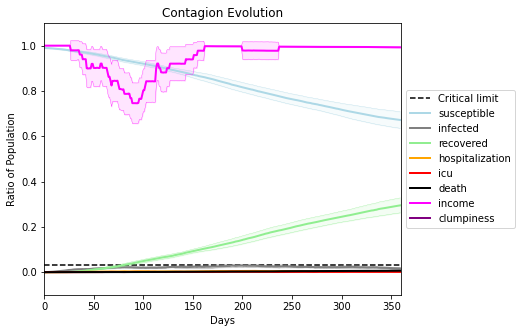

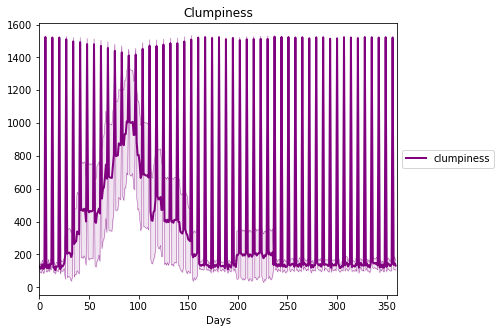

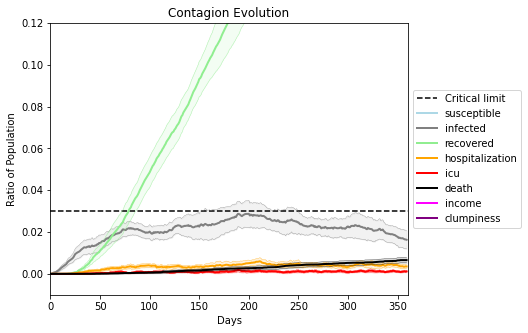

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1830, 4257, 5442, 52, 9686, 6139, 8089, 2003, 3849, 8151, 8145, 8124, 3673, 5145, 8874, 6321, 1307, 9751, 7449, 1712]
Average similarity between family members is 0.9088532413945193 at temperature -0.99
Average similarity between family and home is 0.9998581852681746 at temperature -1
Average similarity between students and their classroom is 0.7821879868243352 at temperature -0.99
Average classroom occupancy is 1.6818181818181819 and number classrooms is 176
Average similarity between workers is 0.8193664470020842 at temperature -0.99
Average office occupancy is 3.238578680203046 and number offices is 197
Average friend similarity for adults: 0.8303119217905413 for kids: 0.7119502199168295
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.40095213814534536
avg restaurant similarity 0.8041644261733549
avg restaurant similarity 0.4246592528907242
avg restaurant similarity 0.6479535346958815
avg restaurant similarity 0.46166683024358507
avg restaurant similarity 0.7102378055462149
avg restaurant similarity 0.5829921302841861
avg restaurant similarity 0.6401533521213894
avg restaurant similarity 0.5855415548749077
avg restaurant similarity 0.35097037946048926
avg restaurant similarity 0.2594685055224587
avg restaurant similarity 0.3918289535601048
avg restaurant similarity 0.4257608446630675
avg restaurant similarity 0.6452140567528093
avg restaurant similarity 0.7525686533468803
avg restaurant similarity 0.4198492122817249
avg restaurant similarity 0.53312135540386
avg restaurant similarity 0.6505519803406767
avg restaurant similarity 0.6899868285256184
avg restaurant similarity 0.6475404919606285
avg restaurant similarity 0.5829921302841861
avg restaurant similarity 0.48641805629721646
avg rest

avg restaurant similarity 0.24178217392038467
avg restaurant similarity 0.38260640948421465
avg restaurant similarity 0.38755147904843423
avg restaurant similarity 0.3631115218631315
avg restaurant similarity 0.9997945133678594
avg restaurant similarity 0.7752999801121062
avg restaurant similarity 0.4124770989169792
avg restaurant similarity 0.6075220829499455
avg restaurant similarity 0.4985219075885088
avg restaurant similarity 0.3813808025311992
avg restaurant similarity 0.6028585180559124
avg restaurant similarity 0.4032228362578756
avg restaurant similarity 0.4018867290341237
avg restaurant similarity 0.5557477252556531
avg restaurant similarity 0.7143167283699018
avg restaurant similarity 0.4073709678955325
avg restaurant similarity 0.5736507843742396
avg restaurant similarity 0.3878284725443256
avg restaurant similarity 0.4782611468268586
avg restaurant similarity 0.6627525767600433
avg restaurant similarity 0.6627525767600433
avg restaurant similarity 0.5535962579415145
avg res

avg restaurant similarity 0.9998077271569421
avg restaurant similarity 0.7025063189120038
avg restaurant similarity 0.3807275032767503
avg restaurant similarity 0.5093588847935674
avg restaurant similarity 0.4702637417719147
avg restaurant similarity 0.47546678676489884
avg restaurant similarity 0.46969260145415587
avg restaurant similarity 0.5106848936689398
avg restaurant similarity 0.4595745874838965
avg restaurant similarity 0.6025247197507104
avg restaurant similarity 0.5524885369415287
avg restaurant similarity 0.4163106194260679
avg restaurant similarity 0.7025211214692411
avg restaurant similarity 0.5159815076656445
avg restaurant similarity 0.2971382016221368
avg restaurant similarity 0.7886321766255278
avg restaurant similarity 0.5229136741453219
avg restaurant similarity 0.2217148629349298
avg restaurant similarity 0.4439432011150291
avg restaurant similarity 0.597526296326581
avg restaurant similarity 0.5882791262609607
avg restaurant similarity 0.3685980953179333
avg resta

avg restaurant similarity 0.6211809692261623
avg restaurant similarity 0.5813560326245708
avg restaurant similarity 0.46849252602579294
avg restaurant similarity 0.4161733810870212
avg restaurant similarity 0.5372259615671223
avg restaurant similarity 0.8137520678716614
avg restaurant similarity 0.4671443706016265
avg restaurant similarity 0.5484753908867056
avg restaurant similarity 0.4021096151300233
Average similarity between family members is 0.8984035906639933 at temperature -0.99
Average similarity between family and home is 0.9998478220914394 at temperature -1
Average similarity between students and their classroom is 0.7796610138795008 at temperature -0.99
Average classroom occupancy is 1.6547619047619047 and number classrooms is 168
Average similarity between workers is 0.8253488687849764 at temperature -0.99
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.8324736868358146 for kids: 0.7171975769564134
home_distri

avg restaurant similarity 0.5193486967669227
avg restaurant similarity 0.7983798939268117
avg restaurant similarity 0.5911085361902602
avg restaurant similarity 0.5677714381358294
avg restaurant similarity 0.4415830292559537
avg restaurant similarity 0.5437728511751487
avg restaurant similarity 0.6343809036420587
avg restaurant similarity 0.7163243480407383
avg restaurant similarity 0.09989622493376044
avg restaurant similarity 0.2041917427656333
avg restaurant similarity 0.46045719249629685
avg restaurant similarity 0.8834003685592959
avg restaurant similarity 0.16017375875146345
avg restaurant similarity 0.8831442965263345
avg restaurant similarity 0.9046051638454997
avg restaurant similarity 0.7277415741951715
avg restaurant similarity 0.3918046561063111
avg restaurant similarity 0.3474609575195318
avg restaurant similarity 0.5320023800195857
avg restaurant similarity 0.5775406924532094
avg restaurant similarity 0.584759184539847
avg restaurant similarity 0.3556971124471125
avg rest

avg restaurant similarity 0.653301225722987
avg restaurant similarity 0.40816352878679535
avg restaurant similarity 0.6862288524536861
avg restaurant similarity 0.3410998572812384
avg restaurant similarity 0.8595413706327661
avg restaurant similarity 0.47968992709813485
avg restaurant similarity 0.48276591188372453
avg restaurant similarity 0.47968992709813485
avg restaurant similarity 0.6996254528267594
avg restaurant similarity 0.7744114116849968
avg restaurant similarity 0.35967869856810786
avg restaurant similarity 0.841557964737659
avg restaurant similarity 0.6862288524536861
avg restaurant similarity 0.37219293073432713
avg restaurant similarity 0.33349712703679213
avg restaurant similarity 0.4674529844246293
avg restaurant similarity 0.8460808903134435
avg restaurant similarity 0.5557988797919133
avg restaurant similarity 0.42720725212385435
avg restaurant similarity 0.8349734667241402
avg restaurant similarity 0.25264892875164113
avg restaurant similarity 0.5484451218529476
avg

avg restaurant similarity 0.41064929515150117
avg restaurant similarity 0.7271801837488949
avg restaurant similarity 0.5748506163229671
avg restaurant similarity 0.5877419532981444
avg restaurant similarity 0.9998397014110527
avg restaurant similarity 0.7761901913462553
avg restaurant similarity 0.7783863316678741
avg restaurant similarity 0.4182985917483445
avg restaurant similarity 0.6565658442148403
avg restaurant similarity 0.4554907014326578
avg restaurant similarity 0.3804981428411952
avg restaurant similarity 0.619391168282931
avg restaurant similarity 0.4149052499471466
avg restaurant similarity 0.497178455081843
avg restaurant similarity 0.497178455081843
avg restaurant similarity 0.27727269111171715
avg restaurant similarity 0.2952674139292904
avg restaurant similarity 0.3572678419014119
avg restaurant similarity 0.32224239424844264
avg restaurant similarity 0.346638993033916
avg restaurant similarity 0.47182245319812066
avg restaurant similarity 0.42712469079865256
avg resta

avg restaurant similarity 0.312996677153971
avg restaurant similarity 0.3053926541819716
Average similarity between family members is 0.9017425259620722 at temperature -0.99
Average similarity between family and home is 0.9998483814093265 at temperature -1
Average similarity between students and their classroom is 0.785605742169294 at temperature -0.99
Average classroom occupancy is 1.6441717791411044 and number classrooms is 163
Average similarity between workers is 0.8266367609856049 at temperature -0.99
Average office occupancy is 3.471794871794872 and number offices is 195
Average friend similarity for adults: 0.8377081150964353 for kids: 0.7089704576096947
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.6787182187988795
avg restaurant similarity 0.7229405680365601
avg restaurant similarity 0.5555468488714744
avg restaurant similarity 0.9993232544211345
avg restaurant similarity 0.6787182187988795
avg restaurant similarity 0.44263252280801985
avg restaurant similarity 0.6531904045945574
avg restaurant similarity 0.5420840268368826
avg restaurant similarity 0.47509972122244415
avg restaurant similarity 0.4604133809501052
avg restaurant similarity 0.49549869522047607
avg restaurant similarity 0.3277029090069862
avg restaurant similarity 0.4604924931944807
avg restaurant similarity 0.3277029090069862
avg restaurant similarity 0.4740516055960142
avg restaurant similarity 0.1356804624459302
avg restaurant similarity 0.47129650347200536
avg restaurant similarity 0.5558097039753129
avg restaurant similarity 0.672412896131861
avg restaurant similarity 0.5004496650309604
avg restaurant similarity 0.6469560466662962
avg restaurant similarity 0.4980743355931722
avg res

avg restaurant similarity 0.38555336365728027
avg restaurant similarity 0.6890083790552297
avg restaurant similarity 0.5213632056420199
avg restaurant similarity 0.43655307612019856
avg restaurant similarity 0.47729109762046784
avg restaurant similarity 0.2795936841856853
avg restaurant similarity 0.5707629652212629
avg restaurant similarity 0.1916319104884961
avg restaurant similarity 0.41178562536349994
avg restaurant similarity 0.45612890037890397
avg restaurant similarity 0.4967960824321403
avg restaurant similarity 0.9997942352445115
avg restaurant similarity 0.1916319104884961
avg restaurant similarity 0.40584303084625223
avg restaurant similarity 0.4513802922293802
avg restaurant similarity 0.36265991567313105
avg restaurant similarity 0.6137045799343515
avg restaurant similarity 0.3821201425812071
avg restaurant similarity 0.7024342803297677
avg restaurant similarity 0.519457119817576
avg restaurant similarity 0.43655307612019856
avg restaurant similarity 0.856691571516297
avg 

avg restaurant similarity 0.8142426867929831
avg restaurant similarity 0.38992362021451377
avg restaurant similarity 0.42461907947011424
avg restaurant similarity 0.33244232526847756
avg restaurant similarity 0.9997688315791873
avg restaurant similarity 0.6725052333648484
avg restaurant similarity 0.4723703023273904
avg restaurant similarity 0.28148807620457666
avg restaurant similarity 0.397008363516891
avg restaurant similarity 0.36532982887472093
avg restaurant similarity 0.5133084549878029
avg restaurant similarity 0.43655307612019856
avg restaurant similarity 0.8149040551111328
avg restaurant similarity 0.4144323506622666
avg restaurant similarity 0.540521306652415
avg restaurant similarity 0.8315649098586007
avg restaurant similarity 0.47037322364674
avg restaurant similarity 0.39353161979594065
avg restaurant similarity 0.7836698691571246
avg restaurant similarity 0.35650539386454283
avg restaurant similarity 0.5002393258501927
avg restaurant similarity 0.6513350736066102
avg re

avg restaurant similarity 0.45515792002035366
avg restaurant similarity 0.47709168051921436
avg restaurant similarity 0.5086079119600465
avg restaurant similarity 0.6355977138451743
avg restaurant similarity 0.46430418122007455
avg restaurant similarity 0.402059047201323
avg restaurant similarity 0.4023439728425284
avg restaurant similarity 0.6106910672581886
avg restaurant similarity 0.5450542567110956
avg restaurant similarity 0.3861851482678711
avg restaurant similarity 0.6153784477207204
avg restaurant similarity 0.5022230085202466
avg restaurant similarity 0.7035411917497747
avg restaurant similarity 0.41069795369931406
avg restaurant similarity 0.5000136096078241
avg restaurant similarity 0.7457337388368578
avg restaurant similarity 0.9152716027365133
avg restaurant similarity 0.32333659063898906
avg restaurant similarity 0.6441611549595456
avg restaurant similarity 0.4463406053086745
avg restaurant similarity 0.5983855366902527
avg restaurant similarity 0.7925437828485955
avg re

avg restaurant similarity 0.39277344685927934
avg restaurant similarity 0.7738148362016541
avg restaurant similarity 0.6042997785377625
Average similarity between family members is 0.8983119365131681 at temperature -0.99
Average similarity between family and home is 0.9998654772837893 at temperature -1
Average similarity between students and their classroom is 0.7585664247118228 at temperature -0.99
Average classroom occupancy is 1.6428571428571428 and number classrooms is 182
Average similarity between workers is 0.8289421206528018 at temperature -0.99
Average office occupancy is 3.269035532994924 and number offices is 197
Average friend similarity for adults: 0.8277543340241716 for kids: 0.7256680370425402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.05906118147489345
avg restaurant similarity 0.37045470851188234
avg restaurant similarity 0.21179850584476184
avg restaurant similarity 0.33040743396020256
avg restaurant similarity 0.4639276619962707
avg restaurant similarity 0.2662009212826945
avg restaurant similarity 0.41857908176719166
avg restaurant similarity 0.5174000438539165
avg restaurant similarity 0.3786985663844748
avg restaurant similarity 0.5284652143484347
avg restaurant similarity 0.22462029543020562
avg restaurant similarity 0.4981401590018742
avg restaurant similarity 0.436836807980992
avg restaurant similarity 0.3021186438590149
avg restaurant similarity 0.4883903027166292
avg restaurant similarity 0.6903081282047941
avg restaurant similarity 0.29577050965065677
avg restaurant similarity 0.3237491253502361
avg restaurant similarity 0.3134790225973328
avg restaurant similarity 0.39651299280347435
avg restaurant similarity 0.5337068780285249
avg restaurant similarity 0.42212106222021994
av

avg restaurant similarity 0.816688495573255
avg restaurant similarity 0.7943610970042954
avg restaurant similarity 0.6654033347241748
avg restaurant similarity 0.7487331480845179
avg restaurant similarity 0.36159102905679774
avg restaurant similarity 0.3123884245630471
avg restaurant similarity 0.5806581675153498
avg restaurant similarity 0.3618351815054379
avg restaurant similarity 0.7456860877404272
avg restaurant similarity 0.3403009364184053
avg restaurant similarity 0.6905723247821542
avg restaurant similarity 0.8899089189953118
avg restaurant similarity 0.6766669134948189
avg restaurant similarity 0.7704771767765569
avg restaurant similarity 0.49949271596925054
avg restaurant similarity 0.6008111796666695
avg restaurant similarity 0.7534489221206436
avg restaurant similarity 0.5119696032111622
avg restaurant similarity 0.5331835292333018
avg restaurant similarity 0.7982162910769381
avg restaurant similarity 0.42391540935830324
avg restaurant similarity 0.34200173339490575
avg res

avg restaurant similarity 0.5496594331401068
avg restaurant similarity 0.2643878177344712
avg restaurant similarity 0.7326876727557201
avg restaurant similarity 0.33285833663471265
avg restaurant similarity 0.6526934182228666
avg restaurant similarity 0.6204663618385075
avg restaurant similarity 0.5899629606128811
avg restaurant similarity 0.5331859483179655
avg restaurant similarity 0.7229407208038856
avg restaurant similarity 0.6584090776573186
avg restaurant similarity 0.366464177226531
avg restaurant similarity 0.42028687401780884
avg restaurant similarity 0.5635956656024548
avg restaurant similarity 0.8898444247684102
avg restaurant similarity 0.30751588952331044
avg restaurant similarity 0.6606478582324041
avg restaurant similarity 0.29722957634512026
avg restaurant similarity 0.55367048468118
avg restaurant similarity 0.6712542404287448
avg restaurant similarity 0.3838890402245996
avg restaurant similarity 0.33949181647331805
avg restaurant similarity 0.6199749461774444
avg rest

avg restaurant similarity 0.38609336741513606
avg restaurant similarity 0.34566008641136636
avg restaurant similarity 0.45042241341856465
avg restaurant similarity 0.8262655777651099
avg restaurant similarity 0.9998898363377107
avg restaurant similarity 0.4125236097853644
avg restaurant similarity 0.22021905166712405
avg restaurant similarity 0.4572250893707072
avg restaurant similarity 0.48971607905240383
avg restaurant similarity 0.38517935843127976
avg restaurant similarity 0.43906063289783115
avg restaurant similarity 0.5053632418890095
avg restaurant similarity 0.5538188502927139
avg restaurant similarity 0.7471476158311394
avg restaurant similarity 0.2914936949964686
avg restaurant similarity 0.4841230057674855
avg restaurant similarity 0.7446291326015291
avg restaurant similarity 0.43106733278910037
avg restaurant similarity 0.31073204175167374
avg restaurant similarity 0.44434930872490064
avg restaurant similarity 0.8039122112314115
avg restaurant similarity 0.8073122134269126


avg restaurant similarity 0.5129606029797439
avg restaurant similarity 0.4330688671176055
avg restaurant similarity 0.7240667931501774
avg restaurant similarity 0.08981471592157518
avg restaurant similarity 0.641362970199761
avg restaurant similarity 0.4827565137160631
avg restaurant similarity 0.49188929619488797
avg restaurant similarity 0.49188929619488797
avg restaurant similarity 0.5078268959846849
avg restaurant similarity 0.49291365376521934
avg restaurant similarity 0.9185704447108471
avg restaurant similarity 0.3626630286482662
avg restaurant similarity 0.5450091906569013
avg restaurant similarity 0.7368577078354108
avg restaurant similarity 0.47926171774808946
avg restaurant similarity 0.8899955298938125
avg restaurant similarity 0.8252068804754553
avg restaurant similarity 0.8780529567109241
avg restaurant similarity 0.4411084056378538
avg restaurant similarity 0.891024603672212
avg restaurant similarity 0.45541887185900837
avg restaurant similarity 0.6499497607749612
avg re

avg restaurant similarity 0.5080472478825749
avg restaurant similarity 0.5409499897200396
avg restaurant similarity 0.5709821556867674
avg restaurant similarity 0.49367021178478393
avg restaurant similarity 0.6209863676838587
avg restaurant similarity 0.5290541527722921
avg restaurant similarity 0.3929834775806689
avg restaurant similarity 0.5456590283582785
avg restaurant similarity 0.23927255033164757
avg restaurant similarity 0.3357650059628821
avg restaurant similarity 0.3832938851753281
avg restaurant similarity 0.38153044843227724
avg restaurant similarity 0.45521180647171156
avg restaurant similarity 0.32447399359291684
avg restaurant similarity 0.8816555082663694
Average similarity between family members is 0.9040649740690515 at temperature -0.99
Average similarity between family and home is 0.9998557375392845 at temperature -1
Average similarity between students and their classroom is 0.7973555614192317 at temperature -0.99
Average classroom occupancy is 1.7159090909090908 and

avg restaurant similarity 0.5572008135804646
avg restaurant similarity 0.5622558422160163
avg restaurant similarity 0.40875446263796655
avg restaurant similarity 0.8550772680350603
avg restaurant similarity 0.6714152584248426
avg restaurant similarity 0.6089175279907866
avg restaurant similarity 0.564814551760386
avg restaurant similarity 0.3741006383127762
avg restaurant similarity 0.46025903994537776
avg restaurant similarity 0.4796500080427222
avg restaurant similarity 0.4998299357534529
avg restaurant similarity 0.5919544058520267
avg restaurant similarity 0.8909041651562983
avg restaurant similarity 0.5590189829066714
avg restaurant similarity 0.6793900515448501
avg restaurant similarity 0.6337398187908452
avg restaurant similarity 0.8305504411886673
avg restaurant similarity 0.6023640953585163
avg restaurant similarity 0.5279800239696498
avg restaurant similarity 0.4625701250307218
avg restaurant similarity 0.9998228982761409
avg restaurant similarity 0.5268327696141148
avg resta

Average similarity between family and home is 0.9998468114592424 at temperature -1
Average similarity between students and their classroom is 0.7773351339570101 at temperature -0.99
Average classroom occupancy is 1.606060606060606 and number classrooms is 165
Average similarity between workers is 0.8429559851798939 at temperature -0.99
Average office occupancy is 3.5076923076923077 and number offices is 195
Average friend similarity for adults: 0.8509625376590346 for kids: 0.7105928391635974
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.7328919769016184
avg restaurant similarity 0.9081555791389334
avg restaurant similarity 0.772499124074298
avg restaurant similarity 0.8882384859148642
avg restaurant similarity 0.41549647773485726
avg restaurant similarity 0.8324314427008408
avg restaurant similarity 0.3619813585318511
avg restaurant similarity 0.450753820383388
avg restaurant similarity 0.5242306726320667
avg restaurant similarity 0.7437821358789138
avg restaurant similarity 0.35201708337307114
avg restaurant similarity 0.9081613114172575
avg restaurant similarity 0.7924648055032301
avg restaurant similarity 0.35473613545672755
avg restaurant similarity 0.43358877830554976
avg restaurant similarity 0.22376109968224572
avg restaurant similarity 0.2959332435615957
avg restaurant similarity 0.3958841198929965
avg restaurant similarity 0.23342413789781713
avg restaurant similarity 0.8149117995740303
avg restaurant similarity 0.2612732305401127
avg restaurant similarity 0.7963295099590426
avg re

avg restaurant similarity 0.3216326084838672
avg restaurant similarity 0.5341356600069267
avg restaurant similarity 0.5708089102060044
avg restaurant similarity 0.03897472114487563
avg restaurant similarity 0.19890442849341974
avg restaurant similarity 0.6849800191854774
avg restaurant similarity 0.7369702725292596
avg restaurant similarity 0.38005003209150234
avg restaurant similarity 0.44542190450071173
avg restaurant similarity 0.05563260113392858
avg restaurant similarity 0.2066300583066789
avg restaurant similarity 0.46910765482409794
avg restaurant similarity 0.39783997146592787
avg restaurant similarity 0.3889848878605686
avg restaurant similarity 0.344210103649078
avg restaurant similarity 0.6682929768122121
avg restaurant similarity 0.26259922804609775
avg restaurant similarity 0.605383577067066
avg restaurant similarity 0.3808583607990471
avg restaurant similarity 0.3863588789816833
avg restaurant similarity 0.5480659342424574
avg restaurant similarity 0.8574926558961995
avg 

avg restaurant similarity 0.9997011852570401
avg restaurant similarity 0.6936324815457312
avg restaurant similarity 0.7183030850934742
avg restaurant similarity 0.5162415210439719
avg restaurant similarity 0.862804934658066
avg restaurant similarity 0.6413184722646286
avg restaurant similarity 0.6673315086838234
avg restaurant similarity 0.3529403338258577
avg restaurant similarity 0.3963122372144396
avg restaurant similarity 0.5198486568743352
avg restaurant similarity 0.5815968154490531
avg restaurant similarity 0.8064608905368745
avg restaurant similarity 0.7084389302911355
avg restaurant similarity 0.9994964599979936
avg restaurant similarity 0.6443757429184511
avg restaurant similarity 0.4936947281528904
avg restaurant similarity 0.9996825538876732
avg restaurant similarity 0.7596725584361644
avg restaurant similarity 0.07104769659746368
avg restaurant similarity 0.8366241220467603
avg restaurant similarity 0.49805016617963915
avg restaurant similarity 0.48055845669050495
avg rest

avg restaurant similarity 0.6169329658253222
avg restaurant similarity 0.6873496115545104
avg restaurant similarity 0.6413184722646286
avg restaurant similarity 0.23685035891637074
avg restaurant similarity 0.6561356832193594
avg restaurant similarity 0.5416147706069593
avg restaurant similarity 0.6808278534203915
avg restaurant similarity 0.3220821437723739
avg restaurant similarity 0.38625052063800314
avg restaurant similarity 0.2785207385990711
avg restaurant similarity 0.7728759741310407
avg restaurant similarity 0.6357414956945739
avg restaurant similarity 0.8357736338331312
avg restaurant similarity 0.5922423155651709
avg restaurant similarity 0.556622922029718
avg restaurant similarity 0.5134778717330313
avg restaurant similarity 0.562759314177936
avg restaurant similarity 0.4549062274383632
avg restaurant similarity 0.6204093934133353
avg restaurant similarity 0.47515856598752226
avg restaurant similarity 0.46848944802868425
avg restaurant similarity 0.6132785381418547
avg rest

avg restaurant similarity 0.38125934370000136
avg restaurant similarity 0.5798634510024978
avg restaurant similarity 0.7906859855904745
avg restaurant similarity 0.45447401543666077
avg restaurant similarity 0.5159943901264088
avg restaurant similarity 0.5510038436983564
avg restaurant similarity 0.6044942862329687
avg restaurant similarity 0.7143072950471381
avg restaurant similarity 0.841223308887888
avg restaurant similarity 0.3614516109093723
avg restaurant similarity 0.8953647236982452
avg restaurant similarity 0.42029872429492937
avg restaurant similarity 0.46449894084708443
avg restaurant similarity 0.7143182641868226
avg restaurant similarity 0.6489065045653886
avg restaurant similarity 0.8398701810987803
avg restaurant similarity 0.5879815435633773
avg restaurant similarity 0.4764852090119282
avg restaurant similarity 0.49472763176722956
avg restaurant similarity 0.5177859214757093
avg restaurant similarity 0.4032592118452305
avg restaurant similarity 0.5754882827367389
avg re

avg restaurant similarity 0.6819636031739276
avg restaurant similarity 0.5038489513636749
avg restaurant similarity 0.5144376502193906
avg restaurant similarity 0.472571468466825
avg restaurant similarity 0.8169788248928846
avg restaurant similarity 0.4732996640788709
avg restaurant similarity 0.49614394536178263
avg restaurant similarity 0.5579655257661662
avg restaurant similarity 0.7328939640179667
avg restaurant similarity 0.516584457956517
avg restaurant similarity 0.24745096844764558
avg restaurant similarity 0.7443973452699036
avg restaurant similarity 0.5677216539087664
avg restaurant similarity 0.47164041614069063
avg restaurant similarity 0.7914012683375102
avg restaurant similarity 0.41478574124222056
avg restaurant similarity 0.7253640609975083
avg restaurant similarity 0.5790943600519054
avg restaurant similarity 0.42029872429492937
avg restaurant similarity 0.7112173175931016
avg restaurant similarity 0.7097507410377563
avg restaurant similarity 0.8492239516137428
avg res

avg restaurant similarity 0.6000071390733014
avg restaurant similarity 0.4657298738868821
avg restaurant similarity 0.27827394724339166
avg restaurant similarity 0.4046397858055486
avg restaurant similarity 0.6468078901389478
avg restaurant similarity 0.5503837371548045
avg restaurant similarity 0.36944459282817965
avg restaurant similarity 0.40741399322827254
avg restaurant similarity 0.6180670552693154
avg restaurant similarity 0.776333775218306
avg restaurant similarity 0.2933561929849213
avg restaurant similarity 0.7021163009879099
avg restaurant similarity 0.5394562559440901
avg restaurant similarity 0.2364817163661459
avg restaurant similarity 0.2958213326190997
avg restaurant similarity 0.5034228967036377
avg restaurant similarity 0.849164416404066
avg restaurant similarity 0.8485816061766597
avg restaurant similarity 0.4802847570032546
avg restaurant similarity 0.42461385856633904
avg restaurant similarity 0.1820099463407912
avg restaurant similarity 0.6307924883548615
avg rest

avg restaurant similarity 0.4611811168658817
avg restaurant similarity 0.3782050482405702
avg restaurant similarity 0.45466165084128746
avg restaurant similarity 0.38179285869237334
avg restaurant similarity 0.34562701702147536
avg restaurant similarity 0.5095128062680981
avg restaurant similarity 0.3778294059500258
avg restaurant similarity 0.4911671747915979
avg restaurant similarity 0.515332008612817
avg restaurant similarity 0.32461461448559864
avg restaurant similarity 0.5253901361579347
avg restaurant similarity 0.3074179605810757
avg restaurant similarity 0.3886627509873194
avg restaurant similarity 0.531290905081774
avg restaurant similarity 0.47387552951920514
avg restaurant similarity 0.49981540809167824
avg restaurant similarity 0.2211024015151966
avg restaurant similarity 0.5386412706105779
avg restaurant similarity 0.5258380192628076
avg restaurant similarity 0.34802197707968513
avg restaurant similarity 0.3870030727456884
avg restaurant similarity 0.34137422236912474
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

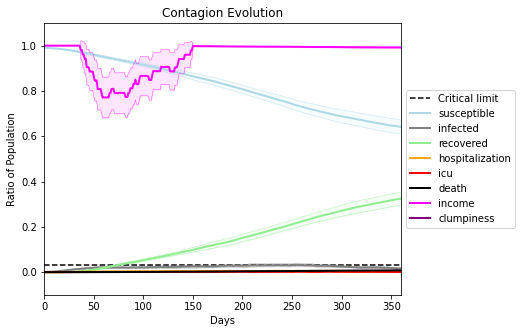

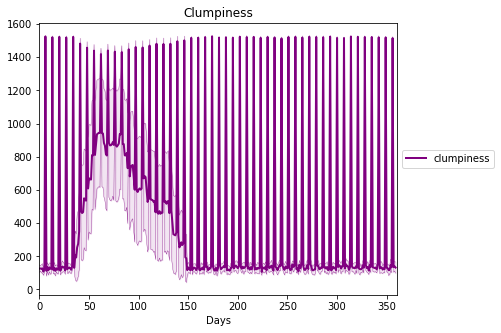

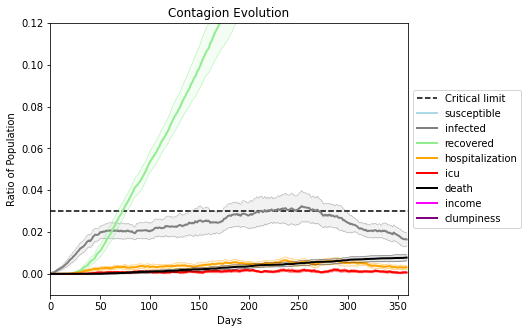

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[5299, 1419, 6747, 2426, 5585, 2596, 6556, 3154, 5143, 9460, 1365, 2321, 5579, 5603, 8780, 5124, 7029, 1700, 957, 6658]
Average similarity between family members is 0.5706340201375302 at temperature -0.9
Average similarity between family and home is 0.9998496897578454 at temperature -1
Average similarity between students and their classroom is 0.27007319971313093 at temperature -0.9
Average classroom occupancy is 1.5664739884393064 and number classrooms is 173
Average similarity between workers is 0.467129154629834 at temperature -0.9
Average office occupancy is 3.262135922330097 and number offices is 206
Average friend similarity for adults: 0.6147610982209618 for kids: 0.5012206038757977
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity -0.1470086903148784
avg restaurant similarity -0.07536272395347562
avg restaurant similarity 0.3868069369086512
avg restaurant similarity -0.02822338032865894
avg restaurant similarity -0.07263891575811247
avg restaurant similarity -0.04791619730503083
avg restaurant similarity 0.304072759323481
avg restaurant similarity 0.15118381080263033
avg restaurant similarity 0.17016812990935953
avg restaurant similarity 0.32406817213172523
avg restaurant similarity 0.06717020097120067
avg restaurant similarity 0.19171127684458825
avg restaurant similarity 0.004906623543819464
avg restaurant similarity 0.20779867455011242
avg restaurant similarity 0.2993461732388321
avg restaurant similarity 0.21445131334449113
avg restaurant similarity -0.07054591823074213
avg restaurant similarity -0.008923448648169699
avg restaurant similarity 0.29354299594784805
avg restaurant similarity -0.0765488973737522
avg restaurant similarity 0.3646542519205397
avg restaurant similarity 0.162

avg restaurant similarity 0.024893492918399637
avg restaurant similarity -0.011388865553105892
avg restaurant similarity 0.49318481516997525
avg restaurant similarity 0.20980812680292085
avg restaurant similarity -0.2948549309246958
avg restaurant similarity 0.5656258563322397
avg restaurant similarity 0.3868069369086512
avg restaurant similarity -0.47382922449031584
avg restaurant similarity 0.16296230027785813
Average similarity between family members is 0.5726063515324045 at temperature -0.9
Average similarity between family and home is 0.999870648446339 at temperature -1
Average similarity between students and their classroom is 0.21204337505046175 at temperature -0.9
Average classroom occupancy is 1.625 and number classrooms is 176
Average similarity between workers is 0.4801784358373805 at temperature -0.9
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.6073326458198971 for kids: 0.5004993308104124
home_districts
[
H

avg restaurant similarity -0.03862569944096047
avg restaurant similarity 0.3048591077060556
avg restaurant similarity 0.2684625210913286
avg restaurant similarity 0.07826036733082264
avg restaurant similarity -0.22061051440232715
avg restaurant similarity -0.13070949633509246
avg restaurant similarity 0.20416454912426035
avg restaurant similarity -0.26061619089619276
avg restaurant similarity 0.04240007397823736
avg restaurant similarity 0.13375721659135462
avg restaurant similarity 0.22146248650739403
avg restaurant similarity 0.03276445953845834
avg restaurant similarity -0.2916321023875906
avg restaurant similarity 0.14344004195077403
avg restaurant similarity 0.16318620294473637
avg restaurant similarity 0.3712772306131518
avg restaurant similarity 0.18085862606957903
avg restaurant similarity 0.1645553629288822
avg restaurant similarity -0.0659859037581697
avg restaurant similarity 0.05389952146386953
avg restaurant similarity 0.05003838730912806
avg restaurant similarity 0.042806

avg restaurant similarity 0.25179127414791524
avg restaurant similarity 0.2832935375335871
avg restaurant similarity -0.017021413698430188
avg restaurant similarity -0.19014434474636202
avg restaurant similarity -0.006130086991375863
avg restaurant similarity 0.373787250331737
avg restaurant similarity -0.012458907796509017
avg restaurant similarity 0.1161471959711729
avg restaurant similarity 0.20297520267807134
avg restaurant similarity -0.2944474182298049
avg restaurant similarity 0.1642726681563077
avg restaurant similarity 0.13878529332064282
avg restaurant similarity 0.009123599191138698
avg restaurant similarity -0.4570804805019787
avg restaurant similarity -0.05182543407325541
avg restaurant similarity -0.0028374432550226387
avg restaurant similarity -0.20786507223680672
avg restaurant similarity -0.037286268103823406
avg restaurant similarity -0.01916077828173511
avg restaurant similarity -0.06270922187797925
avg restaurant similarity -0.055236871683472216
avg restaurant simil

avg restaurant similarity 0.1832171726853395
avg restaurant similarity 0.6665971403607669
avg restaurant similarity -0.08485481948853785
avg restaurant similarity 0.0570899766165124
avg restaurant similarity 0.6652728302100754
avg restaurant similarity 0.13394902869072567
avg restaurant similarity 0.5011429766103668
avg restaurant similarity 0.449511993828959
avg restaurant similarity 0.8073405799682749
avg restaurant similarity 0.07668935922758931
avg restaurant similarity 0.27343080575469997
avg restaurant similarity 0.21360750099424652
avg restaurant similarity 0.29841133477318027
avg restaurant similarity 0.8073405799682749
avg restaurant similarity 0.025176739362706327
avg restaurant similarity 0.559987645493297
avg restaurant similarity -0.2100834320587341
avg restaurant similarity 0.3062219051078785
avg restaurant similarity -0.34820975742381144
avg restaurant similarity 0.5967820300545194
avg restaurant similarity 0.25483617059599245
avg restaurant similarity 0.1649215663685760

avg restaurant similarity -0.3025726758472251
avg restaurant similarity 0.20770340662620296
avg restaurant similarity 0.22458931027253648
avg restaurant similarity 0.47164570880928885
avg restaurant similarity 0.005101199892259134
avg restaurant similarity -0.2837242570234176
avg restaurant similarity 0.16381769013271938
avg restaurant similarity -0.021268708743321534
avg restaurant similarity -0.4474354994014683
avg restaurant similarity -0.0017991933055839238
avg restaurant similarity 0.37531255855068435
avg restaurant similarity 0.4744392132319808
Average similarity between family members is 0.5516109570735545 at temperature -0.9
Average similarity between family and home is 0.999856065776847 at temperature -1
Average similarity between students and their classroom is 0.26096128476555774 at temperature -0.9
Average classroom occupancy is 1.5513513513513513 and number classrooms is 185
Average similarity between workers is 0.4509655206840598 at temperature -0.9
Average office occupan

avg restaurant similarity 0.31945939503164145
avg restaurant similarity 0.03474316758268815
avg restaurant similarity 0.04043479787069938
avg restaurant similarity 0.17905473896346685
avg restaurant similarity 0.14189459477708447
avg restaurant similarity -0.14333868982629575
avg restaurant similarity 0.3539570949118963
avg restaurant similarity 0.0650665032748382
avg restaurant similarity 0.5184402320532098
avg restaurant similarity 0.12726914408802137
avg restaurant similarity -0.06040452227799106
avg restaurant similarity 0.2132774174731931
avg restaurant similarity 0.10485473443294187
avg restaurant similarity -0.00819293157107398
avg restaurant similarity 0.25131279663567097
avg restaurant similarity -0.06430168328219765
avg restaurant similarity 0.3890051718165974
avg restaurant similarity 0.08027601883521968
avg restaurant similarity 0.04445636159968956
avg restaurant similarity -0.038915599998634094
avg restaurant similarity -0.023314931500097804
avg restaurant similarity 0.191

avg restaurant similarity 0.19991631138113253
avg restaurant similarity -0.09443362013976013
avg restaurant similarity 0.014784468282447324
avg restaurant similarity 0.16305423566251592
avg restaurant similarity -0.05810012013359346
avg restaurant similarity -0.17932972192372826
avg restaurant similarity -0.22972842120552345
avg restaurant similarity -0.086145419029413
avg restaurant similarity 0.237973599547319
avg restaurant similarity 0.4921908450030781
avg restaurant similarity 0.026488153713601678
avg restaurant similarity 0.2640531724998561
avg restaurant similarity 0.6302006146737884
avg restaurant similarity 0.25637955576186844
avg restaurant similarity 0.26870434658818687
avg restaurant similarity -0.04287194829518789
avg restaurant similarity 0.23007278639084605
avg restaurant similarity 0.04973697656342656
avg restaurant similarity -0.010638649587557858
avg restaurant similarity 0.11626161675421558
avg restaurant similarity 0.058211255095196174
avg restaurant similarity 0.20

avg restaurant similarity 0.13851260276358476
avg restaurant similarity 0.0601431139093589
avg restaurant similarity 0.19066067681105886
avg restaurant similarity 0.5699447763658283
avg restaurant similarity 0.3449850534836395
avg restaurant similarity 0.5949155127226428
avg restaurant similarity 0.15888881816752745
avg restaurant similarity 0.07188619481593828
avg restaurant similarity 0.2750666976799416
avg restaurant similarity 0.214121446531017
avg restaurant similarity -0.059612920497099986
avg restaurant similarity 0.13520805530333116
avg restaurant similarity -0.18334224670664778
avg restaurant similarity 0.08011984181517508
avg restaurant similarity 0.0010934109108745593
avg restaurant similarity 0.17282879811496976
avg restaurant similarity -0.20258636118721426
avg restaurant similarity -0.01777211897457418
avg restaurant similarity 0.24958903433435442
avg restaurant similarity 0.1888696136022519
avg restaurant similarity 0.035451006043048766
avg restaurant similarity 0.098647

avg restaurant similarity 0.14511347215251452
avg restaurant similarity 0.5949155127226428
avg restaurant similarity 0.2692033354257549
avg restaurant similarity -0.046401945092409976
avg restaurant similarity 0.19904995213943694
avg restaurant similarity 0.2937724178108131
avg restaurant similarity 0.005745594988216238
avg restaurant similarity -0.16102595043210008
avg restaurant similarity 0.3173142557828822
avg restaurant similarity 0.11116466046222762
avg restaurant similarity 0.06542627091121066
avg restaurant similarity -0.04499506315295827
avg restaurant similarity 0.12287585413013316
avg restaurant similarity -0.08455813229269535
avg restaurant similarity -0.05911704433407376
avg restaurant similarity 0.48747732321448944
avg restaurant similarity -0.09972373427187958
avg restaurant similarity 0.13093681147972852
avg restaurant similarity 0.8865862678329974
avg restaurant similarity -0.3302736538241202
avg restaurant similarity -0.39299252388192607
avg restaurant similarity -0.0

avg restaurant similarity -0.0056523413761062945
avg restaurant similarity -0.0342945120214913
avg restaurant similarity -0.4057909749055325
avg restaurant similarity 0.4083927963369923
avg restaurant similarity 0.05998811672691784
avg restaurant similarity -0.05668962494245505
avg restaurant similarity 0.2949569285947514
avg restaurant similarity 0.14478363208473585
avg restaurant similarity -0.16908352614849237
avg restaurant similarity -0.005592221630995764
avg restaurant similarity -0.07192674614891637
avg restaurant similarity 0.46816651428509976
avg restaurant similarity 0.19025470502009142
avg restaurant similarity -0.007254759830930741
avg restaurant similarity 0.18560315198217728
avg restaurant similarity 0.18325719131851687
avg restaurant similarity -0.3501790926190014
avg restaurant similarity -0.003993103785179392
avg restaurant similarity 0.11419403691815526
avg restaurant similarity -0.442288714080026
avg restaurant similarity 0.20516895466641474
avg restaurant similarity

avg restaurant similarity 0.37437710140942326
avg restaurant similarity -0.2843537021818649
avg restaurant similarity -0.028379640376303555
avg restaurant similarity 0.043558126257062416
avg restaurant similarity 0.3370020528718929
avg restaurant similarity -0.14212818738148264
avg restaurant similarity 0.12483428592104895
avg restaurant similarity -0.12128555403426493
avg restaurant similarity 0.2495521938523627
avg restaurant similarity 0.18801576686730584
avg restaurant similarity -0.03356289738656937
avg restaurant similarity 0.0038300166630436693
avg restaurant similarity -0.07112489107898802
avg restaurant similarity -0.022249435011382407
avg restaurant similarity 0.015685719583271585
avg restaurant similarity 0.3680665974281608
avg restaurant similarity 0.26226077007134396
avg restaurant similarity 0.8029858268695262
avg restaurant similarity 0.13855260978830272
avg restaurant similarity 0.4443209140686518
avg restaurant similarity 0.13989570128194995
avg restaurant similarity -

avg restaurant similarity 0.10231665883294339
avg restaurant similarity 0.01995718071252442
avg restaurant similarity 0.2533003256201652
avg restaurant similarity 0.31179583590198634
avg restaurant similarity 0.03208906663823152
avg restaurant similarity 0.2616632863666145
avg restaurant similarity 0.18273373921252994
avg restaurant similarity 0.7930389323000004
avg restaurant similarity 0.05455688516724254
avg restaurant similarity -0.022829140466832598
avg restaurant similarity 0.07589322727251482
avg restaurant similarity -0.07160160541902352
avg restaurant similarity -0.21118590014311317
avg restaurant similarity 0.2674111570337784
avg restaurant similarity -0.10051557476085538
avg restaurant similarity 0.21446518872340942
avg restaurant similarity 0.38275415588791384
avg restaurant similarity 0.0002628924979610943
avg restaurant similarity -0.69481848122382
avg restaurant similarity -0.0426730897982898
avg restaurant similarity -0.13500878035852154
avg restaurant similarity -0.064

avg restaurant similarity 0.30424454802745715
avg restaurant similarity 0.20655318948030735
avg restaurant similarity 0.5387547898443681
avg restaurant similarity 0.07072174893809088
avg restaurant similarity -0.07934877404546646
avg restaurant similarity -0.012139582318300604
avg restaurant similarity 0.21959075719631777
avg restaurant similarity 0.14929518436675004
avg restaurant similarity 0.9999086616879245
avg restaurant similarity -0.15792552061559956
avg restaurant similarity 0.07678481786889242
avg restaurant similarity -0.05299699203707555
avg restaurant similarity -0.19416322680650888
avg restaurant similarity 0.1604593229251948
avg restaurant similarity 0.2867207850109718
avg restaurant similarity 0.3068795145416167
avg restaurant similarity 0.4355426696176372
avg restaurant similarity 0.3322367569088044
avg restaurant similarity 0.45350929389894723
avg restaurant similarity 0.6758525192164748
avg restaurant similarity -0.021012423348780646
avg restaurant similarity 0.394610

avg restaurant similarity -0.2640143164786721
avg restaurant similarity 0.3219625455182521
avg restaurant similarity 0.03931917942009722
avg restaurant similarity 0.5893906595166742
avg restaurant similarity 0.1820849660054297
Average similarity between family members is 0.5354956225212826 at temperature -0.9
Average similarity between family and home is 0.9998313311704139 at temperature -1
Average similarity between students and their classroom is 0.24708593912568874 at temperature -0.9
Average classroom occupancy is 1.6432748538011697 and number classrooms is 171
Average similarity between workers is 0.44592099942485636 at temperature -0.9
Average office occupancy is 3.1893203883495147 and number offices is 206
Average friend similarity for adults: 0.5911707053106865 for kids: 0.49387009303612356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated

avg restaurant similarity 0.18046756554531537
avg restaurant similarity 0.26508286396385505
avg restaurant similarity 0.4203628747662378
avg restaurant similarity 0.4235849949745981
avg restaurant similarity 0.18758189443598677
avg restaurant similarity -0.008939595508569168
avg restaurant similarity -0.03040792322814455
avg restaurant similarity 0.3511517083728668
avg restaurant similarity 0.012643636787782547
avg restaurant similarity 0.09402364896597827
avg restaurant similarity 0.13393340012364233
avg restaurant similarity 0.3472750159462987
avg restaurant similarity 0.16254841303559053
avg restaurant similarity 0.1826612811490164
avg restaurant similarity 0.14468853561022743
avg restaurant similarity 0.12262332711226429
avg restaurant similarity -0.08615751452596619
avg restaurant similarity 0.25726871912283666
avg restaurant similarity 0.05876519842350308
avg restaurant similarity 0.004699317915284114
avg restaurant similarity 0.06428067714880804
avg restaurant similarity 0.03158

avg restaurant similarity 0.07728706582198702
avg restaurant similarity -0.39811126459662427
Average similarity between family members is 0.559434862581711 at temperature -0.9
Average similarity between family and home is 0.9998532090159866 at temperature -1
Average similarity between students and their classroom is 0.25234851059077135 at temperature -0.9
Average classroom occupancy is 1.5197740112994351 and number classrooms is 177
Average similarity between workers is 0.46067433332985974 at temperature -0.9
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.60484076247366 for kids: 0.4959970441682306
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated 

avg restaurant similarity 0.21693647895273427
avg restaurant similarity 0.22554192493450084
avg restaurant similarity 0.2575561783280256
avg restaurant similarity 0.47028427764750047
avg restaurant similarity -0.14142514571662626
avg restaurant similarity 0.07648096910949767
avg restaurant similarity -0.07892593314735596
avg restaurant similarity 0.16639627627641615
avg restaurant similarity -0.05147525631592273
avg restaurant similarity -0.13114708667111075
avg restaurant similarity -0.048096681722691256
avg restaurant similarity -0.013094901289416322
avg restaurant similarity 0.889970611184719
avg restaurant similarity 0.01167170931228204
avg restaurant similarity -0.13242498853958418
avg restaurant similarity 0.15633840185500247
avg restaurant similarity 0.5163455454713695
avg restaurant similarity -0.1395436357604839
avg restaurant similarity 0.10786816286526679
avg restaurant similarity 0.3763492859013658
avg restaurant similarity -0.08980440177278587
avg restaurant similarity -0.

avg restaurant similarity 0.06466860657004782
avg restaurant similarity -0.049867211102071485
avg restaurant similarity -0.44734244425841413
avg restaurant similarity -0.3302791910909769
avg restaurant similarity 0.19993450361531026
avg restaurant similarity 0.08256292018329278
avg restaurant similarity -0.14386363793852047
avg restaurant similarity -0.007461892881167331
avg restaurant similarity -0.0886524191597043
avg restaurant similarity 0.06170795851106046
avg restaurant similarity 0.3957153075159189
avg restaurant similarity 0.2883933708848536
avg restaurant similarity 0.5227933971677873
avg restaurant similarity -0.1356515918577994
avg restaurant similarity 0.06170795851106046
avg restaurant similarity -0.10693835193044283
avg restaurant similarity 0.12472714979251907
avg restaurant similarity 0.35110821908186
avg restaurant similarity 0.3957153075159189
avg restaurant similarity 0.5802663883299568
avg restaurant similarity 0.21055180789316638
avg restaurant similarity 0.0375209

avg restaurant similarity 0.38024303935876863
avg restaurant similarity -0.059144893216944744
avg restaurant similarity -0.0766532661782271
avg restaurant similarity -0.4313893507429155
avg restaurant similarity 0.38990503892368883
avg restaurant similarity -0.10865507432889872
avg restaurant similarity 0.013747333220188993
avg restaurant similarity 0.5869811943549821
avg restaurant similarity -0.10122317438813383
avg restaurant similarity -0.35019505742286955
avg restaurant similarity 0.008796668741100182
avg restaurant similarity -0.01484123095428233
avg restaurant similarity 0.36492138648880257
avg restaurant similarity 0.0718125171549274
avg restaurant similarity 0.17405505591602055
avg restaurant similarity -0.05569620850033923
avg restaurant similarity 0.7256534242460146
avg restaurant similarity -0.20154376765252507
avg restaurant similarity 0.2621637814979658
avg restaurant similarity 0.12264137978272024
avg restaurant similarity 0.2858129100681205
avg restaurant similarity 0.1

avg restaurant similarity 0.5591332977842677
avg restaurant similarity 0.02109219132496834
avg restaurant similarity 0.5591332977842677
avg restaurant similarity 0.10395141024090135
avg restaurant similarity -0.04739065866590847
avg restaurant similarity -0.4622423443167546
avg restaurant similarity -0.1500958038046416
avg restaurant similarity -0.05217899932183158
avg restaurant similarity 0.3422012174714275
avg restaurant similarity -0.0937654920631548
avg restaurant similarity -0.17484694003441878
avg restaurant similarity -0.4750704452810992
avg restaurant similarity -0.43568704211092246
avg restaurant similarity -0.0007867860935430829
avg restaurant similarity 0.6957809468546757
avg restaurant similarity 0.1100103937118062
avg restaurant similarity 0.873021310428312
avg restaurant similarity 0.3366985684699218
avg restaurant similarity -0.13370453160944543
avg restaurant similarity 0.11489505920375907
avg restaurant similarity 0.17982474913257276
avg restaurant similarity 0.349630

avg restaurant similarity 0.08808562841715697
avg restaurant similarity 0.19691326943191392
avg restaurant similarity 0.11574555728106364
avg restaurant similarity -0.050614904079558085
avg restaurant similarity 0.30776298126455315
avg restaurant similarity 0.3081714399385617
avg restaurant similarity 0.3361189918673866
avg restaurant similarity 0.3387241013406653
avg restaurant similarity -0.22469902154470456
avg restaurant similarity -0.00417835122555001
avg restaurant similarity 0.2892974160030182
avg restaurant similarity -0.0015836577969347496
avg restaurant similarity 0.24402367821028903
avg restaurant similarity 0.5328020206494224
avg restaurant similarity 0.37149658905417915
avg restaurant similarity -0.00624325060435107
avg restaurant similarity 0.09652990093767473
avg restaurant similarity 0.1949398432010631
avg restaurant similarity -0.062255154386307784
avg restaurant similarity -0.2546752036100706
avg restaurant similarity 0.03390524858892115
avg restaurant similarity 0.26

avg restaurant similarity 0.12133472030145562
avg restaurant similarity -0.08432679307540569
avg restaurant similarity 0.06939463751394666
Average similarity between family members is 0.5634188574820901 at temperature -0.9
Average similarity between family and home is 0.9998508091102746 at temperature -1
Average similarity between students and their classroom is 0.22721636046854665 at temperature -0.9
Average classroom occupancy is 1.648936170212766 and number classrooms is 188
Average similarity between workers is 0.44607395789349935 at temperature -0.9
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.605744992108205 for kids: 0.5123501550827988
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.2003017924842328
avg restaurant similarity -0.17457377562973014
avg restaurant similarity 0.412499886466607
avg restaurant similarity 0.14088844182571947
avg restaurant similarity 0.05091363593909123
avg restaurant similarity 0.042045519072980514
avg restaurant similarity -0.03833369410358904
avg restaurant similarity 0.15507905080293052
avg restaurant similarity 0.31076001154448296
avg restaurant similarity 0.3538257041242157
avg restaurant similarity -0.24505602001798055
avg restaurant similarity 0.7488041357598388
avg restaurant similarity -0.31060676713463564
avg restaurant similarity 0.532176267633248
avg restaurant similarity 0.7861568890296287
avg restaurant similarity -0.036058420764911565
avg restaurant similarity 0.3505345524017127
avg restaurant similarity 0.6420117241611946
avg restaurant similarity 0.052338833888524276
avg restaurant similarity 0.18513937324550175
avg restaurant similarity 0.6894128653518949
avg restaurant similarity 0.003044148

avg restaurant similarity 0.3279857780312522
avg restaurant similarity -0.008994061509394469
avg restaurant similarity 0.39865074776188253
avg restaurant similarity 0.36009480278474415
avg restaurant similarity 0.1511741221920249
avg restaurant similarity 0.14058129544096898
avg restaurant similarity 0.22384120371789554
avg restaurant similarity 0.12449631669684376
avg restaurant similarity 0.11751583499509012
avg restaurant similarity 0.2625303999416241
avg restaurant similarity 0.270003575853459
avg restaurant similarity 0.3165596170538997
avg restaurant similarity 0.1835404475726146
avg restaurant similarity -0.2651732299395103
avg restaurant similarity -0.06853387170111638
avg restaurant similarity -0.022148955671142403
avg restaurant similarity 0.8481766150137791
avg restaurant similarity 0.32362706591886164
avg restaurant similarity 0.0593773130273699
avg restaurant similarity -0.23017651837167866
avg restaurant similarity -0.09860014501843245
avg restaurant similarity -0.1094674

avg restaurant similarity -0.05726151729244222
avg restaurant similarity 0.07274287838216895
avg restaurant similarity -0.020283218842989233
avg restaurant similarity 0.10464448522257823
avg restaurant similarity 0.5526736804904616
avg restaurant similarity 0.10050072504022042
avg restaurant similarity 0.14400151594616767
avg restaurant similarity 0.4027382220706291
avg restaurant similarity 0.4841623537509684
Average similarity between family members is 0.5561239544138525 at temperature -0.9
Average similarity between family and home is 0.9998529799705681 at temperature -1
Average similarity between students and their classroom is 0.2391925895512716 at temperature -0.9
Average classroom occupancy is 1.5748502994011977 and number classrooms is 167
Average similarity between workers is 0.46990143944780594 at temperature -0.9
Average office occupancy is 3.343137254901961 and number offices is 204
Average friend similarity for adults: 0.604753454421818 for kids: 0.48696794424593914
home_d

avg restaurant similarity 0.036741637673344686
avg restaurant similarity 0.21740812064817908
avg restaurant similarity -0.3358411125801678
avg restaurant similarity -0.03469009596551195
avg restaurant similarity 0.10919148845612738
avg restaurant similarity 0.47675543559615347
avg restaurant similarity -0.02480977197068228
avg restaurant similarity -0.19557018442165355
avg restaurant similarity 0.8086982215682822
avg restaurant similarity 0.3155825975418635
avg restaurant similarity -0.08350283691076557
avg restaurant similarity 0.4552175910036075
avg restaurant similarity 0.36493392702951866
avg restaurant similarity 0.18592424399648239
avg restaurant similarity -0.4227000622856397
avg restaurant similarity 0.21862841424064777
avg restaurant similarity 0.3927448873593835
avg restaurant similarity 0.48147812478881513
avg restaurant similarity -0.0874543811616448
avg restaurant similarity 0.31842530491628585
avg restaurant similarity 0.3413272132290385
avg restaurant similarity 0.047655

avg restaurant similarity -0.31030675679312025
avg restaurant similarity 0.754724540106754
avg restaurant similarity 0.22288674325555416
avg restaurant similarity 0.754724540106754
avg restaurant similarity 0.3027460391820158
avg restaurant similarity -0.3867215037158567
avg restaurant similarity 0.2553914591552698
avg restaurant similarity -0.20802034165798897
avg restaurant similarity 0.24134713006395606
avg restaurant similarity 0.5175548537894945
avg restaurant similarity 0.31661414269365185
avg restaurant similarity 0.5313942565886544
avg restaurant similarity 0.2966230090704402
avg restaurant similarity 0.2734363113362358
avg restaurant similarity 0.37564539384885137
avg restaurant similarity 0.010696067570796004
avg restaurant similarity 0.18883903666522558
avg restaurant similarity 0.07458572946259431
avg restaurant similarity 0.24121638848564095
avg restaurant similarity 0.12705220310040855
avg restaurant similarity 0.14515284171487883
avg restaurant similarity 0.0821026855587

avg restaurant similarity 0.06774018108065322
avg restaurant similarity -0.10050213254306212
avg restaurant similarity 0.13497176801360283
avg restaurant similarity 0.05267372935522871
avg restaurant similarity 0.13895251442869216
avg restaurant similarity 0.49243875945876997
avg restaurant similarity 0.06760538473445836
avg restaurant similarity 0.3948322896270238
avg restaurant similarity -0.10050213254306212
avg restaurant similarity 0.19949249008594855
avg restaurant similarity 0.028227511440856418
avg restaurant similarity 0.2278723229471301
avg restaurant similarity -0.16877952000628343
avg restaurant similarity 0.10019396769886707
avg restaurant similarity -0.018957756623378397
avg restaurant similarity 0.1431985023042143
avg restaurant similarity -0.1836124551861077
avg restaurant similarity 0.08133460461855246
avg restaurant similarity 0.29221827548485757
avg restaurant similarity 0.7641252501339614
avg restaurant similarity 0.3257881182696261
avg restaurant similarity 0.76547

avg restaurant similarity 0.46554384825769524
avg restaurant similarity 0.008534445757383317
avg restaurant similarity -0.17645980508201783
avg restaurant similarity 0.023658957821759294
avg restaurant similarity 0.0618537642590181
avg restaurant similarity -0.08990011208722598
avg restaurant similarity 0.008534445757383317
avg restaurant similarity -0.4438415495919261
avg restaurant similarity 0.1157756343138559
avg restaurant similarity -0.01695885743018421
avg restaurant similarity 0.3627217181905485
avg restaurant similarity 0.048039313003704794
avg restaurant similarity 0.13890691160406654
avg restaurant similarity 0.41456830064138017
avg restaurant similarity 0.33848290299814177
avg restaurant similarity 0.18544529867121531
avg restaurant similarity 0.21803913905675482
avg restaurant similarity -0.013889217419297432
avg restaurant similarity 0.09880084865679133
avg restaurant similarity 0.06011577107614093
avg restaurant similarity 0.06579503321817498
avg restaurant similarity -0

avg restaurant similarity 0.12482042579205246
avg restaurant similarity 0.18404024607605737
avg restaurant similarity 0.19888057699883593
avg restaurant similarity -0.07989685149749184
avg restaurant similarity 0.1328983450925808
avg restaurant similarity 0.023175350708170263
avg restaurant similarity 0.1598021175594214
avg restaurant similarity 0.08309826005563736
avg restaurant similarity 0.3360729933210739
avg restaurant similarity -0.3248652628524314
avg restaurant similarity 0.33972169809151337
avg restaurant similarity -0.14437963921703748
avg restaurant similarity -0.06025431239589208
avg restaurant similarity 0.03491158342909569
avg restaurant similarity 0.2956400541755717
avg restaurant similarity -0.23068206103577493
avg restaurant similarity 0.1489605899265617
avg restaurant similarity 0.008731994400228444
avg restaurant similarity 0.17989509087096192
avg restaurant similarity 0.06747563371363438
avg restaurant similarity 0.14005861804997205
avg restaurant similarity 0.46138

avg restaurant similarity 0.2881543636552639
avg restaurant similarity -0.16352963658558373
avg restaurant similarity 0.09474441290073096
avg restaurant similarity 0.19868508020679512
avg restaurant similarity -0.3248652628524314
avg restaurant similarity 0.187856565788122
avg restaurant similarity -0.027861929490904498
avg restaurant similarity 0.04943135960349737
avg restaurant similarity -0.1171376304062732
avg restaurant similarity 0.15820669752084374
avg restaurant similarity 0.37009287918002554
avg restaurant similarity 0.3790405622447672
avg restaurant similarity 0.43503128496261945
avg restaurant similarity -0.2302045265321692
Average similarity between family members is 0.5558458612548101 at temperature -0.9
Average similarity between family and home is 0.9998531386994871 at temperature -1
Average similarity between students and their classroom is 0.21098569232502515 at temperature -0.9
Average classroom occupancy is 1.532258064516129 and number classrooms is 186
Average simil

avg restaurant similarity 0.2570961980235147
avg restaurant similarity 0.039657806690426255
avg restaurant similarity 0.15185635499364852
avg restaurant similarity 0.3598353293064085
avg restaurant similarity 0.6416568574306967
avg restaurant similarity 0.4039058070449071
avg restaurant similarity 0.6710028264400403
avg restaurant similarity 0.26901481206970973
avg restaurant similarity 0.07468366983880044
avg restaurant similarity 0.376078813681915
avg restaurant similarity -0.0017207519139885476
avg restaurant similarity -0.08224323067080894
avg restaurant similarity 0.3699758382874794
avg restaurant similarity 0.30223971696870267
avg restaurant similarity 0.1521022826408017
avg restaurant similarity -0.05824009290480317
avg restaurant similarity 0.790732326472441
avg restaurant similarity 0.09119423057405622
avg restaurant similarity 0.07188332265607719
avg restaurant similarity -0.20197652571121005
avg restaurant similarity -0.022179867665888767
avg restaurant similarity 0.22440445

avg restaurant similarity 0.19018593621712854
avg restaurant similarity 0.11772897379740994
avg restaurant similarity 0.7702787689825055
avg restaurant similarity -0.14353762583344873
avg restaurant similarity 0.21401549338619758
avg restaurant similarity 0.25692077317600426
avg restaurant similarity 0.04571297758381041
avg restaurant similarity 0.12236344885481694
avg restaurant similarity 0.07232097511142811
avg restaurant similarity 0.22560285528011736
avg restaurant similarity -0.004500992697392188
avg restaurant similarity 0.07443610990387256
avg restaurant similarity 0.20341089540593685
avg restaurant similarity 0.22116511828214164
avg restaurant similarity -0.005100625701019282
avg restaurant similarity -0.05554295884167644
avg restaurant similarity -0.04161737380427876
avg restaurant similarity 0.18738062651137757
avg restaurant similarity -0.06317628128812777
avg restaurant similarity 0.02365816700014808
avg restaurant similarity 0.36319330788578785
avg restaurant similarity 0

avg restaurant similarity 0.10519977139852169
avg restaurant similarity -0.3647638996952172
avg restaurant similarity 0.1346499319828653
avg restaurant similarity -0.20044937954598682
avg restaurant similarity -0.05605851772653478
avg restaurant similarity 0.18843337236680138
avg restaurant similarity 0.3210310698933987
avg restaurant similarity 0.15783195592402627
avg restaurant similarity 0.1038531124809722
avg restaurant similarity -0.0964772809801448
avg restaurant similarity 0.7014284887136674
avg restaurant similarity 0.22189694889662312
avg restaurant similarity 0.061369611727020545
avg restaurant similarity 0.4345361571742885
avg restaurant similarity 0.127157604802524
avg restaurant similarity -0.17828453601012917
avg restaurant similarity 0.03732257913806896
avg restaurant similarity 0.16406463747253344
avg restaurant similarity -0.06128215588609961
avg restaurant similarity -0.0005787726455277447
avg restaurant similarity 0.02260872246101056
avg restaurant similarity 0.14309

(<function dict.items>, <function dict.items>, <function dict.items>)

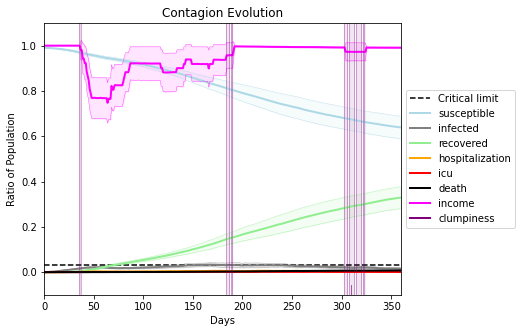

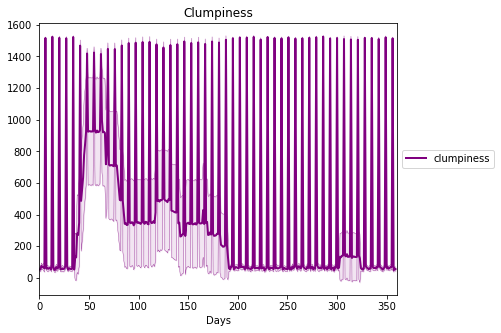

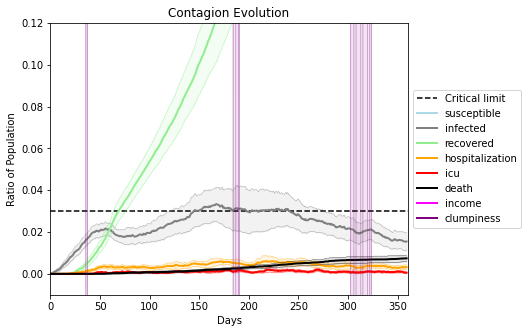

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8570, 2083, 2789, 8976, 5544, 463, 481, 8208, 6335, 2884, 495, 6968, 2972, 3973, 9092, 897, 1671, 7182, 9212, 4654]
Average similarity between family members is 0.434924422697847 at temperature -0.8
Average similarity between family and home is 0.9998569472370158 at temperature -1
Average similarity between students and their classroom is 0.1523573853982037 at temperature -0.8
Average classroom occupancy is 1.6136363636363635 and number classrooms is 176
Average similarity between workers is 0.2939206909199987 at temperature -0.8
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.49709612107665235 for kids: 0.3771406925634661
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.0456044419480071
avg restaurant similarity 0.17995495613709328
avg restaurant similarity -0.10665271276167829
avg restaurant similarity 0.11130912745865594
avg restaurant similarity -0.0715094422203303
avg restaurant similarity -0.15481810018416584
avg restaurant similarity -0.02214956546874893
avg restaurant similarity 0.0964515523068464
avg restaurant similarity 0.28120608745479275
avg restaurant similarity 0.2627102373578674
avg restaurant similarity 0.2731951537832984
avg restaurant similarity -0.4654133376111116
avg restaurant similarity 0.4263884888584108
avg restaurant similarity -0.11276379183163025
avg restaurant similarity 0.09087741729858216
avg restaurant similarity 0.05141144244164504
avg restaurant similarity -0.06750572735365933
avg restaurant similarity -0.026622642402609878
avg restaurant similarity 0.2827426398199164
avg restaurant similarity 0.33583670951027667
avg restaurant similarity -0.1098491688231656
avg restaurant similarity -0.1039

avg restaurant similarity 0.09555092380864065
avg restaurant similarity 0.41054389724130386
avg restaurant similarity 0.07443995846602051
avg restaurant similarity 0.5620807122855809
avg restaurant similarity -0.010785220387192887
avg restaurant similarity 0.5141729038335126
avg restaurant similarity 0.16911367914256248
avg restaurant similarity 0.06170882130541746
avg restaurant similarity 0.3312832536618171
avg restaurant similarity 0.2451444440518758
avg restaurant similarity -0.11278832295450816
avg restaurant similarity 0.15535799908036307
avg restaurant similarity 0.4603938416599793
avg restaurant similarity 0.16479033943125573
avg restaurant similarity 0.23716663783605196
avg restaurant similarity 0.06348951374404993
avg restaurant similarity 0.4061117532189574
avg restaurant similarity -0.040018997985402864
avg restaurant similarity 0.5614874163431907
avg restaurant similarity 0.3055674723917625
avg restaurant similarity 0.010647812152251378
avg restaurant similarity 0.41372347

avg restaurant similarity 0.15695107831948907
avg restaurant similarity -0.07400857477510342
avg restaurant similarity 0.057866814588684014
avg restaurant similarity 0.2764832884539622
avg restaurant similarity -0.06261991714197096
avg restaurant similarity 0.30547914626894523
avg restaurant similarity -0.0006869842621112926
avg restaurant similarity 0.21338310681202027
avg restaurant similarity 0.18712881025670453
avg restaurant similarity 0.32354772862311676
avg restaurant similarity 0.10154399920049116
avg restaurant similarity 0.18712881025670453
avg restaurant similarity 0.016998625795746708
avg restaurant similarity 0.09972461478013302
avg restaurant similarity -0.034809889055190474
Average similarity between family members is 0.4261398750788 at temperature -0.8
Average similarity between family and home is 0.9998518817470141 at temperature -1
Average similarity between students and their classroom is 0.15642161158399964 at temperature -0.8
Average classroom occupancy is 1.553072

avg restaurant similarity 0.44414021964903105
avg restaurant similarity 0.06870087250115951
avg restaurant similarity 0.17213675657878913
avg restaurant similarity 0.4345802516013905
avg restaurant similarity 0.3160005443864008
avg restaurant similarity 0.0319397517286964
avg restaurant similarity 0.06060821099585674
avg restaurant similarity 0.6887040531224786
avg restaurant similarity 0.5216584757822698
avg restaurant similarity 0.2760326983283441
avg restaurant similarity 0.2587936410648812
avg restaurant similarity 0.4037712516732044
avg restaurant similarity 0.12033410404632591
avg restaurant similarity -0.04039062923432277
avg restaurant similarity 0.26262805013923735
avg restaurant similarity 0.13721577136090762
avg restaurant similarity 0.18778907384446736
avg restaurant similarity 0.5400666622245328
avg restaurant similarity 0.047902950755532525
avg restaurant similarity 0.1844727148925619
avg restaurant similarity 0.5781957971987506
avg restaurant similarity 0.660331842440359

avg restaurant similarity 0.33771178287024894
avg restaurant similarity 0.10403052923677181
avg restaurant similarity 0.12353472887228777
avg restaurant similarity 0.2847598054012134
avg restaurant similarity 0.43799817131393576
avg restaurant similarity 0.047902950755532525
avg restaurant similarity 0.4216014496070549
avg restaurant similarity -0.12640941633257166
avg restaurant similarity 0.28320941775327224
avg restaurant similarity 0.051690007094080614
avg restaurant similarity 0.08622379243732249
avg restaurant similarity 0.2972458461485379
avg restaurant similarity 0.12555700908633116
avg restaurant similarity 0.06285707416198635
avg restaurant similarity -0.434325891980611
avg restaurant similarity 0.6443708774500606
avg restaurant similarity 0.22750745556898952
avg restaurant similarity 0.49415952488738224
avg restaurant similarity 0.012999684061710585
avg restaurant similarity -0.05071097790182555
avg restaurant similarity 0.32043786803493085
avg restaurant similarity -0.25536

avg restaurant similarity 0.13552783165547944
avg restaurant similarity 0.5081106234649762
avg restaurant similarity 0.06741974219155375
avg restaurant similarity 0.5913622543947421
avg restaurant similarity 0.32354710151978733
avg restaurant similarity 0.05668867857483298
avg restaurant similarity -0.0011474048768091993
avg restaurant similarity 0.2054074761325434
avg restaurant similarity 0.4512918462167663
avg restaurant similarity -0.21656815277495042
avg restaurant similarity 0.08269717150959535
avg restaurant similarity 0.5162898461648896
avg restaurant similarity 0.0721110260432943
avg restaurant similarity -0.3007521072551318
avg restaurant similarity 0.25558205676828794
avg restaurant similarity 0.27717243647844525
avg restaurant similarity 0.43529713042629103
avg restaurant similarity -0.07060590270506957
avg restaurant similarity 0.5485156182035815
avg restaurant similarity 0.10544285531125352
avg restaurant similarity 0.2652527349237291
avg restaurant similarity 0.168878006

avg restaurant similarity 0.12315589893217328
avg restaurant similarity 0.05636852381991128
avg restaurant similarity 0.032810316182724786
avg restaurant similarity 0.17168732869436226
avg restaurant similarity -0.21871619683575172
avg restaurant similarity -0.19881731838590383
avg restaurant similarity -0.432710341165629
avg restaurant similarity -0.44824278893974057
avg restaurant similarity 0.011801961673084685
avg restaurant similarity 0.42853252747835857
avg restaurant similarity 0.22396446650421784
avg restaurant similarity -0.2875850365914548
avg restaurant similarity -0.27428311206490485
avg restaurant similarity 0.1549899265899651
avg restaurant similarity -0.006963984294716397
avg restaurant similarity 0.13941763910305396
avg restaurant similarity 0.05356167845599822
avg restaurant similarity 0.007401682467140486
avg restaurant similarity -0.33704176634861294
avg restaurant similarity 0.14016268086738082
avg restaurant similarity -0.36547210831712995
avg restaurant similarity

avg restaurant similarity 0.057905658824894755
avg restaurant similarity 0.0495947877791333
avg restaurant similarity 0.35906798879154034
avg restaurant similarity 0.09229163947536981
avg restaurant similarity 0.42017623496724005
avg restaurant similarity 0.6868365835653015
avg restaurant similarity 0.044515288441305804
avg restaurant similarity 0.2963194194887785
avg restaurant similarity 0.7276482293601094
avg restaurant similarity 0.23802819206910728
avg restaurant similarity 0.2851166336246866
avg restaurant similarity -0.0014144925703310496
avg restaurant similarity 0.2530485166491784
avg restaurant similarity 0.18709031276593904
avg restaurant similarity 0.12357396990882763
avg restaurant similarity 0.00659875948735561
avg restaurant similarity 0.06318056432378338
avg restaurant similarity 0.07240907367342236
avg restaurant similarity -0.33859606049290414
avg restaurant similarity 0.18737019071190747
avg restaurant similarity 0.6734328421653377
avg restaurant similarity -0.091432

avg restaurant similarity 0.25046866642359666
avg restaurant similarity 0.46751551679499603
avg restaurant similarity 0.2926417283103711
avg restaurant similarity -0.34387601133154605
avg restaurant similarity 0.3155488770922759
avg restaurant similarity 0.03083381060041395
avg restaurant similarity 0.25617608718271295
avg restaurant similarity -0.13359371580265475
avg restaurant similarity 0.12162975656054531
avg restaurant similarity 0.7824266889971816
avg restaurant similarity -0.15315751914743617
avg restaurant similarity 0.6932258980156434
avg restaurant similarity 0.057651685517812135
avg restaurant similarity 0.18523558708452093
avg restaurant similarity 0.3252337364311674
avg restaurant similarity -0.23391438146381122
avg restaurant similarity 0.42319159184505106
Average similarity between family members is 0.4194205475358177 at temperature -0.8
Average similarity between family and home is 0.9998616664982956 at temperature -1
Average similarity between students and their class

avg restaurant similarity 0.10698853498348763
avg restaurant similarity 0.3021200068076999
avg restaurant similarity 0.23207524621458295
avg restaurant similarity 0.0018615384046645421
avg restaurant similarity 0.05212043747580483
avg restaurant similarity -0.19856744134547383
avg restaurant similarity 0.15104579851476568
avg restaurant similarity 0.08159255949903405
avg restaurant similarity 0.24627094923296447
avg restaurant similarity -0.043074027688855224
avg restaurant similarity 0.39926579747302987
avg restaurant similarity -0.04030469214980227
avg restaurant similarity 0.22130383980527824
avg restaurant similarity 0.1310871013755526
avg restaurant similarity -0.04874295938917596
avg restaurant similarity 0.1621788607699218
avg restaurant similarity 0.6235296805987445
avg restaurant similarity 0.116542487938772
avg restaurant similarity 0.26197139914617507
avg restaurant similarity 0.07958411000603897
avg restaurant similarity 0.050105601729559746
avg restaurant similarity 0.1069

Average similarity between workers is 0.29842814989855093 at temperature -0.8
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.5022829440499672 for kids: 0.38688150435772606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 1

avg restaurant similarity -0.13390795488809573
avg restaurant similarity 0.1346541953526913
avg restaurant similarity 0.08041536103623352
avg restaurant similarity 0.15324711792891454
avg restaurant similarity 0.8200451229196093
avg restaurant similarity 0.4189719086063961
avg restaurant similarity -0.27373352407362167
avg restaurant similarity 0.490883521398733
avg restaurant similarity -0.19464453173915963
avg restaurant similarity -0.10897428143690079
avg restaurant similarity -0.18854303279211682
avg restaurant similarity 0.1786120687199857
avg restaurant similarity -0.09579820063767142
avg restaurant similarity 0.358356500742109
avg restaurant similarity 0.42135736149958447
avg restaurant similarity 0.3133103989413383
avg restaurant similarity 0.018855749052076515
avg restaurant similarity 0.1358206380739668
avg restaurant similarity 0.15141726560232965
avg restaurant similarity 0.19019924325381615
avg restaurant similarity -0.235813083869378
avg restaurant similarity 0.0068044189

avg restaurant similarity -0.27373352407362167
avg restaurant similarity 0.4179456049722701
avg restaurant similarity -0.18574785676682906
avg restaurant similarity 0.2926383175537066
avg restaurant similarity 0.05727163911701874
avg restaurant similarity -0.21168004306807828
avg restaurant similarity 0.45924712693173786
avg restaurant similarity 0.25828723861183933
avg restaurant similarity 0.19832020967664804
avg restaurant similarity 0.20018961156378154
avg restaurant similarity 0.009606809723019687
avg restaurant similarity 0.4599439002918605
avg restaurant similarity 0.38910157112513594
avg restaurant similarity 0.09603259757416363
avg restaurant similarity -0.04514954905032891
avg restaurant similarity 0.08029384070223898
avg restaurant similarity 0.2536405902629384
avg restaurant similarity 0.350541526062649
avg restaurant similarity 0.10974806335025812
avg restaurant similarity 0.1757258226684571
avg restaurant similarity 0.15731577347956407
avg restaurant similarity 0.56063130

avg restaurant similarity -0.10348112419366015
avg restaurant similarity -0.02762857562612768
avg restaurant similarity 0.34308053755536294
avg restaurant similarity 0.5135354822174873
avg restaurant similarity -0.006581170348773119
avg restaurant similarity 0.010614794075883033
avg restaurant similarity 0.3212843991249619
avg restaurant similarity 0.43055791786795583
avg restaurant similarity 0.15820230326650514
avg restaurant similarity 0.09558874988236515
avg restaurant similarity 0.6197773987136911
avg restaurant similarity 0.006299630270672617
avg restaurant similarity 0.2818710225246941
avg restaurant similarity -0.0787661950873009
avg restaurant similarity -0.2330823795333019
avg restaurant similarity -0.017665489290308034
avg restaurant similarity 0.10418750920080702
avg restaurant similarity 0.82702324416088
avg restaurant similarity 0.5640157895544284
avg restaurant similarity -0.05899902733516313
avg restaurant similarity -0.2276313993324421
avg restaurant similarity 0.37738

avg restaurant similarity -0.006581170348773119
avg restaurant similarity 0.12800557874412133
avg restaurant similarity 0.1263081299528754
avg restaurant similarity -0.23472512196308276
avg restaurant similarity -0.15985453354078677
avg restaurant similarity -0.15446688823036392
avg restaurant similarity -0.18024588667314323
avg restaurant similarity -0.1288062611401472
avg restaurant similarity 0.3136439386747726
avg restaurant similarity -0.16557319583901403
avg restaurant similarity 0.075078640251728
avg restaurant similarity -0.006581170348773119
avg restaurant similarity 0.10958482278297471
avg restaurant similarity -0.08166334280796915
avg restaurant similarity -0.14126743400021963
avg restaurant similarity 0.4356971557685956
avg restaurant similarity 0.3541887206975321
avg restaurant similarity 0.3233383540239371
avg restaurant similarity 0.4722082463238797
avg restaurant similarity -0.08704306163915662
avg restaurant similarity 0.24505903584152003
Average similarity between fam

avg restaurant similarity -0.08424613451968714
avg restaurant similarity 0.19396313134849832
avg restaurant similarity 0.005978703351518566
avg restaurant similarity 0.3146075668526511
avg restaurant similarity 0.23396629313323625
avg restaurant similarity -0.012760482541142176
avg restaurant similarity -0.4548469616261914
avg restaurant similarity 0.7778788312796538
avg restaurant similarity 0.4531351477856855
avg restaurant similarity 0.39163231758019257
avg restaurant similarity 0.17302431902445864
avg restaurant similarity 0.030199245175832473
avg restaurant similarity -0.4548469616261914
avg restaurant similarity 0.14267086452911143
avg restaurant similarity -0.02241208564649304
avg restaurant similarity 0.6190733036977465
avg restaurant similarity -0.04570199344701138
avg restaurant similarity -0.3343120585247118
avg restaurant similarity 0.35347110691800265
avg restaurant similarity -0.29580379601819057
avg restaurant similarity 0.08945877619375117
avg restaurant similarity 0.27

avg restaurant similarity 0.05707115458825039
avg restaurant similarity 0.15765862613061737
avg restaurant similarity 0.3121062932468289
avg restaurant similarity 0.1990229619749771
avg restaurant similarity -0.4548469616261914
avg restaurant similarity 0.3814974874929688
avg restaurant similarity 0.3892923498811068
avg restaurant similarity 0.21690242020995343
avg restaurant similarity -0.1347084684600492
avg restaurant similarity 0.3025447890280526
avg restaurant similarity 0.397518154910047
avg restaurant similarity 0.4201279257326591
avg restaurant similarity -0.2228077871493815
avg restaurant similarity -0.4548469616261914
avg restaurant similarity -0.18298536223300452
avg restaurant similarity 0.5976524874259307
avg restaurant similarity -0.013765628255155204
avg restaurant similarity -0.0547285261652116
avg restaurant similarity -0.07774171361212213
avg restaurant similarity 0.1732296382111782
avg restaurant similarity 0.36395676762966317
Average similarity between family member

avg restaurant similarity -0.14201369748258205
avg restaurant similarity 0.19434789050852577
avg restaurant similarity -0.04207066033774148
avg restaurant similarity 0.318663279536118
avg restaurant similarity 0.08051023925111755
avg restaurant similarity -0.12287377776930734
avg restaurant similarity 0.16210862570948395
avg restaurant similarity 0.18982530005144316
avg restaurant similarity 0.3746364450731835
avg restaurant similarity 0.14969180109123037
avg restaurant similarity -0.12287377776930734
avg restaurant similarity -0.09790839855373232
avg restaurant similarity 0.11853018553447145
avg restaurant similarity 0.08920036456613603
avg restaurant similarity 0.3573206247402976
avg restaurant similarity 0.1271411276162402
avg restaurant similarity -0.12287377776930734
avg restaurant similarity -0.08171034066576899
avg restaurant similarity 0.0055096105276383756
avg restaurant similarity 0.06594792005956576
avg restaurant similarity -0.017910139196233833
avg restaurant similarity 0.

avg restaurant similarity 0.019617423970088296
avg restaurant similarity 0.35076125324105734
avg restaurant similarity 0.23610353416964802
avg restaurant similarity -0.12287377776930734
avg restaurant similarity -0.09316404070003112
avg restaurant similarity 0.22749336365607556
avg restaurant similarity -0.03353765692407346
avg restaurant similarity 0.10712427657988448
avg restaurant similarity 0.6595048876346676
avg restaurant similarity -0.0568886801304109
avg restaurant similarity -0.12287377776930734
avg restaurant similarity 0.2313753544828005
avg restaurant similarity 0.12026688944695878
avg restaurant similarity 0.05434137256153552
avg restaurant similarity -0.06923833251998734
avg restaurant similarity 0.16210862570948395
avg restaurant similarity -0.013773704339648363
avg restaurant similarity 0.20422244393907454
avg restaurant similarity 0.08975861089501283
avg restaurant similarity 0.0753275679150566
avg restaurant similarity 0.08239599573118599
avg restaurant similarity -0.

avg restaurant similarity -0.013170415399113344
avg restaurant similarity 0.40629349230158046
avg restaurant similarity 0.2464730059338974
avg restaurant similarity 0.5615109514950151
avg restaurant similarity 0.13064555293431696
avg restaurant similarity 0.1925074951656933
avg restaurant similarity 0.31023226107187374
avg restaurant similarity 0.06466039521559792
avg restaurant similarity 0.003749602611425873
avg restaurant similarity 0.08887323167650454
avg restaurant similarity 0.3069338786638609
avg restaurant similarity -0.1801584230002725
avg restaurant similarity 0.3439319653461317
avg restaurant similarity -0.027756340737671137
avg restaurant similarity 0.16994773435190247
avg restaurant similarity 0.22051145853895054
avg restaurant similarity -0.1577271134560968
avg restaurant similarity -0.09915517062978867
avg restaurant similarity 0.47946821664897155
avg restaurant similarity 0.5015761001300558
avg restaurant similarity -0.011202400010026915
avg restaurant similarity -0.070

avg restaurant similarity 0.3652782857041338
avg restaurant similarity 0.24848637219203518
avg restaurant similarity -0.03666384054225516
avg restaurant similarity -0.1236624995016368
avg restaurant similarity -0.08011561992181765
avg restaurant similarity 0.19471329675816787
avg restaurant similarity -0.11410858712384864
avg restaurant similarity 0.5384490966206935
avg restaurant similarity 0.006012536077754815
avg restaurant similarity 0.6615874578155883
avg restaurant similarity 0.1154266982586187
avg restaurant similarity -0.13687965858834247
avg restaurant similarity 0.11325309176721673
avg restaurant similarity -0.07063212792698347
avg restaurant similarity 0.15831571698531477
avg restaurant similarity -0.22315543645467903
avg restaurant similarity -0.10179748336540916
avg restaurant similarity 0.11740180687616678
avg restaurant similarity -0.10810380719442562
avg restaurant similarity 0.13717378341547495
avg restaurant similarity 0.5267862608400117
avg restaurant similarity 0.21

avg restaurant similarity 0.07320529590453868
avg restaurant similarity 0.14406313144697486
avg restaurant similarity 0.4540926707607988
avg restaurant similarity -0.3146593800400763
avg restaurant similarity 0.20460818305832798
avg restaurant similarity 0.06873360624465022
avg restaurant similarity 0.38577557719371525
avg restaurant similarity 0.04768630463344916
avg restaurant similarity -0.14516123015200766
avg restaurant similarity 0.04768630463344916
avg restaurant similarity -0.04882909783973521
avg restaurant similarity 0.35652682141624215
avg restaurant similarity 0.31095761427984014
avg restaurant similarity -0.0067264839878850985
avg restaurant similarity 0.19409607876337526
avg restaurant similarity 0.07895246499442768
avg restaurant similarity 0.014360712832991535
avg restaurant similarity 0.235834807779273
avg restaurant similarity 0.1300776368246307
avg restaurant similarity 0.14425437046463657
avg restaurant similarity 0.2434050056724192
avg restaurant similarity 0.07780

avg restaurant similarity -0.020672764675289106
avg restaurant similarity 0.2518373562886118
avg restaurant similarity -0.025125900139943577
avg restaurant similarity 0.3634135214129377
avg restaurant similarity 0.14425437046463657
avg restaurant similarity 0.07895246499442768
avg restaurant similarity -0.06001882046956114
avg restaurant similarity 0.11317716330996379
avg restaurant similarity 0.011207051171612387
avg restaurant similarity 0.23749783125782545
avg restaurant similarity 0.03127611826993092
avg restaurant similarity 0.39101140102876797
avg restaurant similarity -0.3544313490952391
avg restaurant similarity -0.037750604695642655
avg restaurant similarity 0.10644621005068693
avg restaurant similarity 0.3993529620186654
avg restaurant similarity 0.40991428832048504
avg restaurant similarity 0.7249522635941206
avg restaurant similarity -0.06229579144480228
avg restaurant similarity 0.20288828345725807
avg restaurant similarity 0.2161215286360977
avg restaurant similarity 0.02

avg restaurant similarity 0.14994491983518768
avg restaurant similarity 0.14775286560080586
avg restaurant similarity -0.31418702220662126
avg restaurant similarity 0.47146673982296367
avg restaurant similarity 0.14798249086026719
avg restaurant similarity 0.3696917125596992
avg restaurant similarity -0.3256648709776774
avg restaurant similarity -0.17473310802990816
avg restaurant similarity -0.020070821358685043
avg restaurant similarity -0.04084948994067764
avg restaurant similarity 0.6021281006433781
avg restaurant similarity 0.037340899546419434
avg restaurant similarity 0.03255810067744308
avg restaurant similarity 0.3775141867114683
avg restaurant similarity 0.43854690614433367
avg restaurant similarity 0.15218927452955378
avg restaurant similarity -0.378120460682963
avg restaurant similarity -0.18446058106598456
avg restaurant similarity 0.45969861749810204
avg restaurant similarity 0.1240034862320506
avg restaurant similarity 0.3912556792403948
avg restaurant similarity 0.16914

avg restaurant similarity 0.2864918386525873
avg restaurant similarity -0.39091253724302605
avg restaurant similarity 0.4316254415687625
avg restaurant similarity 0.19203293775880897
avg restaurant similarity 0.10444431723528912
avg restaurant similarity 0.041970649255613224
avg restaurant similarity 0.6168217280231798
avg restaurant similarity 0.7381259777774873
avg restaurant similarity 0.1981423163691571
avg restaurant similarity 0.6168217280231798
avg restaurant similarity 0.21729257332097102
avg restaurant similarity 0.024160446393919673
avg restaurant similarity 0.144494821797662
avg restaurant similarity 0.3656279772659623
avg restaurant similarity -0.23481467095930134
avg restaurant similarity 0.027021908580054852
avg restaurant similarity 0.15810878068684317
avg restaurant similarity 0.5053501311195414
avg restaurant similarity 0.6509945154287253
avg restaurant similarity 0.378061040892254
avg restaurant similarity -0.0026385751345284754
avg restaurant similarity 0.38372227427

avg restaurant similarity 0.4273481004925732
avg restaurant similarity 0.4108658122668791
avg restaurant similarity 0.26506830961219957
avg restaurant similarity 0.317092623881155
avg restaurant similarity -0.07233135101242337
avg restaurant similarity 0.21005924072548798
avg restaurant similarity 0.22449488653768332
avg restaurant similarity 0.5053501311195414
avg restaurant similarity 0.5943156336335685
avg restaurant similarity -0.16959203873282583
avg restaurant similarity 0.1012948963835441
avg restaurant similarity 0.3773444813974167
Average similarity between family members is 0.4078760409021869 at temperature -0.8
Average similarity between family and home is 0.9998554560231386 at temperature -1
Average similarity between students and their classroom is 0.16382306033614238 at temperature -0.8
Average classroom occupancy is 1.701657458563536 and number classrooms is 181
Average similarity between workers is 0.28626821612124453 at temperature -0.8
Average office occupancy is 3.22

avg restaurant similarity 0.11475127702386118
avg restaurant similarity -0.030977571854537294
avg restaurant similarity 0.08013536880963927
avg restaurant similarity 0.13848834296972232
avg restaurant similarity -0.12499649257834147
avg restaurant similarity -0.20728803801929704
avg restaurant similarity 0.19736689174998942
avg restaurant similarity 0.01389730608627962
avg restaurant similarity 0.10297661352016131
avg restaurant similarity 0.31201914150537285
avg restaurant similarity 0.06966904075615316
avg restaurant similarity -0.143283813160755
avg restaurant similarity 0.0857359088722703
avg restaurant similarity 0.23622021714121033
avg restaurant similarity -0.12744024989242558
avg restaurant similarity -0.39662979794856995
avg restaurant similarity 0.17952742924991585
avg restaurant similarity -0.003987848889519696
avg restaurant similarity 0.01048116762793818
avg restaurant similarity 0.5676507331538827
avg restaurant similarity 0.5159767589907014
avg restaurant similarity 0.04

avg restaurant similarity 0.18540530781767967
avg restaurant similarity 0.13571989619946134
avg restaurant similarity 0.32581531717611906
avg restaurant similarity -0.2656268704959799
avg restaurant similarity 0.011551952649343167
avg restaurant similarity 0.17516594751889278
avg restaurant similarity 0.27996321528542145
avg restaurant similarity 0.22851955827521894
avg restaurant similarity -0.0018935015789237862
avg restaurant similarity 0.3345746310388526
avg restaurant similarity -0.10327047631292388
avg restaurant similarity 0.8143477020661338
avg restaurant similarity 0.005088067136789387
avg restaurant similarity 0.13848834296972232
avg restaurant similarity -0.015158596132871335
avg restaurant similarity -0.3854470775098546
avg restaurant similarity 0.14082141980984472
Average similarity between family members is 0.43327730799779524 at temperature -0.8
Average similarity between family and home is 0.9998586179991238 at temperature -1
Average similarity between students and thei

avg restaurant similarity 0.0955403257357907
avg restaurant similarity 0.6685879836677138
avg restaurant similarity 0.6581291276857052
avg restaurant similarity 0.17150435589610885
avg restaurant similarity 0.21898972874901948
avg restaurant similarity 0.07169217786934444
avg restaurant similarity 0.24213647651511444
avg restaurant similarity 0.363426562213228
avg restaurant similarity 0.11644962401799872
avg restaurant similarity 0.2625790965763367
avg restaurant similarity 0.17382586270788694
avg restaurant similarity 0.2341687029718996
avg restaurant similarity 0.47051588466188554
avg restaurant similarity 0.32844694679685393
avg restaurant similarity -0.25322387467290597
avg restaurant similarity 0.3289665042197244
avg restaurant similarity -0.21078596047121856
avg restaurant similarity 0.2546441882955022
avg restaurant similarity -0.08441506887976655
avg restaurant similarity 0.5137692828444097
avg restaurant similarity 0.07093651873971943
avg restaurant similarity 0.4633896147865

Average similarity between workers is 0.2912406890022845 at temperature -0.8
Average office occupancy is 3.257425742574257 and number offices is 202
Average friend similarity for adults: 0.49863849842698327 for kids: 0.3893839463498183
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 p

avg restaurant similarity -0.010335385635197994
avg restaurant similarity -0.06148064491347618
avg restaurant similarity 0.09439396475009486
avg restaurant similarity 0.30794991339390937
avg restaurant similarity -0.2954567830025636
avg restaurant similarity 0.057675039232705165
avg restaurant similarity 0.2750208177316221
avg restaurant similarity -0.009873493370671761
avg restaurant similarity 0.007523132535692048
avg restaurant similarity 0.3725899471576548
avg restaurant similarity -0.014364479286841009
avg restaurant similarity 0.050049515232011385
avg restaurant similarity -0.2665861614078914
avg restaurant similarity 0.01250104042150152
avg restaurant similarity 0.34005807174364616
avg restaurant similarity -0.014778587741558331
avg restaurant similarity -0.11185315552510544
avg restaurant similarity -0.04447216584717784
avg restaurant similarity -0.09539935659140611
avg restaurant similarity 0.17024347535911544
avg restaurant similarity 0.43332811148658457
avg restaurant simila

avg restaurant similarity -0.22400436002438837
avg restaurant similarity 0.1992802030534051
avg restaurant similarity -0.055938873375895405
avg restaurant similarity 0.333801868004434
avg restaurant similarity -0.047018324275605206
avg restaurant similarity 0.5356197254027922
avg restaurant similarity 0.5787750312021324
avg restaurant similarity 0.2831851159463248
avg restaurant similarity -0.24016025719213926
avg restaurant similarity -0.33725978048919614
avg restaurant similarity 0.22854939280821548
avg restaurant similarity 0.6787053054992
avg restaurant similarity 0.4278266762391714
avg restaurant similarity 0.219872729987084
avg restaurant similarity 0.6327557143145228
avg restaurant similarity -0.020378662966133314
avg restaurant similarity 0.7565886451572221
avg restaurant similarity -0.03896463767335534
avg restaurant similarity 0.2304745691016963
avg restaurant similarity 0.09450858808946291
avg restaurant similarity 0.028405059757803067
avg restaurant similarity 0.00334005639

avg restaurant similarity 0.36954747259160226
avg restaurant similarity 0.44960962644250146
avg restaurant similarity -0.12050226824742448
avg restaurant similarity 0.04437133241691951
avg restaurant similarity 0.31295252917711347
avg restaurant similarity 0.5060079995429281
avg restaurant similarity 0.057103654201372825
avg restaurant similarity -0.4466047582463966
avg restaurant similarity 0.25122384527586233
avg restaurant similarity -0.1656039856605732
avg restaurant similarity -0.25545794673399247
avg restaurant similarity -0.233392338898298
avg restaurant similarity 0.21921954725471837
avg restaurant similarity 0.27346815110282574
avg restaurant similarity 0.2837711728436337
avg restaurant similarity 0.6770126676743754
avg restaurant similarity 0.25122384527586233
avg restaurant similarity 0.35507931790471964
avg restaurant similarity -0.02719215020102239
avg restaurant similarity -0.37355033254266506
avg restaurant similarity 0.42543943635093046
avg restaurant similarity 0.39515

Average similarity between family and home is 0.9998546572614102 at temperature -1
Average similarity between students and their classroom is 0.15158403492298453 at temperature -0.8
Average classroom occupancy is 1.5183246073298429 and number classrooms is 191
Average similarity between workers is 0.2875339070869772 at temperature -0.8
Average office occupancy is 3.212871287128713 and number offices is 202
Average friend similarity for adults: 0.4912404858009999 for kids: 0.37843079986469397
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity -0.16180673789381567
avg restaurant similarity 0.020684318436653047
avg restaurant similarity 0.09800691044966052
avg restaurant similarity 0.37255178795459964
avg restaurant similarity 0.28859153816105754
avg restaurant similarity 0.11124279147356333
avg restaurant similarity -0.014573816010202627
avg restaurant similarity -0.06462257211873083
avg restaurant similarity -0.09635621977206302
avg restaurant similarity 0.9117517497958716
avg restaurant similarity -0.4613528773345198
avg restaurant similarity 0.1204586901212949
avg restaurant similarity 0.1756021325914803
avg restaurant similarity 0.13814406716805785
avg restaurant similarity 0.5066127933381974
avg restaurant similarity -0.07553804447555446
avg restaurant similarity -0.001239240975676856
avg restaurant similarity 0.11743422988274743
avg restaurant similarity 0.43507293851668605
avg restaurant similarity 0.0012298821980584462
avg restaurant similarity 0.14604856711422154
avg restaurant similarity -

(<function dict.items>, <function dict.items>, <function dict.items>)

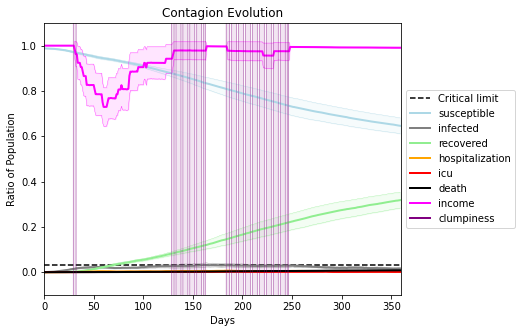

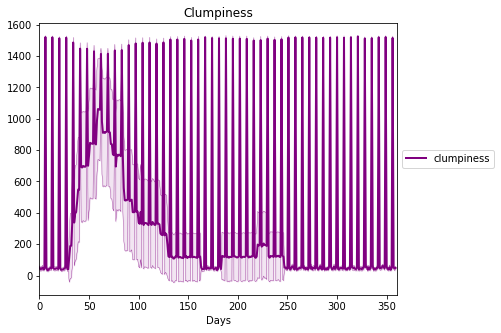

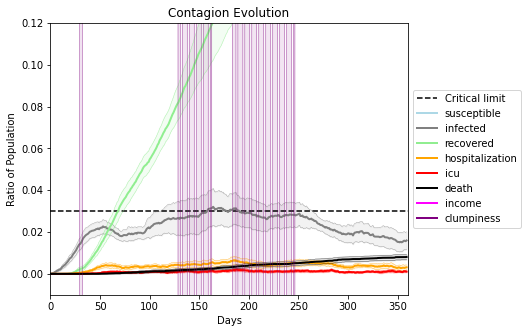

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5375, 2839, 7596, 9876, 474, 1639, 3027, 9045, 3422, 8044, 2616, 6131, 8761, 4901, 1722, 3160, 1790, 4539, 9754, 8013]
Average similarity between family members is 0.33003621840622416 at temperature -0.7
Average similarity between family and home is 0.999864382627822 at temperature -1
Average similarity between students and their classroom is 0.15148720228406398 at temperature -0.7
Average classroom occupancy is 1.6243093922651934 and number classrooms is 181
Average similarity between workers is 0.18953338426510377 at temperature -0.7
Average office occupancy is 3.2401960784313726 and number offices is 204
Average friend similarity for adults: 0.4297513386738513 for kids: 0.2984014441538032
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.1462406827820735
avg restaurant similarity -0.11397638927993889
avg restaurant similarity 0.5086642715509742
avg restaurant similarity 0.06214799113907193
avg restaurant similarity -0.28625490249321184
avg restaurant similarity 0.46559377847195754
avg restaurant similarity 0.2661100957158061
avg restaurant similarity 0.3408905507430675
avg restaurant similarity 0.06655167638803702
avg restaurant similarity 0.08212872853218324
avg restaurant similarity 0.4347924800377766
avg restaurant similarity 0.26418980735277536
avg restaurant similarity 0.4819170319425564
avg restaurant similarity 0.39331579925593496
avg restaurant similarity 0.04771054421018937
avg restaurant similarity 0.49679243001859963
avg restaurant similarity 0.05499932307139434
avg restaurant similarity -0.2882730596734276
avg restaurant similarity -0.32119016488752794
avg restaurant similarity 0.22783193727545156
avg restaurant similarity -0.35621547178814655
avg restaurant similarity 0.39765050

Average friend similarity for adults: 0.4352712613751361 for kids: 0.3041437816196535
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.1918453530426268
avg restaurant similarity -0.088305143422216
avg restaurant similarity 0.20507093569564927
avg restaurant similarity -0.061244751519256374
avg restaurant similarity 0.46717667408245067
avg restaurant similarity -0.02350979862813729
avg restaurant similarity -0.1549675722022173
avg restaurant similarity 0.29493768331721726
avg restaurant similarity -0.15472126835721214
avg restaurant similarity 0.17763167901004662
avg restaurant similarity 0.31664876343675663
avg restaurant similarity -0.16617789580272818
avg restaurant similarity -0.34240120389843853
avg restaurant similarity 0.5803047379491785
avg restaurant similarity -0.007780724696492398
avg restaurant similarity 0.20507093569564927
avg restaurant similarity 0.2323262386280146
avg restaurant similarity -0.05858169360904811
avg restaurant similarity 0.24473407306583356
avg restaurant similarity 0.5386347521629097
avg restaurant similarity 0.3518420597976543
avg restaurant similarity 0.164

avg restaurant similarity 0.20507093569564927
avg restaurant similarity 0.5078600613409308
avg restaurant similarity -0.07967040035002866
avg restaurant similarity 0.09167362144486468
avg restaurant similarity 0.18626168026051793
avg restaurant similarity 0.10716877691659096
avg restaurant similarity 0.16090669683208483
avg restaurant similarity 0.5325505734129754
avg restaurant similarity 0.2793567070317383
avg restaurant similarity 0.07223226469684901
avg restaurant similarity -0.018114853343431544
avg restaurant similarity 0.015462712866611723
avg restaurant similarity 0.06452657787490822
avg restaurant similarity -0.1971281762066247
avg restaurant similarity 0.13921498901128207
avg restaurant similarity -0.0784770081267854
avg restaurant similarity 0.0241889799404984
avg restaurant similarity -0.05753445791282684
avg restaurant similarity -0.08711705506500332
avg restaurant similarity -0.1433728805513444
avg restaurant similarity 0.24398592690259063
avg restaurant similarity -0.090

avg restaurant similarity 0.19291179633727393
avg restaurant similarity -0.011503898595842742
avg restaurant similarity 0.19419563641189871
avg restaurant similarity 0.17624492218103277
avg restaurant similarity -0.14165632212188997
avg restaurant similarity 0.29234737224529467
avg restaurant similarity -0.07615989084478031
avg restaurant similarity -0.011840228391611543
avg restaurant similarity 0.1993446454942272
avg restaurant similarity 0.1071835090411154
avg restaurant similarity -0.4066548950889885
avg restaurant similarity 0.1273777666690022
avg restaurant similarity 0.38225596244717974
avg restaurant similarity 0.4229311429651896
avg restaurant similarity 0.17118954556210242
avg restaurant similarity 0.3382108144553567
avg restaurant similarity -0.015018287288526604
avg restaurant similarity 0.1876504373303861
avg restaurant similarity 0.08353487091276572
avg restaurant similarity 0.3375617151866601
avg restaurant similarity 0.2079343709521831
avg restaurant similarity -0.15561

Average similarity between students and their classroom is 0.1681891860766318 at temperature -0.7
Average classroom occupancy is 1.5698324022346368 and number classrooms is 179
Average similarity between workers is 0.17745343205156527 at temperature -0.7
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity for adults: 0.429212257880441 for kids: 0.2952897983578797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in t

avg restaurant similarity 0.1953893272905165
avg restaurant similarity -0.10185379383376272
avg restaurant similarity 0.19256135650205985
avg restaurant similarity 0.05360910169365082
avg restaurant similarity -0.35669391120577715
avg restaurant similarity 0.45155209888248643
avg restaurant similarity 0.2811760467295421
avg restaurant similarity -0.4380236475367707
avg restaurant similarity 0.5254702186665023
avg restaurant similarity -0.09809228623558892
avg restaurant similarity 0.17910323201672343
avg restaurant similarity 0.12481607108780378
avg restaurant similarity 0.2138320998549743
avg restaurant similarity 0.19514372800171537
avg restaurant similarity -0.07608570558162431
avg restaurant similarity 0.006076397809342505
avg restaurant similarity -0.3608756923569697
avg restaurant similarity -0.0386814845720456
avg restaurant similarity -0.18257693333179992
avg restaurant similarity 0.07749169341179982
avg restaurant similarity -0.13922130498523763
avg restaurant similarity 0.105

avg restaurant similarity -0.19253259851083057
avg restaurant similarity -0.0345450623766799
avg restaurant similarity 0.3328875898265946
avg restaurant similarity 0.008407308249417642
avg restaurant similarity -0.03358311722969809
avg restaurant similarity -0.3264974520438984
avg restaurant similarity -0.2628385425661234
avg restaurant similarity 0.10721292629150778
avg restaurant similarity 0.22559953737140398
avg restaurant similarity 0.08190201353136435
avg restaurant similarity -0.3696922495516732
avg restaurant similarity 0.22901471656795763
avg restaurant similarity -0.02504437775219749
avg restaurant similarity 0.06771565528151631
avg restaurant similarity 0.10023899138710227
avg restaurant similarity 0.025971612912411922
avg restaurant similarity 0.11786040871463539
avg restaurant similarity -0.13105046645281498
avg restaurant similarity 0.2454092683183758
avg restaurant similarity -0.2867491726967162
avg restaurant similarity 0.26027827744697135
avg restaurant similarity 0.03

avg restaurant similarity 0.1274247473623266
avg restaurant similarity 0.10272074797562548
avg restaurant similarity 0.0279971152887193
avg restaurant similarity -0.02116319559354506
avg restaurant similarity 0.2976067831283591
avg restaurant similarity 0.3954228261379164
avg restaurant similarity -0.05630360606244227
avg restaurant similarity -0.1492631238392111
avg restaurant similarity -0.18330528026602594
avg restaurant similarity -0.3189576130002527
avg restaurant similarity 0.029378334998146738
avg restaurant similarity 0.002194289201848193
avg restaurant similarity 0.21066868618994403
avg restaurant similarity -0.08932470732613985
avg restaurant similarity 0.021257800003831085
avg restaurant similarity 0.6686575209885982
avg restaurant similarity 0.5869370120837871
avg restaurant similarity 0.011645372418091396
avg restaurant similarity 0.02973849079469398
avg restaurant similarity -0.04483125432921304
avg restaurant similarity -0.15187199329678594
avg restaurant similarity 0.28

avg restaurant similarity 0.2651989348100246
avg restaurant similarity 0.006605093698786119
avg restaurant similarity 0.443642678621832
avg restaurant similarity 0.015065761311746396
avg restaurant similarity -0.007389606748893225
avg restaurant similarity 0.6615640666712969
avg restaurant similarity -0.16594642029536635
avg restaurant similarity -0.07103461560733465
avg restaurant similarity 0.13227307902159452
avg restaurant similarity -0.05731583615726038
avg restaurant similarity 0.07582396387856435
avg restaurant similarity 0.27283604269655526
avg restaurant similarity 0.1388965888671689
avg restaurant similarity -0.04952345585298795
avg restaurant similarity -0.04794004945041088
avg restaurant similarity 0.0049928947676533275
avg restaurant similarity 0.13227307902159452
avg restaurant similarity 0.2651989348100246
avg restaurant similarity 0.1405452378911477
avg restaurant similarity 0.08133009168025451
avg restaurant similarity 0.054410062015724486
avg restaurant similarity -0.

avg restaurant similarity 0.29807528033561326
avg restaurant similarity -0.131659311228082
avg restaurant similarity 0.38211844300075176
avg restaurant similarity -0.33285067792982415
avg restaurant similarity 0.5968045926615901
avg restaurant similarity -0.28965859252715254
avg restaurant similarity 0.21835998134577245
avg restaurant similarity 0.21835998134577245
avg restaurant similarity 0.277028984092892
avg restaurant similarity -0.568107386017998
avg restaurant similarity -0.1086735468054672
avg restaurant similarity 0.363679509500251
avg restaurant similarity 0.2737467626540051
avg restaurant similarity 0.24563620424937138
avg restaurant similarity 0.04974902578905864
avg restaurant similarity 0.1050603840585753
avg restaurant similarity -0.012261395871008725
avg restaurant similarity 0.06909541310034695
avg restaurant similarity -0.2780956097943607
avg restaurant similarity -0.2371344733299844
avg restaurant similarity 0.6776066193099195
avg restaurant similarity -0.07082739351

avg restaurant similarity -0.448758355850579
avg restaurant similarity 0.35799216335736506
avg restaurant similarity 0.027077124193962077
avg restaurant similarity 0.0937621478312278
avg restaurant similarity 0.30203210877153275
avg restaurant similarity -0.14098849852344383
avg restaurant similarity 0.38211844300075176
avg restaurant similarity 0.10600404891956512
avg restaurant similarity 0.23947859102001542
avg restaurant similarity -0.23125242098355936
avg restaurant similarity -0.05570830073838459
avg restaurant similarity 0.3003829092721987
avg restaurant similarity -0.09537240070969255
avg restaurant similarity 0.0750952346295341
avg restaurant similarity 0.25097168369943673
avg restaurant similarity 0.061930476679309926
avg restaurant similarity 0.3071194454026189
Average similarity between family members is 0.36725278102035214 at temperature -0.7
Average similarity between family and home is 0.9998481246690889 at temperature -1
Average similarity between students and their cla

avg restaurant similarity 0.3731611376633715
avg restaurant similarity 0.4737027479259232
avg restaurant similarity 0.18586509476584467
avg restaurant similarity -0.09537787095593023
avg restaurant similarity 0.10235090567994547
avg restaurant similarity -0.020236913938608436
avg restaurant similarity 0.23618200127142616
avg restaurant similarity 0.244262872578528
avg restaurant similarity 0.10235090567994547
avg restaurant similarity 0.1225038436929691
avg restaurant similarity 0.1756476334061275
avg restaurant similarity 0.6227849149435825
avg restaurant similarity 0.5731796577919827
avg restaurant similarity 0.02086440053452604
avg restaurant similarity 0.04409248585044449
avg restaurant similarity 0.25787142179636635
avg restaurant similarity 0.44252466855730754
avg restaurant similarity 0.05589617816726046
avg restaurant similarity 0.05589617816726046
avg restaurant similarity 0.1520347545056814
avg restaurant similarity -0.06959887723368455
avg restaurant similarity 0.10235090567

avg restaurant similarity 0.1595638980569198
avg restaurant similarity 0.11478507372258433
avg restaurant similarity 0.393008253588271
avg restaurant similarity -0.004686249931091291
avg restaurant similarity 0.2507391771887373
avg restaurant similarity -0.4018096123059703
avg restaurant similarity 0.6496959158061133
avg restaurant similarity 0.03759402506696362
avg restaurant similarity 0.08529023188950825
avg restaurant similarity 0.3076522022548492
avg restaurant similarity 0.1831772854799837
avg restaurant similarity 0.47604447360412233
avg restaurant similarity 0.1658725238868293
avg restaurant similarity 0.12144651279994914
avg restaurant similarity -0.026313660390514054
avg restaurant similarity -0.13515840112255376
avg restaurant similarity -0.02014011303161989
avg restaurant similarity 0.30013693377454875
avg restaurant similarity -0.07908472512255559
avg restaurant similarity 0.019564542111991268
avg restaurant similarity -0.09034514125743831
avg restaurant similarity 0.17948

avg restaurant similarity 0.3142823700636397
avg restaurant similarity 0.19375906943092944
avg restaurant similarity -0.08612028898824176
avg restaurant similarity -0.219309691481728
avg restaurant similarity 0.15443398362854116
avg restaurant similarity 0.6103379251999228
avg restaurant similarity 0.11924359010835395
avg restaurant similarity -0.026313660390514054
avg restaurant similarity -0.14613648006191077
avg restaurant similarity 0.4236698844902057
avg restaurant similarity -0.09570270258257597
avg restaurant similarity 0.42559554672989536
avg restaurant similarity -0.481723619585011
avg restaurant similarity 0.17579804103022856
avg restaurant similarity 0.3856050775977122
avg restaurant similarity 0.19366715052850453
avg restaurant similarity -0.2968245774851586
avg restaurant similarity 0.09663913436111479
avg restaurant similarity 0.21410142048567343
avg restaurant similarity 0.5261825551537026
avg restaurant similarity -0.30830377241672613
avg restaurant similarity 0.0746046

avg restaurant similarity 0.03356505320372843
avg restaurant similarity 0.07860119698863531
avg restaurant similarity -0.03352100398219242
avg restaurant similarity 0.18721399427272603
avg restaurant similarity 0.11188691358961204
avg restaurant similarity 0.07174834148497863
avg restaurant similarity 0.32162872219767585
avg restaurant similarity 0.3141026381437063
avg restaurant similarity -0.16307986985965275
avg restaurant similarity -0.3274424278533781
avg restaurant similarity 0.4084873746210064
avg restaurant similarity 0.4789389592574693
avg restaurant similarity 0.2742264327174706
avg restaurant similarity -0.29291879985391467
avg restaurant similarity 0.17176200864570443
avg restaurant similarity -0.27616620476019904
avg restaurant similarity -0.12925655068230507
avg restaurant similarity 0.13030366055627118
avg restaurant similarity 0.12684446626375892
avg restaurant similarity 0.3656531766130475
avg restaurant similarity 0.28518911316508677
avg restaurant similarity 0.312784

avg restaurant similarity 0.018424185865032867
Average similarity between family members is 0.3459168368121654 at temperature -0.7
Average similarity between family and home is 0.999846667699806 at temperature -1
Average similarity between students and their classroom is 0.1644270404374182 at temperature -0.7
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.1799454905004336 at temperature -0.7
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.4234841555000509 for kids: 0.2892424659567659
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 peo

avg restaurant similarity 0.001344184130314112
avg restaurant similarity 0.18712164995939146
avg restaurant similarity 0.29827334112441406
avg restaurant similarity 0.039919164555296774
avg restaurant similarity 0.11921404612765299
avg restaurant similarity 0.5074215575422976
avg restaurant similarity -0.006396836674861638
avg restaurant similarity 0.23784268910930492
avg restaurant similarity 0.17944283018383358
avg restaurant similarity 0.28245977286644275
avg restaurant similarity 0.29840635419147793
avg restaurant similarity 0.011724000406895125
avg restaurant similarity -0.02100823007358682
avg restaurant similarity 0.15027897152252137
avg restaurant similarity 0.7774165612120039
avg restaurant similarity -0.05282064277824956
avg restaurant similarity 0.5421072796273975
avg restaurant similarity 0.10406901844239869
avg restaurant similarity 0.14643709650929163
avg restaurant similarity 0.10346021807858208
avg restaurant similarity -0.12391174287678533
avg restaurant similarity 0.2

avg restaurant similarity 0.016897582478879625
avg restaurant similarity 0.34635778690941027
avg restaurant similarity 0.10016238147241856
avg restaurant similarity 0.3200583727558496
avg restaurant similarity 0.3591421910862451
avg restaurant similarity 0.043643827354599006
avg restaurant similarity -0.01886716286658934
avg restaurant similarity 0.09422708747184014
avg restaurant similarity 0.11498039683682702
avg restaurant similarity -0.04512923354990869
avg restaurant similarity -0.3526167186622334
avg restaurant similarity 0.10424041602266587
avg restaurant similarity 0.1571717158369898
avg restaurant similarity 0.40797315032120735
avg restaurant similarity 0.17704675385309296
avg restaurant similarity 0.46108694592411015
avg restaurant similarity 0.06632589193248369
avg restaurant similarity -0.03590319230496544
avg restaurant similarity 0.16813212682662923
avg restaurant similarity -0.2516122343440396
avg restaurant similarity 0.3898806070867811
Average similarity between family

avg restaurant similarity 0.37836091179667286
avg restaurant similarity -0.38906241449589846
avg restaurant similarity -0.2027750374011483
avg restaurant similarity 0.017337167698514983
avg restaurant similarity 0.018807809071058928
avg restaurant similarity 0.313772452907083
avg restaurant similarity 0.3322699277757185
avg restaurant similarity -0.5567261852427705
avg restaurant similarity -0.0397570742127534
avg restaurant similarity 0.32294966203009257
avg restaurant similarity -0.041944766095001265
avg restaurant similarity -0.047810128712633584
avg restaurant similarity 0.19018682787962032
avg restaurant similarity -0.22249093331844697
avg restaurant similarity 0.10668998928121935
avg restaurant similarity 0.02403150620128753
avg restaurant similarity -0.20321448304603523
avg restaurant similarity 0.21795559664981418
avg restaurant similarity 0.07030767247753258
avg restaurant similarity -0.47092882596968044
avg restaurant similarity -0.37929828158005946
avg restaurant similarity 

avg restaurant similarity 0.10709466330424049
avg restaurant similarity -0.21391244824642988
avg restaurant similarity -0.0021072103040142842
avg restaurant similarity 0.3839035611180617
avg restaurant similarity -0.10475812948793338
avg restaurant similarity -0.07409466270873596
avg restaurant similarity 0.23816910795436047
avg restaurant similarity -0.31029763797299986
avg restaurant similarity -0.20954154517382192
avg restaurant similarity 0.03014620159479145
avg restaurant similarity -0.036653705122789815
avg restaurant similarity -0.170593792463754
avg restaurant similarity 0.1962378596929135
avg restaurant similarity 0.47960389708452056
avg restaurant similarity 0.4009967323848375
avg restaurant similarity -0.18049964774147992
avg restaurant similarity -0.23084850161696188
avg restaurant similarity 0.35585829314469586
avg restaurant similarity -0.09087522456646198
avg restaurant similarity 0.2772898903721566
avg restaurant similarity -0.304727789809318
avg restaurant similarity 0

avg restaurant similarity 0.04277860092634107
avg restaurant similarity -0.12166671464148508
avg restaurant similarity 0.043172774218302346
avg restaurant similarity -0.04510676368579941
avg restaurant similarity 0.1654624140122256
avg restaurant similarity 0.15786320140633797
avg restaurant similarity 0.24829445910886436
avg restaurant similarity 0.46662899922971235
avg restaurant similarity -0.44755514218196163
avg restaurant similarity -0.047432234066991624
avg restaurant similarity 0.3838529123425171
avg restaurant similarity 0.39986667668155196
avg restaurant similarity 0.3960505701101327
avg restaurant similarity 0.09045030493547628
avg restaurant similarity 0.22145476622816007
avg restaurant similarity 0.2395742294190863
avg restaurant similarity 0.18343014391233525
avg restaurant similarity 0.3168672332926578
avg restaurant similarity 0.1559945653714972
avg restaurant similarity 0.41510154774114527
avg restaurant similarity 0.40969843559977653
avg restaurant similarity -0.06527

avg restaurant similarity 0.2513372748403667
avg restaurant similarity 0.24533558922949894
avg restaurant similarity 0.054055235325996494
Average similarity between family members is 0.3732732018362355 at temperature -0.7
Average similarity between family and home is 0.9998569505380814 at temperature -1
Average similarity between students and their classroom is 0.19391582605885363 at temperature -0.7
Average classroom occupancy is 1.611764705882353 and number classrooms is 170
Average similarity between workers is 0.1864770896666608 at temperature -0.7
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.4363805618964365 for kids: 0.30198322345509865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.10224500311912933
avg restaurant similarity 0.24318900183752076
avg restaurant similarity 0.09011616380733979
avg restaurant similarity -0.05476395067747153
avg restaurant similarity 0.37409662712148223
avg restaurant similarity -0.4540398452820966
avg restaurant similarity 0.17930482304478731
avg restaurant similarity 0.09011616380733979
avg restaurant similarity 0.2858688242623003
avg restaurant similarity -0.2534490898403133
avg restaurant similarity 0.10543681644787722
avg restaurant similarity 0.22705173844349125
avg restaurant similarity 0.5692050141055528
avg restaurant similarity 0.2295045842729984
avg restaurant similarity 0.10323845926710319
avg restaurant similarity 0.3518014758409858
avg restaurant similarity 0.2295045842729984
avg restaurant similarity -0.28532436432654035
avg restaurant similarity 0.13350367266352195
avg restaurant similarity -0.14986860860835657
avg restaurant similarity 0.1065137938561052
avg restaurant similarity 0.009034982

Average similarity between family and home is 0.999863640405467 at temperature -1
Average similarity between students and their classroom is 0.19635644144594733 at temperature -0.7
Average classroom occupancy is 1.6983240223463687 and number classrooms is 179
Average similarity between workers is 0.17256266190403372 at temperature -0.7
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.4137124696520096 for kids: 0.3019701936495982
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 all

avg restaurant similarity -0.03261820519548833
avg restaurant similarity 0.08307560853697747
avg restaurant similarity 0.16394668275510207
avg restaurant similarity 0.0266615055882658
avg restaurant similarity 0.24665117463729658
avg restaurant similarity 0.3173201194501908
avg restaurant similarity 0.13604531372551096
avg restaurant similarity -0.3644898921375454
avg restaurant similarity -0.3490962173334171
avg restaurant similarity 0.17424456448608475
avg restaurant similarity -0.20437478560847272
avg restaurant similarity 0.1779208617141767
avg restaurant similarity -0.18486892740436292
avg restaurant similarity 0.16224447790007193
avg restaurant similarity 0.22102373313071433
avg restaurant similarity 0.3440457721153256
avg restaurant similarity 0.1779208617141767
avg restaurant similarity -0.22969879929585196
avg restaurant similarity 0.23358042385240638
avg restaurant similarity -0.4847547923099896
avg restaurant similarity 0.20775708837628612
avg restaurant similarity 0.2439938

avg restaurant similarity -0.22462612608038288
avg restaurant similarity 0.24665117463729658
avg restaurant similarity 0.23340506452223556
avg restaurant similarity 0.29279598695242204
avg restaurant similarity 0.41597701421659117
Average similarity between family members is 0.33239712225714435 at temperature -0.7
Average similarity between family and home is 0.9998701907488371 at temperature -1
Average similarity between students and their classroom is 0.1470677845197428 at temperature -0.7
Average classroom occupancy is 1.606936416184971 and number classrooms is 173
Average similarity between workers is 0.15435393219982727 at temperature -0.7
Average office occupancy is 3.4263959390862944 and number offices is 197
Average friend similarity for adults: 0.4302652927179345 for kids: 0.28475281872552766
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people alloca

avg restaurant similarity -0.27532578361903987
avg restaurant similarity -0.12468140468792077
avg restaurant similarity 0.003976781447893103
avg restaurant similarity -0.13627891168085537
avg restaurant similarity -0.21588904162923164
avg restaurant similarity -0.024008727714600858
avg restaurant similarity -0.33492709530994785
avg restaurant similarity 0.490907709230311
avg restaurant similarity -0.01606942376871298
avg restaurant similarity -0.09779318870414794
avg restaurant similarity 0.1953518424529196
avg restaurant similarity -0.001289278000309757
avg restaurant similarity -0.03991416333648501
avg restaurant similarity 0.5062467454761397
avg restaurant similarity 0.04161075809866831
avg restaurant similarity -0.14262601051527454
avg restaurant similarity 0.0034999203338701296
avg restaurant similarity -0.17840936188928347
avg restaurant similarity -0.19627852260772946
avg restaurant similarity -0.07146434885879853
avg restaurant similarity 0.09902952768393654
avg restaurant simi

avg restaurant similarity 0.1527812970403225
avg restaurant similarity 0.11748078592000093
avg restaurant similarity 0.20589688335810172
avg restaurant similarity 0.20815091382204015
avg restaurant similarity -0.06403734778156275
avg restaurant similarity -0.032270158092976384
avg restaurant similarity 0.594426466495533
avg restaurant similarity 0.3054381300034315
avg restaurant similarity 0.5390542544723467
avg restaurant similarity 0.2631482595308189
avg restaurant similarity -0.12237083488262199
avg restaurant similarity 0.10185070089357935
avg restaurant similarity 0.1111116914657852
avg restaurant similarity 0.058561434669137935
avg restaurant similarity 0.2639748052719319
avg restaurant similarity -0.3648688533960427
avg restaurant similarity -0.01851402616181025
avg restaurant similarity 0.1488274222410599
avg restaurant similarity 0.23645817544195658
avg restaurant similarity 0.09922930861516019
avg restaurant similarity 0.2117736429813785
avg restaurant similarity 0.2885043372

avg restaurant similarity -0.025730401055257757
avg restaurant similarity 0.2354322775011635
avg restaurant similarity 0.24070452466763867
avg restaurant similarity 0.3387581189403162
avg restaurant similarity 0.17251375620448337
avg restaurant similarity 0.15117281901828644
avg restaurant similarity 0.3480804484452614
avg restaurant similarity 0.0927226558363197
avg restaurant similarity -0.07093614653617838
avg restaurant similarity 0.6138324376624748
avg restaurant similarity 0.15737891545128427
avg restaurant similarity 0.5459149240756231
avg restaurant similarity 0.045139014405559105
avg restaurant similarity 0.3930574131878372
avg restaurant similarity 0.2739877297233643
avg restaurant similarity 0.1728938929223476
avg restaurant similarity 0.26654021431026603
avg restaurant similarity 0.3738964632696935
avg restaurant similarity -0.0458179443223046
avg restaurant similarity 0.24573530897057008
avg restaurant similarity 0.3267848082530435
avg restaurant similarity 0.1751092150578

avg restaurant similarity 0.01965425347384377
avg restaurant similarity -0.14260800733369766
avg restaurant similarity 0.33728568476671117
avg restaurant similarity 0.177818143292226
avg restaurant similarity 0.35092771495555475
avg restaurant similarity 0.28477941997580475
avg restaurant similarity 0.07412448465475086
avg restaurant similarity 0.013833112681032697
avg restaurant similarity 0.20370922191988827
avg restaurant similarity -0.041651512850306494
avg restaurant similarity 0.03765214636782758
avg restaurant similarity 0.20302498092487875
avg restaurant similarity 0.11224401629936939
avg restaurant similarity 0.25478327085829156
avg restaurant similarity -0.4038996338335864
avg restaurant similarity 0.5723796538186665
avg restaurant similarity -0.05045235444638513
avg restaurant similarity -0.07231519080296686
avg restaurant similarity 0.11873396656507346
avg restaurant similarity 0.17284638559613796
avg restaurant similarity 0.14640589255225972
avg restaurant similarity -0.05

avg restaurant similarity 0.44884978581595925
avg restaurant similarity 0.27425169166821023
avg restaurant similarity 0.41525667316236964
avg restaurant similarity 0.0020720518015316033
avg restaurant similarity 0.36679584351880795
avg restaurant similarity 0.11213889227167176
avg restaurant similarity 0.12475633922435711
avg restaurant similarity 0.21970442944964397
avg restaurant similarity 0.046253182399282104
avg restaurant similarity 0.27152925895289737
avg restaurant similarity 0.11625905913884449
avg restaurant similarity 0.33728568476671117
avg restaurant similarity 0.2787056773966722
avg restaurant similarity 0.23003999559582786
avg restaurant similarity 0.0014100949154783812
avg restaurant similarity 0.25368083523964413
avg restaurant similarity 0.3025160218384269
avg restaurant similarity 0.48627111724657224
avg restaurant similarity 0.10454829441428415
avg restaurant similarity 0.47628628353744207
avg restaurant similarity 0.14561256441382256
avg restaurant similarity 0.014

avg restaurant similarity 0.05231097753215567
avg restaurant similarity 0.22095113217887305
avg restaurant similarity 0.03489478472227177
avg restaurant similarity 0.6553738223716691
avg restaurant similarity 0.2733594881204677
avg restaurant similarity 0.07525195549895443
avg restaurant similarity 0.36864097519527445
avg restaurant similarity 0.2874510142886319
avg restaurant similarity 0.2668209557901544
avg restaurant similarity 0.25556766967781025
avg restaurant similarity 0.3214382502552984
avg restaurant similarity -0.3395954142199873
avg restaurant similarity 0.040194722412495804
avg restaurant similarity 0.32584507574527477
avg restaurant similarity 0.16424957899355544
avg restaurant similarity 0.3552822844193839
avg restaurant similarity 0.4719332791399483
avg restaurant similarity 0.14203758246511444
avg restaurant similarity -0.3098533961714658
avg restaurant similarity 0.23077646602678786
avg restaurant similarity -0.028561438288311702
avg restaurant similarity 0.1880335405

(<function dict.items>, <function dict.items>, <function dict.items>)

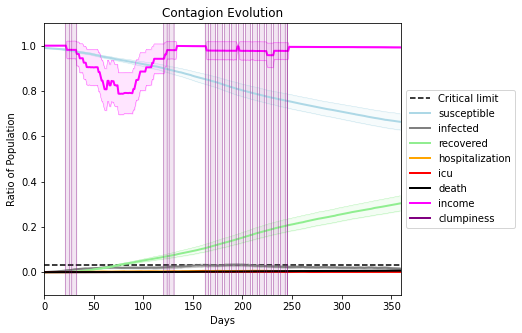

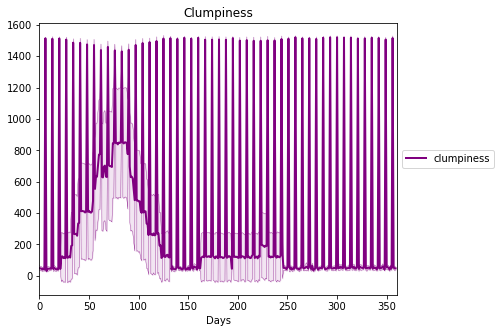

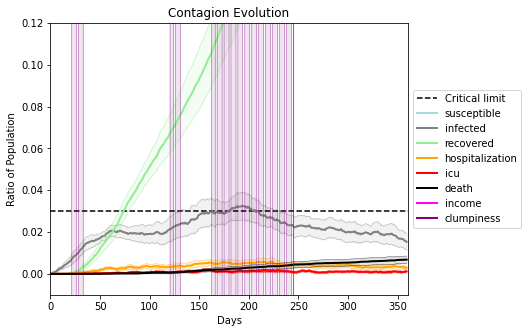

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[1282, 953, 2353, 2901, 1048, 5444, 6652, 3221, 542, 2172, 8862, 4725, 975, 6124, 4065, 5352, 4268, 9988, 5264, 5827]
Average similarity between family members is 0.316688722188466 at temperature -0.6
Average similarity between family and home is 0.9998512541178408 at temperature -1
Average similarity between students and their classroom is 0.18705737831556582 at temperature -0.6
Average classroom occupancy is 1.5677083333333333 and number classrooms is 192
Average similarity between workers is 0.15271565322276168 at temperature -0.6
Average office occupancy is 3.3248730964467006 and number offices is 197
Average friend similarity for adults: 0.37704148208536936 for kids: 0.23230857380338468
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.14135594156790354
avg restaurant similarity 0.535284413622531
avg restaurant similarity 0.08161345364897099
avg restaurant similarity 0.21653813121847998
avg restaurant similarity 0.06076987234662538
avg restaurant similarity 0.6386572120364302
avg restaurant similarity 0.4022307967359687
avg restaurant similarity -0.119452642908495
avg restaurant similarity -0.2941849746804739
avg restaurant similarity -0.08577819440866002
avg restaurant similarity -0.024275264139704968
avg restaurant similarity 0.08905045589851422
avg restaurant similarity 0.6243813267868346
avg restaurant similarity 0.24869436984186338
avg restaurant similarity -0.06310841456317898
avg restaurant similarity 0.08134130475210885
avg restaurant similarity 0.05524264559922519
avg restaurant similarity 0.01954878382500276
avg restaurant similarity -0.12565205029776608
avg restaurant similarity -0.09465078487618696
avg restaurant similarity -0.00786836296766485
avg restaurant similarity -0.0333

avg restaurant similarity -0.07638344733650264
avg restaurant similarity -0.035187422007590716
avg restaurant similarity -0.17970442065160097
avg restaurant similarity 0.10125058626832381
avg restaurant similarity 0.28489778022685525
avg restaurant similarity 0.13033843513291907
avg restaurant similarity -0.08764306361633932
avg restaurant similarity 0.19420925901769504
avg restaurant similarity 0.15603376459781482
avg restaurant similarity -0.11130144228459526
avg restaurant similarity -0.0963967484747702
avg restaurant similarity 0.09484898732212874
avg restaurant similarity 0.3585054380640924
avg restaurant similarity -0.1556592851488817
avg restaurant similarity 0.29452565501045347
avg restaurant similarity 0.07388609167247506
avg restaurant similarity 0.08561693649629076
avg restaurant similarity 0.3614295364622942
avg restaurant similarity 0.020862402362143758
avg restaurant similarity 0.029535041467422366
avg restaurant similarity -0.12877036422589092
avg restaurant similarity -

avg restaurant similarity 0.3546203881255797
avg restaurant similarity -0.0414232629924441
avg restaurant similarity -0.0580078091507606
avg restaurant similarity -0.06604595201706896
avg restaurant similarity 0.15633350757793155
avg restaurant similarity 0.5534720383155083
avg restaurant similarity -0.32909784513356416
avg restaurant similarity 0.011256578891490537
avg restaurant similarity 0.2923765387592838
avg restaurant similarity 0.3942745304730414
avg restaurant similarity -0.035533276617936344
avg restaurant similarity 0.22359856851122006
avg restaurant similarity 0.2923765387592838
avg restaurant similarity 0.10289203525599036
avg restaurant similarity -0.027812633680121802
avg restaurant similarity -0.1763461764475018
avg restaurant similarity 0.05800980163714293
avg restaurant similarity 0.22146590175929376
avg restaurant similarity 0.22199904735245887
avg restaurant similarity 0.23015509600787484
avg restaurant similarity -0.03230085583446096
avg restaurant similarity 0.209

avg restaurant similarity 0.23572166061155858
avg restaurant similarity 0.1956482285957171
avg restaurant similarity 0.07681988142605653
avg restaurant similarity 0.24088351916276912
avg restaurant similarity 0.2563668744685664
avg restaurant similarity -0.15089693837139914
avg restaurant similarity -0.22559532630331777
avg restaurant similarity 0.09926138926248579
avg restaurant similarity 0.6301650623697805
avg restaurant similarity -0.07784452661277506
avg restaurant similarity 0.689315176461668
avg restaurant similarity -0.05883785697701145
avg restaurant similarity -0.03755803991214417
avg restaurant similarity 0.05149548328410787
avg restaurant similarity -0.11774674641395243
avg restaurant similarity 0.3462036416001741
avg restaurant similarity 0.009511025689081683
avg restaurant similarity 0.0629363257453895
avg restaurant similarity 0.689315176461668
avg restaurant similarity 0.31304238729538153
avg restaurant similarity 0.689315176461668
avg restaurant similarity 0.5927804248

avg restaurant similarity 0.22531442201837418
avg restaurant similarity 0.2184832797646803
avg restaurant similarity 0.18189169042110984
avg restaurant similarity -0.12664741008607727
avg restaurant similarity 0.1781238732850274
avg restaurant similarity 0.23224472182259437
avg restaurant similarity -0.09709784030706604
avg restaurant similarity -0.056746731380205695
avg restaurant similarity 0.09376691944718103
avg restaurant similarity -0.4622285239331106
avg restaurant similarity 0.16791121306351275
avg restaurant similarity -0.09467767928860185
avg restaurant similarity -0.27989318427939053
avg restaurant similarity 0.09278268310258826
avg restaurant similarity -0.0745111927501589
avg restaurant similarity -0.10338910115874918
avg restaurant similarity 0.5918820295642193
avg restaurant similarity 0.4513280269328513
avg restaurant similarity 0.01784975439296669
avg restaurant similarity -0.036493940476698475
avg restaurant similarity 0.130564772148778
avg restaurant similarity 0.097

avg restaurant similarity 0.15829131646128883
avg restaurant similarity 0.2529111890178691
avg restaurant similarity 0.12289137284354203
avg restaurant similarity 0.16430943227524053
avg restaurant similarity 0.38098902621780667
avg restaurant similarity 0.4028908736311714
avg restaurant similarity 0.16430943227524053
avg restaurant similarity -0.1061584996775045
avg restaurant similarity 0.4256160148116761
avg restaurant similarity 0.23959147512324588
avg restaurant similarity 0.3461690180848347
avg restaurant similarity 0.22662391216436695
avg restaurant similarity 0.124928192638418
avg restaurant similarity 0.5030484017518011
avg restaurant similarity 0.4163962118254027
avg restaurant similarity 0.2839445847861846
avg restaurant similarity -0.09545874629172844
avg restaurant similarity 0.02922265216702872
avg restaurant similarity 0.4964956432347863
avg restaurant similarity 0.7153372871970446
avg restaurant similarity 0.2408485685776063
avg restaurant similarity -0.1482923740632221

avg restaurant similarity 0.020445651159789517
avg restaurant similarity 0.3307754580940658
Average similarity between family members is 0.29392601606081525 at temperature -0.6
Average similarity between family and home is 0.9998640176363959 at temperature -1
Average similarity between students and their classroom is 0.14969335553377258 at temperature -0.6
Average classroom occupancy is 1.695187165775401 and number classrooms is 187
Average similarity between workers is 0.15371673285845075 at temperature -0.6
Average office occupancy is 3.1029411764705883 and number offices is 204
Average friend similarity for adults: 0.3691521152717963 for kids: 0.24692494423628536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.2622495121854104
avg restaurant similarity 0.21925239695851087
avg restaurant similarity 0.16649470127608526
avg restaurant similarity -0.01062936690155325
avg restaurant similarity 0.2066060787292254
avg restaurant similarity -0.016687455970767873
avg restaurant similarity 0.5034699034669264
avg restaurant similarity 0.02444664326018569
avg restaurant similarity -0.20040295401536987
avg restaurant similarity -0.10105352039350166
avg restaurant similarity 0.12681775251427088
avg restaurant similarity 0.5842342634640365
avg restaurant similarity 0.2467119031299319
avg restaurant similarity 0.0847103056969524
avg restaurant similarity 0.3226444633439849
avg restaurant similarity 0.4138230020106155
avg restaurant similarity 0.25966776139530834
avg restaurant similarity -0.12943677032859358
avg restaurant similarity -0.27278142534356176
avg restaurant similarity 0.0781695030108604
avg restaurant similarity 0.15139000979157122
avg restaurant similarity 0.48579655

Average similarity between family members is 0.2993251118010592 at temperature -0.6
Average similarity between family and home is 0.9998536720959224 at temperature -1
Average similarity between students and their classroom is 0.16170937455550954 at temperature -0.6
Average classroom occupancy is 1.6666666666666667 and number classrooms is 177
Average similarity between workers is 0.13230536665275472 at temperature -0.6
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 0.3740380454381873 for kids: 0.21540916521083578
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity -0.09927749333497406
avg restaurant similarity -0.1402947708559315
avg restaurant similarity 0.17169013351620122
avg restaurant similarity 0.052232279258115216
avg restaurant similarity 0.4589824635296809
avg restaurant similarity -0.03354610437999289
avg restaurant similarity -0.4077225904454187
avg restaurant similarity -0.2326863806072574
avg restaurant similarity -0.01536901910360728
avg restaurant similarity -0.0973044451236833
avg restaurant similarity 0.29684142716849793
avg restaurant similarity 0.16873800562905708
avg restaurant similarity 0.24064906777879352
avg restaurant similarity -0.10754227445651865
avg restaurant similarity -0.2197154261586182
avg restaurant similarity 0.08118961713984263
avg restaurant similarity -0.09318628183923595
avg restaurant similarity 0.018299795634909424
avg restaurant similarity 0.046832010142875385
avg restaurant similarity -0.1852395507029763
avg restaurant similarity 0.036558649559685685
avg restaurant similarity 

Average similarity between workers is 0.1591741264512053 at temperature -0.6
Average office occupancy is 3.101010101010101 and number offices is 198
Average friend similarity for adults: 0.3643873105339973 for kids: 0.2458254764950623
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.0018859927813167088
avg restaurant similarity -0.07499693392505491
avg restaurant similarity 0.24060523482359755
avg restaurant similarity -0.10330414650751747
avg restaurant similarity -0.1471694941697122
avg restaurant similarity -0.18751707858694885
avg restaurant similarity 0.34424663528572086
avg restaurant similarity 0.022394727561745473
avg restaurant similarity 0.088236496871858
avg restaurant similarity 0.5156745722407197
avg restaurant similarity 0.13442502401095285
avg restaurant similarity -0.20872675623046327
avg restaurant similarity 0.15033171555802133
avg restaurant similarity -0.07860190807852646
avg restaurant similarity -0.09677106302475857
avg restaurant similarity -0.28718267862170066
avg restaurant similarity 0.18675883617527533
avg restaurant similarity -0.41510660928373255
avg restaurant similarity 0.030148303481697426
avg restaurant similarity 0.5205604223456783
avg restaurant similarity 0.22367401868260697
avg restaurant similarity 

avg restaurant similarity 0.06881995579510672
avg restaurant similarity 0.05906992595592628
avg restaurant similarity 0.18761792927445997
avg restaurant similarity 0.17645658031783115
avg restaurant similarity 0.25536539154763294
avg restaurant similarity 0.3921423191845519
avg restaurant similarity -0.056099051529160546
avg restaurant similarity 0.08107313034762356
avg restaurant similarity -0.24613347895512183
avg restaurant similarity 0.2122728823746671
avg restaurant similarity 0.22417901680358787
avg restaurant similarity 0.22990151176720192
avg restaurant similarity 0.42366105780306806
avg restaurant similarity 0.007406158889111997
avg restaurant similarity 0.11503710207812379
avg restaurant similarity 0.14078054298904752
avg restaurant similarity 0.21154661213334733
avg restaurant similarity 0.2122728823746671
avg restaurant similarity 0.16551519556680444
avg restaurant similarity -0.059955568585357555
avg restaurant similarity -0.06406065343165608
avg restaurant similarity 0.46

avg restaurant similarity -0.19071228435774473
avg restaurant similarity 0.1448270789781475
avg restaurant similarity 0.5391922532692817
avg restaurant similarity -0.05440005118814187
avg restaurant similarity -0.14550229928586778
avg restaurant similarity 0.3135061255219531
avg restaurant similarity 0.32455775761328004
avg restaurant similarity 0.7005637678185105
avg restaurant similarity 0.032226015942367126
avg restaurant similarity -0.2502133586066884
avg restaurant similarity 0.7005637678185105
avg restaurant similarity -0.2534314923148071
avg restaurant similarity 0.26812068519313254
avg restaurant similarity 0.2792283651898535
avg restaurant similarity 0.09866067341430362
avg restaurant similarity 0.45430694257011106
avg restaurant similarity -0.08308601566720694
avg restaurant similarity 0.0783809472862195
avg restaurant similarity 0.06527613135570438
avg restaurant similarity 0.12382253650998153
avg restaurant similarity -0.2887718408944259
avg restaurant similarity -0.0073398

avg restaurant similarity 0.018137437810301846
avg restaurant similarity 0.10275690815749228
avg restaurant similarity 0.3665641266343099
avg restaurant similarity 0.025067671732592042
avg restaurant similarity -0.2819156452902478
avg restaurant similarity 0.10787242548351522
avg restaurant similarity -0.2106964266327217
avg restaurant similarity -0.20155948105427252
avg restaurant similarity 0.47679359172430424
avg restaurant similarity -0.41867492676713103
avg restaurant similarity 0.11611666265955498
avg restaurant similarity 0.16658973065804308
avg restaurant similarity -0.1251031187974036
avg restaurant similarity -0.16988629999840227
avg restaurant similarity -0.03859253083464081
avg restaurant similarity -0.11354793102198102
avg restaurant similarity 0.3988769518495593
avg restaurant similarity 0.38391672197894755
avg restaurant similarity 0.6399530749471514
avg restaurant similarity 0.12166967840644116
avg restaurant similarity 0.2144667151469934
avg restaurant similarity 0.425

avg restaurant similarity 0.07174182016889552
avg restaurant similarity 0.33122714058312874
avg restaurant similarity 0.026104726949992177
avg restaurant similarity 0.37004589492541673
avg restaurant similarity -0.013018713824627479
avg restaurant similarity -0.23477571419981186
avg restaurant similarity 0.023207557618139307
avg restaurant similarity 0.4556735206209339
avg restaurant similarity 0.45077231324172995
avg restaurant similarity 0.22216274801890648
avg restaurant similarity 0.06511100296110035
avg restaurant similarity -0.17102063333123213
avg restaurant similarity 0.17264114076810955
avg restaurant similarity -0.20155948105427252
avg restaurant similarity 0.3382170957359819
avg restaurant similarity -0.1498764455698569
Average similarity between family members is 0.27942922522824787 at temperature -0.6
Average similarity between family and home is 0.9998514051302642 at temperature -1
Average similarity between students and their classroom is 0.16982170513654932 at temperatu

avg restaurant similarity 0.40151625462990975
avg restaurant similarity -0.18441769738931443
avg restaurant similarity 0.17101085047125475
avg restaurant similarity 0.3475111765905948
avg restaurant similarity 0.08662658186303494
avg restaurant similarity 0.32728025971431596
avg restaurant similarity 0.021084627259081584
avg restaurant similarity -0.2129536578875254
avg restaurant similarity -0.06608529014181189
avg restaurant similarity 0.05883233506485121
avg restaurant similarity 0.048657578827350084
avg restaurant similarity 0.47688272244883223
avg restaurant similarity 0.1707909466973487
avg restaurant similarity 0.04598372545670758
avg restaurant similarity -0.17239177205283024
avg restaurant similarity -0.3480453436938779
avg restaurant similarity 0.2784978909127038
avg restaurant similarity -0.2339411565363685
avg restaurant similarity 0.17429318206635866
avg restaurant similarity -0.0482567100003464
avg restaurant similarity 0.1475715743850131
avg restaurant similarity 0.07521

avg restaurant similarity -0.19215647312816625
avg restaurant similarity 0.15108627332744454
avg restaurant similarity 0.36806916145674695
avg restaurant similarity 0.24948208904753416
avg restaurant similarity -0.3480453436938779
avg restaurant similarity 0.4959825318999894
avg restaurant similarity -0.14144132670621962
avg restaurant similarity 0.0382490588747099
avg restaurant similarity 0.10573095658495336
avg restaurant similarity 0.26150602738981327
avg restaurant similarity 0.20381374026956042
avg restaurant similarity 0.12476462090226441
avg restaurant similarity -0.17820746029890705
avg restaurant similarity 0.17722016682903177
avg restaurant similarity 0.09132197546769333
avg restaurant similarity 0.4075912197644136
avg restaurant similarity 0.21630476376455748
avg restaurant similarity 0.16899212861792584
avg restaurant similarity -0.096110642617967
avg restaurant similarity 0.12549407545333444
avg restaurant similarity 0.25026906821805806
avg restaurant similarity -0.266331

avg restaurant similarity 0.13871505916780494
avg restaurant similarity 0.08934878316586269
avg restaurant similarity 0.3172639902703097
avg restaurant similarity 0.11530992996343699
avg restaurant similarity 0.09114233418559735
avg restaurant similarity -0.08657793185169868
avg restaurant similarity 0.23972870005251135
avg restaurant similarity -0.23974483023585458
avg restaurant similarity 0.26099369052377247
avg restaurant similarity 0.3171735864960892
avg restaurant similarity 0.16660463919376234
avg restaurant similarity 0.040640391257187033
avg restaurant similarity 0.295917757866928
avg restaurant similarity 0.3512542273193978
avg restaurant similarity 0.3081206445768924
avg restaurant similarity 0.12470461679395534
avg restaurant similarity 0.25939721300334107
avg restaurant similarity 0.14443572234946453
avg restaurant similarity 0.27431738714144194
avg restaurant similarity -0.005532698197242371
avg restaurant similarity 0.2239480681294769
avg restaurant similarity 0.12494407

avg restaurant similarity 0.20574164931285316
avg restaurant similarity 0.1840530112348555
avg restaurant similarity 0.10886361499264961
avg restaurant similarity 0.1283915538610229
avg restaurant similarity 0.3095677092156113
avg restaurant similarity 0.07714129925862996
avg restaurant similarity -0.3753450039595174
avg restaurant similarity -0.21476909019522272
avg restaurant similarity 0.2764588252127471
avg restaurant similarity 0.3380516745552158
avg restaurant similarity 0.29083546067000826
avg restaurant similarity 0.16689104813095218
avg restaurant similarity 0.08239232611044227
avg restaurant similarity 0.042539519247453236
avg restaurant similarity 0.05490391795241524
avg restaurant similarity -0.00013764928210280823
avg restaurant similarity -0.16879023329776047
avg restaurant similarity 0.2690754658740523
avg restaurant similarity -0.029836686738452856
avg restaurant similarity 0.374124311066514
avg restaurant similarity 0.1860574427562948
avg restaurant similarity 0.141855

avg restaurant similarity 0.5884935613290727
avg restaurant similarity 0.4551189456796333
avg restaurant similarity -0.09453797434103647
avg restaurant similarity 0.11026610827207
avg restaurant similarity 0.24615549352255747
avg restaurant similarity 0.0024428374502486264
avg restaurant similarity -0.2622875413438316
avg restaurant similarity -0.03420689910396227
avg restaurant similarity 0.14339129654102295
avg restaurant similarity -0.14673883411202482
avg restaurant similarity 0.18944746547244865
avg restaurant similarity 0.3615629511163401
avg restaurant similarity 0.3228911010304693
avg restaurant similarity 0.26148722543580055
avg restaurant similarity -0.1238031478175444
avg restaurant similarity 0.5264228212695279
avg restaurant similarity -0.016211494690292934
avg restaurant similarity -0.08398143331539977
avg restaurant similarity -0.1385056216405257
avg restaurant similarity 0.18680256353242355
avg restaurant similarity 0.06408717521301394
avg restaurant similarity -0.07163

avg restaurant similarity 0.20041586192074082
avg restaurant similarity 0.06303903097918045
avg restaurant similarity 0.49955692067649865
avg restaurant similarity 0.3320447310417263
avg restaurant similarity 0.09547564794894879
avg restaurant similarity 0.2536657496327995
avg restaurant similarity -0.04803046735388772
avg restaurant similarity 0.23651834698884258
avg restaurant similarity 0.42742321918032616
avg restaurant similarity 0.28713066403481247
avg restaurant similarity -0.23604826752426217
avg restaurant similarity -0.0015254297490223945
avg restaurant similarity 0.1586685988901386
avg restaurant similarity 0.47827892888333157
avg restaurant similarity 0.1125722295968849
avg restaurant similarity 0.2869396311016743
avg restaurant similarity 0.10605753533555563
avg restaurant similarity 0.5763866432966458
avg restaurant similarity 0.19814949775375715
avg restaurant similarity -0.38390041937223063
avg restaurant similarity -0.29557114661895967
avg restaurant similarity 0.13035

avg restaurant similarity 0.5587417926330226
avg restaurant similarity 0.46578335534550885
avg restaurant similarity 0.20701934124275825
avg restaurant similarity 0.21499665618071895
avg restaurant similarity 0.23093978884668165
avg restaurant similarity -0.077599344441474
avg restaurant similarity 0.3140037092535831
avg restaurant similarity -0.27289009037715317
avg restaurant similarity 0.3140037092535831
avg restaurant similarity 0.3416383909793937
avg restaurant similarity 0.11232123290549502
avg restaurant similarity 0.3495557431999572
avg restaurant similarity 0.20524947073141964
avg restaurant similarity 0.08983160617810737
avg restaurant similarity 0.34910634772133503
avg restaurant similarity 0.22151311368213292
avg restaurant similarity -0.04623157787708604
avg restaurant similarity 0.4252519900480105
avg restaurant similarity 0.18257635185482549
avg restaurant similarity 0.29307966505046185
avg restaurant similarity 0.368182041638166
avg restaurant similarity 0.1038341541257

avg restaurant similarity 0.05354501220202414
avg restaurant similarity 0.15334000607721882
avg restaurant similarity 0.05342186087813633
avg restaurant similarity 0.2439846589162393
avg restaurant similarity -0.01068881167036866
avg restaurant similarity -0.26727663139212915
avg restaurant similarity -0.20712463296179978
avg restaurant similarity 0.13255251196126389
avg restaurant similarity -0.03776222658553524
avg restaurant similarity 0.20402767179309658
avg restaurant similarity -0.22573903751267585
avg restaurant similarity -0.01641508296010678
avg restaurant similarity 0.2435949890861007
avg restaurant similarity 0.0013410674773009963
avg restaurant similarity -0.03776222658553524
avg restaurant similarity 0.1286597846477035
avg restaurant similarity 0.029236398427282286
avg restaurant similarity -0.04797674137756797
avg restaurant similarity 0.05222913546286109
avg restaurant similarity 0.2522809344443807
avg restaurant similarity -0.07970844159395961
avg restaurant similarity 

avg restaurant similarity -0.4338792047146513
avg restaurant similarity 0.13797173262198503
avg restaurant similarity 0.6437062045915201
avg restaurant similarity 0.262539761472189
avg restaurant similarity 0.22925407470922177
avg restaurant similarity 0.5024978524984917
avg restaurant similarity -0.27182664953060054
avg restaurant similarity 0.21606337914554138
avg restaurant similarity 0.271535776593057
avg restaurant similarity -0.17532116420153152
avg restaurant similarity -0.14365505451989125
avg restaurant similarity -0.06294763666853694
avg restaurant similarity 0.184095342903767
avg restaurant similarity 0.1515280751801985
avg restaurant similarity -0.23162252084216073
avg restaurant similarity 0.22818101447801745
avg restaurant similarity -0.013769184098653159
avg restaurant similarity -0.22181496459129393
avg restaurant similarity -0.22181496459129393
avg restaurant similarity 0.0491495267777945
avg restaurant similarity -0.01708143610085472
avg restaurant similarity 0.324721

avg restaurant similarity 0.10170071219541144
avg restaurant similarity 0.5026212734545864
avg restaurant similarity 0.260573248268693
avg restaurant similarity -0.04078119136212595
avg restaurant similarity 0.20034941028428632
avg restaurant similarity 0.19871215976273798
avg restaurant similarity -0.029054407869962558
avg restaurant similarity -0.10675342047930504
avg restaurant similarity 0.19092498800364788
avg restaurant similarity 0.2858401417913915
avg restaurant similarity 0.19240761605473444
avg restaurant similarity -0.10652930916134054
avg restaurant similarity 0.3963366336057276
avg restaurant similarity -0.12026878908837038
avg restaurant similarity 0.03363157948928547
avg restaurant similarity 0.17526535093428305
avg restaurant similarity -0.08601122395452368
avg restaurant similarity -0.07350176714864118
avg restaurant similarity 0.32373537837995314
avg restaurant similarity 0.16361648068521256
avg restaurant similarity 0.30676868513161853
avg restaurant similarity -0.10

Average similarity between workers is 0.16372469194283157 at temperature -0.6
Average office occupancy is 3.375 and number offices is 200
Average friend similarity for adults: 0.3795019820823628 for kids: 0.2137859045513697
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allo

avg restaurant similarity 0.29244010567759227
avg restaurant similarity -0.24785366732862607
avg restaurant similarity -0.07042256516847639
avg restaurant similarity 0.07202457340843668
avg restaurant similarity 0.10711271875741757
avg restaurant similarity -0.2272218922311734
avg restaurant similarity 0.31567873812995223
avg restaurant similarity 0.20908339263084547
avg restaurant similarity 0.023239460718442077
avg restaurant similarity 0.35991505758429154
avg restaurant similarity 0.2634098701759501
avg restaurant similarity 0.5253248532734616
avg restaurant similarity 0.07573412887506793
avg restaurant similarity 0.20371135563805434
avg restaurant similarity 0.22040003779748044
avg restaurant similarity 0.14828478896346334
avg restaurant similarity -0.17950931453245328
avg restaurant similarity 0.4986895586998138
avg restaurant similarity 0.04257058682453128
avg restaurant similarity -0.2603264973422689
avg restaurant similarity 0.07643591744038233
avg restaurant similarity -0.2781

Average similarity between workers is 0.15916452258223482 at temperature -0.6
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.3695916584265002 for kids: 0.228463674305272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.33181051099978376
avg restaurant similarity 0.06856272737350765
avg restaurant similarity -0.15116067236100889
avg restaurant similarity -0.09108745756205092
avg restaurant similarity 0.23707943261967626
avg restaurant similarity 0.35395797305336657
avg restaurant similarity -0.09108745756205092
avg restaurant similarity -0.2792437749088957
avg restaurant similarity -0.10141623779561967
avg restaurant similarity 0.17388641410558214
avg restaurant similarity 0.2922047192594552
avg restaurant similarity 0.060205240444304954
avg restaurant similarity 0.6801613936618506
avg restaurant similarity 0.17958716443967682
avg restaurant similarity 0.1606108845411075
avg restaurant similarity 0.20749126341481422
avg restaurant similarity 0.3217617715489802
avg restaurant similarity -0.05579167001123205
avg restaurant similarity 0.22660944819701237
avg restaurant similarity -0.06915651185996806
avg restaurant similarity 0.5470583498060588
avg restaurant similarity -0.144

avg restaurant similarity 0.13027078820149002
avg restaurant similarity 0.2518748898778847
avg restaurant similarity 0.008152194443794364
avg restaurant similarity 0.20594213997701824
avg restaurant similarity -0.09108745756205092
avg restaurant similarity 0.3881996300863855
avg restaurant similarity 0.2838685744874204
avg restaurant similarity -0.020056928447852288
avg restaurant similarity 0.1305704733582404
avg restaurant similarity -0.15148699328227172
avg restaurant similarity -0.0479720685226731
avg restaurant similarity -0.19275788938525107
avg restaurant similarity -0.10878954831112655
avg restaurant similarity 0.3068684775065198
avg restaurant similarity 0.06407708838533155
avg restaurant similarity 0.28426940400003126
avg restaurant similarity -0.5896470964271638
avg restaurant similarity 0.2465225507145677
avg restaurant similarity -0.06915651185996806
avg restaurant similarity 0.2728170192788046
avg restaurant similarity 0.08257188178466551
avg restaurant similarity -0.1224

avg restaurant similarity 0.0616315665544743
avg restaurant similarity -0.04881602164062805
avg restaurant similarity -0.06684383718554045
avg restaurant similarity 0.4388207168066822
avg restaurant similarity 0.2741161733643042
avg restaurant similarity 0.018565828373988652
avg restaurant similarity 0.1116266163145443
avg restaurant similarity 0.3828266294865784
avg restaurant similarity 0.32705271197193597
avg restaurant similarity -0.1264446708079797
avg restaurant similarity -0.199407330386323
avg restaurant similarity 0.10036439511450118
avg restaurant similarity -0.03040642186591884
avg restaurant similarity 0.18899328602836962
avg restaurant similarity -0.036392227376908545
avg restaurant similarity 0.23590046081709037
avg restaurant similarity 0.1421778381521763
avg restaurant similarity 0.14627314043534986
avg restaurant similarity -0.24981742439612348
avg restaurant similarity -0.2896048175054494
avg restaurant similarity 0.13545869122173942
avg restaurant similarity 0.346906

avg restaurant similarity 0.65128279442633
avg restaurant similarity 0.4741536789621683
avg restaurant similarity -0.019025963839453264
avg restaurant similarity -0.23212284885316625
avg restaurant similarity -0.08026422018107024
avg restaurant similarity 0.2604810084735562
avg restaurant similarity 0.05115688497893642
avg restaurant similarity 0.06961212269087685
avg restaurant similarity 0.49495576153781995
avg restaurant similarity 0.09958347216163248
avg restaurant similarity -0.3209675682779666
avg restaurant similarity 0.08756803217900089
avg restaurant similarity 0.03205480936986062
avg restaurant similarity 0.142255509766595
avg restaurant similarity 0.1094961674376555
avg restaurant similarity 0.1689427591891955
avg restaurant similarity -0.12415756001086055
avg restaurant similarity 0.01595267019490241
avg restaurant similarity 0.4388207168066822
avg restaurant similarity 0.030584908280171366
avg restaurant similarity 0.6519703774020046
avg restaurant similarity 0.02721486582

avg restaurant similarity -0.14179812252030766
avg restaurant similarity -0.11706228934822313
avg restaurant similarity 0.16428399585309683
avg restaurant similarity -0.15865458246654987
avg restaurant similarity 0.18426185890980287
avg restaurant similarity 0.09609358969514137
avg restaurant similarity 0.34363428024913545
avg restaurant similarity 0.2940950368883707
avg restaurant similarity -0.03443044098640166
avg restaurant similarity -0.013803191657160544
avg restaurant similarity -0.12307940415450103
avg restaurant similarity 0.16760728280125944
avg restaurant similarity -0.03985149127335469
avg restaurant similarity 0.2781522777557861
avg restaurant similarity 0.030933919013687125
avg restaurant similarity 0.2259092950635785
avg restaurant similarity 0.5283039605893779
avg restaurant similarity 0.18041996185115886
avg restaurant similarity -0.1534597325737561
avg restaurant similarity 0.021376619070709105
avg restaurant similarity 0.48743279282178537
avg restaurant similarity -0

avg restaurant similarity 0.1479078726671564
avg restaurant similarity 0.128332376747646
avg restaurant similarity 0.4036292011191443
avg restaurant similarity 0.43805175826904685
avg restaurant similarity 0.18334170308431183
avg restaurant similarity -0.058000149365852405
avg restaurant similarity -0.11553141550741
avg restaurant similarity -0.08582076264265893
avg restaurant similarity 0.1989301824132255
avg restaurant similarity -0.1538534646969525
avg restaurant similarity -0.12612278045287786
avg restaurant similarity 0.19125131024574818
avg restaurant similarity 0.24391391001915352
avg restaurant similarity 0.08227956282622176
avg restaurant similarity -0.21313113771360603
avg restaurant similarity 0.22013473176680007
avg restaurant similarity 0.26196035098037096
avg restaurant similarity 0.5229718002857389
avg restaurant similarity -0.30074564962517625
avg restaurant similarity -0.03432436615675763
avg restaurant similarity 0.26859836125845393
avg restaurant similarity -0.300745

(<function dict.items>, <function dict.items>, <function dict.items>)

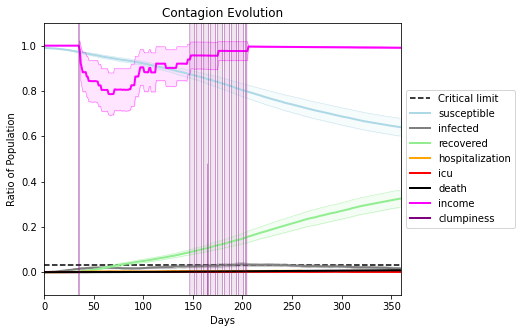

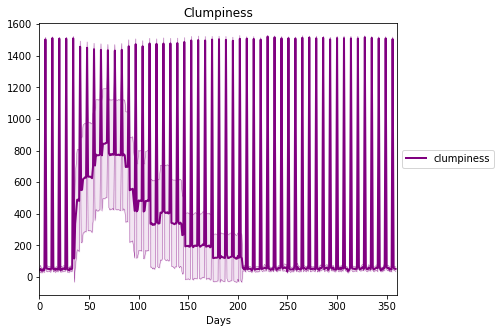

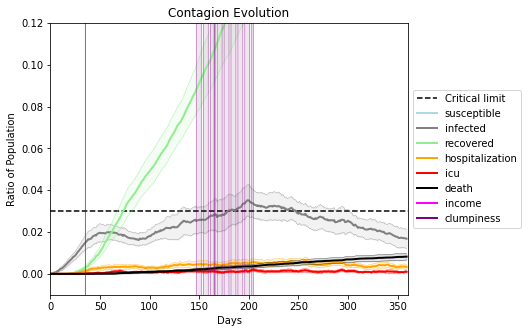

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[128, 9096, 6321, 4235, 9443, 2878, 3495, 6337, 1094, 1982, 9272, 9384, 9209, 9628, 2468, 3453, 3171, 6738, 7072, 4229]
Average similarity between family members is 0.25635370827918197 at temperature -0.5
Average similarity between family and home is 0.9998581512614902 at temperature -1
Average similarity between students and their classroom is 0.14749882545566845 at temperature -0.5
Average classroom occupancy is 1.5277777777777777 and number classrooms is 180
Average similarity between workers is 0.1646032793493232 at temperature -0.5
Average office occupancy is 3.3251231527093594 and number offices is 203
Average friend similarity for adults: 0.33106782621432235 for kids: 0.2154135047058116
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07954532603875311
avg restaurant similarity 0.3475936788180337
avg restaurant similarity 0.15873906829473672
avg restaurant similarity -0.5021176040747245
avg restaurant similarity 0.11758780861800339
avg restaurant similarity -0.016811692006327497
avg restaurant similarity 0.24536564289287618
avg restaurant similarity 0.024064180047094635
avg restaurant similarity 0.36081902627825546
avg restaurant similarity 0.158016026321256
avg restaurant similarity -0.07036288399617828
avg restaurant similarity 0.043907874335825034
avg restaurant similarity 0.3547673169582746
avg restaurant similarity 0.32719226777697874
avg restaurant similarity -0.22201084542496008
avg restaurant similarity -0.02327596757831149
avg restaurant similarity 0.07003314794928663
avg restaurant similarity 0.053780950636725874
avg restaurant similarity 0.41122655525539853
avg restaurant similarity -0.30062518791954074
avg restaurant similarity 0.020628681687910655
avg restaurant similarity 0.

avg restaurant similarity -0.026739885871403617
avg restaurant similarity 0.3462144838084841
avg restaurant similarity 0.15819633988193096
avg restaurant similarity 0.36282002131914853
avg restaurant similarity 0.016807234667662554
avg restaurant similarity 0.25531891513984856
avg restaurant similarity 0.5968108109297212
avg restaurant similarity -0.014522779103470985
avg restaurant similarity 0.45251810341760734
avg restaurant similarity -0.1443452353279033
avg restaurant similarity 0.3080430846293347
avg restaurant similarity 0.05661275193960013
avg restaurant similarity 0.05902045868348913
avg restaurant similarity 0.38784129203788437
avg restaurant similarity 0.295740824545222
avg restaurant similarity 0.23567192162398734
avg restaurant similarity -0.14772079771811253
avg restaurant similarity 0.548927834367585
avg restaurant similarity 0.34791427175555373
avg restaurant similarity -0.1443452353279033
avg restaurant similarity -0.0008376210345730634
avg restaurant similarity -0.117

avg restaurant similarity -0.018628775342143626
avg restaurant similarity 0.019881329519345296
avg restaurant similarity 0.4069063093359465
avg restaurant similarity 0.15559473448557928
avg restaurant similarity 0.06488812840432802
avg restaurant similarity -0.12064942171184502
avg restaurant similarity -0.2025401775002332
avg restaurant similarity -0.04510956465905849
avg restaurant similarity 0.18602362845794362
avg restaurant similarity 0.04135684135416216
avg restaurant similarity 0.15997142267136025
avg restaurant similarity 0.3680305684311686
avg restaurant similarity -0.11674724011881082
avg restaurant similarity -0.11717116021132531
avg restaurant similarity -0.14134785436097028
avg restaurant similarity 0.7036846350103099
avg restaurant similarity -0.015062696065343724
avg restaurant similarity -0.014659939772793198
avg restaurant similarity 0.12812071227806554
avg restaurant similarity -0.10690268269749417
avg restaurant similarity 0.02009498973608198
avg restaurant similarit

Average similarity between family and home is 0.999857428154381 at temperature -1
Average similarity between students and their classroom is 0.17044254434840203 at temperature -0.5
Average classroom occupancy is 1.5543478260869565 and number classrooms is 184
Average similarity between workers is 0.1783366594457808 at temperature -0.5
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.3353758345548282 for kids: 0.21230015571457406
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.42815020359100175
avg restaurant similarity 0.39597134045587673
avg restaurant similarity -0.09627459706635733
avg restaurant similarity -0.08120050495202524
avg restaurant similarity -0.08847019393914536
avg restaurant similarity -0.12923362193721283
avg restaurant similarity -0.07493950112397894
avg restaurant similarity -0.08842305860596661
avg restaurant similarity 0.48569622738073903
avg restaurant similarity 0.49885891915603997
avg restaurant similarity -0.375557986832713
avg restaurant similarity -0.05068554125787746
avg restaurant similarity 0.2521949538247392
avg restaurant similarity -0.3594885561532168
avg restaurant similarity 0.05391483646901944
avg restaurant similarity 0.12481609421490479
avg restaurant similarity -0.14975421080210607
avg restaurant similarity 0.40488331996767574
avg restaurant similarity 0.3166241278557106
avg restaurant similarity -0.3079237562471661
avg restaurant similarity 0.25802248962661267
avg restaurant similarity -0.

avg restaurant similarity -0.2309262313531564
avg restaurant similarity 0.10964039586398955
avg restaurant similarity 0.3124136940067489
avg restaurant similarity -0.2893071194323384
avg restaurant similarity -0.37207390929181716
avg restaurant similarity 0.5676667567249888
avg restaurant similarity -0.16999171389512693
avg restaurant similarity 0.2017946690449027
avg restaurant similarity 0.21180397887818364
avg restaurant similarity 0.36332939976195533
avg restaurant similarity 0.06939910475143987
avg restaurant similarity 0.027145408412644276
avg restaurant similarity 0.5324084106363713
avg restaurant similarity -0.6015593094576148
avg restaurant similarity 0.38749231313721433
avg restaurant similarity 0.19648941485625201
avg restaurant similarity 0.4354035549766681
avg restaurant similarity 0.18734452892297776
avg restaurant similarity 0.4579313136265263
avg restaurant similarity 0.13503500021478135
avg restaurant similarity 0.2713671075782642
avg restaurant similarity 0.0801405888

avg restaurant similarity 0.6249736101441258
avg restaurant similarity 0.08419598988391366
avg restaurant similarity 0.028725086031605857
avg restaurant similarity 0.12313448060958558
avg restaurant similarity 0.23456872560777198
avg restaurant similarity -0.32169544398178623
avg restaurant similarity 0.13436346171926106
avg restaurant similarity -0.07574606080204954
avg restaurant similarity -0.22079282387801147
avg restaurant similarity 0.05554658310183216
avg restaurant similarity 0.08594489503864682
avg restaurant similarity 0.0863774696074913
avg restaurant similarity 0.2396415484625589
avg restaurant similarity 0.2970680750085832
avg restaurant similarity -0.056429140221764276
avg restaurant similarity 0.007595297779135687
avg restaurant similarity 0.0062952339818681535
avg restaurant similarity -0.10374290600248973
avg restaurant similarity 0.07634420470510377
avg restaurant similarity 0.28939337474365767
Average similarity between family members is 0.2476238816166746 at tempera

avg restaurant similarity 0.19096618869326562
avg restaurant similarity 0.8074122982022509
avg restaurant similarity 0.2601315013147564
avg restaurant similarity 0.31298789534381305
avg restaurant similarity 0.6713384237609066
avg restaurant similarity 0.0891102017435194
avg restaurant similarity 0.337843769966391
avg restaurant similarity 0.31982741226311784
avg restaurant similarity -0.2581303123657096
avg restaurant similarity 0.524725958282803
avg restaurant similarity 0.21827686869273558
avg restaurant similarity -0.4626161251404474
avg restaurant similarity 0.3117639842274215
avg restaurant similarity 0.39692268904851763
avg restaurant similarity 0.23523875213014073
avg restaurant similarity 0.17580207531346997
avg restaurant similarity -0.25511936310954714
avg restaurant similarity -0.023800772394718908
avg restaurant similarity 0.29677371299745614
avg restaurant similarity 0.5682133633555653
avg restaurant similarity -0.3301526184789514
avg restaurant similarity -0.520596947639

avg restaurant similarity -0.3763582994809034
avg restaurant similarity 0.3790808948291139
avg restaurant similarity -0.06248109202784325
avg restaurant similarity -0.2337222659464695
avg restaurant similarity -0.022561337847043617
avg restaurant similarity 0.3123611831264185
avg restaurant similarity 0.1519002643628188
avg restaurant similarity 0.7811046724026706
avg restaurant similarity 0.21110659466269222
avg restaurant similarity -0.1307471164000687
avg restaurant similarity -0.21512991726235864
avg restaurant similarity 0.11282849621569731
avg restaurant similarity 0.05868560678399415
avg restaurant similarity -0.09208822182853027
avg restaurant similarity 0.32855854913278815
avg restaurant similarity -0.018599091261044767
avg restaurant similarity 0.06849178811484331
avg restaurant similarity 0.05461069675777551
avg restaurant similarity -0.04853210054354127
avg restaurant similarity -0.15639212629620067
avg restaurant similarity 0.2590582642436785
avg restaurant similarity -0.0

avg restaurant similarity 0.18261649829229556
avg restaurant similarity -0.06938418982055974
avg restaurant similarity -0.1921729618250388
avg restaurant similarity -0.044062254558207815
avg restaurant similarity 0.18220208425023626
avg restaurant similarity 0.48762735833799287
avg restaurant similarity 0.27669849491884596
avg restaurant similarity 0.007629804262571205
avg restaurant similarity -0.05061591179576926
avg restaurant similarity 0.33063241024583623
avg restaurant similarity -0.10645138636494578
avg restaurant similarity -0.13412099473574574
avg restaurant similarity -0.26554025132525233
avg restaurant similarity 0.2606891793867303
avg restaurant similarity -0.10645138636494578
avg restaurant similarity -0.32992002016282423
avg restaurant similarity 0.23006958679395667
avg restaurant similarity 0.10417024489665844
avg restaurant similarity -0.15743316036633645
avg restaurant similarity 0.16445570237650034
avg restaurant similarity 0.05189063913559609
avg restaurant similarit

Average similarity between family and home is 0.9998624336657489 at temperature -1
Average similarity between students and their classroom is 0.16052538627367893 at temperature -0.5
Average classroom occupancy is 1.575268817204301 and number classrooms is 186
Average similarity between workers is 0.1828469794862842 at temperature -0.5
Average office occupancy is 3.2060301507537687 and number offices is 199
Average friend similarity for adults: 0.31738939721311205 for kids: 0.2185685765894677
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity -0.003057183699056977
avg restaurant similarity -0.08431845864691821
avg restaurant similarity 0.09929130825982038
avg restaurant similarity -0.30666987220976916
avg restaurant similarity -0.20260120633144074
avg restaurant similarity 0.2594795066087471
avg restaurant similarity 0.21661828838748753
avg restaurant similarity 0.33093177073059177
avg restaurant similarity 0.18827943968552854
avg restaurant similarity 0.16542650962696792
avg restaurant similarity 0.1342808940350072
avg restaurant similarity 0.20580526234763702
avg restaurant similarity 0.306172297968422
avg restaurant similarity -0.14500987492594503
avg restaurant similarity -0.22064103699492893
avg restaurant similarity 0.20168849634294694
avg restaurant similarity 0.284901038690869
avg restaurant similarity -0.025879187123258013
avg restaurant similarity 0.31838828045691486
avg restaurant similarity -0.12194242139000003
avg restaurant similarity 0.15706615863848675
avg restaurant similarity 0.29

Average similarity between workers is 0.15724032954795447 at temperature -0.5
Average office occupancy is 3.388059701492537 and number offices is 201
Average friend similarity for adults: 0.33840536152203365 for kids: 0.22912190604589427
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.24895703159455765
avg restaurant similarity -0.0962971627857257
avg restaurant similarity 0.2560269423305313
avg restaurant similarity 0.23181800052409834
avg restaurant similarity -0.14671791389820726
avg restaurant similarity 0.01594768946137262
avg restaurant similarity -0.13324987888148837
avg restaurant similarity 0.06481241009529787
avg restaurant similarity 0.049939097579571164
avg restaurant similarity -0.009491689740697758
avg restaurant similarity 0.28584240264601546
avg restaurant similarity 0.35283088069581425
avg restaurant similarity 0.27907888411404325
avg restaurant similarity -0.04018678016393406
avg restaurant similarity -0.044079217061516185
avg restaurant similarity -0.21449012783061652
avg restaurant similarity -0.011250521903029942
avg restaurant similarity 0.12356759005662529
avg restaurant similarity 0.30744460567176807
avg restaurant similarity -0.16975709589336116
avg restaurant similarity 0.05272568578275147
avg restaurant similari

avg restaurant similarity 0.16573967386286376
avg restaurant similarity 0.25376253206972965
avg restaurant similarity 0.23836017009069438
avg restaurant similarity -0.13307368276586834
avg restaurant similarity 0.23836017009069438
avg restaurant similarity -0.361189214510168
avg restaurant similarity 0.15179214306854164
avg restaurant similarity 0.13231243030916431
avg restaurant similarity -0.11839883729297178
avg restaurant similarity 0.0006661265919799889
avg restaurant similarity 0.13825458811914185
avg restaurant similarity 0.0582801518028221
avg restaurant similarity 0.4193126690497914
avg restaurant similarity 0.04436755265098271
avg restaurant similarity 0.2368837914257482
avg restaurant similarity -0.10052362511976669
avg restaurant similarity -0.18291544628843204
Average similarity between family members is 0.23727714812085007 at temperature -0.5
Average similarity between family and home is 0.9998505851985974 at temperature -1
Average similarity between students and their cl

avg restaurant similarity 0.15235613673133092
avg restaurant similarity 0.2198551795877482
avg restaurant similarity -0.10249897366967084
avg restaurant similarity -0.43026571751796316
avg restaurant similarity 0.23351553686067195
avg restaurant similarity -0.14462455707860725
avg restaurant similarity -0.24420655234552394
avg restaurant similarity 0.21735521454293508
avg restaurant similarity -0.11056783555814925
avg restaurant similarity -0.036664447502736744
avg restaurant similarity -0.11894294107693781
avg restaurant similarity 0.15983683592129194
avg restaurant similarity 0.10989304052221963
avg restaurant similarity -0.21543221408408716
avg restaurant similarity -0.12674614784493196
avg restaurant similarity 0.07202668870856917
avg restaurant similarity -0.04383600406318923
avg restaurant similarity -0.19808254025595834
avg restaurant similarity -0.06368528772975787
avg restaurant similarity -0.40534648056389827
avg restaurant similarity 0.07208701498975928
avg restaurant simila

avg restaurant similarity 0.09837654144426271
avg restaurant similarity 0.13395529592612787
avg restaurant similarity 0.04480998273318984
avg restaurant similarity -0.012096584472020278
avg restaurant similarity 0.053627548448810104
avg restaurant similarity 0.25771873207692597
avg restaurant similarity -0.29152986986022744
avg restaurant similarity 0.27896879305798394
avg restaurant similarity -0.025528557682230224
avg restaurant similarity -0.06067297897224132
avg restaurant similarity 0.19659444861002667
avg restaurant similarity 0.010334633472627648
avg restaurant similarity 0.009501305711000357
avg restaurant similarity -0.03601550149507833
avg restaurant similarity -0.1678698041258906
Average similarity between family members is 0.24709319288797227 at temperature -0.5
Average similarity between family and home is 0.999856968867401 at temperature -1
Average similarity between students and their classroom is 0.15751918007591884 at temperature -0.5
Average classroom occupancy is 1.4

avg restaurant similarity 0.10920804968325006
avg restaurant similarity -0.36485354483421073
avg restaurant similarity 0.026362596758346363
avg restaurant similarity 0.2607027977710383
avg restaurant similarity 0.4411292470398126
avg restaurant similarity 0.28844633546676285
avg restaurant similarity -0.5051105276383444
avg restaurant similarity 0.21418461151673912
avg restaurant similarity 0.06417481765678862
avg restaurant similarity 0.026038966719225023
avg restaurant similarity 0.2546405537571675
avg restaurant similarity 0.20056778752272483
avg restaurant similarity 0.39270142061892244
avg restaurant similarity 0.44286606291801917
avg restaurant similarity -0.0070863701103231445
avg restaurant similarity -0.13452932281020716
avg restaurant similarity -0.04159441378484696
avg restaurant similarity 0.2052872862710781
avg restaurant similarity 0.20371400011621404
avg restaurant similarity 0.14780766469757833
avg restaurant similarity 0.747733770760382
avg restaurant similarity -0.311

avg restaurant similarity -0.002901745730619368
avg restaurant similarity 0.014864300194922075
avg restaurant similarity 0.07757054351331727
avg restaurant similarity 0.36538469521924216
avg restaurant similarity -0.18722126742571413
avg restaurant similarity 0.47216885259375185
avg restaurant similarity -0.008311085302386806
avg restaurant similarity 0.17720920531122716
avg restaurant similarity -0.061052336978470484
avg restaurant similarity 0.0036384787917692896
avg restaurant similarity 0.3868032086920007
avg restaurant similarity -0.00515985423256755
avg restaurant similarity -0.006897856038057426
avg restaurant similarity -0.14449728078078852
avg restaurant similarity -0.04844199216110183
avg restaurant similarity 0.004453713363372004
avg restaurant similarity -0.1949377007220078
avg restaurant similarity 0.07060940133093223
avg restaurant similarity 0.11972564303589843
avg restaurant similarity 0.5441721922595767
avg restaurant similarity 0.28972658795109185
avg restaurant simil

avg restaurant similarity 0.15593208901706387
avg restaurant similarity 0.18089218839540971
avg restaurant similarity 0.14397918907751334
avg restaurant similarity 0.19152588166530665
avg restaurant similarity 0.04494077158862229
avg restaurant similarity -0.2269634377943861
avg restaurant similarity 0.10415989161006545
avg restaurant similarity -0.01001054295042126
avg restaurant similarity 0.4806077868837224
avg restaurant similarity 0.42038406456821154
avg restaurant similarity 0.2510260001570232
avg restaurant similarity 0.243800973471426
avg restaurant similarity -0.10259802104416971
avg restaurant similarity 0.39826299289286315
avg restaurant similarity 0.03804893699119184
avg restaurant similarity 0.32010815149873684
avg restaurant similarity 0.011618554401283052
avg restaurant similarity 0.11363208919257557
avg restaurant similarity 0.43925143038975223
avg restaurant similarity 0.2009762538262666
avg restaurant similarity 0.1738813551915821
avg restaurant similarity 0.173374544

Average similarity between students and their classroom is 0.16216432422480748 at temperature -0.5
Average classroom occupancy is 1.5494505494505495 and number classrooms is 182
Average similarity between workers is 0.14899638483398794 at temperature -0.5
Average office occupancy is 3.291457286432161 and number offices is 199
Average friend similarity for adults: 0.3218571673757598 for kids: 0.21906314670961016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocate

avg restaurant similarity 0.08892906498439643
avg restaurant similarity 0.30366948874904265
avg restaurant similarity -0.16522077673133223
avg restaurant similarity 0.4952322009300567
avg restaurant similarity 0.10356070448240384
avg restaurant similarity 0.2091896581585691
avg restaurant similarity 0.29039626191917367
avg restaurant similarity 0.17278435135671533
avg restaurant similarity 0.07547574145221331
avg restaurant similarity -0.20621344453371426
avg restaurant similarity 0.13256255284426094
avg restaurant similarity -0.2705930944240409
avg restaurant similarity 0.013610745694630222
avg restaurant similarity -0.3174329402692345
avg restaurant similarity 0.026502474269977275
avg restaurant similarity -0.16522077673133223
avg restaurant similarity 0.21487481428646868
avg restaurant similarity 0.11273253443785325
avg restaurant similarity 0.49525269304953956
avg restaurant similarity -0.2775669336865142
avg restaurant similarity -0.01100680803292918
avg restaurant similarity -0.0

avg restaurant similarity 0.35841069158211997
avg restaurant similarity -0.028090084113076084
avg restaurant similarity 0.39670794328575204
avg restaurant similarity 0.06060774130309926
avg restaurant similarity 0.08736841356771041
avg restaurant similarity 0.5855660124949343
avg restaurant similarity 0.19871826306738452
avg restaurant similarity 0.03373033462637745
avg restaurant similarity 0.2327826506930805
avg restaurant similarity 0.2583725007289591
avg restaurant similarity 0.39068264771486055
avg restaurant similarity 0.3237604642796581
avg restaurant similarity -0.0037125402289514
avg restaurant similarity 0.008063420328814854
avg restaurant similarity 0.3291050781574288
avg restaurant similarity 0.10092792501409265
avg restaurant similarity -0.06230675242807615
avg restaurant similarity 0.2929543797158628
avg restaurant similarity -0.037266732840305426
avg restaurant similarity 0.2883076047896053
avg restaurant similarity 0.06060774130309926
avg restaurant similarity 0.2227729

avg restaurant similarity 0.19645312272514912
avg restaurant similarity -0.01274648386572591
avg restaurant similarity 0.1383450665196872
avg restaurant similarity -0.3613683619447215
avg restaurant similarity 0.049299159040716495
avg restaurant similarity 0.3630500631996189
Average similarity between family members is 0.26083343230832357 at temperature -0.5
Average similarity between family and home is 0.9998463460217448 at temperature -1
Average similarity between students and their classroom is 0.1595319133420218 at temperature -0.5
Average classroom occupancy is 1.5722543352601157 and number classrooms is 173
Average similarity between workers is 0.1688335373343384 at temperature -0.5
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.32580065958231447 for kids: 0.2132005136510799
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with 

avg restaurant similarity 0.016551145951793772
avg restaurant similarity 0.2275315423482826
avg restaurant similarity 0.07788783171971823
avg restaurant similarity -0.22247715512654542
avg restaurant similarity 0.25930891943396245
avg restaurant similarity -0.1280812057239456
avg restaurant similarity 0.040939541974745475
avg restaurant similarity 0.41755960853745844
avg restaurant similarity -0.03782317218843445
avg restaurant similarity 0.3670897077804244
avg restaurant similarity 0.17043073288714514
avg restaurant similarity -0.05340628177604291
avg restaurant similarity -0.13576057329321878
avg restaurant similarity -0.22258538632458827
avg restaurant similarity 0.4309423583083215
avg restaurant similarity -0.557563411671023
avg restaurant similarity 0.3654410946530231
avg restaurant similarity 0.06339868644136645
avg restaurant similarity 0.37560945985944083
avg restaurant similarity -0.12317464806567885
avg restaurant similarity 0.039521727465688966
avg restaurant similarity -0.5

avg restaurant similarity -0.008478603697912972
avg restaurant similarity -0.31455768972908055
avg restaurant similarity 0.04263460742350328
avg restaurant similarity 0.09990264330197904
avg restaurant similarity 0.08262241698708025
avg restaurant similarity -0.28270370252747945
avg restaurant similarity -0.09861225101712426
avg restaurant similarity -0.0038000549088091293
avg restaurant similarity 0.24082868462330106
avg restaurant similarity 0.3039895074871183
avg restaurant similarity 0.07788036425351805
avg restaurant similarity 0.08922279498254249
avg restaurant similarity -0.12058459164999107
avg restaurant similarity -0.3117350530527908
avg restaurant similarity 0.18176349307795064
avg restaurant similarity 0.44661951213277185
avg restaurant similarity 0.36976692805900635
avg restaurant similarity -0.21030502839734344
avg restaurant similarity 0.05218745624141106
avg restaurant similarity 0.26873338508421574
avg restaurant similarity -0.06659072784707781
avg restaurant similarit

avg restaurant similarity 0.9997142676126702
avg restaurant similarity 0.31597366986260134
avg restaurant similarity 0.29078112634125425
avg restaurant similarity 0.10138407913257948
avg restaurant similarity -0.13674109058551784
avg restaurant similarity 0.3416504136087005
avg restaurant similarity 0.23180183078950808
avg restaurant similarity 0.030660665436317458
avg restaurant similarity 0.136707669666978
avg restaurant similarity 0.1491841431229438
avg restaurant similarity 0.020381255112515907
avg restaurant similarity -0.317145424686826
avg restaurant similarity -0.49385892402188486
avg restaurant similarity 0.1192293696209492
avg restaurant similarity 0.06062972854799223
avg restaurant similarity -0.04286761525641175
avg restaurant similarity 0.2443522410457023
avg restaurant similarity -0.07812744377143843
avg restaurant similarity -0.12202856646550961
avg restaurant similarity 0.10423636206385423
avg restaurant similarity 0.20548560054889933
avg restaurant similarity 0.1861792

avg restaurant similarity 0.05767603106901638
avg restaurant similarity 0.37466735358771763
avg restaurant similarity 0.2857827937441231
avg restaurant similarity -0.1920736468531009
avg restaurant similarity 0.23949976621217664
avg restaurant similarity 0.005857185138421678
avg restaurant similarity -0.20612965558065113
avg restaurant similarity 0.1371799226584902
avg restaurant similarity -0.25296455018158837
avg restaurant similarity 0.15753927271250626
avg restaurant similarity 0.19371595805312208
avg restaurant similarity -0.0834315304833065
avg restaurant similarity 0.06791271303581445
avg restaurant similarity -0.06323388141245931
avg restaurant similarity -0.07442554381745672
avg restaurant similarity -0.11503380558340276
avg restaurant similarity -0.06323388141245931
avg restaurant similarity -0.0491495706111272
avg restaurant similarity 0.3850303073046615
avg restaurant similarity 0.20003445973730177
avg restaurant similarity 0.16245550441267925
avg restaurant similarity 0.07

avg restaurant similarity -0.26581729754938427
avg restaurant similarity -0.4414737237188425
avg restaurant similarity -0.25257020466162095
avg restaurant similarity -0.07471353043091936
avg restaurant similarity -0.2664104408996198
avg restaurant similarity -0.20612965558065113
avg restaurant similarity 0.25460128536329096
avg restaurant similarity 0.0752519087185278
avg restaurant similarity 0.057575326832699975
avg restaurant similarity -0.20740347294034717
avg restaurant similarity 0.009566700304477052
avg restaurant similarity -0.10054766016752377
avg restaurant similarity -0.15423579184225622
Average similarity between family members is 0.24632935330845487 at temperature -0.5
Average similarity between family and home is 0.9998515574493004 at temperature -1
Average similarity between students and their classroom is 0.1729465060822102 at temperature -0.5
Average classroom occupancy is 1.7027027027027026 and number classrooms is 185
Average similarity between workers is 0.166480064

avg restaurant similarity 0.4560970604129662
avg restaurant similarity 0.04202110993321814
avg restaurant similarity -0.24053600916542534
avg restaurant similarity 0.12809069539995788
avg restaurant similarity 0.13085872814634938
avg restaurant similarity 0.24191835771568876
avg restaurant similarity -0.04909421742441615
avg restaurant similarity 0.41056667251398987
avg restaurant similarity -0.23350540816116866
avg restaurant similarity -0.19526876602600618
avg restaurant similarity -0.07760770257960936
avg restaurant similarity 0.28723350129263564
avg restaurant similarity 0.21857321750990205
avg restaurant similarity 0.08309920816533098
avg restaurant similarity 0.053962550165413556
avg restaurant similarity 0.031849884734598335
avg restaurant similarity -0.01987137740104137
avg restaurant similarity -0.08072015438704039
avg restaurant similarity 0.14111417339610957
avg restaurant similarity 0.06941456203023275
avg restaurant similarity 0.36270064471796415
avg restaurant similarity 

avg restaurant similarity -0.07800325991508089
avg restaurant similarity 0.26962227618780216
avg restaurant similarity 0.07890883142672084
avg restaurant similarity 0.34801531613133446
avg restaurant similarity -0.2114305510763374
avg restaurant similarity 0.25720564501224713
avg restaurant similarity 0.3632557372163025
avg restaurant similarity 0.30537578278854355
avg restaurant similarity 0.4628237472097528
avg restaurant similarity 0.38968157862417274
avg restaurant similarity 0.07744849153943295
avg restaurant similarity 0.3209815855210053
avg restaurant similarity 0.37429608452240215
avg restaurant similarity 0.6123035538220607
avg restaurant similarity 0.031849884734598335
avg restaurant similarity -1.8619052233763422e-05
avg restaurant similarity 0.34135905773851655
avg restaurant similarity 0.07890883142672084
avg restaurant similarity 0.5486406834429944
avg restaurant similarity 0.34090590704808454
avg restaurant similarity 0.21181409196377277
avg restaurant similarity 0.17993

avg restaurant similarity -0.0895980819303119
avg restaurant similarity -0.023989702460019188
avg restaurant similarity 0.03121399269057412
avg restaurant similarity -0.2159794584757947
avg restaurant similarity 0.4537346643673702
avg restaurant similarity -0.16048815661153068
avg restaurant similarity -0.017604003016533212
avg restaurant similarity -0.08896129101805031
avg restaurant similarity -0.592602272007866
avg restaurant similarity -0.025684184983706553
avg restaurant similarity 0.39738579594482903
avg restaurant similarity 0.0741729507635363
avg restaurant similarity 0.030479553750412156
avg restaurant similarity -0.012010493981846795
avg restaurant similarity 0.18535224318287874
avg restaurant similarity 0.08269817783789957
avg restaurant similarity 0.21384015393679762
avg restaurant similarity 0.19442939321275063
avg restaurant similarity -0.2190500282253217
avg restaurant similarity -0.12997972006797215
avg restaurant similarity -0.29203459911734264
avg restaurant similarit

avg restaurant similarity 0.21213366800807715
avg restaurant similarity -0.017993692800715957
avg restaurant similarity 0.3614165422251323
avg restaurant similarity -0.06701914446085733
avg restaurant similarity -0.06908818947958306
avg restaurant similarity -0.010208592697145899
avg restaurant similarity 0.3392476064156167
avg restaurant similarity 0.23681077566335157
avg restaurant similarity 0.07104740088685257
avg restaurant similarity -0.033466381401306505
avg restaurant similarity 0.2374049274853182
avg restaurant similarity 0.4652849339390191
avg restaurant similarity 0.11300797773626166
avg restaurant similarity 0.2537218908938504
avg restaurant similarity 0.012641070420386896
avg restaurant similarity 0.10510742827045735
avg restaurant similarity -0.020073857040486254
avg restaurant similarity -0.058209218632273296
avg restaurant similarity -0.08306144856542542
avg restaurant similarity -0.4387739363720116
avg restaurant similarity -0.07247674019207181
avg restaurant similarit

(<function dict.items>, <function dict.items>, <function dict.items>)

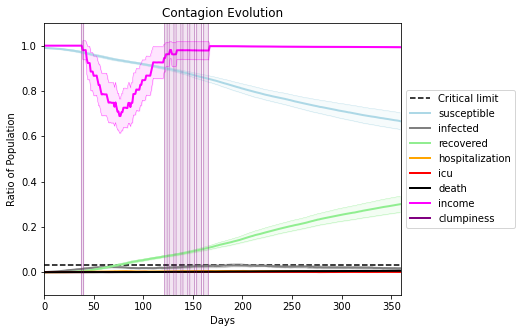

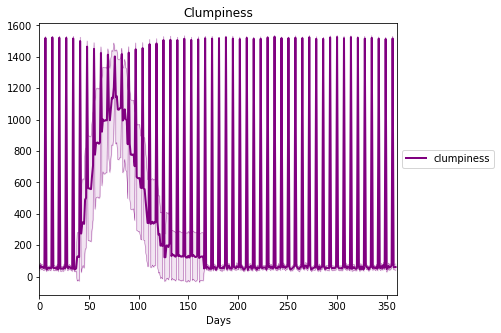

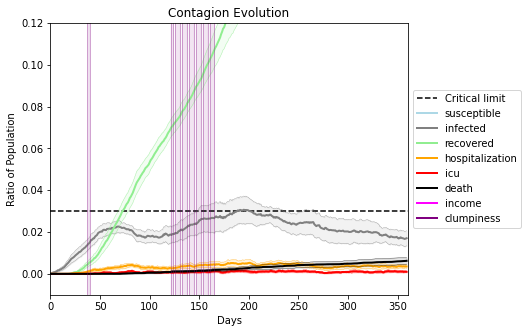

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4682, 1984, 702, 332, 8810, 1722, 9998, 8512, 2057, 7210, 9410, 7373, 8683, 8006, 9411, 6629, 3943, 3661, 5831, 7269]
Average similarity between family members is 0.22366735228445098 at temperature -0.4
Average similarity between family and home is 0.9998501319981188 at temperature -1
Average similarity between students and their classroom is 0.17517424947179833 at temperature -0.4
Average classroom occupancy is 1.6114285714285714 and number classrooms is 175
Average similarity between workers is 0.14529074575682713 at temperature -0.4
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.28315992986654565 for kids: 0.22418117289574002
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.0578999420930254
avg restaurant similarity 0.03036427991634774
avg restaurant similarity 0.46088435827270813
avg restaurant similarity 0.33365961595356214
avg restaurant similarity -0.22458563272873078
avg restaurant similarity -0.1004809294685948
avg restaurant similarity -0.06703115112774374
avg restaurant similarity 0.45571401645278564
avg restaurant similarity -0.009255682530716566
avg restaurant similarity 0.09887746992128715
avg restaurant similarity 0.13091963964312744
avg restaurant similarity -0.10477889110609491
avg restaurant similarity -0.2769320745469698
avg restaurant similarity -0.0049556885923316
avg restaurant similarity -0.3243804224471917
avg restaurant similarity -0.21739126352366817
avg restaurant similarity -0.13290196358860834
avg restaurant similarity 0.17164415607805805
avg restaurant similarity 0.08508658271525568
avg restaurant similarity -0.13290196358860834
avg restaurant similarity 0.3275117953598186
avg restaurant similarity 0.

Average similarity between family and home is 0.9998464153695341 at temperature -1
Average similarity between students and their classroom is 0.14079469674184178 at temperature -0.4
Average classroom occupancy is 1.5454545454545454 and number classrooms is 165
Average similarity between workers is 0.14513707743475263 at temperature -0.4
Average office occupancy is 3.3497536945812807 and number offices is 203
Average friend similarity for adults: 0.2860099809693483 for kids: 0.2049778264993085
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.08999523922695209
avg restaurant similarity 0.07894717127740725
avg restaurant similarity 0.16288551583630753
avg restaurant similarity -0.32994390833980647
avg restaurant similarity 0.12945700395968412
avg restaurant similarity 0.533321818829489
avg restaurant similarity 0.24168963316334324
avg restaurant similarity 0.2831812425256431
avg restaurant similarity 0.4664300381884732
avg restaurant similarity 0.06756074649176169
avg restaurant similarity -0.4022463856373475
avg restaurant similarity 0.24041944208087324
avg restaurant similarity 0.13282549766736546
avg restaurant similarity 0.2831812425256431
avg restaurant similarity 0.24126181516107043
avg restaurant similarity 0.18849858451885226
avg restaurant similarity 0.039327571011329845
avg restaurant similarity -0.013029558150057421
avg restaurant similarity -0.24596025508793595
avg restaurant similarity 0.08566193577583897
avg restaurant similarity -0.28244006332337945
avg restaurant similarity 0.08566

avg restaurant similarity 0.05131380711598344
avg restaurant similarity 0.2501454025403714
avg restaurant similarity 0.06682966831609591
avg restaurant similarity 0.05214651895518388
avg restaurant similarity -0.2596285352931037
avg restaurant similarity 0.20169015489907857
avg restaurant similarity -0.19143275877884267
avg restaurant similarity 0.3139063230770459
Average similarity between family members is 0.21558229593111172 at temperature -0.4
Average similarity between family and home is 0.9998580952112913 at temperature -1
Average similarity between students and their classroom is 0.15909674620432707 at temperature -0.4
Average classroom occupancy is 1.803370786516854 and number classrooms is 178
Average similarity between workers is 0.12570489500339532 at temperature -0.4
Average office occupancy is 3.1522842639593907 and number offices is 197
Average friend similarity for adults: 0.2722648832050095 for kids: 0.21980003092985562
home_districts
[
Home (0,0) district with 1 Buildi

avg restaurant similarity -0.01749094785215424
avg restaurant similarity -0.11117656203056313
avg restaurant similarity 0.05750976679428023
avg restaurant similarity 0.2863034532492318
avg restaurant similarity -0.059182229844622264
avg restaurant similarity 0.022926917765642596
avg restaurant similarity 0.31969591577771606
avg restaurant similarity 0.3612791117985085
avg restaurant similarity 0.068087903968219
avg restaurant similarity 0.04862575150255281
avg restaurant similarity -0.10255794077118241
avg restaurant similarity 0.46026911011899346
avg restaurant similarity 0.16891274769095738
avg restaurant similarity 0.21618401583739988
avg restaurant similarity 0.1167383568501032
avg restaurant similarity 0.06627260806874416
avg restaurant similarity -0.11708047068808647
avg restaurant similarity 0.18717317824649213
avg restaurant similarity 0.05629730292850502
avg restaurant similarity 0.14376811456139837
avg restaurant similarity 0.16690709060780518
avg restaurant similarity -0.137

Average similarity between workers is 0.15881171250598855 at temperature -0.4
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.28751982748923033 for kids: 0.20677536309066133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 1

avg restaurant similarity 0.07846431410582805
avg restaurant similarity 0.20318340312532554
avg restaurant similarity 0.19973550056008116
avg restaurant similarity -0.4021406939873576
avg restaurant similarity -0.10022442772569642
avg restaurant similarity 0.6376493007427066
avg restaurant similarity -0.1483444910043259
avg restaurant similarity 0.008855266943845384
avg restaurant similarity 0.117681753800705
avg restaurant similarity 0.16130975386014726
avg restaurant similarity 0.1937439258953616
avg restaurant similarity 0.4396077987574015
avg restaurant similarity 0.782672411725866
avg restaurant similarity 0.11889472559493044
avg restaurant similarity 0.5133020107163366
avg restaurant similarity 0.13785299684644386
avg restaurant similarity 0.117681753800705
avg restaurant similarity 0.4341751705676006
avg restaurant similarity -0.03777006698380406
avg restaurant similarity -0.2637257932439596
avg restaurant similarity 0.2911092916386099
avg restaurant similarity 0.276775373657798

avg restaurant similarity 0.026590093656163813
avg restaurant similarity -0.3958097288951441
avg restaurant similarity 0.21118250877769681
avg restaurant similarity -0.2637257932439596
avg restaurant similarity 0.14869737774612757
avg restaurant similarity -0.21416871549707686
avg restaurant similarity -0.09070317015253511
avg restaurant similarity 0.19973550056008116
avg restaurant similarity -0.023802233395689078
avg restaurant similarity -0.2490364442607929
avg restaurant similarity 0.025870034939748245
avg restaurant similarity 0.15270297013791292
avg restaurant similarity 0.20318340312532554
avg restaurant similarity -0.28690625183489843
avg restaurant similarity 0.6037344359140087
avg restaurant similarity -0.2769637206576901
avg restaurant similarity -0.2490364442607929
avg restaurant similarity -0.2490364442607929
avg restaurant similarity -0.19246678555048666
avg restaurant similarity -0.6230826035334173
avg restaurant similarity -0.1850835056600477
avg restaurant similarity -

avg restaurant similarity -0.01649213036561885
avg restaurant similarity -0.30614599380726615
avg restaurant similarity 0.24676851402178018
avg restaurant similarity 0.4973367326575585
avg restaurant similarity -0.01014841116488871
avg restaurant similarity 0.2879915998248039
avg restaurant similarity 0.10818220437435852
avg restaurant similarity -0.3738511737067701
avg restaurant similarity -0.21004714654843715
avg restaurant similarity -0.14288295603678744
avg restaurant similarity -0.23526545101748886
avg restaurant similarity 0.21020046448371627
avg restaurant similarity -0.16581203647466722
avg restaurant similarity 0.08398862209707289
avg restaurant similarity 0.2532932532419743
avg restaurant similarity 0.36760850460294575
avg restaurant similarity 0.5633735957126231
avg restaurant similarity -0.02200476009442906
avg restaurant similarity -0.05255722772685385
avg restaurant similarity -0.0024001921083668665
avg restaurant similarity 0.27137813955214485
avg restaurant similarity 

avg restaurant similarity 0.13332277765733347
avg restaurant similarity 0.34037865759161057
avg restaurant similarity 0.24617568401956866
avg restaurant similarity 0.08982476769848528
avg restaurant similarity 0.21373475303059078
avg restaurant similarity -0.007679039638643359
avg restaurant similarity 0.021414309489313818
avg restaurant similarity 0.11678742537386505
avg restaurant similarity -0.125220431888859
avg restaurant similarity 0.11625455064281916
avg restaurant similarity 0.12317170345653901
avg restaurant similarity 0.3469680461590882
avg restaurant similarity 0.5418745756885459
avg restaurant similarity 0.23529578716600644
avg restaurant similarity 0.2609411478159723
avg restaurant similarity -0.05872948692447279
avg restaurant similarity -0.2573467092460689
avg restaurant similarity 0.10225083511906978
avg restaurant similarity 0.1538939823093088
avg restaurant similarity -0.16983694018677675
avg restaurant similarity -0.42685885758024733
avg restaurant similarity -0.0743

avg restaurant similarity 0.3118783720167444
avg restaurant similarity -0.1119657904043754
avg restaurant similarity 0.06487519441994019
avg restaurant similarity 0.21082819629187188
avg restaurant similarity -0.2465999447777609
avg restaurant similarity -0.10574675592006247
avg restaurant similarity 0.5195044776827581
avg restaurant similarity -0.13328277398938734
avg restaurant similarity 0.075272341645436
avg restaurant similarity 0.3258199316894968
avg restaurant similarity 0.020841331740100583
avg restaurant similarity 0.39779649781299387
avg restaurant similarity 0.3128365716788619
avg restaurant similarity 0.13794342123135186
avg restaurant similarity 0.07389273299919036
avg restaurant similarity 0.157157314958057
avg restaurant similarity -0.15185612734480172
avg restaurant similarity -0.03668196630142475
avg restaurant similarity 0.41556596556211145
avg restaurant similarity 0.0599565448676293
avg restaurant similarity 0.33027912275513327
avg restaurant similarity 0.2568527701

avg restaurant similarity 0.12900260824173881
avg restaurant similarity 0.24261813485560885
avg restaurant similarity -0.04459518601340376
avg restaurant similarity 0.0407456593011335
avg restaurant similarity -0.03866325649275737
avg restaurant similarity -0.24452665478948443
avg restaurant similarity -0.16611769620833305
avg restaurant similarity -0.025632230269527087
avg restaurant similarity -0.3157373890454124
avg restaurant similarity 0.05355046641757452
avg restaurant similarity -0.144265813056851
avg restaurant similarity 0.22341207851442207
avg restaurant similarity -0.20699167591192966
avg restaurant similarity 0.09348534396460437
avg restaurant similarity -0.2325528430383243
avg restaurant similarity -0.3516421176836417
avg restaurant similarity 0.25674169622648535
avg restaurant similarity 0.19236538552070725
avg restaurant similarity -0.0017203359433544396
avg restaurant similarity 0.005166170843690629
avg restaurant similarity 0.06598594646458074
avg restaurant similarity

Average friend similarity for adults: 0.28813577113528654 for kids: 0.2196784514219968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 alloca

avg restaurant similarity 0.10574406500645597
avg restaurant similarity 0.22007812854337488
avg restaurant similarity 0.02871234875973902
avg restaurant similarity -0.11046498809234052
avg restaurant similarity -0.138628901054673
avg restaurant similarity -0.10902262014826147
avg restaurant similarity 0.21799288067775485
avg restaurant similarity 0.34641094112469045
avg restaurant similarity 0.47138490679607037
avg restaurant similarity 0.21852233845812613
avg restaurant similarity 0.0760710650203828
avg restaurant similarity 0.04876149312691895
avg restaurant similarity 0.12522866248902656
avg restaurant similarity 0.18743528537980275
avg restaurant similarity 0.40174743653018086
avg restaurant similarity 0.28291949794472354
avg restaurant similarity 0.018038226280281483
avg restaurant similarity 0.16430490943386447
avg restaurant similarity 0.1693611249862055
avg restaurant similarity -0.015059690172463891
avg restaurant similarity 0.5102568040984014
avg restaurant similarity 0.09193

avg restaurant similarity -0.004613623215199758
avg restaurant similarity 0.30515233583114376
avg restaurant similarity 0.2651494506443938
avg restaurant similarity 0.35298283103342065
avg restaurant similarity -0.24141178685385417
avg restaurant similarity -0.261416821387074
avg restaurant similarity 0.3055604231358744
avg restaurant similarity 0.18126588363394291
avg restaurant similarity -0.1147448768549032
avg restaurant similarity 0.3680010191483326
avg restaurant similarity 0.5664808305443478
avg restaurant similarity 0.039425793210391254
avg restaurant similarity 0.19812409065852415
avg restaurant similarity 0.4767678822094085
avg restaurant similarity -0.04076561236267198
avg restaurant similarity 0.23286525112806278
avg restaurant similarity 0.07388906165997013
avg restaurant similarity 0.36124709669746674
avg restaurant similarity 0.16935368755316196
avg restaurant similarity 0.16066211559536767
avg restaurant similarity 0.28348405710206415
avg restaurant similarity 0.2461707

avg restaurant similarity 0.16740099393291943
avg restaurant similarity -0.1474873968945202
avg restaurant similarity 0.4509608720027606
avg restaurant similarity 0.1120300677443218
avg restaurant similarity -0.17291816637595375
avg restaurant similarity 0.02203587672060254
avg restaurant similarity -0.0874711717619924
avg restaurant similarity -0.022138703907541787
avg restaurant similarity 0.1115026865566708
avg restaurant similarity 0.15163894855777688
avg restaurant similarity 0.3472234264191574
avg restaurant similarity 0.16811829281366666
avg restaurant similarity -0.13316854560062313
avg restaurant similarity 0.3165915585497369
avg restaurant similarity -0.2778334326684367
avg restaurant similarity 0.2304977552333638
avg restaurant similarity 0.3234378013627141
avg restaurant similarity 0.4485448366738336
avg restaurant similarity -0.03392719897318586
avg restaurant similarity -0.1265973543049335
avg restaurant similarity 0.024510304784927696
avg restaurant similarity -0.0301083

avg restaurant similarity -0.17291816637595375
avg restaurant similarity 0.2742817609302419
avg restaurant similarity 0.052665286517939704
avg restaurant similarity -0.2468981353743832
avg restaurant similarity 0.2677707852651684
avg restaurant similarity -0.0691044256001174
avg restaurant similarity -0.049688521201248094
avg restaurant similarity -0.2621202358492606
avg restaurant similarity 0.26806641034166334
avg restaurant similarity -0.10182709067860726
avg restaurant similarity 0.3680011067816353
avg restaurant similarity 0.11116592763981058
avg restaurant similarity 0.13142029242532377
avg restaurant similarity 0.2856206658543001
avg restaurant similarity 0.13803032108071808
avg restaurant similarity 0.12764793212990383
avg restaurant similarity 0.15915586568187334
avg restaurant similarity 0.2152772460722883
avg restaurant similarity 0.19759986821763142
avg restaurant similarity 0.12304995399004583
avg restaurant similarity 0.4485448366738336
avg restaurant similarity 0.2755480

avg restaurant similarity 0.14096575644204487
avg restaurant similarity -0.07037297068122211
avg restaurant similarity 0.12056503764912666
avg restaurant similarity -0.044000859098441994
avg restaurant similarity -0.15058491046480849
avg restaurant similarity 0.06446011898274262
avg restaurant similarity 0.20033811948361108
avg restaurant similarity 0.04133019707171168
avg restaurant similarity 0.5512557163148215
avg restaurant similarity 0.16422139950002174
avg restaurant similarity 0.2518852027445777
avg restaurant similarity -0.08514997219475134
avg restaurant similarity 0.031003029061631306
avg restaurant similarity -0.40186776782066824
avg restaurant similarity 0.24694299034766565
avg restaurant similarity 0.6338925415845967
avg restaurant similarity -0.06390058850947233
avg restaurant similarity 0.19839070846854268
avg restaurant similarity -0.48130779572397236
avg restaurant similarity 0.4262321075102211
avg restaurant similarity 0.08715075061474488
avg restaurant similarity 0.1

avg restaurant similarity -0.16028450488640797
avg restaurant similarity -0.1326285229560572
avg restaurant similarity -0.0409045680205892
avg restaurant similarity 0.021966257153322316
avg restaurant similarity 0.1972525288710695
avg restaurant similarity -0.4407882021841788
avg restaurant similarity 0.17974243945177057
avg restaurant similarity -0.02586377112433013
avg restaurant similarity 0.03687478474695936
avg restaurant similarity 0.2985243749635831
avg restaurant similarity 0.16146436090297162
avg restaurant similarity 0.029641896903722015
avg restaurant similarity -0.07925829482740743
avg restaurant similarity 0.30349729207556736
avg restaurant similarity 0.033528901967277536
avg restaurant similarity -0.32049728616907314
avg restaurant similarity 0.10043183336055217
avg restaurant similarity 0.257332282458018
avg restaurant similarity -0.07925829482740743
avg restaurant similarity -0.031843812315668095
avg restaurant similarity -0.21382011707551804
avg restaurant similarity 0

avg restaurant similarity -0.1599885092665531
avg restaurant similarity 0.06350618081183526
avg restaurant similarity -0.1666801487346754
avg restaurant similarity 0.0678765152868549
avg restaurant similarity 0.6776207195217453
avg restaurant similarity 0.1534570113141866
avg restaurant similarity 0.18163215874673627
avg restaurant similarity 0.2200380277450106
avg restaurant similarity 0.2114501548487317
avg restaurant similarity 0.025690509799370237
avg restaurant similarity 0.149292115899899
avg restaurant similarity 0.6767415934441341
avg restaurant similarity 0.10413330597489817
avg restaurant similarity -0.20066590572831802
avg restaurant similarity -0.03529551639668552
avg restaurant similarity -0.4142802814287251
avg restaurant similarity -0.06700568837603907
avg restaurant similarity 0.13920114931500302
avg restaurant similarity -0.16074881321815515
avg restaurant similarity 0.15104434614380868
avg restaurant similarity -0.025612299690725523
avg restaurant similarity -0.056148

Average similarity between family members is 0.20961873589316155 at temperature -0.4
Average similarity between family and home is 0.9998517946504467 at temperature -1
Average similarity between students and their classroom is 0.16529827353606627 at temperature -0.4
Average classroom occupancy is 1.5654450261780104 and number classrooms is 191
Average similarity between workers is 0.16122208324944876 at temperature -0.4
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.2826229159127887 for kids: 0.21266380573539873
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.08024384379731117
avg restaurant similarity -0.20594495510442432
avg restaurant similarity -0.07402478884441738
avg restaurant similarity -0.23745910962465427
avg restaurant similarity 0.5455091469890087
avg restaurant similarity 0.017524348268487623
avg restaurant similarity 0.059310572667967916
avg restaurant similarity 0.2188678064132549
avg restaurant similarity 0.2113989654629152
avg restaurant similarity -0.21740857196477126
avg restaurant similarity -0.07493325350317684
avg restaurant similarity -0.07961952880282647
avg restaurant similarity 0.1214889500300371
avg restaurant similarity 0.06387774911688947
avg restaurant similarity -0.07722109741929252
avg restaurant similarity 0.5150742908952167
avg restaurant similarity 0.20529971552595289
avg restaurant similarity -0.03359319329181035
avg restaurant similarity 0.035224180342749295
avg restaurant similarity 0.1512656846493809
avg restaurant similarity 0.039243365695270586
avg restaurant similarity 0.

avg restaurant similarity 0.29733481348820623
avg restaurant similarity -0.1459074034411207
avg restaurant similarity -0.251864093786058
avg restaurant similarity 0.1178919513485151
avg restaurant similarity 0.04608514678012678
avg restaurant similarity -0.102808822114096
avg restaurant similarity 0.4361409973470119
avg restaurant similarity 0.2613286572655251
avg restaurant similarity 0.14422503689849495
avg restaurant similarity -0.4954685728939504
avg restaurant similarity 0.5669392449321908
avg restaurant similarity 0.2446819328395931
avg restaurant similarity 0.23154402345574365
avg restaurant similarity -0.016121091984218693
avg restaurant similarity -0.0712357533018444
avg restaurant similarity 0.08221779898162035
avg restaurant similarity 0.15594809357470318
avg restaurant similarity -0.03645885386723388
avg restaurant similarity 0.1755101113284527
avg restaurant similarity 0.3712245587196702
avg restaurant similarity 0.3463426177275428
avg restaurant similarity 0.1156966315755

avg restaurant similarity 0.13516841352529071
avg restaurant similarity -0.17000331001317592
avg restaurant similarity 0.3256664625604082
avg restaurant similarity 0.25619217646271936
avg restaurant similarity 0.2371415350478965
avg restaurant similarity 0.06316778040659425
avg restaurant similarity -0.10731577201846129
avg restaurant similarity -0.11767141972027759
avg restaurant similarity 0.2323775539771922
avg restaurant similarity 0.5466853748078004
avg restaurant similarity 0.050343885542256925
avg restaurant similarity 0.19437060644518023
avg restaurant similarity 0.09538900374175076
avg restaurant similarity -0.0578174668931446
avg restaurant similarity 0.3442183346974874
avg restaurant similarity 0.5164824249015001
avg restaurant similarity 0.38307154127150156
avg restaurant similarity -0.25127528914748604
avg restaurant similarity -0.11649970448927706
avg restaurant similarity 0.28550149958094145
avg restaurant similarity -0.14709466612341834
avg restaurant similarity -0.1231

avg restaurant similarity 0.251162313973139
avg restaurant similarity -0.015638571461278408
avg restaurant similarity 0.3651147017343806
avg restaurant similarity 0.05118473542278144
avg restaurant similarity 0.14304557334758228
avg restaurant similarity 0.0006569659001221251
avg restaurant similarity 0.12269786150047438
avg restaurant similarity 0.004378739214406321
avg restaurant similarity -0.08436777330475456
avg restaurant similarity 0.24123073887737134
avg restaurant similarity 0.18504237393749962
avg restaurant similarity 0.05882194630667539
avg restaurant similarity 0.1331064079144489
avg restaurant similarity -0.1555771549919871
avg restaurant similarity 0.16062361055943344
avg restaurant similarity -0.011848096488912205
avg restaurant similarity 0.21359804738399366
avg restaurant similarity 0.07104610808728204
avg restaurant similarity -0.3691229579985641
avg restaurant similarity 0.11751744753145532
avg restaurant similarity 0.12712895841286231
avg restaurant similarity 0.16

Average similarity between workers is 0.15707444432641673 at temperature -0.4
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.28742926694969095 for kids: 0.21579591943695398
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity -0.0486663535391329
avg restaurant similarity 0.10221148238704039
avg restaurant similarity -0.010856923354533962
avg restaurant similarity -0.06901264352818934
avg restaurant similarity 0.04008603973472102
avg restaurant similarity 0.008745483611041827
avg restaurant similarity 0.24769965681712455
avg restaurant similarity -0.054557383457509365
avg restaurant similarity 0.14206693406182205
avg restaurant similarity -0.28183874441462614
avg restaurant similarity -0.13965074114348713
avg restaurant similarity -0.017360779455660558
avg restaurant similarity 0.05158218281426721
avg restaurant similarity 0.1341217903317421
avg restaurant similarity -0.004630725516064554
avg restaurant similarity -0.15759935379076986
avg restaurant similarity -0.012755118097980744
avg restaurant similarity 0.0037067019742222374
avg restaurant similarity -0.06716548180070478
avg restaurant similarity -0.3422637931899046
avg restaurant similarity -0.03414975444693802
avg restaurant s

avg restaurant similarity 0.06000576940495725
avg restaurant similarity 0.27886556162116755
avg restaurant similarity 0.02735933216632279
avg restaurant similarity 0.5018936365342584
avg restaurant similarity -0.16607180646499287
avg restaurant similarity -0.2416927628679502
avg restaurant similarity -0.25761331061178533
avg restaurant similarity 0.6196522029005953
avg restaurant similarity -0.01761485871745749
avg restaurant similarity -0.30721412628346884
avg restaurant similarity -0.07169894096191161
avg restaurant similarity 0.03609054223530322
avg restaurant similarity -0.2142764486112167
avg restaurant similarity -0.07169894096191161
avg restaurant similarity -0.14235963074547814
avg restaurant similarity 0.7793463493643709
avg restaurant similarity 0.16423110296306298
avg restaurant similarity -0.3452621054949534
avg restaurant similarity -0.23169174217281382
avg restaurant similarity 0.13762091226836262
avg restaurant similarity 0.0011672774474436182
avg restaurant similarity 0

avg restaurant similarity -0.03436768774996754
avg restaurant similarity -0.057507210890846636
avg restaurant similarity -0.17641990724436202
avg restaurant similarity 0.22449672636930834
avg restaurant similarity 0.2818837965726592
avg restaurant similarity 0.06398327268882202
avg restaurant similarity 0.3307379180737895
avg restaurant similarity 0.27949375673827254
avg restaurant similarity 0.031945748734646666
avg restaurant similarity 0.3660500351812038
avg restaurant similarity -0.08699766985648022
avg restaurant similarity 0.18949372946803847
avg restaurant similarity -0.2467928054867068
avg restaurant similarity 0.19080200549733603
avg restaurant similarity 0.11985513665443898
avg restaurant similarity 0.16458048522728985
avg restaurant similarity 0.6611307590658086
avg restaurant similarity 0.035084561448022904
avg restaurant similarity -0.19511685757512565
avg restaurant similarity 0.07518725257332723
avg restaurant similarity 0.2506314381892062
avg restaurant similarity -0.07

avg restaurant similarity 0.32156834972574916
avg restaurant similarity -0.17641990724436202
avg restaurant similarity -0.034465217344320946
avg restaurant similarity 0.3292493130786791
avg restaurant similarity -0.2892657309492509
avg restaurant similarity -0.06624655477400067
avg restaurant similarity 0.13237911866251217
avg restaurant similarity 0.49932476902668377
avg restaurant similarity -0.25798591869875004
avg restaurant similarity 0.3632080808316702
avg restaurant similarity -0.014951393121363715
avg restaurant similarity -0.48707829790562185
avg restaurant similarity -0.08943142162539908
avg restaurant similarity 0.20908601294324164
avg restaurant similarity -0.25894776092393357
avg restaurant similarity 0.306855706491082
Average similarity between family members is 0.21188424939988904 at temperature -0.4
Average similarity between family and home is 0.9998568681952255 at temperature -1
Average similarity between students and their classroom is 0.15832627084720557 at temperat

avg restaurant similarity -0.1883285493475906
avg restaurant similarity -0.02762431744866472
avg restaurant similarity -0.17022505766077678
avg restaurant similarity 0.2715951481461789
avg restaurant similarity 0.3447346524374669
avg restaurant similarity -0.4821494184942271
avg restaurant similarity -0.17674698183039933
avg restaurant similarity 0.2472450245228905
avg restaurant similarity 0.5220599476261866
avg restaurant similarity -0.3043874049604286
avg restaurant similarity -0.3197804633048532
avg restaurant similarity -0.24389903252481665
avg restaurant similarity 0.5112999418429663
avg restaurant similarity 0.049432933098636056
avg restaurant similarity 0.1662380249881095
avg restaurant similarity 0.32586291302404347
avg restaurant similarity -0.011525236690715267
avg restaurant similarity 0.2434888443453558
avg restaurant similarity 0.2908383239490587
avg restaurant similarity 0.14895458041350998
avg restaurant similarity 0.3124134946327003
avg restaurant similarity 0.41307915

(<function dict.items>, <function dict.items>, <function dict.items>)

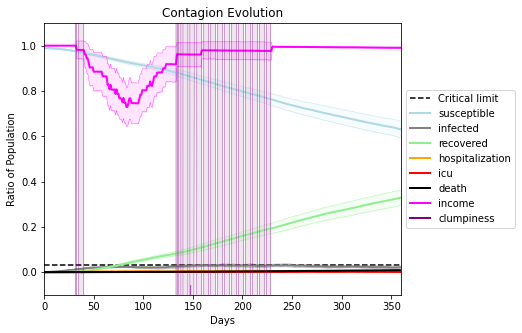

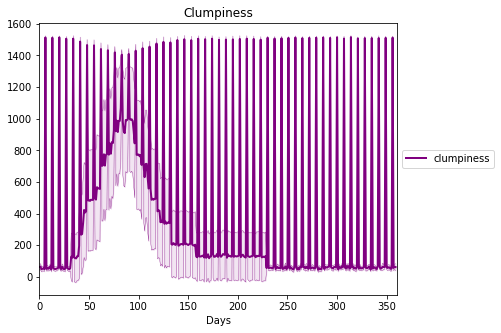

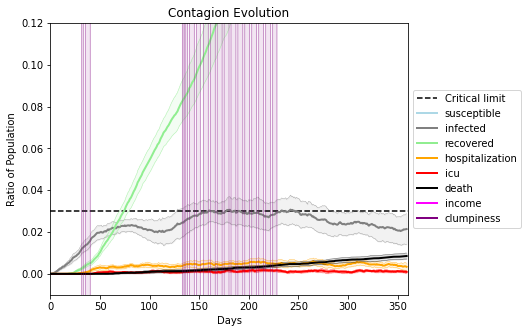

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7683, 6458, 2668, 4300, 4139, 5864, 9875, 6941, 1715, 1668, 4987, 6852, 8264, 4006, 210, 8318, 3973, 9751, 6060, 8745]
Average similarity between family members is 0.20175175519008018 at temperature -0.3
Average similarity between family and home is 0.9998661258303715 at temperature -1
Average similarity between students and their classroom is 0.11957806535455724 at temperature -0.3
Average classroom occupancy is 1.6263736263736264 and number classrooms is 182
Average similarity between workers is 0.15439815384754066 at temperature -0.3
Average office occupancy is 3.1414634146341465 and number offices is 205
Average friend similarity for adults: 0.23844122517333413 for kids: 0.22397283190616565
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.12113365876445142
avg restaurant similarity 0.0280720912267005
avg restaurant similarity -0.020159833853431258
avg restaurant similarity -0.32561036089695156
avg restaurant similarity -0.037236513823304083
avg restaurant similarity 0.2184883070062124
avg restaurant similarity 0.12975499267759547
avg restaurant similarity 0.41002227673251285
avg restaurant similarity -0.2493919381128558
avg restaurant similarity 0.13583999340094086
avg restaurant similarity 0.5415262786015657
avg restaurant similarity 0.04650205778175162
avg restaurant similarity -0.037157137113616776
avg restaurant similarity 0.2990314056097709
avg restaurant similarity -0.33799556571356487
avg restaurant similarity 0.13231284984348785
avg restaurant similarity 0.5538721407610708
avg restaurant similarity 0.511758135839665
avg restaurant similarity -0.16456857158602936
avg restaurant similarity 0.46720943547841465
avg restaurant similarity 0.7462329622236167
avg restaurant similarity 0.27787

avg restaurant similarity -0.41937838357843255
avg restaurant similarity 0.14496361195949503
Average similarity between family members is 0.18189195162404728 at temperature -0.3
Average similarity between family and home is 0.9998458501209083 at temperature -1
Average similarity between students and their classroom is 0.1739602903656714 at temperature -0.3
Average classroom occupancy is 1.4891304347826086 and number classrooms is 184
Average similarity between workers is 0.13799755545656167 at temperature -0.3
Average office occupancy is 3.318407960199005 and number offices is 201
Average friend similarity for adults: 0.25003234012571135 for kids: 0.21227033904238482
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.11335351408087968
avg restaurant similarity 0.09055544278970386
avg restaurant similarity 0.05791427916933892
avg restaurant similarity -0.1385580576882408
avg restaurant similarity -0.08144354536094961
avg restaurant similarity 0.2405583094643422
avg restaurant similarity 0.2231741138090832
avg restaurant similarity 0.00892305097639864
avg restaurant similarity 0.5190816005897825
avg restaurant similarity 0.254517551974031
avg restaurant similarity 0.2589936705585988
avg restaurant similarity 0.11575891292187444
avg restaurant similarity -0.07037429577236057
avg restaurant similarity -0.07207490190520631
avg restaurant similarity 0.06099046119326753
avg restaurant similarity -0.003934307956678373
avg restaurant similarity -0.12350636717544815
avg restaurant similarity 0.11443816548663992
avg restaurant similarity -0.010558753908659516
avg restaurant similarity 0.3349933752294961
avg restaurant similarity 0.3485433498733683
avg restaurant similarity 0.292000

avg restaurant similarity 0.3026415926083603
Average similarity between family members is 0.176145986371897 at temperature -0.3
Average similarity between family and home is 0.9998622450507324 at temperature -1
Average similarity between students and their classroom is 0.19592976687013997 at temperature -0.3
Average classroom occupancy is 1.6453488372093024 and number classrooms is 172
Average similarity between workers is 0.17037708973020593 at temperature -0.3
Average office occupancy is 3.315 and number offices is 200
Average friend similarity for adults: 0.24662308960080825 for kids: 0.22451094817703973
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated

avg restaurant similarity 0.3007295783687684
avg restaurant similarity -0.19685373655691443
avg restaurant similarity 0.24360839497827547
avg restaurant similarity 0.1974702873158596
avg restaurant similarity 0.15351815314652656
avg restaurant similarity 0.1031045282692348
avg restaurant similarity 0.07638249912575557
avg restaurant similarity 0.18416037710807026
avg restaurant similarity -0.07123147594193252
avg restaurant similarity 0.209806184832843
avg restaurant similarity 0.21180721724597196
avg restaurant similarity 0.4175041317480746
avg restaurant similarity 0.3274514171475418
avg restaurant similarity -0.14639131170902003
avg restaurant similarity 0.061815311974904544
avg restaurant similarity -0.19454936159844743
avg restaurant similarity -0.1261752475749813
avg restaurant similarity -0.029623515402395998
avg restaurant similarity -0.02711053916640138
avg restaurant similarity 0.22866392383354756
avg restaurant similarity -0.1927249915345547
avg restaurant similarity -0.1197

avg restaurant similarity 0.1686453235026295
avg restaurant similarity 0.1388359726517843
avg restaurant similarity 0.5449755210182617
avg restaurant similarity 0.10181943607413708
avg restaurant similarity 0.2846690644884083
avg restaurant similarity -0.022105124401058288
avg restaurant similarity 0.08864655155559761
avg restaurant similarity -0.3326803010666312
avg restaurant similarity 0.17448302252562004
avg restaurant similarity -0.07177495951495809
avg restaurant similarity 0.07307606961733391
avg restaurant similarity -0.0035993473565160833
avg restaurant similarity 0.012418895529987956
avg restaurant similarity 0.08283637611376034
avg restaurant similarity -0.36475974509700687
avg restaurant similarity 0.3716471217113702
avg restaurant similarity -0.02022425377829884
avg restaurant similarity 0.08687139382235678
avg restaurant similarity 0.2297342890475944
avg restaurant similarity 0.2631092548914734
avg restaurant similarity 0.13368383264287176
avg restaurant similarity -0.021

avg restaurant similarity -0.06850162495265003
avg restaurant similarity 0.17335636967885498
avg restaurant similarity -0.32014373438314014
avg restaurant similarity 0.2348277157938168
avg restaurant similarity 0.17686887706712895
avg restaurant similarity 0.21192396714225575
avg restaurant similarity 0.2709329524495528
avg restaurant similarity 0.42093729578146016
avg restaurant similarity 0.1304899831554548
avg restaurant similarity 0.11391249611287853
avg restaurant similarity 0.17335636967885498
avg restaurant similarity -0.08053612109386966
Average similarity between family members is 0.1854205008085062 at temperature -0.3
Average similarity between family and home is 0.9998619083660482 at temperature -1
Average similarity between students and their classroom is 0.16867821874357353 at temperature -0.3
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.16030572520025696 at temperature -0.3
Average office occupancy 

avg restaurant similarity 0.11152520446750439
avg restaurant similarity 0.07887759551152561
avg restaurant similarity 0.31285460485049615
avg restaurant similarity -0.27230963755050797
avg restaurant similarity 0.25039213788143444
avg restaurant similarity -0.2645723066607525
avg restaurant similarity -0.068123743125583
avg restaurant similarity 0.3412729976265809
avg restaurant similarity 0.14948908600849997
avg restaurant similarity 0.17810388364556334
avg restaurant similarity 0.738446848375063
avg restaurant similarity -0.007957839064877459
avg restaurant similarity 0.007135922482108731
avg restaurant similarity 0.2592867338462491
avg restaurant similarity 0.252352589221567
avg restaurant similarity 0.3955057339200186
avg restaurant similarity 0.2953350731844113
avg restaurant similarity 0.06791343817109662
avg restaurant similarity 0.2604974953947754
avg restaurant similarity 0.2516022924704942
avg restaurant similarity 0.01799088811733257
avg restaurant similarity 0.5674850300653

Average similarity between workers is 0.14309257271290599 at temperature -0.3
Average office occupancy is 3.1941747572815533 and number offices is 206
Average friend similarity for adults: 0.2375424991081806 for kids: 0.2121663898886026
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.42015778851186175
avg restaurant similarity 0.38588618904460376
avg restaurant similarity 0.15508903554089543
avg restaurant similarity -0.12197902348246782
avg restaurant similarity 0.09029874156408835
avg restaurant similarity -0.19975367102462677
avg restaurant similarity 0.12005368620900593
avg restaurant similarity 0.02560100800846256
avg restaurant similarity 0.09879505760010121
avg restaurant similarity 0.09643581196700172
avg restaurant similarity 0.08362615513992
avg restaurant similarity -0.020090213594304667
avg restaurant similarity 0.38588618904460376
avg restaurant similarity 0.45532815653240394
avg restaurant similarity -0.15593715927695415
avg restaurant similarity 0.07846499549616866
avg restaurant similarity 0.3172352931391492
avg restaurant similarity -0.13723330381729493
avg restaurant similarity 0.12779385870476642
avg restaurant similarity 0.2083852567063828
avg restaurant similarity 0.14933589521413423
avg restaurant similarity 0.13335

avg restaurant similarity 0.022767460839122133
avg restaurant similarity 0.19337374234097054
avg restaurant similarity 0.7295483213154031
avg restaurant similarity -0.0015220838529411834
avg restaurant similarity -0.253868286075997
avg restaurant similarity -0.012604832679244091
avg restaurant similarity -0.17319090417001273
avg restaurant similarity 0.15353319058094472
avg restaurant similarity -0.005257700416042357
avg restaurant similarity 0.018079430452530548
avg restaurant similarity 0.042917040615583726
avg restaurant similarity -0.3305686537567701
avg restaurant similarity -0.31545284821495034
avg restaurant similarity -0.0009830463631658503
avg restaurant similarity -0.11126842365106014
avg restaurant similarity -0.5072099447730147
avg restaurant similarity 0.000850943291308949
avg restaurant similarity -0.4079390482844498
avg restaurant similarity -0.20595311595834326
avg restaurant similarity -0.13694796104436752
avg restaurant similarity 0.3349422614962838
avg restaurant sim

avg restaurant similarity 0.1881028931068383
avg restaurant similarity -0.05162863103310758
avg restaurant similarity 0.015446520659093965
avg restaurant similarity 0.05592099413644032
avg restaurant similarity 0.2792662816563882
avg restaurant similarity 0.12118482941822935
avg restaurant similarity 0.3641396721011324
avg restaurant similarity 0.1616002745067434
avg restaurant similarity 0.14149389235590576
avg restaurant similarity -0.1185347683627315
avg restaurant similarity -0.01240241295789797
avg restaurant similarity 0.22535770221308202
avg restaurant similarity -0.010906179139761746
avg restaurant similarity 0.07157454571151867
avg restaurant similarity 0.02014399779763311
avg restaurant similarity -0.08837175463241174
avg restaurant similarity 0.00652959602023305
avg restaurant similarity 0.15456757848787583
avg restaurant similarity 0.27086589531156613
avg restaurant similarity 0.038177479275824676
avg restaurant similarity -0.09485819073303806
avg restaurant similarity 0.31

avg restaurant similarity -0.35390974712410905
avg restaurant similarity -0.19155428777173
avg restaurant similarity 0.055987319437020566
avg restaurant similarity 0.18480469780473358
avg restaurant similarity 0.02282709805521438
avg restaurant similarity 0.19640886948560116
avg restaurant similarity 0.10523358543681588
avg restaurant similarity 0.24005366078030224
avg restaurant similarity -0.10060205226108421
avg restaurant similarity 0.028609381879103835
avg restaurant similarity 0.08014854303617563
avg restaurant similarity -0.06824616496555783
avg restaurant similarity -0.010576385835442062
avg restaurant similarity 0.3898903333958114
avg restaurant similarity 0.39785740354209387
avg restaurant similarity -0.012625906929351411
avg restaurant similarity -0.11660378622778485
avg restaurant similarity 0.4813748739767485
avg restaurant similarity -0.12718565376692575
avg restaurant similarity 0.24725712898708543
avg restaurant similarity -0.1520157567010118
avg restaurant similarity -

avg restaurant similarity 0.4956918349647452
avg restaurant similarity 0.24763901894877066
avg restaurant similarity -0.033212855751706266
avg restaurant similarity 0.31538644192066667
avg restaurant similarity 0.24765517786973995
avg restaurant similarity 0.24441263007782094
avg restaurant similarity 0.14390624703234967
avg restaurant similarity -0.017436489578716824
avg restaurant similarity 0.3299473091587159
avg restaurant similarity 0.39001948371576395
avg restaurant similarity 0.39751010356864874
avg restaurant similarity -0.17523196028180124
avg restaurant similarity 0.3099509605599982
avg restaurant similarity 0.03255238831723083
avg restaurant similarity 0.008228454069428515
avg restaurant similarity -0.033000631962721745
avg restaurant similarity -0.022287608482157637
avg restaurant similarity -0.009563263192485433
avg restaurant similarity 0.3771962954958683
avg restaurant similarity 0.4072753642090113
avg restaurant similarity -0.07397440426204306
avg restaurant similarity 

avg restaurant similarity 0.1107795880033528
avg restaurant similarity -0.08077551409065117
avg restaurant similarity 0.3375634990399662
avg restaurant similarity 0.22897879904893775
avg restaurant similarity 0.007246529485625361
avg restaurant similarity 0.07296551140193222
avg restaurant similarity 0.524480093417457
avg restaurant similarity 0.14293240108663158
avg restaurant similarity -0.14743873948470074
avg restaurant similarity -0.008697442570281084
avg restaurant similarity 0.3117433142571806
avg restaurant similarity 0.15808657323751102
avg restaurant similarity -0.27918940280089233
avg restaurant similarity 0.031433579634781654
avg restaurant similarity -0.09923383834507288
avg restaurant similarity 0.7194207060918818
avg restaurant similarity 0.38023955669903525
avg restaurant similarity 0.08114867529445993
avg restaurant similarity 0.12277402466666505
avg restaurant similarity 0.09893080334046918
avg restaurant similarity 0.21649503265860542
avg restaurant similarity -0.086

avg restaurant similarity 0.25481079461723477
avg restaurant similarity 0.26984247837623127
avg restaurant similarity 0.13636834232099526
avg restaurant similarity 0.15872950742108582
avg restaurant similarity -0.3225886347144128
avg restaurant similarity 0.050082310727684716
avg restaurant similarity 0.13972434559242913
avg restaurant similarity 0.07178178943181737
avg restaurant similarity 0.1372965492069766
avg restaurant similarity -0.06884511459518142
avg restaurant similarity -0.1303061238410633
avg restaurant similarity 0.11142697797219146
avg restaurant similarity 0.5995882600907994
avg restaurant similarity 0.353817834950781
avg restaurant similarity -0.23114462996117088
avg restaurant similarity 0.14844989479355278
avg restaurant similarity -0.16087440118092775
avg restaurant similarity 0.10170821105171764
avg restaurant similarity -0.32500747253770135
avg restaurant similarity 0.002868881183698324
avg restaurant similarity 0.13189250895267965
avg restaurant similarity 0.2483

avg restaurant similarity -0.23448271653062075
avg restaurant similarity -0.07307705836103946
avg restaurant similarity 0.40362069176486165
avg restaurant similarity 0.47960837260581773
avg restaurant similarity 0.0894212143336888
avg restaurant similarity -0.3387212375629578
avg restaurant similarity -0.17021342186373045
avg restaurant similarity -0.15722198391310463
avg restaurant similarity -0.08907066074735968
avg restaurant similarity 0.20859555425193577
avg restaurant similarity 0.2466571834063306
avg restaurant similarity -0.3178338312119026
avg restaurant similarity 0.16554903177750996
avg restaurant similarity -0.020820690836229044
avg restaurant similarity -0.02593963871493915
avg restaurant similarity -0.12152596811315067
avg restaurant similarity 0.19570262441651026
avg restaurant similarity 0.04396912123007606
avg restaurant similarity 0.306199932306493
avg restaurant similarity -0.04760088770569335
avg restaurant similarity 0.03843530392031552
avg restaurant similarity 0.

avg restaurant similarity -0.11904410568371382
avg restaurant similarity 0.06449070330380799
avg restaurant similarity 0.026747966063207482
avg restaurant similarity 0.13000439928747415
avg restaurant similarity -0.24153366977903454
avg restaurant similarity 0.10732918947116901
avg restaurant similarity -0.13819162367188242
avg restaurant similarity -0.15142780503016706
avg restaurant similarity -0.062339919483479785
avg restaurant similarity 0.0579718677693121
avg restaurant similarity 0.20408876816381513
avg restaurant similarity 0.018633337434015268
avg restaurant similarity 0.022904289783279325
avg restaurant similarity -0.23212500103959802
avg restaurant similarity 0.19271882763179554
avg restaurant similarity -0.011529552924481249
avg restaurant similarity 0.31388904505322957
avg restaurant similarity 0.29428814773538514
avg restaurant similarity -0.15508884718421675
avg restaurant similarity -0.12806151644002542
avg restaurant similarity -0.1668910532129209
avg restaurant simila

avg restaurant similarity 0.07393722061427431
avg restaurant similarity 0.48267442499749735
avg restaurant similarity -0.13072442682044116
avg restaurant similarity 0.31388904505322957
avg restaurant similarity -0.06939437057925214
avg restaurant similarity 0.1744848659799398
avg restaurant similarity 0.09230984827585711
avg restaurant similarity 0.3914702506811328
avg restaurant similarity -0.09505297091692218
avg restaurant similarity -0.21024982074679346
avg restaurant similarity 0.11411065208813083
avg restaurant similarity 0.08009572206027467
avg restaurant similarity 0.2620096834696683
avg restaurant similarity 0.2403822422376824
avg restaurant similarity -0.16355900231956647
avg restaurant similarity 0.059577283886106856
avg restaurant similarity -0.03304961398118658
avg restaurant similarity -0.34493483091138727
avg restaurant similarity -0.1337293109484244
avg restaurant similarity 0.20408876816381513
avg restaurant similarity -0.1024614023780091
avg restaurant similarity 0.21

avg restaurant similarity -0.1771231027157126
avg restaurant similarity 0.2319034774418849
avg restaurant similarity 0.01144866596882651
avg restaurant similarity 0.23551871084085796
avg restaurant similarity 0.2032026927775985
avg restaurant similarity -0.058225623549892226
avg restaurant similarity 0.2683619027184969
avg restaurant similarity 0.015465129733000432
avg restaurant similarity -0.10876174130421626
avg restaurant similarity 0.10953740439784494
avg restaurant similarity 0.5835723401725891
avg restaurant similarity 0.13101638360384582
avg restaurant similarity -0.012342469669426861
avg restaurant similarity -0.045401487050982334
avg restaurant similarity 0.47509876875218104
avg restaurant similarity -0.16418197595532233
avg restaurant similarity 0.15157131821045725
avg restaurant similarity 0.13276993645154722
avg restaurant similarity 0.351844960172173
avg restaurant similarity 0.047695917313026526
avg restaurant similarity 0.42616926345522427
avg restaurant similarity -0.2

avg restaurant similarity 0.20310381693159538
avg restaurant similarity 0.06797004352076466
avg restaurant similarity -0.0018956640640272748
avg restaurant similarity 0.018947748447690135
avg restaurant similarity -0.11265218244297978
avg restaurant similarity -0.10350540787152841
avg restaurant similarity -0.21955278031359654
avg restaurant similarity 0.4162999996848497
avg restaurant similarity 0.1047314083730927
avg restaurant similarity 0.5610372636273674
avg restaurant similarity 0.133700173352708
avg restaurant similarity -0.054098990887253694
avg restaurant similarity 0.133700173352708
avg restaurant similarity 0.03669208286413576
avg restaurant similarity 0.3526497681265734
avg restaurant similarity 0.10764836930040375
avg restaurant similarity 0.11944186976208404
avg restaurant similarity -0.16471299504164316
avg restaurant similarity 0.23267371168954276
avg restaurant similarity 0.5223051572131003
avg restaurant similarity -0.10861823734110983
avg restaurant similarity 0.2422

avg restaurant similarity -0.1077721483267324
avg restaurant similarity -0.02805354932198484
avg restaurant similarity -0.15898467408689995
avg restaurant similarity -0.08945916798810666
avg restaurant similarity 0.32722543949894994
avg restaurant similarity 0.03346502286780957
avg restaurant similarity 0.46385700455739676
avg restaurant similarity 0.27612802763150135
avg restaurant similarity 0.06835837903349734
avg restaurant similarity 0.08400678667784217
avg restaurant similarity -0.06407836354518515
avg restaurant similarity 0.27274343100326554
avg restaurant similarity -0.07016414325565967
avg restaurant similarity -0.09726131594741987
avg restaurant similarity 0.18581286459854296
avg restaurant similarity 0.060977739457417156
avg restaurant similarity 0.7022959246458006
avg restaurant similarity 0.2030701349090271
avg restaurant similarity 0.12021691479693168
avg restaurant similarity 0.5974209331264116
avg restaurant similarity 0.23405327321170022
avg restaurant similarity 0.08

Average similarity between workers is 0.13894224478791373 at temperature -0.3
Average office occupancy is 3.245 and number offices is 200
Average friend similarity for adults: 0.24343134060042085 for kids: 0.21536104038087509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allo

avg restaurant similarity 0.2290285127645026
avg restaurant similarity -0.009203949184710403
avg restaurant similarity 0.10100957824887459
avg restaurant similarity 0.05151610061131845
avg restaurant similarity 0.012347113005321958
avg restaurant similarity 0.22761064477028198
avg restaurant similarity -0.045090208988956756
avg restaurant similarity 0.4030245582495636
avg restaurant similarity -0.0718353635556635
avg restaurant similarity 0.3640887839333782
avg restaurant similarity 0.26495906028991767
avg restaurant similarity 0.21453598467274124
avg restaurant similarity 0.1886972441157987
avg restaurant similarity -0.17077554375992615
avg restaurant similarity 0.2846233545988904
avg restaurant similarity 0.060931907149407785
avg restaurant similarity 0.43377520677761927
avg restaurant similarity -0.2575733117977118
avg restaurant similarity -0.1308754140254197
avg restaurant similarity -0.13102738555312526
avg restaurant similarity -0.16128124420125858
avg restaurant similarity -0.0

avg restaurant similarity 0.028465145858190016
avg restaurant similarity -0.11990505821086632
Average similarity between family members is 0.22117173561790862 at temperature -0.3
Average similarity between family and home is 0.9998662697864386 at temperature -1
Average similarity between students and their classroom is 0.16590874569707592 at temperature -0.3
Average classroom occupancy is 1.5444444444444445 and number classrooms is 180
Average similarity between workers is 0.15398151678014455 at temperature -0.3
Average office occupancy is 3.2222222222222223 and number offices is 207
Average friend similarity for adults: 0.24342853391613747 for kids: 0.2255230720013009
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity -0.0061504875185785235
avg restaurant similarity -0.0876444953557411
avg restaurant similarity 0.21545587739387176
avg restaurant similarity 0.025287488494721032
avg restaurant similarity 0.4493183101688441
avg restaurant similarity 0.03317734883171895
avg restaurant similarity 0.21808456094122186
avg restaurant similarity -0.05205704569650936
avg restaurant similarity 0.2004697290367362
avg restaurant similarity -0.10577348934754642
avg restaurant similarity -0.11360562579105865
avg restaurant similarity 0.11925951667241466
avg restaurant similarity 0.2850059205357676
avg restaurant similarity 0.10564386385245743
avg restaurant similarity 0.24437832406232338
avg restaurant similarity 0.10690861123628108
avg restaurant similarity 0.25453689805327634
avg restaurant similarity 0.3279229437769136
avg restaurant similarity 0.13924530379867206
avg restaurant similarity -0.07897573327381738
avg restaurant similarity 0.20135008784567343
avg restaurant similarity 0.33

avg restaurant similarity 0.1120030043507795
avg restaurant similarity 0.30618832249867867
avg restaurant similarity 0.2823759441409355
avg restaurant similarity -0.11800256148548542
avg restaurant similarity -0.32910429453225787
avg restaurant similarity -0.2795136553981633
avg restaurant similarity 0.05639733215446868
avg restaurant similarity 0.15613254213824354
avg restaurant similarity -0.0411084607551544
avg restaurant similarity 0.26436547466521
avg restaurant similarity 0.22593750382284983
avg restaurant similarity -0.19096869153101817
avg restaurant similarity -0.03925526271352781
avg restaurant similarity 0.1487799952979192
avg restaurant similarity 0.2805192212987447
avg restaurant similarity 0.16548919493099315
avg restaurant similarity 0.37834962757623647
avg restaurant similarity 0.4036085018541896
avg restaurant similarity 0.3817514340703672
avg restaurant similarity 0.3582842662545169
avg restaurant similarity 0.08029076669756205
avg restaurant similarity 0.190593945338

Average similarity between workers is 0.1571241234490751 at temperature -0.3
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.23873354392538718 for kids: 0.20440809210519723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2

avg restaurant similarity 0.31010210159437107
avg restaurant similarity 0.18360190750343067
avg restaurant similarity 0.21762153309382617
avg restaurant similarity 0.29929951561413987
avg restaurant similarity -0.3370212526344665
avg restaurant similarity 0.3305999531005506
avg restaurant similarity -0.225667788820128
avg restaurant similarity -0.22425880214588712
avg restaurant similarity -0.01878466287683999
avg restaurant similarity 0.25690407585148406
avg restaurant similarity 0.23050071092226085
avg restaurant similarity 0.1615443319286436
avg restaurant similarity -0.24728259330482494
avg restaurant similarity -0.25488249977558775
avg restaurant similarity 0.06547289110925394
avg restaurant similarity 0.07710484492964674
avg restaurant similarity 0.12728017662341765
avg restaurant similarity 0.20335953037607232
avg restaurant similarity -0.27193751507159514
avg restaurant similarity 0.34920060078088005
avg restaurant similarity 0.31725395834165404
avg restaurant similarity 0.5309

avg restaurant similarity 0.04173450836524661
avg restaurant similarity 0.1689016584592189
avg restaurant similarity 0.23816461271736009
avg restaurant similarity -0.020771308961834593
avg restaurant similarity 0.14331703576204288
avg restaurant similarity -0.015676529214299403
avg restaurant similarity 0.01137735464672203
avg restaurant similarity 0.2257712350435461
avg restaurant similarity 0.685296402624688
avg restaurant similarity -0.14233763142613423
avg restaurant similarity 0.16212486797787845
avg restaurant similarity 0.44148415141692304
avg restaurant similarity 0.12821986143354389
avg restaurant similarity 0.3444388811398638
avg restaurant similarity 0.15459711197076895
avg restaurant similarity -0.0033472660836404156
avg restaurant similarity 0.2612808165890055
avg restaurant similarity 0.21428967829391857
avg restaurant similarity 0.02441925941032659
avg restaurant similarity 0.15754723911451363
avg restaurant similarity 0.08679352662395089
avg restaurant similarity 0.2039

avg restaurant similarity 0.03695554645115001
avg restaurant similarity 0.0994251593364392
avg restaurant similarity -0.07718105771859045
avg restaurant similarity 0.12076050508234708
avg restaurant similarity 0.03342546477097842
avg restaurant similarity 0.040506559962066806
avg restaurant similarity 0.4166391465036624
avg restaurant similarity 0.3499412797971114
avg restaurant similarity 0.2849331988060632
avg restaurant similarity 0.5216858909922313
avg restaurant similarity -0.12550297312677078
avg restaurant similarity 0.7607953578127369
avg restaurant similarity 0.19841903646746004
avg restaurant similarity 0.32438027160004795
avg restaurant similarity 0.2512239116199744
avg restaurant similarity -0.17936111290388054
avg restaurant similarity 0.05651151481643988
avg restaurant similarity 0.11113207289131585
avg restaurant similarity -0.05984348616707971
avg restaurant similarity -0.6122779173285978
avg restaurant similarity -0.07953672744306058
avg restaurant similarity 0.1841855

avg restaurant similarity 0.15764388108895222
avg restaurant similarity -0.1625440913817313
avg restaurant similarity 0.007972348324121942
avg restaurant similarity 0.19321434339143176
avg restaurant similarity -0.047717468086263246
avg restaurant similarity -0.19027825393996628
avg restaurant similarity 0.31691616544137746
avg restaurant similarity 0.021650206120164828
avg restaurant similarity 0.4349036095194056
avg restaurant similarity 0.5110742227195532
avg restaurant similarity 0.054644184785138744
avg restaurant similarity -0.13936683221174606
avg restaurant similarity 0.11348823129563941
avg restaurant similarity 0.22170994173803094
avg restaurant similarity -0.040006151769679914
avg restaurant similarity 0.17265100812785972
avg restaurant similarity 0.15822633125039673
avg restaurant similarity 0.22629892754350503
avg restaurant similarity 0.1131392104768313
avg restaurant similarity -0.23981428412564526
avg restaurant similarity 0.1638484375543077
avg restaurant similarity 0.

avg restaurant similarity 0.1133149012688189
avg restaurant similarity -0.27096347055897785
avg restaurant similarity -0.2229437574166837
avg restaurant similarity -0.07817381593014809
avg restaurant similarity 0.26759008599419776
avg restaurant similarity 0.2898844738148141
avg restaurant similarity -0.039618218896528
avg restaurant similarity 0.2775476012025893
avg restaurant similarity 0.21389857211764057
avg restaurant similarity 0.12202150836949469
avg restaurant similarity 0.010082846799656028
avg restaurant similarity 0.2306436698633569
avg restaurant similarity 0.03601418820949624
avg restaurant similarity 0.358111940189582
avg restaurant similarity -0.19644107819675408
avg restaurant similarity 0.24968124360371674
avg restaurant similarity -0.3080317975117641
avg restaurant similarity -0.2586659884564587
avg restaurant similarity -0.03806276349725508
avg restaurant similarity 0.06285095524495499
avg restaurant similarity -0.019283287672528626
avg restaurant similarity -0.19418

avg restaurant similarity 0.3251664949160119
avg restaurant similarity 0.11967252674364179
avg restaurant similarity 0.30219241144405035
avg restaurant similarity 0.3885407057582568
avg restaurant similarity -0.3616248633348898
avg restaurant similarity -0.3727044901823965
avg restaurant similarity 0.3180228451727317
avg restaurant similarity 0.7834402199609258
avg restaurant similarity 0.32387555284418257
avg restaurant similarity 0.11138424038505307
avg restaurant similarity 0.4355632440018109
avg restaurant similarity 0.07076920508719774
avg restaurant similarity 0.0008824019119667431
avg restaurant similarity 0.15784776155719515
avg restaurant similarity 0.12269331182319515
avg restaurant similarity 0.09816022723473856
avg restaurant similarity 0.15871749145031225
avg restaurant similarity 0.05650455051993081
avg restaurant similarity 0.6159177720333755
avg restaurant similarity 0.07840857297945789
avg restaurant similarity 0.16067696293206432
avg restaurant similarity -0.033098257

avg restaurant similarity -0.26388051350597447
avg restaurant similarity 0.10076524807747768
avg restaurant similarity -0.14740203223834697
avg restaurant similarity 0.011128368339481564
avg restaurant similarity 0.20102693196190774
avg restaurant similarity 0.31911863908199883
avg restaurant similarity 0.1504118947261896
avg restaurant similarity -0.07380377204831942
using average of time series:
stats on susceptible:
data: [0.8662512462612164, 0.8062888888888889, 0.8522583333333333, 0.8423770673770674, 0.8186638888888889, 0.8412444444444445, 0.8426250000000001, 0.8232111111111111, 0.7763444444444445, 0.7891194444444444, 0.8822222222222222, 0.8318638888888888, 0.8393555555555555, 0.8653444444444445, 0.7882833333333334, 0.8106944444444445, 0.7591388888888888, 0.7861638888888889, 0.8595555555555555, 0.8235777777777776]
min:
0.7591388888888888
max:
0.8822222222222222
std:
0.03249492191208259
mean:
0.825229193459692
median:
0.8277208333333332
95% confidence interval for the mean:
(0.80962

(<function dict.items>, <function dict.items>, <function dict.items>)

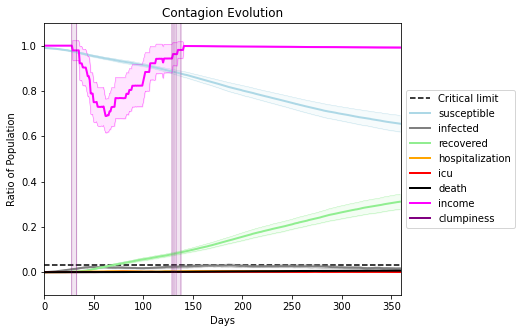

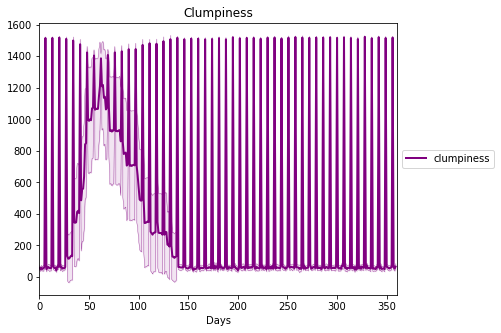

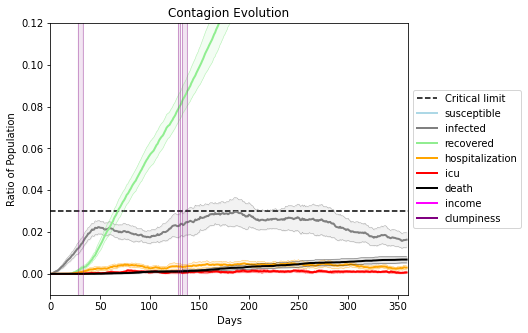

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8541, 7135, 2649, 3512, 921, 652, 4657, 4879, 5781, 4952, 2727, 9364, 2029, 314, 5903, 1169, 6920, 1825, 4427, 2312]
Average similarity between family members is 0.1490349064117913 at temperature -0.2
Average similarity between family and home is 0.9998601014900881 at temperature -1
Average similarity between students and their classroom is 0.19866285644167114 at temperature -0.2
Average classroom occupancy is 1.6428571428571428 and number classrooms is 182
Average similarity between workers is 0.13810840995089932 at temperature -0.2
Average office occupancy is 3.2058823529411766 and number offices is 204
Average friend similarity for adults: 0.20539178958245344 for kids: 0.20301111632757093
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.06251584336837349
avg restaurant similarity 0.5213944486631444
avg restaurant similarity 0.03567239603589975
avg restaurant similarity -0.04554539139729781
avg restaurant similarity 0.35081623802916717
avg restaurant similarity -0.18972387995385076
avg restaurant similarity 0.24925694462718545
avg restaurant similarity 0.434584323346243
avg restaurant similarity 0.04009697695787783
avg restaurant similarity 0.2276121973446723
avg restaurant similarity 0.11229166225967258
avg restaurant similarity 0.32123607640721086
avg restaurant similarity 0.5081106225368074
avg restaurant similarity 0.0407529209961571
avg restaurant similarity 0.06371497768215104
avg restaurant similarity -0.12366416005378394
avg restaurant similarity -0.1255234879006998
avg restaurant similarity 0.0972579520165353
avg restaurant similarity 0.13694256659369433
avg restaurant similarity 0.22920884274958667
avg restaurant similarity -0.059276693308046184
avg restaurant similarity -0.2442816

Average similarity between workers is 0.13401014628357485 at temperature -0.2
Average office occupancy is 3.336683417085427 and number offices is 199
Average friend similarity for adults: 0.21041606573332297 for kids: 0.19967777836851922
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4

avg restaurant similarity -0.25575551641745103
avg restaurant similarity 0.06528068002443195
avg restaurant similarity 0.2715894604972144
avg restaurant similarity 0.2883578474280766
avg restaurant similarity 0.019473423390229894
avg restaurant similarity -0.08082793850152986
avg restaurant similarity 0.14773365542596326
avg restaurant similarity 0.34037194084584654
avg restaurant similarity -0.26462634757985315
avg restaurant similarity -0.039249275398933116
avg restaurant similarity 0.23422924211634302
avg restaurant similarity -0.211478438805445
avg restaurant similarity 0.24380589908834618
avg restaurant similarity -0.09383501877250039
avg restaurant similarity 0.4338136499525397
avg restaurant similarity 0.03138907466853359
avg restaurant similarity 0.2417088363723647
avg restaurant similarity -0.08014033581173245
avg restaurant similarity -0.1259260848986578
avg restaurant similarity 0.5090611918188918
avg restaurant similarity 0.24696668417168655
avg restaurant similarity -0.420

avg restaurant similarity 0.3321953430015491
avg restaurant similarity 0.15374432278454894
avg restaurant similarity 0.25570614941101255
avg restaurant similarity 0.21858807108933007
avg restaurant similarity -0.42023771701152063
avg restaurant similarity 0.24696668417168655
avg restaurant similarity -0.18411082149760458
avg restaurant similarity 0.30815755283259844
Average similarity between family members is 0.14782046326479673 at temperature -0.2
Average similarity between family and home is 0.9998439738656364 at temperature -1
Average similarity between students and their classroom is 0.15616885856835594 at temperature -0.2
Average classroom occupancy is 1.6408839779005524 and number classrooms is 181
Average similarity between workers is 0.15653955625916638 at temperature -0.2
Average office occupancy is 3.198019801980198 and number offices is 202
Average friend similarity for adults: 0.21469898360540932 for kids: 0.21681418248152434
home_districts
[
Home (0,0) district with 1 Bui

avg restaurant similarity 0.1270466527257453
avg restaurant similarity -0.034283263679300624
avg restaurant similarity 0.16433363333129797
avg restaurant similarity 0.16984315134279274
avg restaurant similarity -0.0013057458101593438
avg restaurant similarity -0.03630656194910621
avg restaurant similarity 0.08257913513593414
avg restaurant similarity 0.03713959619357956
avg restaurant similarity 0.35693438705118086
avg restaurant similarity 0.038660252409710535
avg restaurant similarity -0.2313145002963529
avg restaurant similarity 0.33535483334692984
avg restaurant similarity 0.4796896423589294
avg restaurant similarity -0.07086719165613352
avg restaurant similarity 0.23895036215003035
avg restaurant similarity 0.18660365017668828
avg restaurant similarity -0.22922879493229772
avg restaurant similarity 0.0419346518070803
avg restaurant similarity 0.40822175587869014
avg restaurant similarity 0.1043527932017415
avg restaurant similarity -0.1797093683566575
avg restaurant similarity -0.

Average similarity between workers is 0.1621803119958417 at temperature -0.2
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.2054923472928533 for kids: 0.20964423730227458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of

avg restaurant similarity -0.244957102785899
avg restaurant similarity -0.009082220482787529
avg restaurant similarity -0.05682125218812108
avg restaurant similarity -0.28339217236306585
avg restaurant similarity 0.1716451101143932
avg restaurant similarity 0.20047551584245074
avg restaurant similarity 0.03955379540761525
avg restaurant similarity 0.08229477739734428
avg restaurant similarity 0.2835568747006929
avg restaurant similarity -0.11432288549208289
avg restaurant similarity 0.1516362517786967
avg restaurant similarity 0.14076481398825375
avg restaurant similarity 0.28286591264523636
avg restaurant similarity 0.23218714187442596
avg restaurant similarity 0.22606171333216385
avg restaurant similarity 0.018187965303636627
avg restaurant similarity -0.12542000154171723
avg restaurant similarity -0.15139122527116403
avg restaurant similarity 0.03232041541515568
avg restaurant similarity 0.10733385107800689
avg restaurant similarity 0.28009062469738216
avg restaurant similarity 0.19

avg restaurant similarity -0.02278414751191059
avg restaurant similarity -0.14164447946706157
avg restaurant similarity -0.0550684446935784
avg restaurant similarity 0.08180227336618821
avg restaurant similarity -0.032811807144907466
avg restaurant similarity 0.22879579547123124
avg restaurant similarity 0.06618349134718328
avg restaurant similarity 0.09135082623346245
avg restaurant similarity -0.5459306180360923
avg restaurant similarity -0.019831255300669676
avg restaurant similarity 0.5190025358921352
avg restaurant similarity -0.34211762131399376
avg restaurant similarity -0.04312423223103881
avg restaurant similarity 0.03232041541515568
avg restaurant similarity -0.2937503177595081
avg restaurant similarity -0.14457536219566106
avg restaurant similarity 0.27969568142027107
avg restaurant similarity 0.17870295503808767
avg restaurant similarity 0.1830506132233017
avg restaurant similarity -0.0591246592453376
avg restaurant similarity 0.10604651490988685
avg restaurant similarity -

avg restaurant similarity 0.2971414910438997
avg restaurant similarity 0.30801752070450383
avg restaurant similarity 0.10972454662864484
avg restaurant similarity -0.15412690055134678
avg restaurant similarity 0.05714587218386879
avg restaurant similarity -0.09689224923300829
avg restaurant similarity 0.5601549793564058
avg restaurant similarity 0.003911988147397785
avg restaurant similarity -0.07018600435959846
avg restaurant similarity -0.1628249551356104
avg restaurant similarity 0.21217265988690207
avg restaurant similarity 0.14190244077524478
avg restaurant similarity -0.04692753571356368
avg restaurant similarity 0.30427213971857314
avg restaurant similarity 0.24424841850500517
avg restaurant similarity -0.030460028081221027
avg restaurant similarity 0.19514385926638206
avg restaurant similarity 0.34587430454211193
avg restaurant similarity 0.16428395178668578
avg restaurant similarity -0.10432036486958775
avg restaurant similarity 0.1790043823008591
avg restaurant similarity 0.4

avg restaurant similarity 0.003911988147397785
avg restaurant similarity 0.29782143044683224
avg restaurant similarity -0.34580655229633495
avg restaurant similarity 0.057572590011519695
avg restaurant similarity 0.14382762191868328
avg restaurant similarity -0.13686305841660276
avg restaurant similarity -0.02327153720957658
avg restaurant similarity -0.5219265220146727
avg restaurant similarity -0.09544062354219694
avg restaurant similarity 0.2773906825604153
avg restaurant similarity 0.46742313684536296
avg restaurant similarity 0.48149638668058903
avg restaurant similarity 0.003911988147397785
avg restaurant similarity 0.1313939899383325
avg restaurant similarity 0.02857446792374212
avg restaurant similarity -0.23238523732203528
avg restaurant similarity 0.005782326787021785
avg restaurant similarity -0.3410376471448592
avg restaurant similarity 0.2635486283971609
avg restaurant similarity -0.11079411357052094
avg restaurant similarity 0.1267631057263585
avg restaurant similarity 0.

avg restaurant similarity 0.41031558697248016
avg restaurant similarity -0.06123125146128442
avg restaurant similarity 0.060318661704341754
avg restaurant similarity 0.1888432076942953
avg restaurant similarity -0.013072439263423902
avg restaurant similarity -0.010601811327500734
avg restaurant similarity -0.235129426382914
avg restaurant similarity 0.22470090607705084
avg restaurant similarity -0.0897932623333743
avg restaurant similarity 0.6236314188787409
avg restaurant similarity 0.14031085954678424
avg restaurant similarity 0.17070616829273172
avg restaurant similarity 0.12843383059707852
avg restaurant similarity -0.013888245618319653
avg restaurant similarity 0.03946402721040397
avg restaurant similarity 0.49483399234345254
avg restaurant similarity 0.46138538900343157
avg restaurant similarity 0.2926705873082064
avg restaurant similarity 0.11620158258283925
avg restaurant similarity 0.12739164755026192
avg restaurant similarity 0.18602959837956828
avg restaurant similarity -0.1

avg restaurant similarity 0.32366508247914483
avg restaurant similarity 0.17583557999516428
avg restaurant similarity 0.029014989652013018
avg restaurant similarity 0.1383062936988957
avg restaurant similarity 0.08379963010785993
avg restaurant similarity -0.07248857718909224
avg restaurant similarity 0.21735454036648366
avg restaurant similarity 0.071716549968585
avg restaurant similarity -0.12225620133858589
avg restaurant similarity 0.5398993814587498
avg restaurant similarity 0.1383062936988957
avg restaurant similarity 0.07895456988457708
avg restaurant similarity 0.07708720536860067
avg restaurant similarity 0.010336477843761599
avg restaurant similarity -0.172771712280637
avg restaurant similarity 0.5025507003037314
avg restaurant similarity -0.15547455440008331
avg restaurant similarity 0.10429782819012424
avg restaurant similarity -0.08210026478178788
avg restaurant similarity 0.45011366946010445
avg restaurant similarity 0.28721821106521483
avg restaurant similarity 0.2736324

avg restaurant similarity -0.21904453101629298
avg restaurant similarity 0.09056967275338465
avg restaurant similarity -0.03179505950687517
avg restaurant similarity 0.10785778399060245
avg restaurant similarity -0.12035399837727595
avg restaurant similarity 0.014929252483958155
avg restaurant similarity 0.2564913018999673
avg restaurant similarity -0.04525268647271623
avg restaurant similarity 0.2561742003145146
avg restaurant similarity 0.09104905798507744
avg restaurant similarity 0.06680125995574429
avg restaurant similarity -0.025658421181564826
avg restaurant similarity 0.23367980307652592
avg restaurant similarity 0.5151086204063492
avg restaurant similarity 0.16142056968237933
avg restaurant similarity 0.07079480888982012
avg restaurant similarity -0.16465330189021768
avg restaurant similarity 0.5571988008499722
avg restaurant similarity 0.5013687745593383
avg restaurant similarity 0.3988177107780595
avg restaurant similarity 0.0886913140526384
avg restaurant similarity -0.0148

avg restaurant similarity -0.03438288689037104
avg restaurant similarity 0.19320329594176364
avg restaurant similarity -0.3433152567676091
avg restaurant similarity 0.041506256332254396
avg restaurant similarity -0.02782409448372944
avg restaurant similarity 0.3220500002917083
avg restaurant similarity -0.0097221616892901
avg restaurant similarity 0.6273090161607264
avg restaurant similarity 0.07874615678885706
avg restaurant similarity -0.015371483789021347
avg restaurant similarity 0.03960971448631076
avg restaurant similarity 0.11327112701696652
avg restaurant similarity 0.06780108234235126
avg restaurant similarity 0.43547723269029515
avg restaurant similarity 0.0654995456076558
avg restaurant similarity 0.33715799604046154
avg restaurant similarity 0.2638453106312804
avg restaurant similarity -0.22625096842994707
avg restaurant similarity 0.15593855131840234
avg restaurant similarity 0.10103410046222519
avg restaurant similarity -0.015374894109871251
avg restaurant similarity 0.28

avg restaurant similarity 0.09774678181303639
avg restaurant similarity 0.3536860127627943
avg restaurant similarity 0.09774678181303639
avg restaurant similarity -0.3245669941525754
avg restaurant similarity 0.00836026840193066
avg restaurant similarity 0.6343711137606608
avg restaurant similarity -0.3276752231538738
avg restaurant similarity 0.28791208056999357
avg restaurant similarity 0.6136702218893089
avg restaurant similarity 0.5094584086048687
avg restaurant similarity 0.32283973511926545
avg restaurant similarity 0.0377832398593205
avg restaurant similarity 0.1869031345407793
avg restaurant similarity 0.1967284155318349
avg restaurant similarity 0.1536747529250576
avg restaurant similarity 0.4112453894930904
avg restaurant similarity -0.19743577542232696
avg restaurant similarity 0.5146361763486055
avg restaurant similarity 0.25611751943191124
avg restaurant similarity 0.0856640223221502
avg restaurant similarity 0.15406491862487573
avg restaurant similarity -0.059110738750740

avg restaurant similarity -0.030732366690203756
avg restaurant similarity 0.16753393879733114
avg restaurant similarity -0.1765372349132449
avg restaurant similarity -0.35346654169621977
avg restaurant similarity -0.23178791310199026
avg restaurant similarity 0.12131542402263248
avg restaurant similarity 0.20218568822722122
avg restaurant similarity 0.7295340932464007
avg restaurant similarity -0.041268150609315386
avg restaurant similarity -0.25567355212106957
avg restaurant similarity -0.11281492301778069
avg restaurant similarity -0.09447231241537252
avg restaurant similarity 0.10968087806388652
avg restaurant similarity -0.11789555841518559
avg restaurant similarity 0.10939732583695207
avg restaurant similarity -0.03914367084435032
avg restaurant similarity -0.03162350515840161
avg restaurant similarity -0.35346654169621977
avg restaurant similarity 0.20656163070913874
avg restaurant similarity -0.13408822855423336
avg restaurant similarity 0.354082253931603
avg restaurant similari

avg restaurant similarity 0.09165076794470275
avg restaurant similarity 0.36365770874926556
avg restaurant similarity 0.13556571280015897
avg restaurant similarity 0.040053847602119025
avg restaurant similarity 0.26522979792240964
avg restaurant similarity 0.16599109878873508
avg restaurant similarity 0.11402520301741276
avg restaurant similarity 0.18281862732402754
avg restaurant similarity 0.33184090792311927
avg restaurant similarity 0.32352659595918903
avg restaurant similarity 0.47003525310060534
avg restaurant similarity -0.2942511136230379
avg restaurant similarity 0.48683737628572915
avg restaurant similarity -0.5055712084558035
avg restaurant similarity 0.21797523078328915
avg restaurant similarity 0.057092455909869055
avg restaurant similarity 0.2607277964221366
avg restaurant similarity 0.07645975693957614
avg restaurant similarity 0.18220109437964543
avg restaurant similarity -0.020283736161254368
avg restaurant similarity -0.2283426876842499
avg restaurant similarity 0.125

avg restaurant similarity 0.29842910980608484
avg restaurant similarity 0.1513489799013713
avg restaurant similarity 0.142993605270481
avg restaurant similarity 0.15567675540598225
avg restaurant similarity 0.18220109437964543
avg restaurant similarity 0.24396063440090796
avg restaurant similarity 0.3416361471128899
avg restaurant similarity 0.010054470858479294
avg restaurant similarity 0.03818590419927989
avg restaurant similarity 0.2508781262422149
avg restaurant similarity 0.06952688596547779
avg restaurant similarity 0.15238603602094203
avg restaurant similarity 0.023167852700177183
avg restaurant similarity -0.04832187989879154
avg restaurant similarity -0.1928521456267063
Average similarity between family members is 0.16447231084704236 at temperature -0.2
Average similarity between family and home is 0.999864205907526 at temperature -1
Average similarity between students and their classroom is 0.14328072689558957 at temperature -0.2
Average classroom occupancy is 1.6292134831460

avg restaurant similarity 0.22706958462200844
avg restaurant similarity 0.23206462216609416
avg restaurant similarity 0.1856443178055955
avg restaurant similarity -0.014129801711709262
avg restaurant similarity 0.8306414095844794
avg restaurant similarity 0.06550584492226942
avg restaurant similarity -0.0788621449895584
avg restaurant similarity 0.041233434196815445
avg restaurant similarity 0.25076598950647244
avg restaurant similarity -0.021501311321969935
avg restaurant similarity 0.09018523512888253
avg restaurant similarity 0.10394230508583453
avg restaurant similarity 0.20857402840701605
avg restaurant similarity 0.14232286398129446
avg restaurant similarity 0.12560484690921747
avg restaurant similarity -0.047119107171608464
avg restaurant similarity 0.21440544974639514
avg restaurant similarity -0.051372621210276845
avg restaurant similarity 0.27237366136751573
avg restaurant similarity 0.13281573685558695
avg restaurant similarity -0.0909706808647344
avg restaurant similarity 0

avg restaurant similarity 0.09238306837010983
avg restaurant similarity -0.0907027728120686
avg restaurant similarity -0.3159794090646767
avg restaurant similarity 0.278034504889547
avg restaurant similarity 0.17944155608007906
avg restaurant similarity 0.22507078163428998
avg restaurant similarity 0.2566644888930751
avg restaurant similarity 0.15181154989960083
avg restaurant similarity 0.08535541851966787
avg restaurant similarity -0.17524733193021388
avg restaurant similarity 0.10865116155838293
avg restaurant similarity 0.21163649501611884
avg restaurant similarity -0.08173983122579183
avg restaurant similarity 0.24274626289218273
avg restaurant similarity 0.07879913831137024
avg restaurant similarity 0.039982630102682486
avg restaurant similarity -0.13129113601661324
avg restaurant similarity 0.251538686485423
avg restaurant similarity 0.011730299755653678
avg restaurant similarity 0.08643363759019104
avg restaurant similarity 0.07628645255794592
avg restaurant similarity 0.282468

avg restaurant similarity 0.41476927091967997
avg restaurant similarity -0.11809417604574898
avg restaurant similarity -0.14246047860190708
avg restaurant similarity 0.11457708033706561
avg restaurant similarity 0.09998061547167653
avg restaurant similarity 0.026745279488150454
avg restaurant similarity -0.19037419644414483
avg restaurant similarity 0.28121920387459276
avg restaurant similarity 0.0934495628769151
avg restaurant similarity 0.2708718257428159
avg restaurant similarity -0.011142720156558344
avg restaurant similarity 0.37985521930123345
avg restaurant similarity -0.019617141125063617
avg restaurant similarity 0.10258729940409503
avg restaurant similarity -0.17734226579420836
avg restaurant similarity 0.2512633061028658
avg restaurant similarity -0.0999051247071724
avg restaurant similarity -0.05441286495451195
avg restaurant similarity 0.35907351787484054
avg restaurant similarity 0.22925592610937273
avg restaurant similarity -0.11441932789045263
avg restaurant similarity 

avg restaurant similarity 0.21587097707042582
avg restaurant similarity 0.0861462804914808
avg restaurant similarity 0.19246925573591628
avg restaurant similarity 0.23072780082652677
avg restaurant similarity 0.3866870969806756
avg restaurant similarity -0.18345344711696396
avg restaurant similarity 0.005577714254848071
avg restaurant similarity -0.1962280093041108
avg restaurant similarity 0.020410194725534486
avg restaurant similarity 0.37329358175150507
avg restaurant similarity -0.10141720344405507
avg restaurant similarity -0.16149658551771456
avg restaurant similarity 0.06944113701222804
avg restaurant similarity -0.08740991166739119
avg restaurant similarity 0.12735751209537247
avg restaurant similarity -0.17422779850625236
avg restaurant similarity -0.06670071911816153
avg restaurant similarity -0.1547046423042649
avg restaurant similarity -0.0362519293816499
avg restaurant similarity 0.19173022521933974
avg restaurant similarity 0.018662987763482707
avg restaurant similarity -

avg restaurant similarity 0.22507361032207512
avg restaurant similarity -0.033062791415893196
avg restaurant similarity -0.07463725746492936
avg restaurant similarity 0.2103796621746431
avg restaurant similarity -0.13357059989348957
avg restaurant similarity -0.18046567640098338
avg restaurant similarity 0.3103808752729132
avg restaurant similarity 0.13584543176181127
avg restaurant similarity -0.013773796664005413
avg restaurant similarity -0.21009984560076855
Average similarity between family members is 0.14740579128525844 at temperature -0.2
Average similarity between family and home is 0.9998545636492548 at temperature -1
Average similarity between students and their classroom is 0.17083276157084137 at temperature -0.2
Average classroom occupancy is 1.6666666666666667 and number classrooms is 186
Average similarity between workers is 0.14497661448456214 at temperature -0.2
Average office occupancy is 3.2436548223350252 and number offices is 197
Average friend similarity for adults:

avg restaurant similarity 0.1042298796901386
avg restaurant similarity -0.04734454347903094
avg restaurant similarity -0.11775337337837971
avg restaurant similarity 0.2962754271732909
avg restaurant similarity 0.21208337678956704
avg restaurant similarity 0.2532996506297241
avg restaurant similarity -0.04657368561942457
avg restaurant similarity 0.29647184641803465
avg restaurant similarity 0.034676985089786214
avg restaurant similarity 0.2093805474671945
avg restaurant similarity -0.027537858941128424
avg restaurant similarity 0.0406253528070559
avg restaurant similarity 0.20694680612666017
avg restaurant similarity 0.5115152160702379
avg restaurant similarity 0.036066789826074155
avg restaurant similarity 0.34046889622723986
avg restaurant similarity -0.053943714702207636
avg restaurant similarity -0.2474522302785504
avg restaurant similarity 0.0033988252672830276
avg restaurant similarity 0.3894631749893873
avg restaurant similarity 0.24625683894110456
avg restaurant similarity 0.23

avg restaurant similarity 0.08815156610682753
avg restaurant similarity 0.1344539482871814
avg restaurant similarity 0.23310582946938413
avg restaurant similarity 0.24296492451781995
avg restaurant similarity 0.43739936902445375
avg restaurant similarity -0.051060544919904804
avg restaurant similarity -0.288472037745625
avg restaurant similarity 0.38311096074558554
avg restaurant similarity -0.05497071376279768
avg restaurant similarity 0.29647184641803465
avg restaurant similarity 0.0542927127036377
avg restaurant similarity 0.3642989112259447
Average similarity between family members is 0.15286708893341408 at temperature -0.2
Average similarity between family and home is 0.9998632000389789 at temperature -1
Average similarity between students and their classroom is 0.1641090027089201 at temperature -0.2
Average classroom occupancy is 1.5604395604395604 and number classrooms is 182
Average similarity between workers is 0.13657913517008577 at temperature -0.2
Average office occupancy i

avg restaurant similarity 0.15115190095972778
avg restaurant similarity 0.28519577140496793
avg restaurant similarity 0.13061007062059204
avg restaurant similarity 0.38914093062536015
avg restaurant similarity 0.4233178661094486
avg restaurant similarity 0.06245787415922779
avg restaurant similarity 0.48905876836471107
avg restaurant similarity 0.0484711202006632
avg restaurant similarity 0.04945332723924675
avg restaurant similarity 0.04522780737757044
avg restaurant similarity 0.4746539536908602
avg restaurant similarity -0.2500380773848981
avg restaurant similarity -0.04082759358072145
avg restaurant similarity 0.1441689479645858
avg restaurant similarity 0.1360494371094671
avg restaurant similarity -0.3318154137671532
avg restaurant similarity 0.004115686083676545
avg restaurant similarity 0.18335862455364882
avg restaurant similarity 0.21945517948415627
avg restaurant similarity 0.2575608300047635
avg restaurant similarity -0.5560951174100358
avg restaurant similarity 0.2760199503

avg restaurant similarity -0.2535445558334532
avg restaurant similarity 0.0874095444838307
avg restaurant similarity -0.04406332247706518
avg restaurant similarity 0.09012991375578588
avg restaurant similarity 0.10823132373827109
avg restaurant similarity 0.0894957611962419
avg restaurant similarity 0.3749368407615095
avg restaurant similarity 0.2937580382933668
avg restaurant similarity 0.022636987196133704
avg restaurant similarity -0.15378601834174985
avg restaurant similarity 0.36755473818021406
avg restaurant similarity 0.25177205844257744
avg restaurant similarity 0.3292133436968994
avg restaurant similarity -0.134960511092513
avg restaurant similarity -0.1400558839265147
avg restaurant similarity -0.2440416739855491
avg restaurant similarity -0.03356134194929442
avg restaurant similarity -0.12330761727784155
avg restaurant similarity 0.10687342805438417
avg restaurant similarity -0.15585955175005387
avg restaurant similarity 0.09788604569671953
avg restaurant similarity 0.115961

avg restaurant similarity -0.09803849043990923
avg restaurant similarity -0.020313018300726533
avg restaurant similarity 0.3833459699104603
avg restaurant similarity 0.2628899296377648
avg restaurant similarity 0.354868192677529
avg restaurant similarity 0.33121045305493374
avg restaurant similarity 0.36639600300563285
avg restaurant similarity 0.11262661836435674
avg restaurant similarity 0.23196550581865963
avg restaurant similarity -0.04939858903542921
avg restaurant similarity 0.10045610383011339
avg restaurant similarity -0.06469415988297057
avg restaurant similarity 0.003593155072809384
avg restaurant similarity 0.49431495120297153
avg restaurant similarity 0.4498288718399909
avg restaurant similarity -0.07662412170585946
avg restaurant similarity 0.2195713443304652
avg restaurant similarity -0.13442372955030968
avg restaurant similarity -0.06679696625177163
avg restaurant similarity -0.026395489615644488
avg restaurant similarity 0.004526298166083603
avg restaurant similarity 0.

avg restaurant similarity 0.23645863954321408
avg restaurant similarity 0.5190367015910597
avg restaurant similarity 0.4424115913426505
avg restaurant similarity -0.00691780343418312
avg restaurant similarity -0.08676930009708794
avg restaurant similarity 0.27025671071517454
avg restaurant similarity 0.20569503477925863
avg restaurant similarity 0.09133310722855495
avg restaurant similarity 0.294534695446938
avg restaurant similarity 0.0422136586359866
avg restaurant similarity -0.05634817789405645
avg restaurant similarity -0.492912276869227
avg restaurant similarity -0.2860619850518249
avg restaurant similarity -0.21551980970822848
avg restaurant similarity 0.24078920574804413
avg restaurant similarity -0.03064436557008125
avg restaurant similarity -0.24871745667356943
avg restaurant similarity -0.06651770491728581
Average similarity between family members is 0.16536903519132662 at temperature -0.2
Average similarity between family and home is 0.9998538415449147 at temperature -1
Ave

avg restaurant similarity 0.0011492596385114958
avg restaurant similarity 0.2703805610215672
avg restaurant similarity 0.39683926637559974
avg restaurant similarity 0.19982091271961505
avg restaurant similarity -0.050585257333231146
avg restaurant similarity 0.2170048465937403
avg restaurant similarity -0.16593508851037053
avg restaurant similarity 0.11862741003526807
avg restaurant similarity -0.5502781889241634
avg restaurant similarity 0.15499722933644486
avg restaurant similarity 0.3147451960292381
avg restaurant similarity -0.09034642103859294
avg restaurant similarity 0.08521618915618881
avg restaurant similarity 0.41172869503384124
avg restaurant similarity 0.37587671176762555
avg restaurant similarity 0.2245995968704156
avg restaurant similarity 0.26691649639479437
avg restaurant similarity 0.3099209237661351
avg restaurant similarity 0.17541960672438658
avg restaurant similarity -0.09663709488850714
avg restaurant similarity 0.08521618915618881
avg restaurant similarity 0.3210

avg restaurant similarity 0.08233143308302987
avg restaurant similarity -0.24535403548522836
avg restaurant similarity 0.527402494887504
avg restaurant similarity 0.07828401057358961
avg restaurant similarity 0.18038293098414318
avg restaurant similarity 0.3701443925513037
avg restaurant similarity 0.3770341120569078
avg restaurant similarity 0.11907552025311655
avg restaurant similarity 0.732353102251397
avg restaurant similarity 0.4439033623676582
avg restaurant similarity -0.23525109488263043
avg restaurant similarity 0.06209339337019508
avg restaurant similarity 0.06474997700098611
avg restaurant similarity -0.16521182420419084
avg restaurant similarity 0.09937791347522412
avg restaurant similarity 0.15795415412942707
avg restaurant similarity 0.1115708789362429
avg restaurant similarity 0.05683536897625806
avg restaurant similarity 0.2866293623996451
avg restaurant similarity -0.14102481964155622
avg restaurant similarity -0.2980585851576472
avg restaurant similarity 0.51535123521

avg restaurant similarity 0.5965812486012385
avg restaurant similarity 0.20754944411959964
avg restaurant similarity -0.12971786018628406
avg restaurant similarity 0.12439678408909768
avg restaurant similarity 0.050221762651199084
avg restaurant similarity 0.20175358422860756
avg restaurant similarity 0.052160305150336615
avg restaurant similarity -0.1887587309083364
avg restaurant similarity 0.06474997700098611
avg restaurant similarity -0.02889403461991318
avg restaurant similarity 0.05062541039954271
avg restaurant similarity 0.29009307113204685
avg restaurant similarity 0.16795175570471607
avg restaurant similarity 0.006345318565650612
avg restaurant similarity 0.035714839385947335
avg restaurant similarity 0.3190288763082208
avg restaurant similarity 0.015037202698622854
avg restaurant similarity 0.28149636349476725
Average similarity between family members is 0.17150379480399333 at temperature -0.2
Average similarity between family and home is 0.9998552080275308 at temperature -1

avg restaurant similarity -0.053277741829497315
avg restaurant similarity 0.2772513291445804
avg restaurant similarity -0.25372479289671385
avg restaurant similarity 0.06430700124006788
avg restaurant similarity 0.11825321989127172
avg restaurant similarity 0.17354962561071272
avg restaurant similarity 0.15059458524999986
avg restaurant similarity 0.09141431387621518
avg restaurant similarity 0.20295956473477084
avg restaurant similarity 0.07065127048360509
avg restaurant similarity 0.2970039570774987
avg restaurant similarity -0.01746323631811043
avg restaurant similarity -0.1286844132152087
avg restaurant similarity 0.20377911508957178
avg restaurant similarity 0.5033834568616017
avg restaurant similarity 0.3039316580320141
avg restaurant similarity 0.053456581136748456
avg restaurant similarity -0.07138230700047414
avg restaurant similarity -0.04420458573294084
avg restaurant similarity -0.1268136547304731
avg restaurant similarity -0.2675665918346862
avg restaurant similarity -0.02

avg restaurant similarity 0.15580067830232303
avg restaurant similarity 0.33588837276313543
avg restaurant similarity -0.0651123194877308
avg restaurant similarity 0.30215419354653394
Average similarity between family members is 0.1585309626902938 at temperature -0.2
Average similarity between family and home is 0.9998469073401104 at temperature -1
Average similarity between students and their classroom is 0.1399026012625225 at temperature -0.2
Average classroom occupancy is 1.521505376344086 and number classrooms is 186
Average similarity between workers is 0.1633517626986024 at temperature -0.2
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.21077952433549466 for kids: 0.20957752219441972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.041453699205910556
avg restaurant similarity -0.029507197059031723
avg restaurant similarity 0.2785704911217081
avg restaurant similarity 0.26271258596704417
avg restaurant similarity -0.43171892793239686
avg restaurant similarity 0.21265418273234982
avg restaurant similarity 0.1357133069837097
avg restaurant similarity 0.053345416564708176
avg restaurant similarity -0.4377840121016361
avg restaurant similarity 0.17453095272401997
avg restaurant similarity 0.3107067607021686
avg restaurant similarity 0.14716824441684018
avg restaurant similarity 0.3625105661124487
avg restaurant similarity 0.03321262231768313
avg restaurant similarity 0.2053715517695532
avg restaurant similarity 0.20721540887521214
avg restaurant similarity 0.2759029844515815
avg restaurant similarity -0.1355862726411552
avg restaurant similarity 0.12241298747579941
avg restaurant similarity 0.266827078467222
avg restaurant similarity 0.2524867284335712
avg restaurant similarity 0.1352821165

(<function dict.items>, <function dict.items>, <function dict.items>)

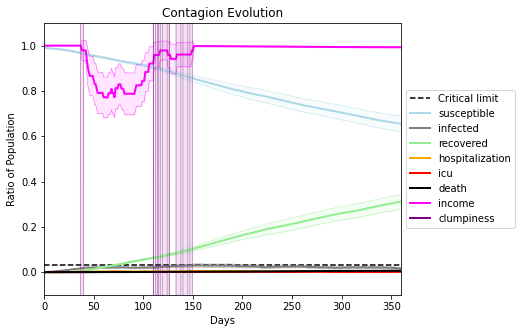

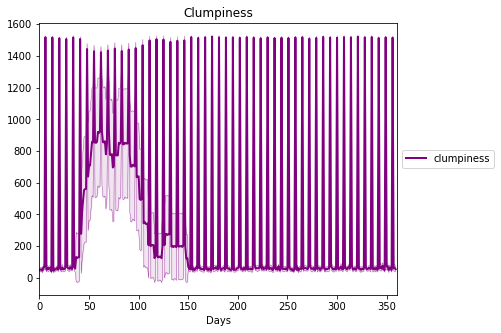

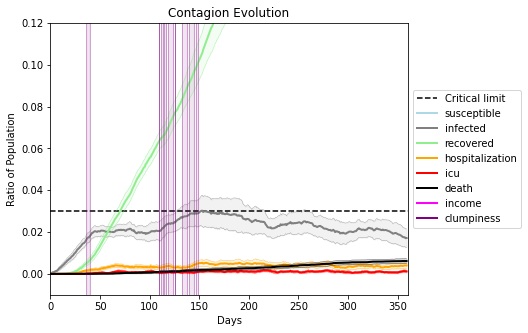

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5820, 7520, 2613, 9938, 7171, 2781, 3305, 1879, 7221, 9580, 7379, 1757, 1617, 8634, 6993, 8487, 5259, 803, 7580, 6437]
Average similarity between family members is 0.16758189328020215 at temperature -0.1
Average similarity between family and home is 0.9998503933673173 at temperature -1
Average similarity between students and their classroom is 0.17682175726570548 at temperature -0.1
Average classroom occupancy is 1.5786516853932584 and number classrooms is 178
Average similarity between workers is 0.1685789657038436 at temperature -0.1
Average office occupancy is 3.282178217821782 and number offices is 202
Average friend similarity for adults: 0.21094383357350208 for kids: 0.20990386797629673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.17620214705639492
avg restaurant similarity 0.06967762201492571
avg restaurant similarity -0.06634707125222535
avg restaurant similarity -0.004692919883507306
avg restaurant similarity 0.3498089000901029
avg restaurant similarity 0.3493612692919693
avg restaurant similarity 0.08415400233674021
avg restaurant similarity 0.4374761883163134
avg restaurant similarity 0.31376978835372854
avg restaurant similarity -0.30757210888463754
avg restaurant similarity -0.027492541838713136
avg restaurant similarity -0.1744245986629249
avg restaurant similarity 0.0015290605122339762
avg restaurant similarity -0.11221524058530141
avg restaurant similarity 0.061050112960420476
avg restaurant similarity 0.4704150444890131
avg restaurant similarity -0.20697261733979527
avg restaurant similarity 0.10328687455184254
avg restaurant similarity 0.2780106262810662
avg restaurant similarity 0.418861774321152
avg restaurant similarity -0.02216452147972567
avg restaurant similarity 0.4

avg restaurant similarity -0.10952928635967289
avg restaurant similarity 0.11463816833617142
avg restaurant similarity -0.3054406778751235
avg restaurant similarity -0.16424646622323508
avg restaurant similarity -0.06729238099554562
avg restaurant similarity 0.1656432876115461
avg restaurant similarity 0.24844416734598368
avg restaurant similarity 0.201882580559143
avg restaurant similarity 0.16791155871917754
avg restaurant similarity 0.06601303758130497
avg restaurant similarity 0.18091755275665108
avg restaurant similarity -0.24351716018214553
avg restaurant similarity -0.029564032259897316
avg restaurant similarity -0.10014545406367929
avg restaurant similarity -0.21354368196508922
avg restaurant similarity 0.03045325010632809
avg restaurant similarity -0.30757210888463754
avg restaurant similarity 0.22621282532109727
avg restaurant similarity 0.6487078969471192
avg restaurant similarity 0.07477390216585326
avg restaurant similarity 0.19463348135176295
avg restaurant similarity 0.1

avg restaurant similarity -0.07211734219134036
avg restaurant similarity -0.08037600598294602
avg restaurant similarity -0.027123845464950128
avg restaurant similarity -0.05635229451507933
avg restaurant similarity 0.08139710057742619
avg restaurant similarity 0.4623062426448899
avg restaurant similarity -0.15557152463521065
avg restaurant similarity 0.2858506366807132
avg restaurant similarity 0.41052902320535467
avg restaurant similarity 0.1406485636533416
avg restaurant similarity 0.4264083090771985
avg restaurant similarity 0.20954921619603814
avg restaurant similarity 0.3839226484719306
avg restaurant similarity 0.3780176868161188
avg restaurant similarity -0.01320761270063564
avg restaurant similarity 0.3056656727709677
avg restaurant similarity 0.32128188827477167
avg restaurant similarity 0.21053788787407904
avg restaurant similarity 0.4711867191847669
avg restaurant similarity -0.00548391253922721
avg restaurant similarity 0.16840642549677404
avg restaurant similarity 0.330182

avg restaurant similarity 0.4408578711950608
avg restaurant similarity 0.10326395820466698
avg restaurant similarity 0.06620076275751653
avg restaurant similarity 0.2748212436903577
avg restaurant similarity -0.01105613754552652
avg restaurant similarity 0.4692219041087049
avg restaurant similarity 0.20812062518816088
avg restaurant similarity 0.26391283823222683
avg restaurant similarity 0.11158245976677403
avg restaurant similarity 0.10649996627292943
avg restaurant similarity 0.20030202553344473
avg restaurant similarity 0.03335234712070596
avg restaurant similarity -0.09301373692176622
avg restaurant similarity -0.1913390796176908
avg restaurant similarity -0.04169837078197133
avg restaurant similarity -0.06505166081925792
avg restaurant similarity 0.12447274309920021
avg restaurant similarity -0.044081125291878166
avg restaurant similarity -0.0012429560019301261
avg restaurant similarity 0.1683748802541948
avg restaurant similarity 0.20382429075713215
avg restaurant similarity -0.

avg restaurant similarity 0.21700091600086216
avg restaurant similarity -0.07715332141746706
avg restaurant similarity -0.1533484190643148
avg restaurant similarity 0.08306978628112457
avg restaurant similarity -0.2553249381082212
avg restaurant similarity 0.15153382122053702
avg restaurant similarity 0.20412770723853216
avg restaurant similarity 0.3467519285448917
avg restaurant similarity 0.22676823098473622
avg restaurant similarity 0.2955869830918514
avg restaurant similarity 0.3329366273137798
avg restaurant similarity 0.5120955892062888
avg restaurant similarity 0.28403446904326946
avg restaurant similarity 0.4227222302067618
avg restaurant similarity 0.3011788194693726
avg restaurant similarity -0.1145324326424796
avg restaurant similarity 0.20412367303087592
avg restaurant similarity -0.056301984770671
avg restaurant similarity 0.1752229997389859
avg restaurant similarity -0.209979053334812
avg restaurant similarity 0.4090638474233069
avg restaurant similarity 0.024696061020512

avg restaurant similarity 0.015839621088699348
avg restaurant similarity 0.09020856980441327
avg restaurant similarity 0.2211257818688617
avg restaurant similarity 0.1179448090649836
avg restaurant similarity 0.32667381543783114
avg restaurant similarity 0.2694667885396266
avg restaurant similarity 0.13939249445592913
avg restaurant similarity -0.17748948174997087
avg restaurant similarity -0.09638075477440014
avg restaurant similarity 0.31635074359047266
avg restaurant similarity -0.3238050824328552
avg restaurant similarity 0.6736767145114083
avg restaurant similarity 0.199660194746981
avg restaurant similarity -0.1058935836505901
avg restaurant similarity -0.07699103598279713
avg restaurant similarity 0.0004799827071525209
avg restaurant similarity 0.5278602234646257
avg restaurant similarity 0.4444783519914175
avg restaurant similarity -0.06486911516297901
avg restaurant similarity -0.010093594561687291
avg restaurant similarity 0.27443841927642354
avg restaurant similarity -0.0685

avg restaurant similarity 0.25556561558552726
avg restaurant similarity 0.22317713286770258
avg restaurant similarity 0.19304008062426226
avg restaurant similarity 0.36657553838524237
avg restaurant similarity -0.12825128109070894
avg restaurant similarity 0.19088406773840522
avg restaurant similarity 0.22379678866068445
avg restaurant similarity 0.11449698228703706
avg restaurant similarity 0.06627134571244746
avg restaurant similarity -0.1886343411086132
avg restaurant similarity 0.3435764992258486
avg restaurant similarity -0.14145423489493308
avg restaurant similarity -0.010152689688911115
avg restaurant similarity 0.3529157251189886
avg restaurant similarity -0.32413234471131863
avg restaurant similarity 0.1916222033997941
avg restaurant similarity 0.05140595265825631
Average similarity between family members is 0.1744453347201814 at temperature -0.1
Average similarity between family and home is 0.9998564869840064 at temperature -1
Average similarity between students and their cla

avg restaurant similarity 0.22395289291411025
avg restaurant similarity 0.09994651719145697
avg restaurant similarity 0.02887281775524128
avg restaurant similarity 0.6368879641742355
avg restaurant similarity 0.00607741189594542
avg restaurant similarity 0.2280675986997487
avg restaurant similarity 0.005957702324107292
avg restaurant similarity 0.22724991026088862
avg restaurant similarity -0.2737472837323646
avg restaurant similarity 0.052253756027407214
avg restaurant similarity -0.1138784093780809
avg restaurant similarity 0.17401941092611914
avg restaurant similarity 0.07968994056167816
avg restaurant similarity 0.31439940235976604
avg restaurant similarity 0.029350372648750726
avg restaurant similarity 0.2390704369259036
avg restaurant similarity 0.06779878350114489
avg restaurant similarity -0.12564650077088593
avg restaurant similarity -0.030884967095245332
avg restaurant similarity 0.3532402970030731
avg restaurant similarity 0.038301981528176536
avg restaurant similarity 0.708

avg restaurant similarity 0.18375982804529428
avg restaurant similarity 0.11730569610487639
avg restaurant similarity 0.04188767253686737
avg restaurant similarity 0.018841653595635204
avg restaurant similarity 0.03542157306063968
avg restaurant similarity -0.018439738358572138
avg restaurant similarity 0.028797898567860688
avg restaurant similarity -0.19501375045308678
avg restaurant similarity 0.35607300715837553
avg restaurant similarity 0.27559105930747935
avg restaurant similarity -0.14956096842348462
avg restaurant similarity -0.09151306298020648
avg restaurant similarity -0.4260844629873081
avg restaurant similarity 0.12110851447960944
avg restaurant similarity 0.11820680075210874
avg restaurant similarity 0.13877677191270096
avg restaurant similarity -0.048373486643546904
avg restaurant similarity -0.03678479368929905
avg restaurant similarity 0.04253192846911885
avg restaurant similarity 0.21040393151607162
avg restaurant similarity 0.04188767253686737
avg restaurant similarit

avg restaurant similarity 0.08252929803651202
avg restaurant similarity 0.16833179882735858
avg restaurant similarity 0.11506564461023991
avg restaurant similarity 0.2835604057785889
avg restaurant similarity 0.314723076495963
avg restaurant similarity 0.3778268163812567
avg restaurant similarity 0.027217578209475568
avg restaurant similarity 0.2038619682492134
avg restaurant similarity -0.010515292849338592
avg restaurant similarity -0.016176611065243984
avg restaurant similarity -0.16342937237018257
avg restaurant similarity 0.15173351425623974
avg restaurant similarity 0.061426641856987874
avg restaurant similarity 0.23130868514970826
avg restaurant similarity 0.22597698070711103
avg restaurant similarity 0.16400780335982743
avg restaurant similarity 0.06804333470568456
avg restaurant similarity 0.09606519578294503
avg restaurant similarity 0.07431130435837
avg restaurant similarity 0.10281127066873301
avg restaurant similarity 0.43484414224369483
avg restaurant similarity 0.1670254

avg restaurant similarity 0.22155617435366715
avg restaurant similarity -0.05965167906479111
avg restaurant similarity 0.00827702829749825
avg restaurant similarity 0.22834828339327015
avg restaurant similarity 0.3445087229874931
avg restaurant similarity -0.16455558017343783
avg restaurant similarity 0.1449416613810687
avg restaurant similarity 0.26253314066782246
avg restaurant similarity -0.047760834826282975
avg restaurant similarity 0.33666716002502106
avg restaurant similarity 0.20730166875127767
avg restaurant similarity 0.2668825799063304
avg restaurant similarity 0.05868559342052643
avg restaurant similarity -0.00892242909975494
avg restaurant similarity 0.20730166875127767
avg restaurant similarity -0.06786399322846179
avg restaurant similarity 0.012236918069739797
avg restaurant similarity 0.0029230259111652952
avg restaurant similarity 0.27354472509751016
avg restaurant similarity 0.03163568316398764
avg restaurant similarity 0.4242733551865687
avg restaurant similarity 0.4

avg restaurant similarity 0.32661654497261305
avg restaurant similarity 0.27243674786835653
avg restaurant similarity -0.41968443437901054
avg restaurant similarity -0.24740328267618933
avg restaurant similarity 0.13731670225668519
avg restaurant similarity 0.2334621313819249
avg restaurant similarity 0.22675184473658982
avg restaurant similarity 0.6634876164763426
avg restaurant similarity 0.44026781947035465
avg restaurant similarity 0.1585530941225239
avg restaurant similarity 0.07226765198886068
avg restaurant similarity -0.3992614000673919
avg restaurant similarity 0.256455858097606
avg restaurant similarity 0.05233804070452202
avg restaurant similarity 0.007668214395811351
avg restaurant similarity -0.0412956818522817
avg restaurant similarity 0.07776295128181133
avg restaurant similarity -0.0412350009928035
avg restaurant similarity 0.25516547096610626
avg restaurant similarity -0.29164657526691357
avg restaurant similarity -0.04726259515308066
avg restaurant similarity 0.099890

avg restaurant similarity 0.4862872607457138
avg restaurant similarity 0.07417256548890215
avg restaurant similarity 0.1689826318611416
avg restaurant similarity 0.3146493181380763
avg restaurant similarity 0.0043514436730974215
avg restaurant similarity 0.07904995412709744
avg restaurant similarity 0.44137471177937515
avg restaurant similarity 0.12250819774836921
avg restaurant similarity 0.17801507356491605
avg restaurant similarity 0.04998574665480063
avg restaurant similarity 0.0042339261488135715
avg restaurant similarity -0.07153571261404472
avg restaurant similarity -0.19836813487688815
avg restaurant similarity 0.10764691818541973
avg restaurant similarity 0.10315847684331117
avg restaurant similarity 0.1903590810887328
avg restaurant similarity 0.3044685488212897
avg restaurant similarity 0.29931216761598295
avg restaurant similarity -0.30113035554545353
avg restaurant similarity -0.01794478035912754
avg restaurant similarity 0.0671759238077676
avg restaurant similarity 0.1223

avg restaurant similarity 0.14482288507844215
avg restaurant similarity -0.0193341130343359
avg restaurant similarity 0.5078367247372018
avg restaurant similarity -0.006341434372569251
avg restaurant similarity 0.26429916690258193
avg restaurant similarity 0.3548694937138995
avg restaurant similarity -0.1861415989000541
avg restaurant similarity 0.13781328808604448
avg restaurant similarity 0.28861239656742893
avg restaurant similarity -0.3708713207937804
avg restaurant similarity -0.036391684217518656
avg restaurant similarity 0.06640761719463835
avg restaurant similarity -0.03758186574623629
avg restaurant similarity 0.14849452743810124
avg restaurant similarity -0.051599159154270935
avg restaurant similarity -0.07741657228795584
avg restaurant similarity -0.019936808516394938
avg restaurant similarity -0.06712883954275217
avg restaurant similarity 0.03283091433072427
avg restaurant similarity -0.03993085093008979
avg restaurant similarity -0.17082055683380173
avg restaurant similari

avg restaurant similarity 0.2094068408642049
avg restaurant similarity 0.0025073632806738716
avg restaurant similarity 0.11297784286702633
avg restaurant similarity 0.33200482787207386
avg restaurant similarity -0.04704746585790148
avg restaurant similarity 0.2624600421008532
avg restaurant similarity 0.13691107383309073
avg restaurant similarity 0.08249387754182667
avg restaurant similarity -0.08704576292963076
avg restaurant similarity -0.22377186966708285
avg restaurant similarity 0.15398483537242638
avg restaurant similarity 0.16572343751654955
avg restaurant similarity -0.16493440675396848
avg restaurant similarity 0.13396208887914057
avg restaurant similarity 0.01479586638892419
avg restaurant similarity 0.0013531278325414897
avg restaurant similarity 0.07325262113356072
avg restaurant similarity 0.16270077201540814
avg restaurant similarity -0.1415902113465187
avg restaurant similarity -0.04100203312450688
avg restaurant similarity -0.08858166714297686
avg restaurant similarity 

avg restaurant similarity -0.40782834637907667
avg restaurant similarity -0.06787949702511592
avg restaurant similarity 0.19666269498569314
avg restaurant similarity 0.7954310445308093
avg restaurant similarity 0.1127904105184927
avg restaurant similarity 0.32520024422895577
avg restaurant similarity 0.27396611221263006
avg restaurant similarity 0.2185847739511269
avg restaurant similarity 0.3978172227819455
avg restaurant similarity 0.06599099146226099
avg restaurant similarity -0.15361885380355042
avg restaurant similarity -0.23475113715346588
avg restaurant similarity 0.0472430392735031
avg restaurant similarity -0.06868056817391256
avg restaurant similarity 0.3450325340709113
avg restaurant similarity -0.0920299219423116
avg restaurant similarity -0.026668287895226392
avg restaurant similarity 0.09024881547873378
avg restaurant similarity 0.4982455105961907
avg restaurant similarity 0.10024949141230337
avg restaurant similarity -0.0576770897821235
avg restaurant similarity -0.41841

avg restaurant similarity 0.4347407766640091
avg restaurant similarity 0.19322164863967334
avg restaurant similarity -0.14566682467325393
avg restaurant similarity 0.06596357881058632
avg restaurant similarity 0.09320765809784924
avg restaurant similarity 0.36274762760980395
avg restaurant similarity 0.1334694647899045
avg restaurant similarity -0.029218536260300403
avg restaurant similarity 0.4485348362267726
avg restaurant similarity 0.008132626167941762
avg restaurant similarity 0.17170529129143516
avg restaurant similarity 0.29256361206438775
avg restaurant similarity -0.003531207475704075
avg restaurant similarity 0.5109842814901041
avg restaurant similarity 0.1489074442766816
avg restaurant similarity 0.19154200224524098
avg restaurant similarity 0.32185889156538117
avg restaurant similarity 0.11103205015554485
avg restaurant similarity -0.04263546740472117
avg restaurant similarity -0.3778311424196392
avg restaurant similarity 0.45329649174053044
avg restaurant similarity -0.201

avg restaurant similarity 0.3656248950817468
avg restaurant similarity 0.11569468458833326
avg restaurant similarity 0.12794589233276282
avg restaurant similarity 0.31650848069752796
avg restaurant similarity -0.19707961920402067
avg restaurant similarity 0.10212375128453084
avg restaurant similarity 0.19423910100384661
avg restaurant similarity -0.07218262755335751
avg restaurant similarity 0.2586696547105326
avg restaurant similarity 0.08944329053593503
Average similarity between family members is 0.1478328445390607 at temperature -0.1
Average similarity between family and home is 0.9998480471962345 at temperature -1
Average similarity between students and their classroom is 0.1661361535455284 at temperature -0.1
Average classroom occupancy is 1.6104651162790697 and number classrooms is 172
Average similarity between workers is 0.15113429552196758 at temperature -0.1
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.20485

avg restaurant similarity 0.2642511397401557
avg restaurant similarity -0.2303573075945609
avg restaurant similarity -0.14955313585933086
avg restaurant similarity 0.3924090906940687
avg restaurant similarity -0.09061857912214169
avg restaurant similarity 0.32749157141716567
avg restaurant similarity -0.1472698780149463
avg restaurant similarity 0.014573556389934118
avg restaurant similarity 0.03608599545580561
avg restaurant similarity 0.373154024936808
avg restaurant similarity 0.20690267901070603
avg restaurant similarity 0.15710573771952652
avg restaurant similarity 0.1598751016603757
avg restaurant similarity 0.27150019716524787
avg restaurant similarity 0.16466189310558146
avg restaurant similarity 0.11039002110268578
avg restaurant similarity 0.02971634634169948
avg restaurant similarity 0.22302990793628813
avg restaurant similarity -0.15875261359950452
avg restaurant similarity 0.25622535900503235
avg restaurant similarity 0.05832264236047453
avg restaurant similarity 0.0141580

Average friend similarity for adults: 0.2010228637597637 for kids: 0.21769460455217068
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.20938514935761365
avg restaurant similarity 0.11496411142250074
avg restaurant similarity 0.20798332899873842
avg restaurant similarity 0.09765850527325119
avg restaurant similarity 0.16279104034181588
avg restaurant similarity 0.1344881763889785
avg restaurant similarity 0.2965224797718673
avg restaurant similarity 0.052200642421501416
avg restaurant similarity -0.07179589350614997
avg restaurant similarity 0.029776305349734133
avg restaurant similarity -0.1917216497297688
avg restaurant similarity 0.3152062864787341
avg restaurant similarity 0.2840141533117471
avg restaurant similarity 0.47551519020473443
avg restaurant similarity 0.25097412958444115
avg restaurant similarity -0.15087201137695247
avg restaurant similarity 0.1195267339464927
avg restaurant similarity 0.1897819619028335
avg restaurant similarity 0.08700903442745742
avg restaurant similarity 0.1220020361027126
avg restaurant similarity -0.08746836806229534
avg restaurant similarity -0.0168395

avg restaurant similarity 0.1695516886866684
avg restaurant similarity 0.23169112606790215
avg restaurant similarity -0.01887641013630706
avg restaurant similarity 0.15625746612045094
avg restaurant similarity -0.3217013213079057
avg restaurant similarity 0.17909401776901862
avg restaurant similarity -0.02731921372313435
avg restaurant similarity 0.12189610263741936
avg restaurant similarity -0.1107576258697006
avg restaurant similarity 0.3413152164280497
avg restaurant similarity -0.08411187983397728
avg restaurant similarity -0.29030859586532826
avg restaurant similarity 0.0025549428366995197
avg restaurant similarity -0.006415633849371258
avg restaurant similarity 0.02629553058395266
avg restaurant similarity -0.07097759763641547
avg restaurant similarity -0.18655702960432602
avg restaurant similarity 0.03265654078859492
avg restaurant similarity -0.019868218425059102
avg restaurant similarity 0.37349582401124626
avg restaurant similarity 0.0007127716908381746
avg restaurant similar

Average similarity between workers is 0.16018497330416157 at temperature -0.1
Average office occupancy is 3.1170731707317074 and number offices is 205
Average friend similarity for adults: 0.21022989309641205 for kids: 0.21921716041158312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total 

avg restaurant similarity 0.159234767633178
avg restaurant similarity -0.0811672320565155
avg restaurant similarity 0.31808145424172096
avg restaurant similarity 0.1236477645965933
avg restaurant similarity -0.21566408488849068
avg restaurant similarity 0.031100714035476096
avg restaurant similarity -0.2812052266453207
avg restaurant similarity -0.04743169201745583
avg restaurant similarity 0.32917287191788613
avg restaurant similarity 0.5003531857842872
avg restaurant similarity -0.2812052266453207
avg restaurant similarity 0.33509495045585447
avg restaurant similarity 0.6004794790882814
avg restaurant similarity 0.05981726373566609
avg restaurant similarity 0.5791901346917834
avg restaurant similarity 0.01359948394103827
avg restaurant similarity -0.18374401719123545
avg restaurant similarity 0.32188261297189924
avg restaurant similarity -0.05166666432573719
avg restaurant similarity 0.083930914470039
avg restaurant similarity 0.05918754305248589
avg restaurant similarity 0.323599296

avg restaurant similarity 0.22317621375813051
avg restaurant similarity 0.13233606957567462
avg restaurant similarity -0.054277711126774375
avg restaurant similarity 0.09536050674339479
avg restaurant similarity -0.1599184340136262
avg restaurant similarity 0.3356284020089283
avg restaurant similarity 0.08911759205901378
avg restaurant similarity 0.0259386010381771
avg restaurant similarity 0.6461349943257535
avg restaurant similarity 0.22615144210525479
avg restaurant similarity 0.11000926345653808
avg restaurant similarity 0.008390354370896403
avg restaurant similarity -0.057754114210340574
avg restaurant similarity -0.21995424290779617
avg restaurant similarity 0.3018247031993889
avg restaurant similarity 0.10439676409372131
avg restaurant similarity 0.6217688234847794
avg restaurant similarity -0.22828492280675938
Average similarity between family members is 0.1550711986842401 at temperature -0.1
Average similarity between family and home is 0.9998506740693988 at temperature -1
Ave

avg restaurant similarity -0.20845937177156465
avg restaurant similarity 0.29877328583047047
avg restaurant similarity 0.1278503525008888
avg restaurant similarity 0.1278503525008888
avg restaurant similarity -0.07542933278302817
avg restaurant similarity -0.02474831107147294
avg restaurant similarity 0.23072576105845916
avg restaurant similarity 0.1576169782717685
avg restaurant similarity -0.1451636589198703
avg restaurant similarity 0.039658503840942376
avg restaurant similarity -0.02434796328991251
avg restaurant similarity 0.18394742187352817
avg restaurant similarity 0.3238362480850752
avg restaurant similarity 0.2783843948086765
avg restaurant similarity -0.15737531293167575
avg restaurant similarity 0.05591310673766334
avg restaurant similarity 0.08655548157834975
avg restaurant similarity 0.28071944918278086
avg restaurant similarity 0.010067918608306511
avg restaurant similarity -0.11288126030288849
avg restaurant similarity 0.1552349497541083
avg restaurant similarity 0.2307

avg restaurant similarity 0.006924727467140979
avg restaurant similarity -0.09499966648747776
avg restaurant similarity -0.21482614704057773
avg restaurant similarity 0.17744197746563978
avg restaurant similarity 0.7374024941301478
avg restaurant similarity 0.17744197746563978
avg restaurant similarity -0.09154875978917318
avg restaurant similarity 0.0046151231545056345
avg restaurant similarity 0.14782889824470755
avg restaurant similarity -0.3185785419740254
avg restaurant similarity 0.2823911332326561
avg restaurant similarity -0.12565178945181343
avg restaurant similarity -0.28156309459881745
avg restaurant similarity 0.040236447508862294
avg restaurant similarity 0.02147178962719433
avg restaurant similarity -0.10047850612378677
avg restaurant similarity 0.2364585457577418
avg restaurant similarity 0.02897376735760313
avg restaurant similarity 0.03131284002227641
avg restaurant similarity 0.2823911332326561
avg restaurant similarity 0.2386173867732626
avg restaurant similarity 0.1

avg restaurant similarity -0.1710019373534308
avg restaurant similarity 0.12956555047860976
Average similarity between family members is 0.15110616962804602 at temperature -0.1
Average similarity between family and home is 0.999866332575881 at temperature -1
Average similarity between students and their classroom is 0.1935251219785617 at temperature -0.1
Average classroom occupancy is 1.675977653631285 and number classrooms is 179
Average similarity between workers is 0.15263895443423034 at temperature -0.1
Average office occupancy is 3.21 and number offices is 200
Average friend similarity for adults: 0.20512062774017317 for kids: 0.20836096093642167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a t

avg restaurant similarity -0.029085659812818576
avg restaurant similarity -0.2759432675875511
avg restaurant similarity 0.09619831610551717
avg restaurant similarity 0.2766533196106034
avg restaurant similarity 0.11113254909489029
avg restaurant similarity 0.11701339762477334
avg restaurant similarity -0.14271115436100285
avg restaurant similarity 0.3927048721535927
avg restaurant similarity 0.3246095478595543
avg restaurant similarity 0.06892211215879701
avg restaurant similarity -0.13316255286629258
avg restaurant similarity 0.15543923857202752
avg restaurant similarity 0.28729611457573123
avg restaurant similarity -0.3160334484616041
avg restaurant similarity 0.6083011045193568
avg restaurant similarity 0.24856374271330756
avg restaurant similarity 0.14437527003819164
avg restaurant similarity 0.0011933065811186236
avg restaurant similarity 0.2781654110602988
avg restaurant similarity 0.24856374271330756
avg restaurant similarity 0.13320294102871683
avg restaurant similarity 0.27723

avg restaurant similarity 0.053222796968876364
avg restaurant similarity 0.11934798770383316
avg restaurant similarity 0.10000192708752617
avg restaurant similarity -0.014050250332904283
avg restaurant similarity 0.08111891652555119
avg restaurant similarity 0.11934798770383316
avg restaurant similarity 0.11803471340906686
avg restaurant similarity 0.4309539279608008
avg restaurant similarity 0.10948427911776579
avg restaurant similarity 0.08827352177292964
avg restaurant similarity 0.14098664592120905
avg restaurant similarity 0.6533997554777153
avg restaurant similarity 0.13856057046821108
avg restaurant similarity -0.018841098886361724
avg restaurant similarity 0.21717636643194088
avg restaurant similarity -0.024782976184426795
avg restaurant similarity -0.0836017669201151
avg restaurant similarity -0.027637378079169647
avg restaurant similarity -0.041164083975575014
avg restaurant similarity 0.22472832791210812
avg restaurant similarity -0.37374310017493423
avg restaurant similarit

avg restaurant similarity 0.049221632403606164
avg restaurant similarity 0.026820254924523834
avg restaurant similarity 0.34380618805312385
avg restaurant similarity 0.08477385708849673
avg restaurant similarity -0.30415614123275764
avg restaurant similarity 0.1389706924047088
avg restaurant similarity -0.2698877899826972
avg restaurant similarity 0.11921388433633795
avg restaurant similarity 0.2017647827969883
avg restaurant similarity 0.2338156879690314
avg restaurant similarity -0.13951207613292305
avg restaurant similarity 0.003939204220170099
avg restaurant similarity -0.30415614123275764
avg restaurant similarity 0.25076687572633893
avg restaurant similarity 0.10452582337937866
avg restaurant similarity 0.2345261351157436
avg restaurant similarity 0.037085055630448754
avg restaurant similarity -0.0679038689680003
avg restaurant similarity 0.1407999906077761
avg restaurant similarity -0.23714561431592293
avg restaurant similarity -0.16836442312845804
avg restaurant similarity 0.04

avg restaurant similarity 0.25299866119891384
avg restaurant similarity 0.3977153383230527
avg restaurant similarity 0.16982184348208473
avg restaurant similarity 0.030138761252941904
avg restaurant similarity 0.4733179275975756
avg restaurant similarity -0.02579989942626852
avg restaurant similarity 0.012118584509349314
avg restaurant similarity 0.39707863991656905
avg restaurant similarity -0.4532172848946551
avg restaurant similarity -0.07092734438418903
avg restaurant similarity 0.3688873911846732
avg restaurant similarity 0.11229157444780521
avg restaurant similarity 0.11493743434813022
avg restaurant similarity 0.1272498262257684
avg restaurant similarity 0.22251552336939476
avg restaurant similarity 0.21815044603238765
avg restaurant similarity -0.055839390618615314
avg restaurant similarity -0.06644625147394312
avg restaurant similarity 0.17929071730173657
avg restaurant similarity 0.5546304577561909
avg restaurant similarity 0.18488840615050905
avg restaurant similarity 0.0745

avg restaurant similarity -0.1946640615845588
avg restaurant similarity 0.3018565817140013
avg restaurant similarity -0.34066478554681295
avg restaurant similarity -0.12343716686295945
avg restaurant similarity 0.5025959390834949
avg restaurant similarity 0.13587047424109855
avg restaurant similarity -0.24314298988466235
avg restaurant similarity -0.09339525115550887
avg restaurant similarity 0.27655377333030895
avg restaurant similarity -0.07210997873692056
avg restaurant similarity 0.26506541772611864
avg restaurant similarity 0.0030266830448279908
avg restaurant similarity 0.19575317134153927
avg restaurant similarity 0.07680115217620556
avg restaurant similarity -0.0987874189246575
avg restaurant similarity 0.17079087503882118
avg restaurant similarity -0.29104534103273394
avg restaurant similarity 0.01891946224253509
avg restaurant similarity -0.0002707670929663897
avg restaurant similarity -0.24607239927849595
Average similarity between family members is 0.158929054694806 at temp

avg restaurant similarity -0.2123848520425233
avg restaurant similarity 0.12653436640658977
avg restaurant similarity 0.09434160201934423
avg restaurant similarity -0.0793931702079316
avg restaurant similarity 0.020312832327346597
avg restaurant similarity -0.20086717957237854
avg restaurant similarity 0.11971120614447896
avg restaurant similarity -0.07615947585402454
avg restaurant similarity 0.040217872219806786
avg restaurant similarity 0.24164439151275274
avg restaurant similarity 0.2285628642140647
avg restaurant similarity -0.0988699963457622
avg restaurant similarity 0.2979893168882707
avg restaurant similarity 0.47451639688742026
avg restaurant similarity -0.19050234016546416
avg restaurant similarity -0.00028668110171384265
avg restaurant similarity 0.18333664973576766
avg restaurant similarity 0.7227063636048464
avg restaurant similarity -0.19753875426230877
avg restaurant similarity 0.24321155972982778
avg restaurant similarity 0.059366317766552115
avg restaurant similarity 

avg restaurant similarity 0.11793966475066955
avg restaurant similarity 0.11199726843597632
avg restaurant similarity -0.17273022279082273
avg restaurant similarity 0.2009743417047636
avg restaurant similarity -0.3246510364334301
avg restaurant similarity 0.17076532567201747
avg restaurant similarity 0.24158643585159092
avg restaurant similarity 0.0662274471696497
avg restaurant similarity 0.2751405083034839
avg restaurant similarity -0.00499697526260338
avg restaurant similarity -0.059379891654098294
using average of time series:
stats on susceptible:
data: [0.823313888888889, 0.8693361111111112, 0.840713888888889, 0.8177277777777776, 0.8128583333333333, 0.8731268731268731, 0.8677527777777777, 0.8304388888888888, 0.7538499999999999, 0.8172472222222222, 0.8089444444444444, 0.8337072116982386, 0.8346736596736597, 0.8202305555555556, 0.8491333333333333, 0.8657833333333332, 0.7368472222222222, 0.8080142080142079, 0.826336111111111, 0.8421861111111112]
min:
0.7368472222222222
max:
0.873126

0.001
max:
0.012
std:
0.0026827652386072058
mean:
0.006997804289429414
median:
0.0069895314057826525
95% confidence interval for the mean:
(0.005709613796952857,0.008285994781905972)
using peak of time series:
stats on income:
data: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
min:
1.0
max:
1.0
std:
0.0
mean:
1.0
median:
1.0
95% confidence interval for the mean:
(1.0,1.0)
using peak of time series:
stats on clumpiness:
data: [1536.0, 1535.0, 1530.0, 1541.0, 1544.0, 1544.0, 1549.0, 1530.0, 1535.0, 1545.0, 1538.0, 1551.0, 1549.0, 1528.0, 1543.0, 1526.0, 1528.0, 1535.0, 1533.0, 1519.0]
min:
1519.0
max:
1551.0
std:
8.464484626957509
mean:
1536.95
median:
1535.5
95% confidence interval for the mean:
(1532.8855859904381,1541.014414009562)


(<function dict.items>, <function dict.items>, <function dict.items>)

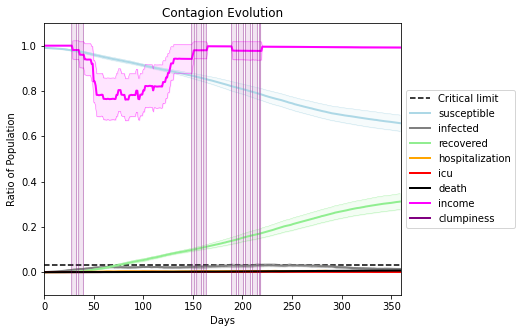

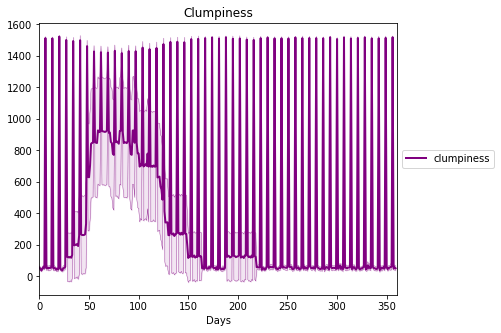

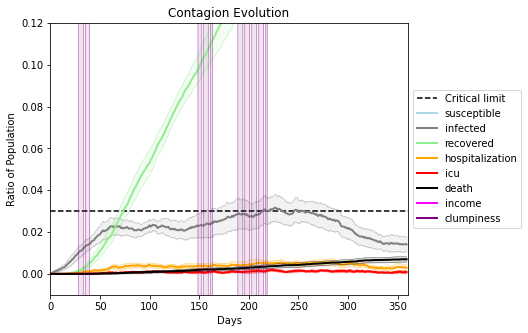

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5701, 9457, 6748, 9948, 6607, 6340, 5005, 1938, 493, 8624, 817, 4588, 4285, 8402, 6165, 7312, 6891, 1027, 7887, 9982]
Average similarity between family members is 0.1498645246803421 at temperature 0
Average similarity between family and home is 0.9998525361751943 at temperature -1
Average similarity between students and their classroom is 0.1809146619238217 at temperature 0
Average classroom occupancy is 1.7134146341463414 and number classrooms is 164
Average similarity between workers is 0.17023236748369935 at temperature 0
Average office occupancy is 3.3137254901960786 and number offices is 204
Average friend similarity for adults: 0.21433772377664467 for kids: 0.20949039727498703
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity -0.0023126520265669692
avg restaurant similarity -0.2669552350496149
avg restaurant similarity 0.15745670839223413
avg restaurant similarity 0.06258631037379463
avg restaurant similarity -0.09497288355694045
avg restaurant similarity 0.13781096614472982
avg restaurant similarity -0.1676149442781303
avg restaurant similarity 0.09160593681595355
avg restaurant similarity 0.012853454130524048
avg restaurant similarity 0.21133071161399172
avg restaurant similarity -0.3474462370324139
avg restaurant similarity 0.012893072449016406
avg restaurant similarity 0.1998266004079709
avg restaurant similarity -0.06151673209346739
avg restaurant similarity 0.27155873080098425
avg restaurant similarity 0.29872577645001347
avg restaurant similarity 0.31105542998242963
avg restaurant similarity 0.38678504003570224
avg restaurant similarity 0.3707874561585513
avg restaurant similarity -0.038213187591571995
avg restaurant similarity -0.20837797029571437
avg restaurant similarity 

avg restaurant similarity 0.03844271893416119
avg restaurant similarity 0.10662943223435727
avg restaurant similarity -0.09335711629559984
avg restaurant similarity 0.08199070420080011
avg restaurant similarity 0.06023544123050496
avg restaurant similarity -0.5541744389724019
avg restaurant similarity 0.16036693209227434
avg restaurant similarity -0.06383558342054209
avg restaurant similarity -0.08028376511153418
avg restaurant similarity 0.24419655493552989
avg restaurant similarity -0.23643098559403697
avg restaurant similarity -0.3310966465472217
avg restaurant similarity 0.3452060259057863
avg restaurant similarity 0.3223167846069027
avg restaurant similarity -0.08247697513867934
avg restaurant similarity 0.1402482911461762
avg restaurant similarity 0.05252583112886984
avg restaurant similarity 0.23171593132656196
avg restaurant similarity 0.01772863539261986
avg restaurant similarity -0.5618436885166098
avg restaurant similarity -0.2629847257393445
avg restaurant similarity 0.0275

avg restaurant similarity 0.10884181135174376
avg restaurant similarity 0.5253614188105961
avg restaurant similarity 0.33970121749995946
avg restaurant similarity 0.26153200615177147
avg restaurant similarity 0.018796188680078076
avg restaurant similarity 0.1442745926247285
avg restaurant similarity 0.15888930725138597
avg restaurant similarity 0.04802222912086447
avg restaurant similarity -0.2230334533660294
avg restaurant similarity -0.003921276100216819
avg restaurant similarity 0.21271547947519243
avg restaurant similarity -0.16619827070176185
avg restaurant similarity 0.013004439089977643
avg restaurant similarity 0.2875289783547139
avg restaurant similarity -0.17387332521121718
avg restaurant similarity -0.16439066561876856
avg restaurant similarity 0.2559979815300025
avg restaurant similarity 0.2203868811538778
avg restaurant similarity 0.17833741218531762
avg restaurant similarity 0.0859939894208881
avg restaurant similarity -0.3283150620312957
avg restaurant similarity 0.22905

avg restaurant similarity -0.12694405017104757
avg restaurant similarity 0.11063195517016643
avg restaurant similarity 0.14962440801030408
avg restaurant similarity 0.1580461697529722
avg restaurant similarity -0.04609919538615788
avg restaurant similarity -0.006172827912673445
avg restaurant similarity 0.3190301139290665
avg restaurant similarity 0.050859963031264444
avg restaurant similarity 0.1312911355959329
avg restaurant similarity -0.06919587923835088
avg restaurant similarity 0.14009381119363254
avg restaurant similarity -0.06874389481288513
avg restaurant similarity -0.18454758449757874
avg restaurant similarity -0.09571437176237568
avg restaurant similarity -0.07720380018401324
avg restaurant similarity 0.368078967646591
avg restaurant similarity 0.009018923184797897
avg restaurant similarity 0.3162859650288893
avg restaurant similarity -0.06692418717908385
avg restaurant similarity 0.021545090714397756
avg restaurant similarity 0.18149849897914566
avg restaurant similarity 0

avg restaurant similarity -0.25047834503409827
avg restaurant similarity 0.232403306029895
avg restaurant similarity -0.044226565851082825
avg restaurant similarity 0.050777011054071924
avg restaurant similarity 0.16971491638959266
avg restaurant similarity -0.09719443320337581
avg restaurant similarity -0.031866548820580196
avg restaurant similarity -0.04439053541335167
avg restaurant similarity 0.09576162581290783
avg restaurant similarity 0.01312155124157149
avg restaurant similarity -0.054532996978235826
avg restaurant similarity 0.07181175794685452
avg restaurant similarity 0.25994413572271824
avg restaurant similarity -0.2002674114115144
avg restaurant similarity 0.16060948276061296
avg restaurant similarity 0.11280922602182508
avg restaurant similarity 0.43958934144236383
avg restaurant similarity 0.2954734772217075
avg restaurant similarity 0.18529569170902932
avg restaurant similarity -0.0009673204320137351
avg restaurant similarity -0.10440722961615956
avg restaurant similari

avg restaurant similarity -0.026561479307508698
avg restaurant similarity 0.03390049576663762
avg restaurant similarity -0.13477753138087625
avg restaurant similarity -0.013952303139887507
avg restaurant similarity 0.13851593509805418
avg restaurant similarity -0.0019566835142480355
avg restaurant similarity -0.07113895642028815
avg restaurant similarity 0.06436242275165407
avg restaurant similarity -0.16255496931508803
avg restaurant similarity -0.024747323994095308
avg restaurant similarity 0.4764998788376769
avg restaurant similarity -0.14174437181780727
avg restaurant similarity 0.02074351346994827
avg restaurant similarity 0.12502637615395676
avg restaurant similarity 0.12502637615395676
avg restaurant similarity 0.1953590538472461
avg restaurant similarity 0.10056727016244163
avg restaurant similarity -0.10866235872936786
avg restaurant similarity 0.07661762284819593
avg restaurant similarity 0.10318492693258681
avg restaurant similarity -0.00605389491783308
avg restaurant simila

avg restaurant similarity 0.006682468139590142
avg restaurant similarity 0.0672831916086297
avg restaurant similarity 0.3242388455381041
Average similarity between family members is 0.15534630556160997 at temperature 0
Average similarity between family and home is 0.9998567667919945 at temperature -1
Average similarity between students and their classroom is 0.171315924137913 at temperature 0
Average classroom occupancy is 1.676300578034682 and number classrooms is 173
Average similarity between workers is 0.13469965499804143 at temperature 0
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.2095922641035723 for kids: 0.2170110385458627
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with ca

avg restaurant similarity 0.3345583782329452
avg restaurant similarity -0.2303344419779678
avg restaurant similarity 0.1892799817735391
avg restaurant similarity 0.056084914035046604
avg restaurant similarity -0.0074364612511081
avg restaurant similarity -0.05551098814918297
avg restaurant similarity 0.27896053492982187
avg restaurant similarity 0.03812931219516648
avg restaurant similarity -0.23364015815597555
avg restaurant similarity 0.1719760711615188
avg restaurant similarity 0.0660110582168193
avg restaurant similarity 0.13963687340353453
avg restaurant similarity 0.05756471885466083
avg restaurant similarity -0.01062087053922911
avg restaurant similarity 0.08623729476821448
avg restaurant similarity 0.058768785760471
avg restaurant similarity 0.1274599380418594
avg restaurant similarity 0.29868606566302336
avg restaurant similarity -0.007438422660475674
avg restaurant similarity 0.2537171533215677
avg restaurant similarity 0.3612624013953465
avg restaurant similarity 0.336172870

Average similarity between students and their classroom is 0.17525712959411946 at temperature 0
Average classroom occupancy is 1.6666666666666667 and number classrooms is 180
Average similarity between workers is 0.1416240212594772 at temperature 0
Average office occupancy is 3.1940298507462686 and number offices is 201
Average friend similarity for adults: 0.19989035491055232 for kids: 0.20362509668319267
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in th

avg restaurant similarity 0.10236191975295306
avg restaurant similarity 0.12100730514105881
avg restaurant similarity -0.06879149047473307
avg restaurant similarity 0.163347955008105
avg restaurant similarity 0.010084512296480089
avg restaurant similarity -0.008396769461333432
avg restaurant similarity 0.3541254342473462
avg restaurant similarity -0.040244718592783446
avg restaurant similarity 0.5347855279937721
avg restaurant similarity -0.05487642900840056
avg restaurant similarity -0.06879149047473307
avg restaurant similarity 0.8455953629972496
avg restaurant similarity 0.05044625084190855
avg restaurant similarity 0.5057656200876985
avg restaurant similarity 0.2534580147838583
avg restaurant similarity -0.17074031078141466
avg restaurant similarity 0.23766905127942622
avg restaurant similarity 0.08400267708758165
avg restaurant similarity 0.051807965308258375
avg restaurant similarity -0.05487267389683166
avg restaurant similarity -0.22003114329410456
avg restaurant similarity 0.1

avg restaurant similarity 0.23311687699430794
avg restaurant similarity 0.05536707653358785
avg restaurant similarity 0.09756830710509441
avg restaurant similarity 0.10774031918703043
avg restaurant similarity -0.1318580952021077
avg restaurant similarity 0.6566758128670083
avg restaurant similarity -0.02426041856396169
avg restaurant similarity -0.1057759375714529
avg restaurant similarity 0.06764283624795124
avg restaurant similarity -0.06393072345487415
avg restaurant similarity 0.1748635390035877
avg restaurant similarity -0.0761700792589843
avg restaurant similarity 0.2412705653950864
avg restaurant similarity 0.6947468400046257
avg restaurant similarity -0.17188512369453612
avg restaurant similarity -0.049020539793350686
avg restaurant similarity 0.22270787757642646
avg restaurant similarity 0.07509875419813153
avg restaurant similarity -0.008010844986168029
avg restaurant similarity 0.06817294333183614
avg restaurant similarity 0.476745712181625
avg restaurant similarity 0.01248

avg restaurant similarity -0.09464982282299615
avg restaurant similarity 0.19163992826330992
avg restaurant similarity 0.2237708968685434
avg restaurant similarity -0.42795681843444655
avg restaurant similarity -0.3214257434160681
avg restaurant similarity -0.34793320492381985
avg restaurant similarity 0.1850132202930164
avg restaurant similarity -0.005853875027029581
avg restaurant similarity 0.29589683068576095
avg restaurant similarity -0.14016633101485865
avg restaurant similarity -0.14754621877830892
avg restaurant similarity 0.17456700432674835
avg restaurant similarity 0.43599220512040426
avg restaurant similarity -0.08699803753534216
avg restaurant similarity 0.14245976181262035
avg restaurant similarity -0.11125070643115889
avg restaurant similarity 0.21717315291128467
avg restaurant similarity -0.34532837633893776
avg restaurant similarity -0.05839170713650499
avg restaurant similarity 0.27238838796201914
avg restaurant similarity 0.07968662332887652
avg restaurant similarity

avg restaurant similarity -0.12929445806026252
avg restaurant similarity 0.036016894185263534
avg restaurant similarity -0.14031864874151692
avg restaurant similarity -0.182784274745004
avg restaurant similarity -0.0772322556209947
avg restaurant similarity 0.33450913642151475
avg restaurant similarity 0.013009496597831405
avg restaurant similarity 0.2518565473342389
Average similarity between family members is 0.1367661349022535 at temperature 0
Average similarity between family and home is 0.9998576069151606 at temperature -1
Average similarity between students and their classroom is 0.18293708593901867 at temperature 0
Average classroom occupancy is 1.5161290322580645 and number classrooms is 186
Average similarity between workers is 0.1677138074467574 at temperature 0
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.20418935490197018 for kids: 0.21161602709220173
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.09714290803341473
avg restaurant similarity 0.042134002312644525
avg restaurant similarity 0.3500950538361567
avg restaurant similarity 0.05339089404485113
avg restaurant similarity -0.19775522373896023
avg restaurant similarity -0.11776826735014048
avg restaurant similarity 0.1847898211215746
avg restaurant similarity 0.12280915270166766
avg restaurant similarity 0.08610789152196822
avg restaurant similarity -0.08361431997507462
avg restaurant similarity 0.34672041042250934
avg restaurant similarity 0.3488150821382855
avg restaurant similarity 0.045769517956667644
avg restaurant similarity 0.027012357335337397
avg restaurant similarity 0.02494435968541519
avg restaurant similarity 0.3347609148744899
avg restaurant similarity -0.21468575733017747
avg restaurant similarity 0.00889777218220894
avg restaurant similarity 0.2757330198178376
avg restaurant similarity 0.00802279281589971
avg restaurant similarity 0.2246922199783787
avg restaurant similarity 0.42483

avg restaurant similarity -0.02616992774247509
avg restaurant similarity 0.2728308462158316
avg restaurant similarity -0.06679889285823751
avg restaurant similarity 0.051512866826678265
avg restaurant similarity -0.013472862673957586
avg restaurant similarity -0.19597837310401134
avg restaurant similarity -0.12476387973952033
avg restaurant similarity 0.24657705961975213
avg restaurant similarity -0.16225969415992592
avg restaurant similarity 0.01388082855519189
avg restaurant similarity -0.06964514744714659
avg restaurant similarity -0.0658471126910662
avg restaurant similarity 0.18743427447204347
avg restaurant similarity 0.650285019567915
avg restaurant similarity 0.11427088698526405
avg restaurant similarity 0.24628753264627956
avg restaurant similarity 0.35815426286933694
avg restaurant similarity 0.30685992426910413
avg restaurant similarity 0.20430878981580403
avg restaurant similarity -0.19054453444654262
avg restaurant similarity 0.005914274636513825
avg restaurant similarity 

avg restaurant similarity 0.2187590182320836
avg restaurant similarity -0.15985540889715413
avg restaurant similarity 0.022833772839802036
avg restaurant similarity 0.35815426286933694
avg restaurant similarity 0.1840176516004146
avg restaurant similarity 0.30772528699394613
avg restaurant similarity 0.06531642569836074
avg restaurant similarity 0.2502552024294237
avg restaurant similarity -0.04679151568187855
avg restaurant similarity 0.09886772234346634
avg restaurant similarity 0.14030089197963946
avg restaurant similarity -0.047231829927614336
avg restaurant similarity -0.11953817539006001
avg restaurant similarity 0.27498451293840037
avg restaurant similarity 0.27498451293840037
avg restaurant similarity -0.12459832935786369
avg restaurant similarity -0.1030024907911743
avg restaurant similarity 0.2213445146409166
avg restaurant similarity 0.20505109548349446
avg restaurant similarity -0.06697243686895418
avg restaurant similarity -0.17631248408677538
avg restaurant similarity -0.

avg restaurant similarity -0.10910829658595134
avg restaurant similarity -0.03177004190228791
avg restaurant similarity 0.23853358889992765
avg restaurant similarity 0.20977414624210167
avg restaurant similarity 0.11655634193470668
avg restaurant similarity 0.07741476013737017
avg restaurant similarity 0.07562693482842657
avg restaurant similarity 0.164262037294151
avg restaurant similarity -0.07048852230015216
avg restaurant similarity -0.09906123331288189
avg restaurant similarity -0.2993288306052249
avg restaurant similarity 0.15326589822193798
avg restaurant similarity -0.16725170314163085
avg restaurant similarity -0.1394022639863613
avg restaurant similarity 0.19801236703347294
avg restaurant similarity 0.0051063242693032175
avg restaurant similarity 0.02620172253845913
avg restaurant similarity -0.1447806939682637
avg restaurant similarity 0.06379273349771894
avg restaurant similarity -0.009448367128201851
avg restaurant similarity -0.1457489965561023
avg restaurant similarity 0

Average similarity between family and home is 0.9998560309328735 at temperature -1
Average similarity between students and their classroom is 0.15283729692359702 at temperature 0
Average classroom occupancy is 1.6158536585365855 and number classrooms is 164
Average similarity between workers is 0.14991595768244523 at temperature 0
Average office occupancy is 3.3497536945812807 and number offices is 203
Average friend similarity for adults: 0.2135246366388694 for kids: 0.21360528268440476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity 0.07286651824190007
avg restaurant similarity 0.2615470955555713
avg restaurant similarity 0.09721023496667926
avg restaurant similarity 0.17436546917430099
avg restaurant similarity 0.27459441440769516
avg restaurant similarity -0.026042469842742007
avg restaurant similarity 0.01740159314576148
avg restaurant similarity 0.17102467254614845
avg restaurant similarity 0.12059532511824757
avg restaurant similarity 0.4407674027078526
avg restaurant similarity 0.12101480264639179
avg restaurant similarity 0.1770116611772702
avg restaurant similarity -0.09817380960641012
avg restaurant similarity -0.4079451823672078
avg restaurant similarity 0.1414723160548912
avg restaurant similarity 0.4407674027078526
avg restaurant similarity -0.423873141254161
avg restaurant similarity 0.2198236397423505
avg restaurant similarity 0.12092930995815343
avg restaurant similarity 0.1675197307391108
avg restaurant similarity 0.056875752544804925
avg restaurant similarity -0.139826837

avg restaurant similarity -0.13946586977467265
avg restaurant similarity 0.15871129073022347
avg restaurant similarity 0.25524167840348305
avg restaurant similarity 0.18614452901738202
avg restaurant similarity 0.17025099253116593
avg restaurant similarity -0.006676459073457518
avg restaurant similarity 0.11611813622354739
avg restaurant similarity -0.19235496256359308
avg restaurant similarity 0.12433779862840715
avg restaurant similarity 0.013000645053598665
avg restaurant similarity 0.33186479885216547
avg restaurant similarity -0.079784533757356
avg restaurant similarity 0.40779213090258154
avg restaurant similarity 0.05622480618442072
avg restaurant similarity 0.6438132804685824
avg restaurant similarity 0.4950736674721911
avg restaurant similarity -0.11272479686101429
avg restaurant similarity 0.3832297214729339
avg restaurant similarity 0.2383509737933867
avg restaurant similarity 0.33186479885216547
avg restaurant similarity -0.21372002466015513
avg restaurant similarity 0.3557

avg restaurant similarity -0.01245191424432153
avg restaurant similarity 0.1221635176519435
avg restaurant similarity 0.09768366580389823
avg restaurant similarity -0.04381284630985625
avg restaurant similarity 0.03180385957344367
avg restaurant similarity 0.03178690830049882
avg restaurant similarity -0.13617922905963442
avg restaurant similarity 0.2674494376479013
avg restaurant similarity -0.08384222824777776
avg restaurant similarity -0.19590800025871738
avg restaurant similarity -0.12744014881273263
avg restaurant similarity 0.12698983147978368
avg restaurant similarity -0.05749112624409339
avg restaurant similarity 0.2874494560037632
avg restaurant similarity -0.03585036856128712
avg restaurant similarity 0.021812967582376663
avg restaurant similarity 0.5016578167849366
avg restaurant similarity -0.010763816464425854
avg restaurant similarity 0.2633187991455572
avg restaurant similarity 0.43720346066386884
avg restaurant similarity -0.20584409114006194
avg restaurant similarity -

Average friend similarity for adults: 0.21210727650439265 for kids: 0.20539712782421524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.3273080589817659
avg restaurant similarity 0.24144619765525377
avg restaurant similarity -0.21608966481371839
avg restaurant similarity -0.062086241676450486
avg restaurant similarity 0.11724985523055342
avg restaurant similarity -0.25775863310925273
avg restaurant similarity 0.0030608646840207428
avg restaurant similarity 0.26094044286438
avg restaurant similarity 0.11681364155460328
avg restaurant similarity 0.09282648538798532
avg restaurant similarity 0.010720242071257944
avg restaurant similarity 0.4614735275541956
avg restaurant similarity -0.009374920525749106
avg restaurant similarity 0.05488502365272256
avg restaurant similarity -0.2680733846879353
avg restaurant similarity 0.13981207812399146
avg restaurant similarity -0.2475452599171521
avg restaurant similarity 0.14996173777894856
avg restaurant similarity -0.006015739101475709
avg restaurant similarity -0.03486488443188515
avg restaurant similarity 0.5390008825162798
avg restaurant similarity 0.

avg restaurant similarity 0.48902698956085205
avg restaurant similarity -0.08271297331663327
avg restaurant similarity 0.05178151393218103
avg restaurant similarity 0.057101179311067625
avg restaurant similarity -0.1908293768760143
avg restaurant similarity 0.5292660944974416
avg restaurant similarity 0.17411880659871454
avg restaurant similarity 0.39307144412167516
Average similarity between family members is 0.149246795649673 at temperature 0
Average similarity between family and home is 0.9998571919574281 at temperature -1
Average similarity between students and their classroom is 0.17308460492581496 at temperature 0
Average classroom occupancy is 1.6023391812865497 and number classrooms is 171
Average similarity between workers is 0.16211499079149222 at temperature 0
Average office occupancy is 3.2780487804878047 and number offices is 205
Average friend similarity for adults: 0.22013940194968235 for kids: 0.2308636477797243
home_districts
[
Home (0,0) district with 1 Buildings
Homo

avg restaurant similarity 0.034561287422372196
avg restaurant similarity 0.5358607857882055
avg restaurant similarity 0.08746974207313656
avg restaurant similarity -0.2528418850721358
avg restaurant similarity 0.04663524507985352
avg restaurant similarity -0.22926150642443338
avg restaurant similarity 0.39888811373007443
avg restaurant similarity 0.20406307626128206
avg restaurant similarity 0.19015588541794992
avg restaurant similarity 0.009065299895991724
avg restaurant similarity -0.16661394009873498
avg restaurant similarity -0.5224256098768167
avg restaurant similarity 0.05891730966708467
avg restaurant similarity 0.0359553814120375
avg restaurant similarity -0.1086656083895416
avg restaurant similarity -0.05268939300700498
avg restaurant similarity 0.17323875090660396
avg restaurant similarity -0.2824101933484172
avg restaurant similarity -0.24827564754620662
avg restaurant similarity -0.21686825412673802
avg restaurant similarity -0.29751570772430547
avg restaurant similarity 0.

avg restaurant similarity 0.4069684780994738
avg restaurant similarity 0.06213134463714747
avg restaurant similarity 0.286578187992353
avg restaurant similarity 0.2637333528526264
avg restaurant similarity 0.06211007246508786
avg restaurant similarity 0.03139711597093103
avg restaurant similarity 0.13721492816634953
avg restaurant similarity 0.27219083524325954
avg restaurant similarity -0.019312661245445274
avg restaurant similarity 0.34256549340651987
avg restaurant similarity -0.10968767322874887
avg restaurant similarity 0.2670664491536985
avg restaurant similarity 0.2625931447552135
avg restaurant similarity -0.07633868428062794
avg restaurant similarity 0.05521198320600787
avg restaurant similarity -0.10254582172015925
avg restaurant similarity -0.030128185727489154
avg restaurant similarity 0.06826237579606152
avg restaurant similarity 0.14455209994533763
avg restaurant similarity 0.046244458244409425
avg restaurant similarity 0.13281686687591732
avg restaurant similarity 0.2004

Average similarity between workers is 0.14946446270545127 at temperature 0
Average office occupancy is 3.3366336633663365 and number offices is 202
Average friend similarity for adults: 0.21832674145322786 for kids: 0.2284073373303418
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 pe

avg restaurant similarity 0.023647591483848172
avg restaurant similarity 0.12958093813311003
avg restaurant similarity 0.12472790227703455
avg restaurant similarity 0.00601139769025863
avg restaurant similarity 0.15233789305424875
avg restaurant similarity -0.0034338216903475396
avg restaurant similarity -0.011054725744154392
avg restaurant similarity 0.1460564491770572
avg restaurant similarity 0.10620747797272144
avg restaurant similarity 0.2139203758346338
avg restaurant similarity -0.23617616181389126
avg restaurant similarity -0.06625769405793522
avg restaurant similarity 0.15074477975043304
avg restaurant similarity -0.028544438970291637
avg restaurant similarity 0.3768239326057754
avg restaurant similarity 0.5607899058965381
avg restaurant similarity 0.18005244101707701
avg restaurant similarity 0.2544839088133834
avg restaurant similarity 0.3126286541023573
avg restaurant similarity 0.24900352207386614
avg restaurant similarity 0.1301246799017554
avg restaurant similarity 0.416

avg restaurant similarity -0.013377370892905348
avg restaurant similarity 0.018183365707702612
avg restaurant similarity 0.052051559642117426
avg restaurant similarity 0.22074235237653528
avg restaurant similarity -0.045791078280215135
avg restaurant similarity 0.5429612524441905
avg restaurant similarity 0.1845097807225361
avg restaurant similarity 0.2685491512048366
avg restaurant similarity -0.2137138539903588
avg restaurant similarity 0.3296036664985633
avg restaurant similarity 0.16337286917344848
avg restaurant similarity 0.06770838328571047
avg restaurant similarity 0.17826802489357654
avg restaurant similarity 0.06826803215692466
avg restaurant similarity 0.47413854285846646
avg restaurant similarity 0.43763304471240566
avg restaurant similarity -0.02434299221955325
avg restaurant similarity 0.5791097070911633
avg restaurant similarity 0.03826818742889911
avg restaurant similarity 0.0057594005850405555
avg restaurant similarity 0.034404746395855834
avg restaurant similarity 0.2

avg restaurant similarity 0.03580002007372115
avg restaurant similarity -0.030445963039771498
avg restaurant similarity 0.36641066459360383
avg restaurant similarity 0.014422923251456832
avg restaurant similarity 0.5044134292853886
avg restaurant similarity 0.2069431735033382
avg restaurant similarity -0.03138068808411057
avg restaurant similarity 0.21254426410371202
avg restaurant similarity -0.1636915259604579
avg restaurant similarity 0.5205544726480393
avg restaurant similarity 0.1090212242890149
avg restaurant similarity 0.5189970826708874
avg restaurant similarity 0.0023405653210757105
avg restaurant similarity 0.1090212242890149
avg restaurant similarity 0.1808437734915751
avg restaurant similarity 0.014422923251456832
avg restaurant similarity 0.10164199727690149
avg restaurant similarity 0.43118670227716016
avg restaurant similarity 0.3882145554501605
avg restaurant similarity -0.03219678633248629
avg restaurant similarity -0.07639804336674108
avg restaurant similarity 0.07483

(<function dict.items>, <function dict.items>, <function dict.items>)

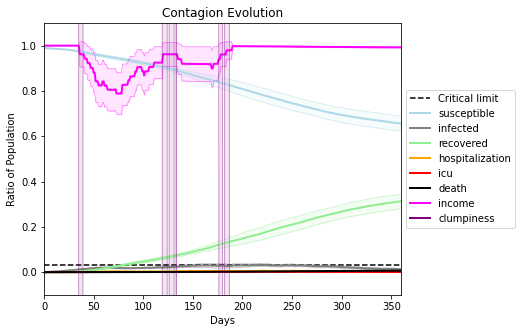

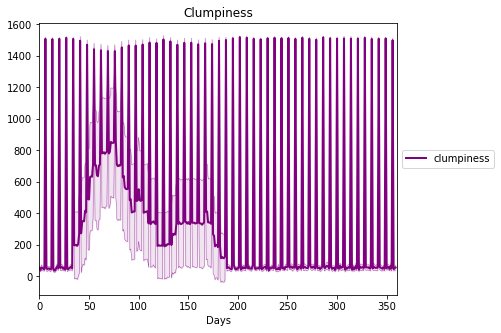

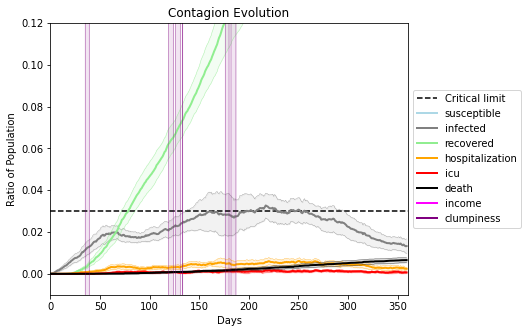

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6661, 1815, 8867, 9155, 934, 3001, 5674, 3220, 1194, 5406, 8398, 1352, 3247, 2326, 578, 3109, 1573, 1147, 2361, 1136]
Average similarity between family members is 0.0929219606581528 at temperature 0.33
Average similarity between family and home is 0.9998606896402374 at temperature -1
Average similarity between students and their classroom is 0.11694600602813869 at temperature 0.33
Average classroom occupancy is 1.6277777777777778 and number classrooms is 180
Average similarity between workers is 0.11050952424238736 at temperature 0.33
Average office occupancy is 3.147783251231527 and number offices is 203
Average friend similarity for adults: 0.16558774514666277 for kids: 0.17055938356741024
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.3470093522466948
avg restaurant similarity -0.07880599163379678
avg restaurant similarity 0.17238081234098368
avg restaurant similarity 0.26803656447315843
avg restaurant similarity 0.013668899169827955
avg restaurant similarity -0.0772680745365288
avg restaurant similarity 0.3135825760497412
avg restaurant similarity -0.010295816136523413
avg restaurant similarity 0.09836270317445608
avg restaurant similarity -0.42113569635739023
avg restaurant similarity -0.010827794921758324
avg restaurant similarity -0.2249331797492237
avg restaurant similarity 0.10985919554707461
avg restaurant similarity -0.08035853689563179
avg restaurant similarity -0.06897023645958272
avg restaurant similarity -0.057105124541727934
avg restaurant similarity -0.03128458747092905
avg restaurant similarity 0.10957799297576447
avg restaurant similarity -0.2250861091466474
avg restaurant similarity 0.2400216880507409
avg restaurant similarity 0.04974531959640088
avg restaurant similarity

avg restaurant similarity 0.2700226211858239
avg restaurant similarity 0.4145418760251351
avg restaurant similarity -0.3609474371787018
avg restaurant similarity -0.13709707052525716
avg restaurant similarity 0.12337978614405638
avg restaurant similarity 0.2397076053207606
avg restaurant similarity 0.15552934986229708
avg restaurant similarity -0.03359810506031274
avg restaurant similarity 0.010685062698988418
avg restaurant similarity 0.12922747698005882
avg restaurant similarity 0.20896280957955843
avg restaurant similarity -0.1876298170675536
avg restaurant similarity 0.13921665057833732
avg restaurant similarity 0.4715112584413425
avg restaurant similarity -0.4113789185955925
avg restaurant similarity -0.0014993991056019072
avg restaurant similarity -0.0369237997867674
avg restaurant similarity 0.29212843881279743
avg restaurant similarity -0.03790495033768658
avg restaurant similarity 0.5353215530638831
avg restaurant similarity 0.052933118763119326
avg restaurant similarity 0.225

avg restaurant similarity 0.17170419837499667
avg restaurant similarity -0.08201353434382283
avg restaurant similarity 0.3928399734088682
avg restaurant similarity 0.03388359146865287
avg restaurant similarity -0.07288390070567036
avg restaurant similarity -0.03359810506031274
avg restaurant similarity -0.007817617783627814
avg restaurant similarity -0.2438591548637652
avg restaurant similarity 0.2691094837322391
avg restaurant similarity 0.0869992938361204
avg restaurant similarity -0.007817617783627814
avg restaurant similarity -0.13948191539369512
avg restaurant similarity 0.20767478642425008
avg restaurant similarity 0.7875848959193957
avg restaurant similarity 0.030255430560192163
avg restaurant similarity 0.37106265220639
Average similarity between family members is 0.11986843796826253 at temperature 0.33
Average similarity between family and home is 0.9998435496164639 at temperature -1
Average similarity between students and their classroom is 0.1212995816593371 at temperature 0

avg restaurant similarity 0.047406333672352904
avg restaurant similarity 0.16622825185183507
avg restaurant similarity 0.34366590724710566
avg restaurant similarity -0.1586570065110267
avg restaurant similarity -0.2314171461724212
avg restaurant similarity -0.33110822665340445
avg restaurant similarity -0.09201548909555014
avg restaurant similarity 0.08721036194215691
avg restaurant similarity 0.083866038488404
avg restaurant similarity 0.26368395595026495
avg restaurant similarity -0.04062646857797811
avg restaurant similarity -0.18862877900426167
avg restaurant similarity 0.25061069202318004
avg restaurant similarity -0.008916385606480476
avg restaurant similarity 0.2401329678071992
avg restaurant similarity -0.16465217060153794
avg restaurant similarity 0.21113122623465455
avg restaurant similarity 0.27378376608744953
avg restaurant similarity 0.19273036183036496
avg restaurant similarity 0.33338043088377517
avg restaurant similarity 0.0017099915167994202
avg restaurant similarity 0

avg restaurant similarity 0.21113122623465455
avg restaurant similarity 0.4044919368149706
avg restaurant similarity 0.12039757538673285
avg restaurant similarity -0.18723391510487447
avg restaurant similarity 0.03863662044749028
avg restaurant similarity 0.11832379034956195
avg restaurant similarity -0.24226774316771932
avg restaurant similarity 0.18913827273252357
avg restaurant similarity 0.05901110956351996
avg restaurant similarity -0.07184784284191868
avg restaurant similarity 0.48028467031451616
avg restaurant similarity -0.3473948283647651
avg restaurant similarity -0.16131323362701205
avg restaurant similarity 0.34962198150234447
avg restaurant similarity 0.38980747254083764
avg restaurant similarity 0.08905677784261075
avg restaurant similarity 0.03695497849601356
avg restaurant similarity -0.07024025491071287
Average similarity between family members is 0.09670452995862788 at temperature 0.33
Average similarity between family and home is 0.9998522121163923 at temperature -1


avg restaurant similarity 0.22062696494398887
avg restaurant similarity 0.052490071562737474
avg restaurant similarity 0.0925141382852133
avg restaurant similarity 0.1471318277960093
avg restaurant similarity 0.14165114162084527
avg restaurant similarity 0.07037261366824996
avg restaurant similarity -0.12709043679562732
avg restaurant similarity 0.2443378526908918
avg restaurant similarity 0.12902001842311886
avg restaurant similarity 0.3234920859996493
avg restaurant similarity 0.18720413267260802
avg restaurant similarity -0.08498302729921103
avg restaurant similarity 0.19608835862304094
avg restaurant similarity -0.11556246355107777
avg restaurant similarity -0.06470073817421523
avg restaurant similarity 0.07037261366824996
avg restaurant similarity -0.06586554812831107
avg restaurant similarity -0.12109776875609443
avg restaurant similarity 0.26839611869663205
avg restaurant similarity -0.0724665403286067
avg restaurant similarity 0.4144642791489459
avg restaurant similarity 0.1596

avg restaurant similarity -0.2024090055030204
avg restaurant similarity 0.08119783011043784
avg restaurant similarity 0.08924789471899026
avg restaurant similarity -0.017106936566215397
avg restaurant similarity -0.43137506214194615
avg restaurant similarity 0.26901577621715345
avg restaurant similarity -0.014140132839895198
avg restaurant similarity 0.3324197606032251
avg restaurant similarity 0.1494371668474274
avg restaurant similarity -0.22796443023783625
avg restaurant similarity 0.26540578351032673
avg restaurant similarity 0.035323829830671546
avg restaurant similarity -0.043935138232153316
avg restaurant similarity -0.016085989393162844
avg restaurant similarity -0.00014372161594480848
avg restaurant similarity 0.189242932883523
avg restaurant similarity 0.4161279518539854
avg restaurant similarity 0.035320476188433494
avg restaurant similarity 0.26115029306063287
avg restaurant similarity 0.5332014936130268
avg restaurant similarity 0.0791084806978029
avg restaurant similarity

avg restaurant similarity 0.04761869974901497
avg restaurant similarity 0.5227373175899859
avg restaurant similarity 0.12302117724522253
avg restaurant similarity -0.15981481527853195
avg restaurant similarity -0.12890392873755496
avg restaurant similarity 0.05028382281325283
avg restaurant similarity 0.03427163118423618
avg restaurant similarity 0.16370988191029454
avg restaurant similarity 0.13601817298735325
avg restaurant similarity 0.3436561611245233
avg restaurant similarity -0.1526000151241364
avg restaurant similarity 0.13199510626319597
avg restaurant similarity 0.2867169321952636
avg restaurant similarity -0.3473210786758038
avg restaurant similarity 0.415821649683392
avg restaurant similarity 0.048166968911687494
avg restaurant similarity -0.05815371715237007
avg restaurant similarity 0.0788463678920462
avg restaurant similarity -0.3914614677224968
avg restaurant similarity 0.08870981676023314
avg restaurant similarity 0.09462364638090717
avg restaurant similarity -0.1332933

avg restaurant similarity -0.05759765158780186
avg restaurant similarity 0.029819263403095014
avg restaurant similarity 0.15958333964479907
avg restaurant similarity 0.3508917952568026
avg restaurant similarity 0.0692537286371735
avg restaurant similarity -0.21894672206272203
avg restaurant similarity 0.23923196071931602
avg restaurant similarity -0.027531387464570695
avg restaurant similarity 0.33648205527272945
avg restaurant similarity -0.04419027748747734
avg restaurant similarity 0.3436561611245233
avg restaurant similarity -0.1167224675829886
avg restaurant similarity -0.14601140959295394
avg restaurant similarity -0.05759765158780186
avg restaurant similarity 0.11759067413900696
avg restaurant similarity 0.25881158774669594
avg restaurant similarity 0.02243657049144962
avg restaurant similarity 0.023179489300060113
avg restaurant similarity 0.030753848439126708
avg restaurant similarity 0.1255418546873995
avg restaurant similarity -0.18813748911886857
avg restaurant similarity 0

avg restaurant similarity -0.26149693271869445
avg restaurant similarity 0.323242929603747
avg restaurant similarity 0.3540854168555909
avg restaurant similarity -0.12414992308518874
avg restaurant similarity -0.12499605372574778
avg restaurant similarity 0.1776608638572133
avg restaurant similarity 0.14166212377822646
avg restaurant similarity -0.010194802773365
avg restaurant similarity -0.46463521184712964
avg restaurant similarity 0.04411734039537085
avg restaurant similarity 0.15340686150543187
avg restaurant similarity 0.5041690969006025
avg restaurant similarity 0.0449729345281243
avg restaurant similarity 0.06462432356757795
avg restaurant similarity 0.483263333173537
avg restaurant similarity -0.22637641463331298
avg restaurant similarity -0.21370493372888405
avg restaurant similarity 0.10711960909496669
avg restaurant similarity 0.23322246526469176
avg restaurant similarity -0.24536706681647505
avg restaurant similarity 0.05782178384656088
avg restaurant similarity -0.3139189

avg restaurant similarity 0.5231897858382729
avg restaurant similarity 0.1725879091844341
avg restaurant similarity 0.16202091211570482
avg restaurant similarity 0.16949272920983774
avg restaurant similarity 0.23371765670766756
avg restaurant similarity 0.11056850479095093
avg restaurant similarity 0.09029377574961635
avg restaurant similarity -0.09679845775341832
avg restaurant similarity -0.03779770066381437
avg restaurant similarity 0.07447209500439853
avg restaurant similarity -0.10476606027616699
avg restaurant similarity 0.005157999948323257
avg restaurant similarity -0.2630672200029251
avg restaurant similarity 0.4580715482150639
avg restaurant similarity -0.036153009132100906
avg restaurant similarity 0.3540817064430436
avg restaurant similarity 0.09189500184954008
avg restaurant similarity -0.13488894998392917
avg restaurant similarity -0.11838490712675744
avg restaurant similarity 0.41972877738192094
avg restaurant similarity 0.6279921707358911
avg restaurant similarity 0.149

avg restaurant similarity 0.2119084283812798
avg restaurant similarity 0.05724017953684633
avg restaurant similarity 0.026828998837117597
avg restaurant similarity 0.4435764817256122
avg restaurant similarity 0.1213598478131674
Average similarity between family members is 0.09213224635289596 at temperature 0.33
Average similarity between family and home is 0.9998511744374995 at temperature -1
Average similarity between students and their classroom is 0.14237737939735293 at temperature 0.33
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.10635054661619998 at temperature 0.33
Average office occupancy is 3.310344827586207 and number offices is 203
Average friend similarity for adults: 0.17233772832297778 for kids: 0.17929992572853706
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people alloc

avg restaurant similarity -0.08198371800440143
avg restaurant similarity -0.06693850545182506
avg restaurant similarity -0.5337479807470725
avg restaurant similarity 0.033508933980148085
avg restaurant similarity -0.04807359214594498
avg restaurant similarity 0.1344870227247866
avg restaurant similarity -0.030861312637297137
avg restaurant similarity -0.35149822375426215
avg restaurant similarity -0.28913011267156213
avg restaurant similarity 0.03576362345842355
avg restaurant similarity 0.28707238414923114
avg restaurant similarity 0.00787541656239503
avg restaurant similarity -0.21155674598109056
avg restaurant similarity 0.03977434259393399
avg restaurant similarity 0.18910727192810256
avg restaurant similarity 0.3599241806076578
avg restaurant similarity 0.09608536835681439
avg restaurant similarity -0.38871744431549166
avg restaurant similarity 0.042255454464327796
avg restaurant similarity -0.08286496553055167
avg restaurant similarity 0.1391871268689216
avg restaurant similarity

avg restaurant similarity 0.0580741379483147
avg restaurant similarity -0.0021926989800360175
avg restaurant similarity -0.13329229776305693
avg restaurant similarity 0.23324905593651266
avg restaurant similarity -0.2501728773345137
avg restaurant similarity -0.25368162196663574
avg restaurant similarity 0.15426494267668284
avg restaurant similarity 0.25053455417106746
avg restaurant similarity -0.11218542350821799
avg restaurant similarity 0.0722204368704804
avg restaurant similarity 0.4955069017423864
avg restaurant similarity -0.39154597145023773
avg restaurant similarity 0.07266765977067288
avg restaurant similarity 0.19516247097605532
avg restaurant similarity 0.21585577672279793
avg restaurant similarity 0.04872223598102102
avg restaurant similarity 0.2919398424017174
avg restaurant similarity -0.01729417976562804
avg restaurant similarity -0.06861382417088674
avg restaurant similarity -0.01914271809598496
avg restaurant similarity 0.435872334501437
avg restaurant similarity 0.26

avg restaurant similarity -0.12834852077878772
avg restaurant similarity -0.21646018781860207
avg restaurant similarity 0.22082299989267612
avg restaurant similarity 0.14439636457201613
avg restaurant similarity -0.2249954035208537
avg restaurant similarity 0.3064252373368639
avg restaurant similarity 0.022657233711878028
avg restaurant similarity 0.25250296418122165
avg restaurant similarity -0.1266675978711731
avg restaurant similarity -0.09977065509286026
Average similarity between family members is 0.10087548279041444 at temperature 0.33
Average similarity between family and home is 0.99984475229907 at temperature -1
Average similarity between students and their classroom is 0.08496942737035115 at temperature 0.33
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.10522409750373296 at temperature 0.33
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.17

avg restaurant similarity 0.23462460896492546
avg restaurant similarity 0.11569859603487698
avg restaurant similarity 0.11569859603487698
avg restaurant similarity 0.35212448655316636
avg restaurant similarity -0.02735741174708388
avg restaurant similarity -0.10130442026348943
avg restaurant similarity 0.0485611763286484
avg restaurant similarity 0.2599832880156116
avg restaurant similarity 0.4582168418145693
avg restaurant similarity 0.21216535474272036
avg restaurant similarity -0.24176321236792386
avg restaurant similarity -0.3244809490184187
avg restaurant similarity -0.1467500766660766
avg restaurant similarity -0.14168377509282998
avg restaurant similarity -0.2275361127372301
avg restaurant similarity -0.05882754267569148
avg restaurant similarity 0.10168764761999921
avg restaurant similarity -0.10253886567776069
avg restaurant similarity -0.4662870209047718
avg restaurant similarity -0.34377043166081694
avg restaurant similarity 0.5313398431381213
avg restaurant similarity 0.058

Average similarity between workers is 0.09172803701917223 at temperature 0.33
Average office occupancy is 3.2413793103448274 and number offices is 203
Average friend similarity for adults: 0.16686276796651073 for kids: 0.17994338984030597
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total 

avg restaurant similarity -0.1088287275609835
avg restaurant similarity 0.18012033656456197
avg restaurant similarity 0.27110522813975146
avg restaurant similarity -0.13945445396270756
avg restaurant similarity -0.015877184484977186
avg restaurant similarity 0.12859844382208108
avg restaurant similarity -0.23029871247393233
avg restaurant similarity 0.21127158211152494
avg restaurant similarity -0.055903236952732235
avg restaurant similarity -0.07647459966304482
avg restaurant similarity -0.2344709614933273
avg restaurant similarity -0.1566496208807185
avg restaurant similarity 0.11099922619776742
avg restaurant similarity -0.19333125573114648
avg restaurant similarity 0.6673432970460895
avg restaurant similarity 0.04014274018786651
avg restaurant similarity 0.08265378458136546
avg restaurant similarity -0.05633805530677091
avg restaurant similarity 0.008945388124332793
avg restaurant similarity -0.38471741949567345
avg restaurant similarity 0.3426682527064939
avg restaurant similarity

avg restaurant similarity 0.08604326209211362
avg restaurant similarity -0.028590467574180673
avg restaurant similarity -0.14313004952493802
avg restaurant similarity 0.04320617852013995
avg restaurant similarity -0.07532417158640711
avg restaurant similarity 0.16278528141084933
avg restaurant similarity 0.4918899737832739
avg restaurant similarity -0.015022988118728708
avg restaurant similarity -0.10288873596475691
avg restaurant similarity -0.029160119598989356
avg restaurant similarity -0.05440364334608573
avg restaurant similarity -0.2163147246177131
avg restaurant similarity -0.10300965591199175
avg restaurant similarity -0.2493066906773008
avg restaurant similarity 0.08138391968500432
avg restaurant similarity -0.13321003020178201
avg restaurant similarity -0.07478341020582091
avg restaurant similarity 0.026241835786200485
avg restaurant similarity -0.08702516293168254
avg restaurant similarity -0.17702207102956083
avg restaurant similarity -0.3718627952224383
avg restaurant simi

Average friend similarity for adults: 0.16799978978151112 for kids: 0.17884191173764083
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.19220858210236824
avg restaurant similarity 0.04745630926736316
avg restaurant similarity 0.25171752660989255
avg restaurant similarity 0.0071914647999048245
avg restaurant similarity 0.05463527851433334
avg restaurant similarity 0.26286993292000005
avg restaurant similarity 0.32563127591603175
avg restaurant similarity 0.11844180324690244
avg restaurant similarity -0.10448700085199689
avg restaurant similarity -0.032420307693106956
avg restaurant similarity 0.11259749665966795
avg restaurant similarity 0.24549296143688337
avg restaurant similarity 0.2306478877988517
avg restaurant similarity 0.10432599518536652
avg restaurant similarity 0.006343352135521037
avg restaurant similarity 0.4333650821292792
avg restaurant similarity -0.07286232170062955
avg restaurant similarity -0.1669087925617296
avg restaurant similarity -0.15058010721757142
avg restaurant similarity -0.07520475003292626
avg restaurant similarity 0.11844180324690244
avg restaurant similarity -

avg restaurant similarity 0.267613481700082
avg restaurant similarity 0.23674215319940847
avg restaurant similarity 0.08693387931523275
avg restaurant similarity 0.04722586555915205
avg restaurant similarity 0.2982351943596346
avg restaurant similarity 0.15481513405968905
avg restaurant similarity -0.05997243420706344
avg restaurant similarity 0.015332544046932796
avg restaurant similarity 0.1938664285258588
avg restaurant similarity 0.03344197571967108
avg restaurant similarity -0.3274866559156849
avg restaurant similarity 0.310369129922377
avg restaurant similarity 0.357502980421617
avg restaurant similarity 0.1373619607694203
avg restaurant similarity -0.10201745381555673
avg restaurant similarity 0.05147131779749782
avg restaurant similarity 0.04513246723251535
avg restaurant similarity 0.3327241666859806
avg restaurant similarity 0.1473446762728582
avg restaurant similarity 0.217101711197408
avg restaurant similarity 0.012162119901172311
avg restaurant similarity 0.243617505134596

avg restaurant similarity -0.21945904115695442
avg restaurant similarity 0.02804589999468983
avg restaurant similarity 0.3340568287328537
avg restaurant similarity -0.06408312993318026
avg restaurant similarity 0.2490045067605518
avg restaurant similarity 0.21138235880843162
avg restaurant similarity 0.32442058726566403
avg restaurant similarity -0.011976574249902894
avg restaurant similarity -0.1060409574520101
avg restaurant similarity -0.07144596522158626
avg restaurant similarity -0.022252882932299087
avg restaurant similarity 0.07964136826847829
avg restaurant similarity -0.006699814241847452
avg restaurant similarity -0.11692402801068791
avg restaurant similarity -0.000388319812409027
avg restaurant similarity -0.20166240668029098
avg restaurant similarity -0.01586238279323543
avg restaurant similarity 0.26206580133382107
avg restaurant similarity 0.2068075013141553
avg restaurant similarity -0.010623580755973472
avg restaurant similarity -0.1104390666253605
avg restaurant simila

avg restaurant similarity 0.47513922656719243
avg restaurant similarity -0.2373744455070123
avg restaurant similarity 0.09739250356412357
avg restaurant similarity -0.11039541288046104
avg restaurant similarity 0.21646883970647657
avg restaurant similarity -0.04811313785873396
avg restaurant similarity -0.22259833061909462
avg restaurant similarity -0.15946699936125397
avg restaurant similarity 0.2619160805833025
avg restaurant similarity 0.029818859570273373
avg restaurant similarity -0.19472467617539527
avg restaurant similarity 0.06370143484737822
Average similarity between family members is 0.07276967929744199 at temperature 0.33
Average similarity between family and home is 0.9998684723024508 at temperature -1
Average similarity between students and their classroom is 0.1479517898356153 at temperature 0.33
Average classroom occupancy is 1.5714285714285714 and number classrooms is 168
Average similarity between workers is 0.12148084579016102 at temperature 0.33
Average office occup

avg restaurant similarity 0.447509782557445
avg restaurant similarity -0.18557624495969013
avg restaurant similarity 0.3773012546370734
avg restaurant similarity 0.09362526970988377
avg restaurant similarity -0.030071666269792685
avg restaurant similarity 0.6308560720198004
avg restaurant similarity 0.02610950133917933
avg restaurant similarity 0.08099197422240664
avg restaurant similarity -0.3287751116272566
avg restaurant similarity -0.006703429923088103
avg restaurant similarity 0.12881779502898977
avg restaurant similarity 0.0189236096468461
avg restaurant similarity 0.10883203169375344
avg restaurant similarity 0.1445656099990011
avg restaurant similarity -0.009511874993440833
avg restaurant similarity 0.22581245251917437
avg restaurant similarity -0.15363990980512182
avg restaurant similarity 0.04256880339723071
avg restaurant similarity 0.08099197422240664
avg restaurant similarity -0.05597265772332951
avg restaurant similarity -0.1595479084320422
avg restaurant similarity 0.542

avg restaurant similarity -0.10914142347182827
avg restaurant similarity 0.4408457001455861
avg restaurant similarity 0.3478813311620225
avg restaurant similarity 0.33237362448138047
avg restaurant similarity 0.1614838205874626
avg restaurant similarity 0.18525441670285991
avg restaurant similarity -0.01357809458410661
avg restaurant similarity 0.09313580539081288
avg restaurant similarity 0.12364544240161018
avg restaurant similarity 0.918245703829134
avg restaurant similarity -0.2668542330850564
avg restaurant similarity 0.28058475613623424
avg restaurant similarity 0.21754184575254437
avg restaurant similarity 0.4059108426611032
avg restaurant similarity 0.478637850967859
avg restaurant similarity 0.2903661753113905
avg restaurant similarity 0.01839398692429127
avg restaurant similarity -0.17504916455935915
avg restaurant similarity -0.16079308750148577
avg restaurant similarity -0.0579043916126476
avg restaurant similarity 0.21722558167950792
avg restaurant similarity 0.03909623756

avg restaurant similarity 0.0037871992786786615
avg restaurant similarity 0.26110372718615
avg restaurant similarity 0.21744688035387735
avg restaurant similarity -0.2679775603921674
avg restaurant similarity -0.035376047779935804
avg restaurant similarity 0.33062625019968794
avg restaurant similarity -0.05461871334583991
avg restaurant similarity 0.4517325068972527
avg restaurant similarity 0.36093221890663485
avg restaurant similarity -0.3630875590642571
avg restaurant similarity 0.36617870647216993
avg restaurant similarity 0.14155575057624764
avg restaurant similarity -0.3630875590642571
avg restaurant similarity 0.1716498863631278
avg restaurant similarity 0.6394672968803019
avg restaurant similarity 0.03537191798489503
avg restaurant similarity 0.12558567865994924
avg restaurant similarity 0.06438560182430297
Average similarity between family members is 0.11713461582046192 at temperature 0.33
Average similarity between family and home is 0.9998588609242705 at temperature -1
Avera

avg restaurant similarity 0.06983485516201562
avg restaurant similarity 0.11355287808633474
avg restaurant similarity -0.10690999749595823
avg restaurant similarity -0.08462200074713604
avg restaurant similarity -0.1108388197390353
avg restaurant similarity -0.11693621752182098
avg restaurant similarity -0.0054956521556833796
avg restaurant similarity 0.3740561719347114
avg restaurant similarity 0.214659438643506
avg restaurant similarity 0.13636217861556016
avg restaurant similarity 0.6980205011369568
avg restaurant similarity -0.1752707054939172
avg restaurant similarity 0.3527014592125962
avg restaurant similarity -0.3599863699320687
avg restaurant similarity -0.44651517945757796
avg restaurant similarity -0.0290913548004227
avg restaurant similarity 0.25438546296253617
avg restaurant similarity -0.08716615346583964
avg restaurant similarity -0.2471363275213624
avg restaurant similarity 0.09970472698126487
avg restaurant similarity 0.13614756874769857
avg restaurant similarity -0.04

Average similarity between workers is 0.1130573715242189 at temperature 0.33
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.16602819587985587 for kids: 0.17240176612531694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity -0.2290575302201215
avg restaurant similarity 0.4587799894935011
avg restaurant similarity -0.20435221468225662
avg restaurant similarity -0.28572373424932757
avg restaurant similarity 0.2585507220546628
avg restaurant similarity 0.46189376862083803
avg restaurant similarity 0.028113529181780714
avg restaurant similarity -0.23193605074876733
avg restaurant similarity 0.046920392854541984
avg restaurant similarity -0.24254420805634197
avg restaurant similarity 0.3213125818354262
avg restaurant similarity -0.13494556443605604
avg restaurant similarity -0.3071068529183537
avg restaurant similarity -0.09613394832067496
avg restaurant similarity -0.274715240368907
avg restaurant similarity -0.23713990149244701
avg restaurant similarity -0.09584483513944125
avg restaurant similarity -7.084513353443345e-05
avg restaurant similarity -0.2539612578242262
avg restaurant similarity 0.0425594360478495
avg restaurant similarity -0.033554278165277035
avg restaurant similarit

avg restaurant similarity -0.25617353191581926
avg restaurant similarity -0.019537923125383085
avg restaurant similarity -0.20114009943928332
avg restaurant similarity -0.19519907025432576
avg restaurant similarity 0.019294937773072063
avg restaurant similarity 0.11336563238382312
avg restaurant similarity 0.02584461778807734
avg restaurant similarity -0.13455875887421936
avg restaurant similarity 0.07347585227831781
avg restaurant similarity -0.06463193893136032
avg restaurant similarity 0.32001500146384754
avg restaurant similarity 0.17230471153573293
avg restaurant similarity 0.23020779272824837
avg restaurant similarity 0.03514954219946312
avg restaurant similarity -0.040225622651710244
avg restaurant similarity -0.018414009664425107
avg restaurant similarity -0.034755675487222186
avg restaurant similarity 0.11691223388485249
avg restaurant similarity 0.2712417959380522
avg restaurant similarity -0.032201651205699205
avg restaurant similarity -0.23713990149244701
avg restaurant sim

avg restaurant similarity 0.07624577886407786
avg restaurant similarity 0.27026398018202263
avg restaurant similarity 0.010816905387741133
avg restaurant similarity 0.21799127201513355
avg restaurant similarity -0.013074288750990343
avg restaurant similarity 0.013483577153579396
avg restaurant similarity 0.09402093281040179
avg restaurant similarity -0.16583812635244755
avg restaurant similarity -0.19085121475292732
avg restaurant similarity 0.19146233740151242
avg restaurant similarity -0.020469687339254222
avg restaurant similarity 0.1444987066042339
avg restaurant similarity -0.0005193586813169865
avg restaurant similarity -0.0005193586813169865
avg restaurant similarity -0.3451598298584745
avg restaurant similarity -0.020721770885680224
avg restaurant similarity 0.03056586070829279
avg restaurant similarity 0.09304262021395393
avg restaurant similarity 0.2934877443900795
avg restaurant similarity 0.3064638900229659
avg restaurant similarity -0.014835487504098036
avg restaurant simi

avg restaurant similarity -0.054678636119828726
avg restaurant similarity -0.024477406270352275
avg restaurant similarity -0.043122876665506654
avg restaurant similarity -0.12636018154142356
avg restaurant similarity -0.5328759664171627
avg restaurant similarity 0.06383702262296798
avg restaurant similarity 0.16501324268493045
avg restaurant similarity 0.13935141949824953
avg restaurant similarity -0.012708560353072301
avg restaurant similarity -0.1932985077260415
avg restaurant similarity -0.10485240122874091
avg restaurant similarity -0.30838933427326093
avg restaurant similarity 0.006052733708957286
avg restaurant similarity -0.028467494887814183
avg restaurant similarity 0.034132023938331105
avg restaurant similarity 0.08848509865311623
avg restaurant similarity 0.05961077592177086
avg restaurant similarity 0.06080300284047596
avg restaurant similarity 0.20538138076884888
avg restaurant similarity 0.16857707423355814
avg restaurant similarity 0.39460618660877844
avg restaurant simi

avg restaurant similarity 0.13158051836712564
avg restaurant similarity 0.03495938400755166
avg restaurant similarity 0.05544003958915866
avg restaurant similarity 0.5145726693394698
avg restaurant similarity -0.09622892162448538
avg restaurant similarity 0.09875968400323255
avg restaurant similarity -0.01379085897638141
avg restaurant similarity 0.133923092989025
avg restaurant similarity -0.3487486502581991
avg restaurant similarity 0.4120981867426954
avg restaurant similarity 0.3227170098246145
avg restaurant similarity 0.10830793756475694
avg restaurant similarity -0.06102276124175347
avg restaurant similarity 0.4849517720793948
avg restaurant similarity -0.004509653387183371
avg restaurant similarity 0.5145726693394698
avg restaurant similarity 0.020489886544071946
avg restaurant similarity 0.24385464381007155
avg restaurant similarity 0.0891372518170856
avg restaurant similarity 0.12396842534211104
avg restaurant similarity 0.21127916419872284
avg restaurant similarity 0.09650178

avg restaurant similarity 0.08063466949105694
avg restaurant similarity 0.3703735882757615
avg restaurant similarity 0.09980597835218012
avg restaurant similarity 0.0901015787439153
avg restaurant similarity -0.09797101982246688
using average of time series:
stats on susceptible:
data: [0.7956460206460207, 0.8808444444444445, 0.8909645909645911, 0.7901459651459651, 0.8812742812742812, 0.8362526362526362, 0.7763194444444446, 0.8406111111111111, 0.8487845487845487, 0.8265500000000001, 0.6932027777777777, 0.7918877833056938, 0.8312277777777777, 0.8206194444444445, 0.792911111111111, 0.7476944444444443, 0.763413888888889, 0.8889638139638139, 0.7863775113775113, 0.8865995115995116]
min:
0.6932027777777777
max:
0.8909645909645911
std:
0.05190441130265229
mean:
0.8185145553879509
median:
0.8235847222222223
95% confidence interval for the mean:
(0.7935914766945718,0.8434376340813301)
using average of time series:
stats on infected:
data: [0.0275002775002775, 0.012366666666666666, 0.01283438783

(<function dict.items>, <function dict.items>, <function dict.items>)

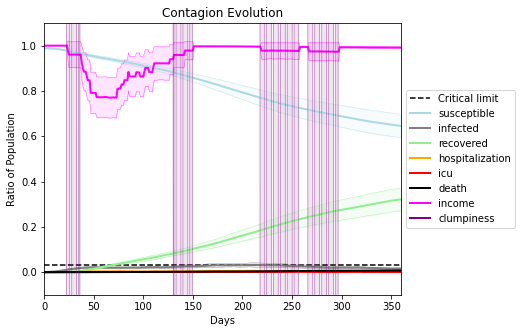

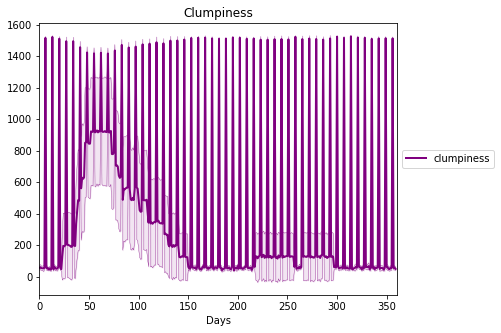

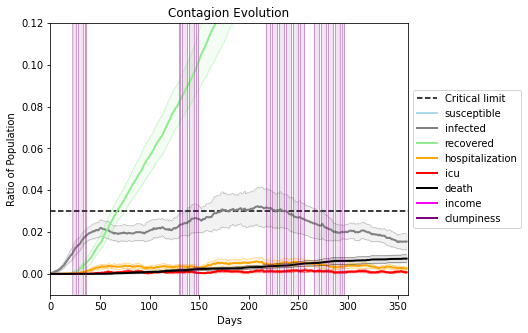

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8649, 6274, 1923, 2653, 7249, 5262, 8097, 4800, 5567, 1235, 1355, 315, 1893, 6024, 2073, 6457, 3411, 5482, 314, 5242]
Average similarity between family members is 0.05633038834068006 at temperature 0.66
Average similarity between family and home is 0.9998613178536702 at temperature -1
Average similarity between students and their classroom is 0.060575871729340106 at temperature 0.66
Average classroom occupancy is 1.5611111111111111 and number classrooms is 180
Average similarity between workers is 0.08127520141550697 at temperature 0.66
Average office occupancy is 3.407035175879397 and number offices is 199
Average friend similarity for adults: 0.1351783848838773 for kids: 0.12674371214503669
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.012195502538573912
avg restaurant similarity 0.072571679984517
avg restaurant similarity 0.18129664722802485
avg restaurant similarity 0.008929828808609161
avg restaurant similarity 0.20184786501412236
avg restaurant similarity 0.26023491723309794
avg restaurant similarity 0.17106984839606
avg restaurant similarity 0.19474611978506748
avg restaurant similarity 0.060339774540826924
avg restaurant similarity -0.13876717064600796
avg restaurant similarity 0.3370906929663556
avg restaurant similarity 0.5353686578082277
avg restaurant similarity 0.2089199148331999
avg restaurant similarity 0.24510436135083596
avg restaurant similarity -0.03200036886031944
avg restaurant similarity -0.28017226230315606
avg restaurant similarity 0.02310489152998744
avg restaurant similarity -0.024501779287810714
avg restaurant similarity 0.07042427824988837
avg restaurant similarity -0.32217852439645334
avg restaurant similarity -0.1135816315936943
avg restaurant similarity -0.1547

avg restaurant similarity 0.19629271353993263
avg restaurant similarity -0.06835514541094233
avg restaurant similarity -0.24437054515791862
avg restaurant similarity 0.24309232859263388
avg restaurant similarity 0.2714820298241135
avg restaurant similarity 0.1040641981853579
avg restaurant similarity -0.27867778904966145
avg restaurant similarity -0.38857288046706406
avg restaurant similarity -0.029405607535011657
avg restaurant similarity 0.2877042138649808
avg restaurant similarity -0.3780991286409569
avg restaurant similarity -0.10725475442318862
avg restaurant similarity -0.27934115788692115
avg restaurant similarity 0.034254986425119906
avg restaurant similarity -0.04085437496433783
avg restaurant similarity 0.19629271353993263
avg restaurant similarity -0.12226051742975819
avg restaurant similarity -0.10695215800537675
avg restaurant similarity -0.4232929750400944
avg restaurant similarity -0.04695320526397996
avg restaurant similarity -0.008002169054065686
avg restaurant similar

avg restaurant similarity 0.3589795512302896
avg restaurant similarity 0.04532218717519492
avg restaurant similarity 0.04532218717519492
avg restaurant similarity -0.2418324356753473
avg restaurant similarity -0.27934115788692115
avg restaurant similarity -0.035573155119158206
avg restaurant similarity 0.08723609632401386
Average similarity between family members is 0.05553146704956344 at temperature 0.66
Average similarity between family and home is 0.9998414176454468 at temperature -1
Average similarity between students and their classroom is 0.07370098413735963 at temperature 0.66
Average classroom occupancy is 1.5964912280701755 and number classrooms is 171
Average similarity between workers is 0.04173130175804615 at temperature 0.66
Average office occupancy is 3.3686868686868685 and number offices is 198
Average friend similarity for adults: 0.11985939045308373 for kids: 0.12886103736023774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each w

avg restaurant similarity 0.2327959541853304
avg restaurant similarity -0.007545526692694945
avg restaurant similarity 0.11071880524290263
avg restaurant similarity -0.23862111114685886
avg restaurant similarity -0.176791417437898
avg restaurant similarity 0.08633151219421813
avg restaurant similarity -0.017973077009056565
avg restaurant similarity 0.1778356669424351
avg restaurant similarity -0.4504901005378009
avg restaurant similarity 0.11376163667140451
avg restaurant similarity -0.13594636797197543
avg restaurant similarity -0.04451524741512711
avg restaurant similarity 0.24820423192052604
avg restaurant similarity 0.25847294560909206
avg restaurant similarity -0.09809404270003419
avg restaurant similarity 0.3214811259730141
avg restaurant similarity -0.25012477254858023
avg restaurant similarity 0.1070841325223144
avg restaurant similarity -0.07245479933143746
avg restaurant similarity -0.46088208137445147
avg restaurant similarity -0.11739729901651796
avg restaurant similarity -

avg restaurant similarity 0.47473630919739473
avg restaurant similarity -0.33015947582708904
avg restaurant similarity -0.04047252210048536
avg restaurant similarity -0.4732471215063891
avg restaurant similarity -0.13175972541149794
avg restaurant similarity 0.3412526364564225
avg restaurant similarity 0.3024101824728842
avg restaurant similarity 0.5798977913625563
avg restaurant similarity -0.03183494174811712
avg restaurant similarity 0.22537665469027532
avg restaurant similarity -0.0024482175959604177
avg restaurant similarity 0.11371435541330696
avg restaurant similarity -0.21269640855508465
avg restaurant similarity 0.2091689519324923
avg restaurant similarity 0.2599370198299432
avg restaurant similarity -0.6113560846177148
avg restaurant similarity -0.10099051770681185
avg restaurant similarity 0.3412526364564225
avg restaurant similarity 0.017779234913347052
avg restaurant similarity 0.4042453929634047
avg restaurant similarity -0.23749132857641203
Average similarity between fam

avg restaurant similarity 0.012370799361498689
avg restaurant similarity -0.1505856050462404
avg restaurant similarity -0.16796544923631912
avg restaurant similarity -0.2789226888996939
avg restaurant similarity -0.034464270367625435
avg restaurant similarity -0.0707596225236942
avg restaurant similarity 0.3107446525544544
avg restaurant similarity -0.20981283846954146
avg restaurant similarity -0.26727476690759067
avg restaurant similarity -0.06898507817976753
avg restaurant similarity 0.06063341832997577
avg restaurant similarity -0.38260847468324555
avg restaurant similarity -0.2534245347473162
avg restaurant similarity 0.07797869369896146
avg restaurant similarity -0.3080178906265166
avg restaurant similarity 0.2296770204573099
avg restaurant similarity -0.1988040374555779
avg restaurant similarity -0.13013331337651746
avg restaurant similarity -0.004512134732350007
avg restaurant similarity 0.6287790666614486
avg restaurant similarity -0.3046007796966059
avg restaurant similarity 

Average similarity between family members is 0.06891329455495551 at temperature 0.66
Average similarity between family and home is 0.9998582083344267 at temperature -1
Average similarity between students and their classroom is 0.09865801793472942 at temperature 0.66
Average classroom occupancy is 1.5529411764705883 and number classrooms is 170
Average similarity between workers is 0.09579221069329483 at temperature 0.66
Average office occupancy is 3.3891625615763545 and number offices is 203
Average friend similarity for adults: 0.13110206472601527 for kids: 0.13403117597414943
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (

avg restaurant similarity -0.060698717552918884
avg restaurant similarity -0.00013361165505772904
avg restaurant similarity 0.08007824607816638
avg restaurant similarity -0.10112526597959123
avg restaurant similarity 0.1291901391655422
avg restaurant similarity 0.035976745220133444
avg restaurant similarity -0.020906280493651862
avg restaurant similarity -0.018175870539762717
avg restaurant similarity 0.21106811694819322
avg restaurant similarity -0.021294880792085177
avg restaurant similarity 0.3514749097680958
avg restaurant similarity 0.27926840886397913
avg restaurant similarity 0.2262414633508661
avg restaurant similarity 0.128743317023908
avg restaurant similarity -0.10411605695244985
avg restaurant similarity 0.26142150187353086
avg restaurant similarity -0.1692586037344884
avg restaurant similarity 0.08730288680926764
avg restaurant similarity 0.1454151844845468
avg restaurant similarity 0.29780638762127676
avg restaurant similarity 0.20825155382711263
avg restaurant similarity

avg restaurant similarity -0.0022681816655667703
avg restaurant similarity 0.19462189703013755
avg restaurant similarity -0.1311354545268796
avg restaurant similarity 0.10447075000491811
avg restaurant similarity -0.43272364694258203
avg restaurant similarity 0.1576478098651387
avg restaurant similarity 0.15068249400673517
avg restaurant similarity 0.10351993234993422
avg restaurant similarity 0.2835041046870299
avg restaurant similarity 0.05816871089071691
avg restaurant similarity 0.10351993234993422
avg restaurant similarity -0.04254746870877518
avg restaurant similarity 0.39131706858164483
avg restaurant similarity -0.08487863000503836
avg restaurant similarity 0.047857800699489556
avg restaurant similarity 0.12874098992631489
avg restaurant similarity 0.03409070040879067
avg restaurant similarity 0.03511732385470799
avg restaurant similarity -0.06465455050239992
avg restaurant similarity -0.005530056788996526
avg restaurant similarity 0.4905913583491347
avg restaurant similarity 0

Average similarity between workers is 0.04892120764603956 at temperature 0.66
Average office occupancy is 3.151219512195122 and number offices is 205
Average friend similarity for adults: 0.13864130771960384 for kids: 0.1339001381006644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 

avg restaurant similarity 0.11088849405655873
avg restaurant similarity 0.048606863232335915
avg restaurant similarity -0.022701101108712558
avg restaurant similarity -0.1277938517888228
avg restaurant similarity -0.10454298063081237
avg restaurant similarity -0.031816675417584324
avg restaurant similarity 0.07975296645923295
avg restaurant similarity -0.10763275687004102
avg restaurant similarity -0.10614915692106099
avg restaurant similarity 0.5036233368825522
avg restaurant similarity 0.30092164482318795
avg restaurant similarity 0.10282312444908018
avg restaurant similarity 0.06290215277219807
avg restaurant similarity 0.1367428100491627
avg restaurant similarity -0.03914169211661401
avg restaurant similarity 0.4919127161468102
avg restaurant similarity 0.4959352805680479
avg restaurant similarity 0.10823837399733893
avg restaurant similarity 0.06369444010130305
avg restaurant similarity 0.09601179790405515
avg restaurant similarity -0.15632210377644268
avg restaurant similarity 0.

avg restaurant similarity 0.5036233368825522
avg restaurant similarity 0.38443386686339887
avg restaurant similarity 0.12221735904020607
avg restaurant similarity -0.2673470665402829
avg restaurant similarity -0.07800245723239478
avg restaurant similarity 0.07026622814491659
avg restaurant similarity 0.005080619563633995
avg restaurant similarity 0.029082136210519933
avg restaurant similarity 0.012721143438758575
avg restaurant similarity -0.009721430258087096
avg restaurant similarity -0.23060604089963735
avg restaurant similarity 0.05643059693614012
avg restaurant similarity 0.06952313944677066
avg restaurant similarity 0.09569702109439178
avg restaurant similarity -0.31072791146710593
avg restaurant similarity -0.25852848592476146
avg restaurant similarity 0.07098775937133285
avg restaurant similarity 0.08100058107767566
avg restaurant similarity 0.02181076074143625
avg restaurant similarity -0.16121922779583345
avg restaurant similarity -0.3392472359630805
avg restaurant similarity

avg restaurant similarity 0.0612826149057836
avg restaurant similarity -0.15127590663543689
avg restaurant similarity 0.013292091011117307
avg restaurant similarity -0.011888335151897474
avg restaurant similarity 0.08751205706171263
avg restaurant similarity -0.01194671843970542
avg restaurant similarity 0.33257394544681707
avg restaurant similarity 0.03822199608358684
avg restaurant similarity 0.15918533186572717
avg restaurant similarity 0.10028202102997469
avg restaurant similarity -0.002472413058740866
avg restaurant similarity 0.26882287318504594
avg restaurant similarity 0.23665975775987907
avg restaurant similarity -0.11086448397326185
avg restaurant similarity -0.013600001636717457
avg restaurant similarity 0.7113262417287992
avg restaurant similarity -0.392808502637341
avg restaurant similarity 0.16668336649661916
avg restaurant similarity -0.14400474098127788
avg restaurant similarity -0.17765546322975923
avg restaurant similarity -0.1124188014647743
avg restaurant similarity

Average similarity between family members is 0.05118919203883288 at temperature 0.66
Average similarity between family and home is 0.9998518156344924 at temperature -1
Average similarity between students and their classroom is 0.0673011448757077 at temperature 0.66
Average classroom occupancy is 1.6263736263736264 and number classrooms is 182
Average similarity between workers is 0.0737219766820321 at temperature 0.66
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.12470430994841716 for kids: 0.13307149868890253
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district wi

avg restaurant similarity 0.2515993807352814
avg restaurant similarity -0.011874514922518323
avg restaurant similarity -0.11691492284815551
avg restaurant similarity -0.6983958166087001
avg restaurant similarity 0.3064934022638088
avg restaurant similarity 0.4243733454079518
avg restaurant similarity 0.32877925959979676
avg restaurant similarity 0.2610627062506879
avg restaurant similarity 0.03436931648260977
avg restaurant similarity -0.5655642892294578
avg restaurant similarity -0.11691492284815551
avg restaurant similarity 0.16756544684898098
avg restaurant similarity -0.20280138871138953
avg restaurant similarity 0.14129620565006995
avg restaurant similarity -0.0039856799410262905
avg restaurant similarity 0.11393916415888312
avg restaurant similarity 0.09313057685322844
avg restaurant similarity 0.17369596398103132
avg restaurant similarity -0.03696185694805034
avg restaurant similarity 0.027852000704075393
avg restaurant similarity -0.0535466936713575
avg restaurant similarity 0.

avg restaurant similarity 0.10202531024537939
avg restaurant similarity 0.04907823547611803
avg restaurant similarity 0.12257344362549652
avg restaurant similarity 0.17601278030708153
avg restaurant similarity 0.22615771538883161
avg restaurant similarity 0.2398008606177569
avg restaurant similarity 0.22892045335771583
avg restaurant similarity 0.14322414808553496
avg restaurant similarity 0.22827654611210255
avg restaurant similarity -0.11417466791418227
avg restaurant similarity -0.23509107972229268
avg restaurant similarity 0.3317940136430927
avg restaurant similarity 0.25707305365421834
avg restaurant similarity -0.07943626085466793
avg restaurant similarity -0.056916057245928436
avg restaurant similarity 0.15790019086748167
avg restaurant similarity 0.08510267048496278
avg restaurant similarity -0.053129824811829346
avg restaurant similarity 0.23838213162757713
avg restaurant similarity 0.17106180370504762
avg restaurant similarity 0.4431728544403026
avg restaurant similarity 0.26

avg restaurant similarity -0.029794213736781677
avg restaurant similarity 0.24156213257659231
avg restaurant similarity -0.5171486329958915
avg restaurant similarity -0.08408511983318048
avg restaurant similarity -0.12065082903324745
avg restaurant similarity 0.02840429859462254
avg restaurant similarity 0.09732816755683364
avg restaurant similarity 0.2970596507632351
avg restaurant similarity -0.07856441856637526
avg restaurant similarity 0.004476023123426223
avg restaurant similarity 0.3415403279183118
avg restaurant similarity -0.2391293231119676
avg restaurant similarity 0.14311138246621913
avg restaurant similarity 0.011499536078102425
avg restaurant similarity -0.08870920990251435
avg restaurant similarity 0.04239741198078187
avg restaurant similarity -0.22793400373166944
avg restaurant similarity 0.14928691198737043
avg restaurant similarity -0.2267329832215189
avg restaurant similarity 0.04239741198078187
avg restaurant similarity -0.0201531924593746
avg restaurant similarity -

avg restaurant similarity 0.17178211973922886
avg restaurant similarity 0.4378493723678649
avg restaurant similarity 0.5305163472837067
avg restaurant similarity 0.016056203117481935
avg restaurant similarity -0.033111962617309226
avg restaurant similarity 0.4802559382277685
avg restaurant similarity -0.1558069549546015
avg restaurant similarity 0.11451687470390795
avg restaurant similarity 0.12037664276572
avg restaurant similarity 0.17803772076034804
avg restaurant similarity -0.14245000041146658
avg restaurant similarity 0.15615195996038866
avg restaurant similarity -0.03652921858713227
avg restaurant similarity 0.30791450626011896
avg restaurant similarity 0.15134026567141895
avg restaurant similarity 0.10424819517330802
avg restaurant similarity 0.2339328830329411
avg restaurant similarity -0.05285936732551254
avg restaurant similarity 0.4378493723678649
avg restaurant similarity 0.3769832869827915
avg restaurant similarity 0.3221970624509282
avg restaurant similarity 0.3610636176

avg restaurant similarity 0.13399820357461203
avg restaurant similarity 0.011598555375501217
avg restaurant similarity 0.14423221300273095
avg restaurant similarity 0.1439699683937881
avg restaurant similarity 0.3648319717888581
avg restaurant similarity 0.22564749067894777
avg restaurant similarity -0.3150876099328563
avg restaurant similarity 0.018026955122674115
avg restaurant similarity 0.018775336193292358
avg restaurant similarity 0.4234356017667033
avg restaurant similarity 0.18394743813483277
avg restaurant similarity 0.16064761593683866
avg restaurant similarity 0.6307848151629845
avg restaurant similarity 0.18543392535145775
avg restaurant similarity -0.23456799563687997
avg restaurant similarity -0.15766125183393315
avg restaurant similarity 0.15679095013353708
avg restaurant similarity -0.17124544828484298
avg restaurant similarity -0.06908585189745642
avg restaurant similarity 0.222493272099488
avg restaurant similarity -0.07633110890121934
avg restaurant similarity -0.112

avg restaurant similarity 0.18816611693704574
avg restaurant similarity 0.24771757178415377
avg restaurant similarity -0.09039244565105163
avg restaurant similarity -0.059449870215397084
avg restaurant similarity 0.3661772318327682
avg restaurant similarity 0.23621279650534294
avg restaurant similarity -0.21800768793460648
avg restaurant similarity 0.27124704127432664
avg restaurant similarity 0.1504718839173335
avg restaurant similarity 0.3386024538975677
avg restaurant similarity -0.462291881422852
avg restaurant similarity 0.16834463158706134
avg restaurant similarity 0.1491601817630934
avg restaurant similarity -0.23456799563687997
avg restaurant similarity -0.28061618846293707
avg restaurant similarity 0.21826578077781833
avg restaurant similarity 0.2609070473248781
avg restaurant similarity 0.1383389049977584
avg restaurant similarity 0.5257176850323279
avg restaurant similarity -0.1589079856879579
avg restaurant similarity -0.22804837893672808
avg restaurant similarity -0.096822

avg restaurant similarity -0.19781178185568402
avg restaurant similarity -0.19830234689840048
avg restaurant similarity 0.29873875134487055
avg restaurant similarity 0.18781038585419896
avg restaurant similarity -0.014395507809312952
avg restaurant similarity -0.2768787708057906
avg restaurant similarity -0.24979321644110547
avg restaurant similarity -0.0882499519110313
avg restaurant similarity 0.08492452537881992
avg restaurant similarity -0.3580756179402017
avg restaurant similarity -0.2882439483209397
avg restaurant similarity -0.25777780536871175
avg restaurant similarity -0.2768787708057906
avg restaurant similarity 0.13412374815172215
avg restaurant similarity 0.19449144960968093
avg restaurant similarity -0.0813339930597658
avg restaurant similarity 0.07470690830333186
avg restaurant similarity -0.012937996913852792
avg restaurant similarity 0.38529205117532983
avg restaurant similarity 0.05151599550723235
avg restaurant similarity 0.33539938895014687
avg restaurant similarity 

avg restaurant similarity 0.21002663979280592
avg restaurant similarity 0.1450134850770277
avg restaurant similarity 0.2678278193264831
avg restaurant similarity 0.010446076500433832
avg restaurant similarity -0.15156205419286942
avg restaurant similarity 0.046409159666957425
avg restaurant similarity 0.02658196600872118
avg restaurant similarity -0.07660799971225299
avg restaurant similarity 0.33595826859577904
avg restaurant similarity 0.14837808065509997
avg restaurant similarity 0.08280648647968211
avg restaurant similarity 0.11831950203069808
avg restaurant similarity 0.0716815617024573
avg restaurant similarity -0.02900731394299491
avg restaurant similarity 0.10875016234819158
avg restaurant similarity 0.04462255098004923
avg restaurant similarity -0.010444774219554628
avg restaurant similarity 0.08980200942838133
avg restaurant similarity 0.44217574482536176
avg restaurant similarity -0.09546318292169599
avg restaurant similarity 0.04499457883175417
avg restaurant similarity 0.3

avg restaurant similarity 0.14628990278369297
avg restaurant similarity -0.10495484110244345
avg restaurant similarity 0.1219594211361638
Average similarity between family members is 0.05223817246870581 at temperature 0.66
Average similarity between family and home is 0.9998726095538859 at temperature -1
Average similarity between students and their classroom is 0.068355232480133 at temperature 0.66
Average classroom occupancy is 1.5485714285714285 and number classrooms is 175
Average similarity between workers is 0.043057768532098875 at temperature 0.66
Average office occupancy is 3.270935960591133 and number offices is 203
Average friend similarity for adults: 0.11944916456218854 for kids: 0.12582545583578
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity -0.04766896794701747
avg restaurant similarity 0.2085516644823118
avg restaurant similarity 0.1598737099229617
avg restaurant similarity -0.06418165900753403
avg restaurant similarity -0.12059651536340377
avg restaurant similarity 0.019035173023148794
avg restaurant similarity 0.32637070646108635
avg restaurant similarity -0.30998860666859357
avg restaurant similarity 0.43009695354464483
avg restaurant similarity -0.07671333009244327
avg restaurant similarity 0.035219796550463256
avg restaurant similarity -0.08920576417049522
avg restaurant similarity -0.20398324619820676
avg restaurant similarity -0.3847681590706369
avg restaurant similarity 0.2815944721113819
avg restaurant similarity 0.20318408682607858
avg restaurant similarity 0.09211550322989043
avg restaurant similarity 0.006398531778010044
avg restaurant similarity 0.24845073891260724
avg restaurant similarity 0.3599504165684674
avg restaurant similarity -0.07630447878857329
avg restaurant similarity 0

Average similarity between students and their classroom is 0.05716467319543999 at temperature 0.66
Average classroom occupancy is 1.5628415300546448 and number classrooms is 183
Average similarity between workers is 0.04806314257826946 at temperature 0.66
Average office occupancy is 3.287128712871287 and number offices is 202
Average friend similarity for adults: 0.12816878727809572 for kids: 0.14098878330014253
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated

avg restaurant similarity 0.05742621490401925
avg restaurant similarity -0.09585124520894064
avg restaurant similarity 0.17382285210340706
avg restaurant similarity 0.03596316810762347
avg restaurant similarity 0.1030478934745781
avg restaurant similarity -0.016394294536128496
avg restaurant similarity 0.1282673597995586
avg restaurant similarity 0.021737946318137052
avg restaurant similarity 0.07162262033652428
avg restaurant similarity -0.19614903497530323
avg restaurant similarity 0.21318742967261312
avg restaurant similarity -0.06841367585502292
avg restaurant similarity -0.005387215805712109
avg restaurant similarity -0.09067188083723494
avg restaurant similarity -0.2313800393399354
avg restaurant similarity -0.14818072207836486
avg restaurant similarity -0.3787312926202249
avg restaurant similarity 0.2428488112730805
avg restaurant similarity -0.2313800393399354
avg restaurant similarity 0.08791581572771218
avg restaurant similarity -0.2964118420068728
avg restaurant similarity -

avg restaurant similarity -0.03306850595873769
avg restaurant similarity 0.08293728824315538
avg restaurant similarity -0.27322800661586055
avg restaurant similarity -0.22365143135180052
avg restaurant similarity -0.25815078424938975
avg restaurant similarity 0.4614100709929495
avg restaurant similarity 0.009052708502555594
avg restaurant similarity -0.14719237999100843
avg restaurant similarity 0.15201666893066876
avg restaurant similarity 0.3116130650300869
avg restaurant similarity 0.07013490883601933
avg restaurant similarity -0.12450491916232309
avg restaurant similarity -0.024332612098159206
avg restaurant similarity -0.1998602189075293
avg restaurant similarity 0.7865723453247523
avg restaurant similarity -0.36970867483318326
avg restaurant similarity 0.11119400131276805
avg restaurant similarity -0.07269487670906012
avg restaurant similarity -0.003939480646751805
avg restaurant similarity -0.1998602189075293
avg restaurant similarity 0.23586825777362463
avg restaurant similarit

Average similarity between workers is 0.030997823404595323 at temperature 0.66
Average office occupancy is 3.284313725490196 and number offices is 204
Average friend similarity for adults: 0.12118536803470777 for kids: 0.1264005952076581
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1

avg restaurant similarity 0.16249405789658938
avg restaurant similarity -0.07772741777496979
avg restaurant similarity 0.5091782983724875
avg restaurant similarity -0.0039703175595712905
avg restaurant similarity -0.21437238861539634
avg restaurant similarity 0.4520675320622511
avg restaurant similarity 0.07793450458594442
avg restaurant similarity -0.036749817983186134
avg restaurant similarity -0.13942639089092856
avg restaurant similarity -0.05051149065293611
avg restaurant similarity -0.014013090347970159
avg restaurant similarity -0.10554473362059655
avg restaurant similarity 0.15318842621127082
avg restaurant similarity 0.12725607871850572
avg restaurant similarity -0.21698231063623635
avg restaurant similarity 0.25740611140597824
avg restaurant similarity 0.40299991125481904
avg restaurant similarity 0.22241022200418592
avg restaurant similarity 0.24609749983351592
avg restaurant similarity -0.12980784096419964
avg restaurant similarity -0.19575183804010696
avg restaurant simila

Average similarity between workers is 0.05767401150719508 at temperature 0.66
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.12044662646730361 for kids: 0.12553224752221942
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total 

avg restaurant similarity 0.004520124894588793
avg restaurant similarity 0.2577191635615341
avg restaurant similarity -0.17704986793429595
avg restaurant similarity -0.29448492536298704
avg restaurant similarity 0.22503730964356689
avg restaurant similarity 0.21894050340552257
avg restaurant similarity 0.15255457376821563
avg restaurant similarity 0.2123296003016003
avg restaurant similarity 0.4016134757326634
avg restaurant similarity -0.0323454190467109
avg restaurant similarity 0.06591753625825361
avg restaurant similarity 0.4098999121759872
avg restaurant similarity -0.1187771848815791
avg restaurant similarity 0.06998737122764755
avg restaurant similarity 0.011297096625863451
avg restaurant similarity -0.14954094157727077
avg restaurant similarity -0.031713899899138163
avg restaurant similarity -0.03638347010924786
avg restaurant similarity -0.10201354016194503
avg restaurant similarity -0.23261911843388922
avg restaurant similarity 0.19424243082519985
avg restaurant similarity -0

avg restaurant similarity 0.16404194832642136
avg restaurant similarity 0.3084924234482552
avg restaurant similarity -0.10933679054845928
avg restaurant similarity 0.55819309171844
avg restaurant similarity -0.10847439850703652
avg restaurant similarity 0.6287706650691465
avg restaurant similarity -0.030572251091018382
avg restaurant similarity -0.24755332796718305
avg restaurant similarity 0.02233986692067441
avg restaurant similarity -0.3165311948372996
avg restaurant similarity -0.0038502327396815993
avg restaurant similarity -0.15943199538877761
avg restaurant similarity 0.27187925339994723
avg restaurant similarity 0.3337994932543151
avg restaurant similarity 0.02233986692067441
avg restaurant similarity -0.16785169141491543
avg restaurant similarity -0.10677389355323208
avg restaurant similarity 0.19350607482031013
avg restaurant similarity -0.030702719010275464
avg restaurant similarity 0.3828786886157891
avg restaurant similarity -0.13890378398448966
avg restaurant similarity -

avg restaurant similarity 0.00491398032408739
avg restaurant similarity -0.054029491245950974
avg restaurant similarity -0.0017531208472930174
avg restaurant similarity -0.11263366035783441
avg restaurant similarity -0.06868637458084129
avg restaurant similarity -0.08436168297334942
avg restaurant similarity 0.13962217649461148
avg restaurant similarity 0.3040623534004233
avg restaurant similarity -0.13860070831592808
avg restaurant similarity 0.07162909697192298
avg restaurant similarity 0.28278941824767334
avg restaurant similarity 0.08841827512815127
avg restaurant similarity -0.057713826756632114
avg restaurant similarity 0.2894022715082362
avg restaurant similarity -0.001821291293270827
avg restaurant similarity 0.30229685400779627
avg restaurant similarity -0.07949741541098765
avg restaurant similarity 0.056521013194074085
avg restaurant similarity 0.3977588281921415
avg restaurant similarity 0.21195807226724828
avg restaurant similarity -0.3186078128280421
avg restaurant similar

avg restaurant similarity 0.3135117583375745
avg restaurant similarity -0.10809326749425092
avg restaurant similarity -0.051208425469884904
avg restaurant similarity 0.16669978565016552
avg restaurant similarity -0.038505272312644695
avg restaurant similarity 0.13475327208217724
avg restaurant similarity 0.6448773763447265
avg restaurant similarity 0.1668932206168272
avg restaurant similarity 0.35267243778419455
avg restaurant similarity -0.141262275657411
avg restaurant similarity -0.004466429368184956
avg restaurant similarity 0.37903855715245915
avg restaurant similarity 0.2746937555915663
avg restaurant similarity 0.30218382562137625
avg restaurant similarity -0.32513614937157886
avg restaurant similarity -0.04816695569851279
avg restaurant similarity -0.1199999803561421
avg restaurant similarity -0.09524844497202681
avg restaurant similarity 0.2400179584282961
avg restaurant similarity -0.1995105087255327
avg restaurant similarity 0.26012152347588186
avg restaurant similarity 0.09

(<function dict.items>, <function dict.items>, <function dict.items>)

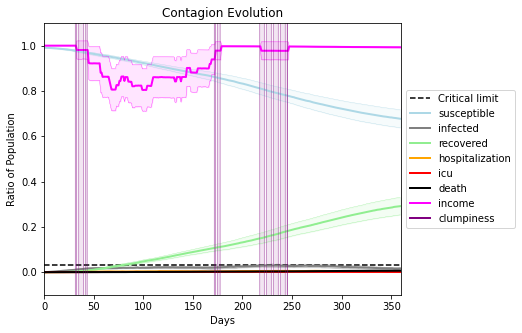

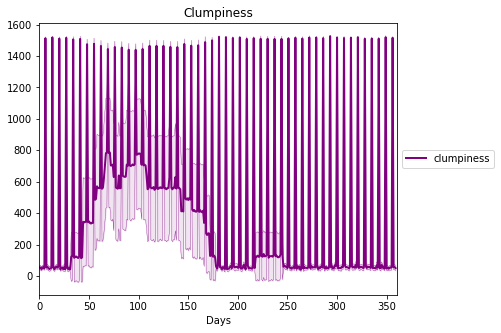

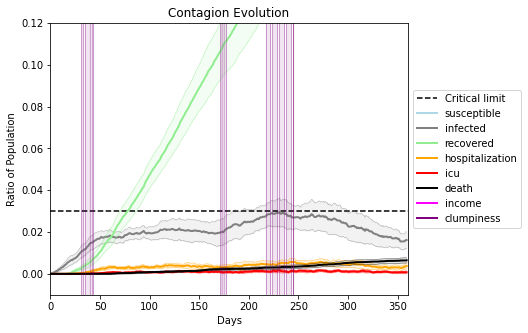

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9901, 1732, 8218, 1877, 3791, 4773, 3434, 5816, 6257, 8512, 7239, 5156, 1420, 4724, 5034, 8625, 5500, 7729, 757, 2702]
Average similarity between family members is 0.021039864706389022 at temperature 1
Average similarity between family and home is 0.9998606712290371 at temperature -1
Average similarity between students and their classroom is 0.017877674369947066 at temperature 1
Average classroom occupancy is 1.620879120879121 and number classrooms is 182
Average similarity between workers is -0.011669192714155906 at temperature 1
Average office occupancy is 3.237623762376238 and number offices is 202
Average friend similarity for adults: 0.08959624843410408 for kids: 0.09080384810447902
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity -0.05553278417987759
avg restaurant similarity -0.22030365418841188
avg restaurant similarity -0.017914386936595413
avg restaurant similarity 0.042932581513066635
avg restaurant similarity 0.24610565677098462
avg restaurant similarity 0.2872456988247215
avg restaurant similarity 0.048347210902861815
avg restaurant similarity 0.040293060850457134
avg restaurant similarity -0.123327278571633
avg restaurant similarity -0.09362182777488609
avg restaurant similarity -0.061411105547169
avg restaurant similarity 0.2579854078271917
avg restaurant similarity -0.09550579804459568
avg restaurant similarity 0.25283321688438404
avg restaurant similarity -0.13205615567798107
avg restaurant similarity -0.01930079995960704
avg restaurant similarity -0.10237284147033437
avg restaurant similarity -0.015289657427992015
avg restaurant similarity -0.01465562238126988
avg restaurant similarity 0.03177607014126453
avg restaurant similarity -0.13444161626891316
avg restaurant similar

avg restaurant similarity 0.13846732472833784
avg restaurant similarity -0.01221503785137873
avg restaurant similarity 0.0825242285269614
avg restaurant similarity 0.3889712992503545
avg restaurant similarity 0.03569794593465436
avg restaurant similarity 0.5117946091189207
avg restaurant similarity 0.22263877798398257
avg restaurant similarity -0.15195741314389688
avg restaurant similarity -0.11961278625195491
avg restaurant similarity 0.12492347898097036
avg restaurant similarity -0.021504572413193618
avg restaurant similarity 0.046387375341758026
avg restaurant similarity 0.12596878985579965
avg restaurant similarity -0.2546027179502199
avg restaurant similarity 0.1416209026909827
avg restaurant similarity 0.025599882569408705
avg restaurant similarity -0.28846845528706566
avg restaurant similarity -0.14245809956916108
avg restaurant similarity 0.23476461343201221
avg restaurant similarity -0.21353993274019545
avg restaurant similarity -0.0844787753981248
avg restaurant similarity -0

avg restaurant similarity 0.11526387660180042
avg restaurant similarity -0.4560091715474509
avg restaurant similarity 0.21949108042531087
Average similarity between family members is 0.01458458882976474 at temperature 1
Average similarity between family and home is 0.9998581601108041 at temperature -1
Average similarity between students and their classroom is 0.0044892456619603765 at temperature 1
Average classroom occupancy is 1.5245901639344261 and number classrooms is 183
Average similarity between workers is 0.012314300058626208 at temperature 1
Average office occupancy is 3.4081632653061225 and number offices is 196
Average friend similarity for adults: 0.09028880171594432 for kids: 0.08204702922866702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.05776322130617521
avg restaurant similarity 0.07975736611631958
avg restaurant similarity 0.09260598992992192
avg restaurant similarity -0.08304988625684995
avg restaurant similarity 0.34489931530644846
avg restaurant similarity 0.17557208930366458
avg restaurant similarity 0.16624621304708254
avg restaurant similarity 0.001345574735966637
avg restaurant similarity 0.05428100438008955
avg restaurant similarity 0.4729548496410833
avg restaurant similarity -0.16780793125822258
avg restaurant similarity 0.1350672177345658
avg restaurant similarity 0.2270453073314896
avg restaurant similarity 0.0028308982844797853
avg restaurant similarity -0.09433520566663545
avg restaurant similarity -0.19774063543307596
avg restaurant similarity 0.4816232341532816
avg restaurant similarity 0.21621918469487872
avg restaurant similarity 0.1271567584861067
avg restaurant similarity -0.19448897830488948
avg restaurant similarity -0.2947854360872917
avg restaurant similarity 0.226

avg restaurant similarity 0.041360642835810896
avg restaurant similarity -0.12319243213655426
avg restaurant similarity -0.11641056782051229
avg restaurant similarity 0.2525759794547354
avg restaurant similarity 0.4175572731684736
avg restaurant similarity -0.24591020031273542
Average similarity between family members is -0.008334161726463514 at temperature 1
Average similarity between family and home is 0.9998478286327613 at temperature -1
Average similarity between students and their classroom is 0.009194465498120427 at temperature 1
Average classroom occupancy is 1.6136363636363635 and number classrooms is 176
Average similarity between workers is 0.010636782658276275 at temperature 1
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.086575484283885 for kids: 0.09079236646231612
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a 

avg restaurant similarity -0.19189779638205517
avg restaurant similarity 0.06292518976489729
avg restaurant similarity 0.08555361640435716
avg restaurant similarity 0.14711558412202988
avg restaurant similarity 0.006812212466295993
avg restaurant similarity -0.27565269318378116
avg restaurant similarity -0.16712925309656437
avg restaurant similarity 0.2164181513838907
avg restaurant similarity -0.06264555547493059
avg restaurant similarity -0.025257719272418905
avg restaurant similarity 0.033139570387821324
avg restaurant similarity -0.3738267962476426
avg restaurant similarity -0.2149050554385053
avg restaurant similarity -0.31812882029864725
avg restaurant similarity -0.26454529995210985
avg restaurant similarity -0.16597468617422362
avg restaurant similarity 0.1064228902972505
avg restaurant similarity 0.01572127768317535
avg restaurant similarity 0.36937739733145913
avg restaurant similarity -0.1490670149183327
avg restaurant similarity -0.005657947675629109
avg restaurant similari

avg restaurant similarity 0.22426729091359518
avg restaurant similarity 0.133814051666902
avg restaurant similarity 0.03067627752308099
avg restaurant similarity 0.13676139789237238
avg restaurant similarity 0.0004963695936616164
avg restaurant similarity 0.22318044839611934
avg restaurant similarity 0.18193196770968517
avg restaurant similarity -0.12499935613981
avg restaurant similarity 0.11225792097612534
avg restaurant similarity 0.008535055286045
avg restaurant similarity -0.22099634900260856
avg restaurant similarity -0.22099634900260856
avg restaurant similarity 0.023555355102576475
avg restaurant similarity -0.6243360064442574
avg restaurant similarity -0.35506975715821754
avg restaurant similarity -0.025086905573851244
avg restaurant similarity 0.06775718174407193
avg restaurant similarity 0.23189065650816046
avg restaurant similarity 0.2509852861566205
avg restaurant similarity -0.18564833469081532
avg restaurant similarity -0.22099634900260856
avg restaurant similarity 0.290

avg restaurant similarity 0.08029565494095475
avg restaurant similarity 0.020365253231803604
avg restaurant similarity -0.16026915138495038
avg restaurant similarity 0.061940345948630945
avg restaurant similarity -0.023899439105318974
avg restaurant similarity -0.06245413108457126
avg restaurant similarity 0.22563795280979843
avg restaurant similarity -0.16522745721275534
avg restaurant similarity -0.1260592154933414
avg restaurant similarity -0.37145342245590224
avg restaurant similarity -0.09499816446325535
avg restaurant similarity 0.023543593353374803
avg restaurant similarity -0.02258549057005648
avg restaurant similarity 0.5566032399174585
avg restaurant similarity 0.30461976501316657
avg restaurant similarity 0.27736588032687554
avg restaurant similarity -0.23721039004184927
avg restaurant similarity 0.04690679055695203
avg restaurant similarity -0.16501827492943372
avg restaurant similarity -0.2965948174573628
avg restaurant similarity -0.0785347820071387
avg restaurant similar

avg restaurant similarity 0.10313499483567319
avg restaurant similarity 0.13591449183192494
avg restaurant similarity -0.4010677190054784
avg restaurant similarity -0.1587606119680736
avg restaurant similarity -0.19016328585169914
avg restaurant similarity 0.05889160638578095
avg restaurant similarity 0.11839060449683568
avg restaurant similarity 0.11860903873449027
avg restaurant similarity 0.27131612433429264
avg restaurant similarity -0.19510271412529634
avg restaurant similarity -0.04679315867951029
avg restaurant similarity -0.19944928168039971
avg restaurant similarity 0.03139817203778606
avg restaurant similarity -0.13661257677102576
avg restaurant similarity 0.05349316376618869
avg restaurant similarity -0.1798454353764478
avg restaurant similarity -0.3971700152340259
avg restaurant similarity -0.3528908733350012
avg restaurant similarity -0.001468510762405048
avg restaurant similarity -0.19162490791780612
avg restaurant similarity -0.09499816446325535
avg restaurant similarity

avg restaurant similarity 0.20196482314346245
avg restaurant similarity -0.18452386913377164
avg restaurant similarity -0.03011400599314297
avg restaurant similarity 0.17518413731015453
avg restaurant similarity 0.08027169169748258
avg restaurant similarity 0.1774127748713111
avg restaurant similarity -0.009520505696367552
avg restaurant similarity -0.009520505696367552
avg restaurant similarity -0.0661101720260911
avg restaurant similarity -0.005926985592299823
avg restaurant similarity 0.15629916964901164
avg restaurant similarity -0.22134356709544672
avg restaurant similarity -0.12137436520008847
avg restaurant similarity 0.05344662962183294
avg restaurant similarity -0.5359226329217109
avg restaurant similarity 0.17360709371856564
avg restaurant similarity -0.02113647865240101
avg restaurant similarity -0.13631045939938308
avg restaurant similarity 0.36936877899219306
avg restaurant similarity -0.21447505361432462
avg restaurant similarity 0.12323851096417783
avg restaurant similar

Average similarity between workers is 0.009529539669569013 at temperature 1
Average office occupancy is 3.266990291262136 and number offices is 206
Average friend similarity for adults: 0.07891819404346023 for kids: 0.09297371488267081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peopl

avg restaurant similarity -0.054500873405261205
avg restaurant similarity 0.14683833305309754
avg restaurant similarity 0.1302537445476519
avg restaurant similarity -0.13109549663736222
avg restaurant similarity 0.37408492583829556
avg restaurant similarity 0.2599025184018104
avg restaurant similarity 0.05282383388082058
avg restaurant similarity 0.2904593499355538
avg restaurant similarity -0.27302081457583205
avg restaurant similarity -0.18157297310991927
avg restaurant similarity -0.2546743728781288
avg restaurant similarity -0.40323545166934
avg restaurant similarity -0.28069845619040323
avg restaurant similarity 0.2742872308603416
avg restaurant similarity 0.06352348279646002
avg restaurant similarity 0.09788295448610798
avg restaurant similarity -0.04855498776764401
avg restaurant similarity 0.09031433793148477
avg restaurant similarity -0.28069845619040323
avg restaurant similarity 0.34516669614354184
avg restaurant similarity 0.21899921621191135
avg restaurant similarity 0.0989

avg restaurant similarity -0.11672729962936021
avg restaurant similarity -0.16909087382742172
avg restaurant similarity 0.12756416651853655
avg restaurant similarity -0.4040401343967492
avg restaurant similarity 0.30584124944681845
avg restaurant similarity 0.16997435057845656
avg restaurant similarity 0.11405678821421697
avg restaurant similarity -0.4034028800497753
avg restaurant similarity 0.044846467139858986
avg restaurant similarity 0.20295470158520088
avg restaurant similarity 0.25069292319148506
avg restaurant similarity 0.07921924615290675
avg restaurant similarity 0.1017529033084376
avg restaurant similarity 0.1257078048489082
avg restaurant similarity -0.1828766086004061
avg restaurant similarity 0.06722346323391554
avg restaurant similarity 0.3334320497044464
avg restaurant similarity -0.13272728782870036
avg restaurant similarity -0.1577749455424516
avg restaurant similarity 0.3743983794250263
avg restaurant similarity 0.15387640094657717
avg restaurant similarity -0.15112

avg restaurant similarity 0.15764958895706924
avg restaurant similarity -0.1896808930311042
avg restaurant similarity -0.23897272941618547
avg restaurant similarity -0.03858086432465248
avg restaurant similarity 0.17144362248689513
avg restaurant similarity 0.18599516743620725
avg restaurant similarity 0.13518773633284256
avg restaurant similarity -0.472847515547794
avg restaurant similarity 0.1334829927998408
avg restaurant similarity -0.1070640074317159
avg restaurant similarity -0.10895811298351743
avg restaurant similarity -0.06242021660821499
avg restaurant similarity -0.05898408677317395
avg restaurant similarity -0.472847515547794
avg restaurant similarity 0.6745504004103003
avg restaurant similarity -0.1801773296198951
avg restaurant similarity 0.10603770536567275
avg restaurant similarity 0.0014068848915166797
avg restaurant similarity 0.0723392991026245
avg restaurant similarity 0.09887249846672372
avg restaurant similarity 0.24365167545156244
avg restaurant similarity 0.5015

Average similarity between students and their classroom is 0.06138020199015979 at temperature 1
Average classroom occupancy is 1.4971098265895955 and number classrooms is 173
Average similarity between workers is 0.04176686843658935 at temperature 1
Average office occupancy is 3.396039603960396 and number offices is 202
Average friend similarity for adults: 0.08729696846586517 for kids: 0.07856413482143207
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in th

avg restaurant similarity 0.035680650685827285
avg restaurant similarity 0.18532446314550904
avg restaurant similarity -0.15279834427676597
avg restaurant similarity 0.0852618197577623
avg restaurant similarity 0.0804015127928544
avg restaurant similarity 0.5990310368221565
avg restaurant similarity -0.18852809795969105
avg restaurant similarity 0.21029601193723774
avg restaurant similarity 0.560379782498561
avg restaurant similarity 0.03408709961416211
avg restaurant similarity 0.16179852173295559
avg restaurant similarity 0.1808716061463964
avg restaurant similarity 0.08076190551020351
avg restaurant similarity -0.11358191150184807
avg restaurant similarity 0.10958156878419809
avg restaurant similarity 0.22176824088463148
avg restaurant similarity 0.3227094579048524
avg restaurant similarity 0.17179335143447488
avg restaurant similarity 0.791730229021314
avg restaurant similarity 0.26227724068388475
avg restaurant similarity -0.14061772022094787
avg restaurant similarity -0.511192427

avg restaurant similarity -0.3943791201618631
avg restaurant similarity -0.17906669267870134
avg restaurant similarity -0.4078374594910228
avg restaurant similarity 0.1013491636014204
avg restaurant similarity 0.013168101299994298
avg restaurant similarity 0.16044658084281208
avg restaurant similarity 0.2336036722035406
avg restaurant similarity 0.13429546083878915
avg restaurant similarity 0.2923721043312272
avg restaurant similarity -0.21036750730477224
avg restaurant similarity -0.08205973426087211
avg restaurant similarity -0.17045045614288484
avg restaurant similarity 0.014443596581747918
avg restaurant similarity -0.1836031894168407
avg restaurant similarity 0.14157723042873796
avg restaurant similarity -0.46826618473244397
avg restaurant similarity -0.09275177443102184
avg restaurant similarity -0.30400124656919614
avg restaurant similarity -0.15089156073493404
avg restaurant similarity -0.13662284632616697
Average similarity between family members is 0.019363261970459174 at tem

avg restaurant similarity -0.08371717601604667
avg restaurant similarity 0.0965315383596677
avg restaurant similarity 0.2931242010615902
avg restaurant similarity -0.2001939199428212
avg restaurant similarity 0.07642852979693766
avg restaurant similarity 0.10057521300188721
avg restaurant similarity 0.09078473384427165
avg restaurant similarity -0.19047570016622606
avg restaurant similarity -0.5015713434857128
avg restaurant similarity 0.13369988141920588
avg restaurant similarity 0.05984640126771621
avg restaurant similarity -0.053263445679365244
avg restaurant similarity 0.023406665039497537
avg restaurant similarity -0.16747801987774408
avg restaurant similarity -0.1837754858262629
avg restaurant similarity 0.23523477894659084
avg restaurant similarity -0.024202916277691514
avg restaurant similarity 0.10367746345250461
avg restaurant similarity -0.3278518660482514
avg restaurant similarity 0.05752757274897872
avg restaurant similarity 0.011382855594477811
avg restaurant similarity 0

avg restaurant similarity 0.17492760763382287
avg restaurant similarity 0.004911969673081308
avg restaurant similarity -0.012054977870594147
avg restaurant similarity 0.11073969295556271
avg restaurant similarity -0.2995473648861475
avg restaurant similarity -0.2048616498404966
avg restaurant similarity -0.2224267354719336
avg restaurant similarity 0.06587609487999689
avg restaurant similarity 0.0072210565794875725
avg restaurant similarity 0.12650423278100675
avg restaurant similarity -0.06734483271321443
avg restaurant similarity -0.009208176514665219
avg restaurant similarity 0.050512131211809766
avg restaurant similarity -0.37123849135567827
avg restaurant similarity -0.06989860367585889
avg restaurant similarity -0.2001939199428212
avg restaurant similarity -0.12494673780695364
avg restaurant similarity -0.18774330595174182
avg restaurant similarity 0.0696254434537737
avg restaurant similarity 0.08660701347779709
avg restaurant similarity 0.19993601116070922
avg restaurant similar

avg restaurant similarity -0.0475684011590441
avg restaurant similarity 0.4558417711645869
avg restaurant similarity 0.016637584822221614
avg restaurant similarity -0.10744713343028724
avg restaurant similarity -0.013991546958276205
avg restaurant similarity -0.05505317610906524
avg restaurant similarity 0.2751089715505589
avg restaurant similarity -0.09377724311700102
avg restaurant similarity 0.3076381849555071
avg restaurant similarity -0.05386826028051396
avg restaurant similarity 0.24333297539202195
avg restaurant similarity 0.2751089715505589
avg restaurant similarity 0.09674365080693118
avg restaurant similarity 0.16753148025659903
avg restaurant similarity -0.17604198991516873
avg restaurant similarity -0.03304926637747854
avg restaurant similarity 0.030468007460464054
avg restaurant similarity 0.09043531140471761
avg restaurant similarity 0.12174554505191096
avg restaurant similarity 0.24856862347674769
avg restaurant similarity 0.23203652368652958
avg restaurant similarity -0

avg restaurant similarity 0.2406542096139882
avg restaurant similarity 0.01700607433316828
avg restaurant similarity -0.14642528235000532
avg restaurant similarity 0.22572302440588396
avg restaurant similarity 0.051012474719384394
avg restaurant similarity -0.20710496681220766
avg restaurant similarity 0.16699713192864896
avg restaurant similarity 0.17347035587449855
avg restaurant similarity -0.21254651049562184
avg restaurant similarity 0.25411829606603314
avg restaurant similarity 0.17347035587449855
avg restaurant similarity -0.16198025857623802
avg restaurant similarity 0.051012474719384394
avg restaurant similarity 0.24332539971760583
avg restaurant similarity 0.2714672292264775
avg restaurant similarity -0.032598010219257685
avg restaurant similarity -0.06923984752533313
avg restaurant similarity 0.2493382882048082
avg restaurant similarity 0.1027557387079468
avg restaurant similarity 0.03807717095387356
avg restaurant similarity 0.3405897173270374
avg restaurant similarity -0.0

avg restaurant similarity -0.1599487690025502
avg restaurant similarity -0.13874568572585227
avg restaurant similarity 0.32741520561344345
avg restaurant similarity -0.09646755356363197
avg restaurant similarity -0.20527478960023196
avg restaurant similarity 0.20725956599010925
avg restaurant similarity 0.08356489910806635
avg restaurant similarity 0.2353455480788587
avg restaurant similarity -0.14525821347607226
avg restaurant similarity 0.11416783803000943
avg restaurant similarity -0.12599191030007123
avg restaurant similarity -0.00024160651404680177
avg restaurant similarity -0.208942716572187
avg restaurant similarity 0.14467081931525014
avg restaurant similarity -0.12307933177334818
avg restaurant similarity -0.2113344778785669
avg restaurant similarity 0.01658792650945797
avg restaurant similarity 0.4059362572769348
avg restaurant similarity 0.08380155847471477
avg restaurant similarity 0.05940712243401518
avg restaurant similarity 0.0803494742873858
avg restaurant similarity 0.

avg restaurant similarity 0.03699042879669216
avg restaurant similarity -0.37498123713846687
avg restaurant similarity -0.19398219765372582
avg restaurant similarity 0.04355726193958086
avg restaurant similarity -0.18842652481137503
avg restaurant similarity 0.19353998643833487
avg restaurant similarity 0.21439410696018624
avg restaurant similarity 0.0680860487499354
avg restaurant similarity -0.35289341935980184
avg restaurant similarity 0.11369449788537861
avg restaurant similarity 0.19531725735611125
avg restaurant similarity 0.29380398689173304
avg restaurant similarity 0.27727080576897173
avg restaurant similarity 0.0036041977294035688
avg restaurant similarity -0.13570277754420662
avg restaurant similarity 0.2552171772421065
avg restaurant similarity -0.047300135024242435
avg restaurant similarity 0.412137770480668
avg restaurant similarity 0.12982078255860127
avg restaurant similarity 0.371115917502963
avg restaurant similarity -0.02689365882162079
avg restaurant similarity -0.2

avg restaurant similarity 0.24152638843932464
avg restaurant similarity -0.4150682971840436
avg restaurant similarity -0.27790964919820943
avg restaurant similarity 0.32844009476879193
avg restaurant similarity 0.15282354715421367
avg restaurant similarity 0.10423131714153354
avg restaurant similarity -0.10724099340780552
avg restaurant similarity 0.11272921426727528
avg restaurant similarity -0.01594413526665231
avg restaurant similarity 0.1431197139294895
avg restaurant similarity -0.12601599918576237
avg restaurant similarity -0.2640683866694112
avg restaurant similarity 0.05908675700828847
avg restaurant similarity -0.08365077794610613
avg restaurant similarity -0.08270521909981585
avg restaurant similarity -0.10500337712161559
avg restaurant similarity 0.09943698878770907
avg restaurant similarity 0.2582628485646666
Average similarity between family members is -0.0013789151917213552 at temperature 1
Average similarity between family and home is 0.9998589710789277 at temperature -1

avg restaurant similarity 0.030699582699919365
avg restaurant similarity 0.28192873611050123
avg restaurant similarity -0.18100446174489296
avg restaurant similarity -0.49122323307282684
avg restaurant similarity -0.2770616836267139
avg restaurant similarity 0.02172148667729123
avg restaurant similarity 0.08179085649961013
avg restaurant similarity 0.2168379297534786
avg restaurant similarity 0.06853686374247728
avg restaurant similarity -0.28200106793996205
avg restaurant similarity 0.33317760192984697
avg restaurant similarity -0.015936192870104234
avg restaurant similarity 0.14601986078937138
avg restaurant similarity 0.386259424805208
avg restaurant similarity 0.017441944963056878
avg restaurant similarity -0.20709472415133254
avg restaurant similarity -0.1947075682683483
avg restaurant similarity 0.00023899055800247204
avg restaurant similarity 0.3532687577595419
avg restaurant similarity 0.30831470655101817
avg restaurant similarity 0.5308696908784009
avg restaurant similarity 0.

avg restaurant similarity -0.05667056363054903
avg restaurant similarity 0.34346246737426744
avg restaurant similarity 0.3484218920816529
avg restaurant similarity 0.0005559118593821457
avg restaurant similarity -0.19699181462094212
avg restaurant similarity -0.6627819328918494
avg restaurant similarity -0.19684734586906566
avg restaurant similarity 0.03897467692433367
avg restaurant similarity 0.028845496464680598
avg restaurant similarity -0.09776434785412146
avg restaurant similarity -0.14062510384822788
avg restaurant similarity -0.16561143376031862
avg restaurant similarity 0.10317801834364444
avg restaurant similarity 0.003740118030880993
avg restaurant similarity 0.516624905136511
avg restaurant similarity -0.029696697482737837
avg restaurant similarity 0.021415274442661114
avg restaurant similarity -0.17743595298979725
avg restaurant similarity -0.1325213063581836
avg restaurant similarity -0.010165506057537438
avg restaurant similarity 0.14600495653704756
avg restaurant simila

avg restaurant similarity -0.17212992801326632
avg restaurant similarity -0.2419398873243388
avg restaurant similarity 0.14845692218591147
avg restaurant similarity -0.04207514329287815
avg restaurant similarity -0.03671973700518801
avg restaurant similarity 0.35384470526452627
avg restaurant similarity 0.29360798559069934
avg restaurant similarity -0.10258962601675325
avg restaurant similarity 0.22566065399117297
avg restaurant similarity -0.010165506057537438
avg restaurant similarity -0.15771445451469066
avg restaurant similarity -0.020606026294161306
avg restaurant similarity -0.0958169029460766
avg restaurant similarity 0.003324668700463204
avg restaurant similarity -0.041281722604393646
avg restaurant similarity 0.12278578953341174
avg restaurant similarity 0.22074946120487432
avg restaurant similarity 0.09892001076618645
avg restaurant similarity 0.034126606292913524
avg restaurant similarity 0.0807907446438226
avg restaurant similarity -0.08351354764573746
avg restaurant simila

avg restaurant similarity 0.17537715418951189
avg restaurant similarity 0.3403160318078874
avg restaurant similarity 0.007253350616281795
avg restaurant similarity 0.11912899645188924
avg restaurant similarity 0.07735347544680599
avg restaurant similarity -0.043245789092431625
avg restaurant similarity 0.1481587950464133
avg restaurant similarity 0.08228675476569447
avg restaurant similarity 0.12415857774455497
avg restaurant similarity 0.12373900455523251
avg restaurant similarity 0.1764370146930566
avg restaurant similarity 0.10009956738569892
avg restaurant similarity -0.05390508581204003
avg restaurant similarity 0.01348083826755038
avg restaurant similarity -0.025124872002129456
avg restaurant similarity 0.3403160318078874
avg restaurant similarity -0.06100887420523186
avg restaurant similarity 0.07550362286741336
avg restaurant similarity -0.2541417824896212
avg restaurant similarity 0.1593504983140815
avg restaurant similarity 0.39263250082538925
avg restaurant similarity 0.2302

avg restaurant similarity -0.06495298212477767
avg restaurant similarity 0.19404877182322686
avg restaurant similarity 0.21975184075509646
avg restaurant similarity -0.29756792269077753
avg restaurant similarity 0.1492414623312675
avg restaurant similarity 0.18704392512867635
avg restaurant similarity -0.20968396677873347
avg restaurant similarity 0.16328870610850402
avg restaurant similarity -0.01778339099959969
avg restaurant similarity 0.023133607171790915
avg restaurant similarity 0.08939954631734885
avg restaurant similarity -0.25925894127631344
avg restaurant similarity 0.024546188313113185
avg restaurant similarity 0.19404877182322686
avg restaurant similarity -0.08290881882947783
avg restaurant similarity 0.16007274121916176
avg restaurant similarity 0.19404877182322686
avg restaurant similarity 0.0706286781175777
avg restaurant similarity 0.1919176432768194
avg restaurant similarity 0.00904685385955692
avg restaurant similarity 0.16007274121916176
avg restaurant similarity 0.1

avg restaurant similarity -0.2399343447790626
avg restaurant similarity 0.020853159131818497
avg restaurant similarity -0.29486562714529996
avg restaurant similarity 0.21883808145889663
Average similarity between family members is 0.008626184488049311 at temperature 1
Average similarity between family and home is 0.9998517848537067 at temperature -1
Average similarity between students and their classroom is 0.040347743960673504 at temperature 1
Average classroom occupancy is 1.5470588235294118 and number classrooms is 170
Average similarity between workers is -0.0020951972007003748 at temperature 1
Average office occupancy is 3.3529411764705883 and number offices is 204
Average friend similarity for adults: 0.08537197545441397 for kids: 0.09561053910967782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.06563373965095705
avg restaurant similarity -0.06968084407058775
avg restaurant similarity -0.06937604604273359
avg restaurant similarity -0.26720133400516555
avg restaurant similarity 0.02182001717536796
avg restaurant similarity 0.08751380363691091
avg restaurant similarity 0.06551684733745208
avg restaurant similarity 0.12373953283344584
avg restaurant similarity 0.12417523657627443
avg restaurant similarity -0.1698837508066754
avg restaurant similarity -0.23739282931406336
avg restaurant similarity 0.011408694000709131
avg restaurant similarity 0.1534061620450029
avg restaurant similarity 0.016256987804644685
avg restaurant similarity -0.002336294505227182
avg restaurant similarity 0.0071532437824782065
avg restaurant similarity 0.15202665327727805
avg restaurant similarity -0.023952782961499608
avg restaurant similarity -0.1722163361187194
avg restaurant similarity 0.13765386044700814
avg restaurant similarity 0.17044613225026134
avg restaurant similari

avg restaurant similarity -0.2864111108617769
avg restaurant similarity 0.016256987804644685
avg restaurant similarity 0.11726253319144524
avg restaurant similarity -0.05655850525243386
avg restaurant similarity 0.00012861870886871074
avg restaurant similarity -0.1721179405271771
avg restaurant similarity 1.0171579641810036e-05
avg restaurant similarity -0.06701143939568698
avg restaurant similarity 0.078622902045574
avg restaurant similarity -0.020710383443507868
avg restaurant similarity 0.36559897844339484
avg restaurant similarity -0.23268696494021285
avg restaurant similarity 0.1413431398400438
Average similarity between family members is 0.019217543048143295 at temperature 1
Average similarity between family and home is 0.9998593512014555 at temperature -1
Average similarity between students and their classroom is -0.00017468627163959527 at temperature 1
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.01112952

avg restaurant similarity 0.039474546375726824
avg restaurant similarity 0.20696851499197963
avg restaurant similarity -0.05286136164265101
avg restaurant similarity 0.1038842403184585
avg restaurant similarity -0.3090874887253877
avg restaurant similarity -0.39041586898265285
avg restaurant similarity 0.06844737749878109
avg restaurant similarity 0.09392405356304008
avg restaurant similarity 0.003721963555465887
avg restaurant similarity -0.29987009277633203
avg restaurant similarity 0.10364945561140707
avg restaurant similarity -0.14960252848545078
avg restaurant similarity 0.23980242024889148
avg restaurant similarity -0.1613296644641185
avg restaurant similarity 0.10092815275244219
avg restaurant similarity -0.02484548979567089
avg restaurant similarity -0.44025522540162887
avg restaurant similarity 0.36357290016378935
avg restaurant similarity -0.1613296644641185
avg restaurant similarity -0.1856138850915522
avg restaurant similarity -0.3982425174734181
avg restaurant similarity 0

avg restaurant similarity 0.3225439287110694
avg restaurant similarity 0.5575477314261923
avg restaurant similarity 0.5328794211194494
avg restaurant similarity -0.41459916015091336
avg restaurant similarity 0.03791539390038259
avg restaurant similarity -0.2896918396126931
avg restaurant similarity -0.07974365051994303
Average similarity between family members is 0.008879443753308501 at temperature 1
Average similarity between family and home is 0.9998643957889715 at temperature -1
Average similarity between students and their classroom is 0.009148656890306053 at temperature 1
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.04264056213539528 at temperature 1
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.0857850366988501 for kids: 0.10249910789181832
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacit

avg restaurant similarity -0.03023597508242512
avg restaurant similarity -0.08987176659829968
avg restaurant similarity -0.1521445613365477
avg restaurant similarity 0.03144449441091235
avg restaurant similarity 0.6020042540323944
avg restaurant similarity 0.07481446031488496
avg restaurant similarity -0.0760061387161373
avg restaurant similarity 0.08197710406882866
avg restaurant similarity 0.15112266727085555
avg restaurant similarity 0.06834220807505982
avg restaurant similarity 0.011593309570975227
avg restaurant similarity -0.060389758702590876
avg restaurant similarity -0.08987176659829968
avg restaurant similarity 0.1542315694249927
avg restaurant similarity -0.24772222902781588
avg restaurant similarity 0.27093438330022546
avg restaurant similarity 0.22505610510582752
avg restaurant similarity 0.1172187818172143
avg restaurant similarity 0.19859124899092623
avg restaurant similarity -0.09578436250912399
avg restaurant similarity 0.11867489482202546
avg restaurant similarity 0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

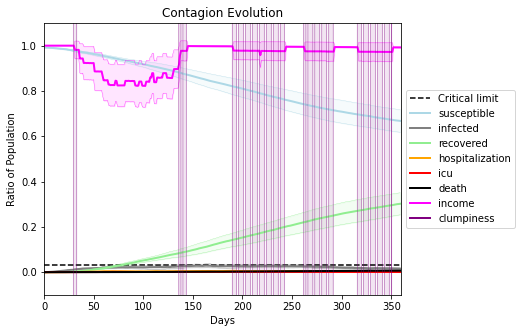

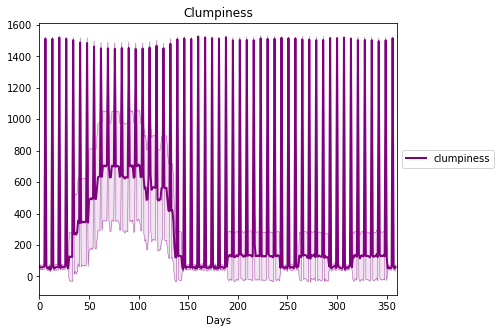

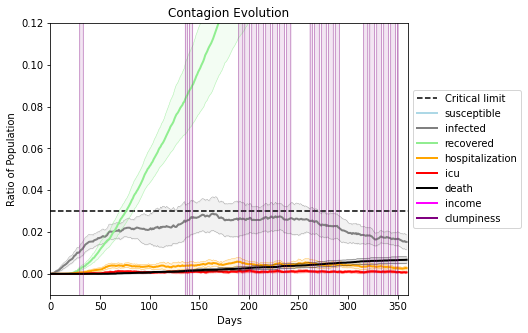

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)